In [131]:
import pandas as pd
import numpy as np
import re

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib.patches import Patch
import seaborn as sns

import pickle
from joblib import load

import os
from pathlib import Path

from sklearn.metrics.pairwise import cosine_distances
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.feature_selection import f_classif

from scipy.stats import spearmanr, pearsonr, f_oneway, kendalltau, ttest_ind, ks_2samp

import shap

from IPython.display import display, Markdown

## Load Data and models

In [2]:
# Information about the authors
authors_df = pd.read_csv("../Data/final_authors.csv", sep=";")
authors_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28 entries, 0 to 27
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Name           28 non-null     object
 1   birth_date     28 non-null     object
 2   death_date     28 non-null     object
 3   n_books        28 non-null     int64 
 4   Mouvement      28 non-null     object
 5   Genres         28 non-null     object
 6   n_excerpts     28 non-null     int64 
 7   WikiLangCount  28 non-null     int64 
dtypes: int64(3), object(5)
memory usage: 1.9+ KB


In [3]:
# Information about the books
books_df = pd.read_csv("../Data/books.csv")
books_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 299 entries, 0 to 298
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Author     299 non-null    object 
 1   Title      299 non-null    object 
 2   Language   299 non-null    object 
 3   EBook-No   299 non-null    int64  
 4   URL        299 non-null    object 
 5   Roman      299 non-null    bool   
 6   Genres     299 non-null    object 
 7   Mouvement  299 non-null    object 
 8   Date       298 non-null    float64
dtypes: bool(1), float64(1), int64(1), object(6)
memory usage: 19.1+ KB


In [4]:
# Excerpts after preprocessing
texts = pd.read_parquet("../Data/excerpts_processed.parquet")
texts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3858 entries, 0 to 3857
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Author        3858 non-null   object
 1   Title         3858 non-null   object
 2   URL           3858 non-null   object
 3   Excerpt_ID    3858 non-null   object
 4   Excerpt_Text  3858 non-null   object
 5   Cleaned_Text  3858 non-null   object
 6   Tokens        3858 non-null   object
dtypes: object(7)
memory usage: 211.1+ KB


In [5]:
# Final stylometric features used for classification
stylo_df = pd.read_parquet("../Data/final_stylo.parquet")
stylo_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3858 entries, 0 to 3857
Data columns (total 46 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   author               3858 non-null   object 
 1   syn_Complexity       3858 non-null   float64
 2   fw_et                3858 non-null   float64
 3   pun_Semicolon_Count  3858 non-null   float64
 4   pun_Comma_Count      3858 non-null   float64
 5   pun_Period_Count     3858 non-null   float64
 6   lex_AvgWordLen       3858 non-null   float64
 7   fw_que               3858 non-null   float64
 8   fw_je                3858 non-null   float64
 9   POS_NOUN             3858 non-null   float64
 10  fw_à                 3858 non-null   float64
 11  POS_ADV              3858 non-null   float64
 12  lex_Hapax_Ratio      3858 non-null   float64
 13  sent_PassiveRatio    3858 non-null   float64
 14  tense_imp_ind        3858 non-null   float64
 15  fw_des               3858 non-null   f

In [6]:
# Stylometric embeddings before scaling and feature selection
df_raw = pd.read_parquet("../Data/stylo_embedds_with_fos.parquet").set_index("Author")

df_raw.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3858 entries, George Sand to Georges Bernanos
Columns: 217 entries, lex_WordCount to fig_Euphémisme
dtypes: float64(195), int64(22)
memory usage: 6.4+ MB


In [7]:
# Contains openai and local embeddings of the excerpts
embeds_df = pd.read_parquet("../Data/excerpts_embeddings.parquet")
embeds_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3858 entries, 0 to 3857
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Author            3858 non-null   object
 1   embedding_openai  3858 non-null   object
 2   embedding_local   3858 non-null   object
dtypes: object(3)
memory usage: 90.6+ KB


In [8]:
# LogReg optimized model and retrained on the full dataset
logreg_model = load('../Models/final_model.pkl')

logreg_model.get_params()


{'C': np.float64(0.46415888336127775),
 'class_weight': None,
 'dual': False,
 'fit_intercept': True,
 'intercept_scaling': 1,
 'l1_ratio': None,
 'max_iter': 1000,
 'multi_class': 'ovr',
 'n_jobs': None,
 'penalty': 'l2',
 'random_state': None,
 'solver': 'newton-cg',
 'tol': 0.0001,
 'verbose': 0,
 'warm_start': False}

In [9]:
# Scaler used on stylometric features. NB : before feature selection
scaler = load("../Models/scaler.joblib")

## Get Log reg coefficients and shap values

### coeffs

In [10]:
# Récupérer les noms des auteurs
author_labels = logreg_model.classes_

# Récupérer les coefficients du modèle
coefs = pd.DataFrame(
    logreg_model.coef_,
    index=author_labels,
    columns=stylo_df.columns[1:]  # on exclut la colonne "author"
)

coefs.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28 entries, Alain-Fournier to Émile Zola
Data columns (total 45 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   syn_Complexity       28 non-null     float64
 1   fw_et                28 non-null     float64
 2   pun_Semicolon_Count  28 non-null     float64
 3   pun_Comma_Count      28 non-null     float64
 4   pun_Period_Count     28 non-null     float64
 5   lex_AvgWordLen       28 non-null     float64
 6   fw_que               28 non-null     float64
 7   fw_je                28 non-null     float64
 8   POS_NOUN             28 non-null     float64
 9   fw_à                 28 non-null     float64
 10  POS_ADV              28 non-null     float64
 11  lex_Hapax_Ratio      28 non-null     float64
 12  sent_PassiveRatio    28 non-null     float64
 13  tense_imp_ind        28 non-null     float64
 14  fw_des               28 non-null     float64
 15  fw_on                28 no

In [11]:
coefs.describe()

,syn_Complexity,fw_et,pun_Semicolon_Count,pun_Comma_Count,pun_Period_Count,lex_AvgWordLen,fw_que,fw_je,POS_NOUN,fw_à,...,fw_pas,fig_Métaphore,fw_se,fw_ma,lex_MarkerCount,fig_Comparaison,dep_advcl,fw_pour,fw_moi,fw_m
count,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,...,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000
mean,-0.474490,-0.154380,-0.246106,-0.061623,-0.253845,0.031306,0.148932,-0.063113,-0.202375,0.113221,...,-0.041135,-0.215401,-0.042856,-0.054867,-0.156870,0.034682,0.178573,0.028700,-0.059353,-0.039877
std,0.699481,0.863984,0.882678,0.853784,0.854300,0.806526,0.588791,0.572123,0.832877,0.374195,...,0.541856,0.563962,0.403164,0.342897,0.486494,0.502819,0.458548,0.378379,0.393549,0.269216
min,-2.017051,-1.575865,-2.239309,-1.856714,-2.914389,-1.621648,-1.159489,-0.993811,-1.871711,-0.623962,...,-1.502059,-1.908191,-0.868034,-0.727438,-1.262129,-0.780903,-0.819267,-0.705318,-1.269435,-0.573366
25%,-0.810909,-0.723323,-1.021665,-0.650982,-0.775725,-0.475301,-0.228241,-0.549856,-0.678417,-0.153194,...,-0.411549,-0.412333,-0.236174,-0.288040,-0.542403,-0.481444,-0.061884,-0.179877,-0.232230,-0.240354
50%,-0.508175,-0.276625,-0.249247,0.037370,-0.056373,-0.028690,0.010001,-0.010712,-0.283884,0.151162,...,0.055438,-0.175185,0.074965,-0.074893,-0.118080,0.055784,0.122692,0.049174,0.017451,-0.036038
75%,-0.065160,0.287054,0.258779,0.321894,0.407265,0.517445,0.580703,0.369797,0.151242,0.344584,...,0.336058,0.107181,0.196454,0.226139,0.171071,0.420178,0.354076,0.288116,0.203980,0.160433
max,1.284349,1.736388,1.560191,1.579219,1.081939,1.913944,1.474762,0.859058,1.742291,0.966871,...,0.955130,0.619091,0.948843,0.454151,1.048535,0.818116,1.280738,0.691913,0.497846,0.606529


In [12]:
# On récupère les noms des features (colonnes sauf "author")
feature_names = stylo_df.columns[1:]

# Initialisation du DataFrame des contributions moyennes
mean_contributions = pd.DataFrame(index=author_labels, columns=feature_names, dtype=float)

# Boucle sur chaque auteur
for author in author_labels:
    # Sélection des textes de l'auteur
    X_author = stylo_df[stylo_df["author"] == author][feature_names]
    
    # Moyenne des features pour cet auteur
    mean_features = X_author.mean()
    
    # Coefficients du modèle pour cet auteur
    coefs_author = coefs.loc[author]
    
    # Contribution moyenne = coef * valeur moyenne
    mean_contributions.loc[author] = coefs_author * mean_features


In [13]:
mean_contributions.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28 entries, Alain-Fournier to Émile Zola
Data columns (total 45 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   syn_Complexity       28 non-null     float64
 1   fw_et                28 non-null     float64
 2   pun_Semicolon_Count  28 non-null     float64
 3   pun_Comma_Count      28 non-null     float64
 4   pun_Period_Count     28 non-null     float64
 5   lex_AvgWordLen       28 non-null     float64
 6   fw_que               28 non-null     float64
 7   fw_je                28 non-null     float64
 8   POS_NOUN             28 non-null     float64
 9   fw_à                 28 non-null     float64
 10  POS_ADV              28 non-null     float64
 11  lex_Hapax_Ratio      28 non-null     float64
 12  sent_PassiveRatio    28 non-null     float64
 13  tense_imp_ind        28 non-null     float64
 14  fw_des               28 non-null     float64
 15  fw_on                28 no

In [14]:
mean_contributions.describe()

,syn_Complexity,fw_et,pun_Semicolon_Count,pun_Comma_Count,pun_Period_Count,lex_AvgWordLen,fw_que,fw_je,POS_NOUN,fw_à,...,fw_pas,fig_Métaphore,fw_se,fw_ma,lex_MarkerCount,fig_Comparaison,dep_advcl,fw_pour,fw_moi,fw_m
count,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,...,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000,28.000000
mean,0.264908,0.541992,0.595385,0.458154,0.477491,0.374831,0.167499,0.235838,0.229572,0.106222,...,0.111692,0.194097,0.123680,0.084610,0.183524,0.209016,0.123505,0.095392,0.067568,0.038680
std,0.709720,0.613790,0.834902,0.625024,0.908990,0.791663,0.286973,0.377927,0.458399,0.258691,...,0.306440,0.314790,0.202729,0.122493,0.324294,0.268699,0.226389,0.177670,0.178029,0.137746
min,-0.386520,-0.137738,-0.035885,-0.018486,-0.257158,-0.253051,-0.251170,-0.295404,-0.745127,-0.182714,...,-0.370684,-0.093915,-0.143029,-0.111223,-0.027128,-0.164548,-0.078164,-0.226691,-0.207656,-0.375739
25%,-0.028402,0.033653,0.043250,0.071051,0.045352,-0.004116,0.009332,0.011209,-0.007568,-0.019943,...,-0.059707,0.010098,-0.007079,0.020231,0.010264,0.004931,-0.004571,-0.002250,-0.027663,-0.007137
50%,0.063971,0.387638,0.197183,0.175724,0.211200,0.135608,0.067374,0.087990,0.090415,0.018142,...,0.035451,0.116746,0.028213,0.050127,0.084892,0.158598,0.021362,0.031023,-0.000090,0.004433
75%,0.270945,0.794505,0.879154,0.546956,0.515358,0.283788,0.239580,0.359860,0.333996,0.058955,...,0.239750,0.260414,0.175303,0.126078,0.224269,0.334737,0.102030,0.148098,0.150839,0.055256
max,3.441674,1.977001,3.752344,2.305476,4.559134,3.503982,0.948228,1.538251,1.833053,0.873012,...,1.249101,1.520248,0.641938,0.415784,1.637762,1.192025,0.756970,0.661841,0.648479,0.466951


### Shap

In [15]:
X = stylo_df.drop(columns=['author'])
y = stylo_df['author']

In [16]:
explainer = shap.Explainer(logreg_model, X, feature_perturbation="interventional")  # ou LinearExplainer pour compatibilité max
shap_values = explainer(X)

/Users/hadrienstrichard/Library/Caches/pypoetry/virtualenvs/research-paper-9dnSQuhV-py3.12/lib/python3.12/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


In [17]:
shap_values.shape

(3858, 45, 28)

In [18]:
# Initialisation du DataFrame
shap_authors = pd.DataFrame(index=author_labels, columns=X.columns, dtype=float)

# Boucle sur chaque auteur
for i, author in enumerate(author_labels):
    # Sélection des textes de l'auteur
    author_mask = (y == author)
    
    # SHAP values pour les textes de l'auteur, sur la sortie correspondant à cet auteur
    shap_vals_author = shap_values.values[author_mask, :, i]  # shape: (n_texts, n_features)
    
    # Moyenne des SHAP values par feature
    shap_mean = shap_vals_author.mean(axis=0)  # shape: (n_features,)
    
    # Remplir la ligne pour cet auteur
    shap_authors.loc[author] = shap_mean

In [19]:
shap_authors.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28 entries, Alain-Fournier to Émile Zola
Data columns (total 45 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   syn_Complexity       28 non-null     float64
 1   fw_et                28 non-null     float64
 2   pun_Semicolon_Count  28 non-null     float64
 3   pun_Comma_Count      28 non-null     float64
 4   pun_Period_Count     28 non-null     float64
 5   lex_AvgWordLen       28 non-null     float64
 6   fw_que               28 non-null     float64
 7   fw_je                28 non-null     float64
 8   POS_NOUN             28 non-null     float64
 9   fw_à                 28 non-null     float64
 10  POS_ADV              28 non-null     float64
 11  lex_Hapax_Ratio      28 non-null     float64
 12  sent_PassiveRatio    28 non-null     float64
 13  tense_imp_ind        28 non-null     float64
 14  fw_des               28 non-null     float64
 15  fw_on                28 no

## Global XAI

### Shap vs coefficients

In [20]:
# Moyenne des valeurs SHAP absolues pour chaque auteur
global_shap = {}

for i, author in enumerate(logreg_model.classes_):
    global_shap[author] = np.abs(shap_values.values[:, :, i]).mean(axis=0)

global_shap_df = pd.DataFrame(global_shap, index=X.columns).T  # auteurs × features

# Tri par importance moyenne pour chaque auteur
global_shap_df_sorted = global_shap_df.apply(lambda x: x.sort_values(ascending=False), axis=1)

shap_global = np.abs(shap_values.values).mean(axis=(0, 2))
shap_df = pd.Series(shap_global, index=X.columns)
coef_abs_mean = coefs.abs().mean(axis=0)

/var/folders/xn/v7b7dbbn6xg3hzr5h4395gbc0000gn/T/ipykernel_71180/2629540579.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=box_df, x="Method", y="Value", palette="Set2")


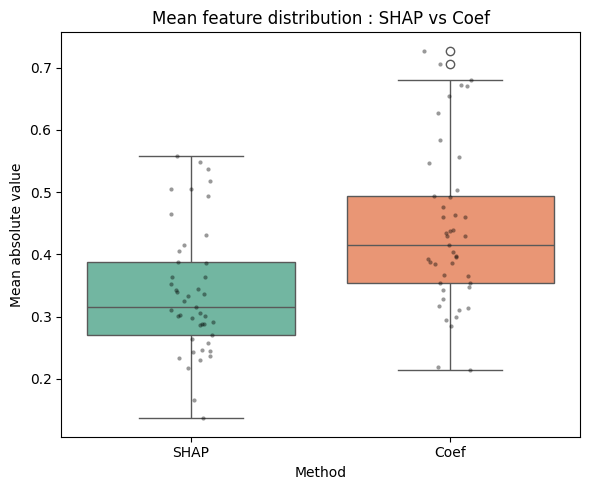

In [21]:
# Rassembler les deux séries dans un seul DataFrame "long format"
box_df = pd.DataFrame({
    "SHAP": shap_df,
    "Coef": coef_abs_mean
}).melt(var_name="Method", value_name="Value")

# Boxplot
plt.figure(figsize=(6, 5))
sns.boxplot(data=box_df, x="Method", y="Value", palette="Set2")
sns.stripplot(data=box_df, x="Method", y="Value", color="black", alpha=0.4, size=3)

plt.title("Mean feature distribution : SHAP vs Coef")
plt.ylabel("Mean absolute value")
plt.tight_layout()
plt.show()

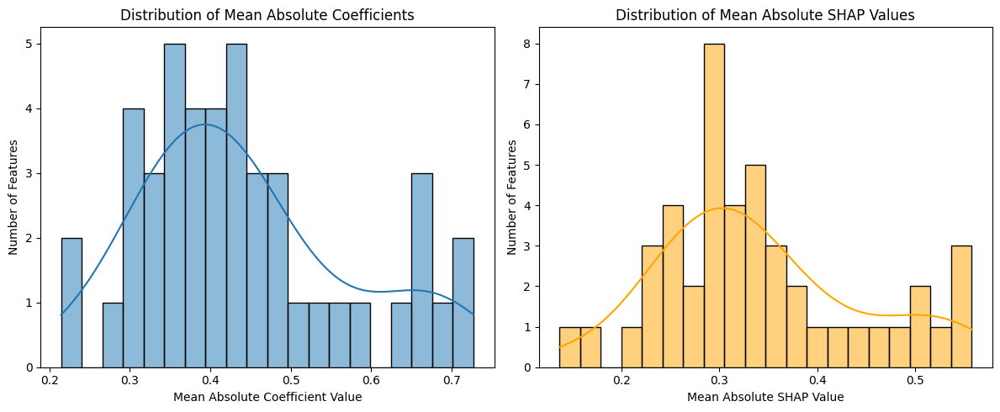

In [22]:
plt.figure(figsize=(12, 5))

# 1. Distribution of coefficient means
plt.subplot(1, 2, 1)
sns.histplot(coef_abs_mean, bins=20, kde=True)
plt.title("Distribution of Mean Absolute Coefficients")
plt.xlabel("Mean Absolute Coefficient Value")
plt.ylabel("Number of Features")

# 2. Distribution of SHAP values
plt.subplot(1, 2, 2)
sns.histplot(shap_df, bins=20, kde=True, color='orange')
plt.title("Distribution of Mean Absolute SHAP Values")
plt.xlabel("Mean Absolute SHAP Value")
plt.ylabel("Number of Features")

plt.tight_layout()
plt.show()

In [23]:
# Corrélation linéaire (Pearson)
pearson_corr, _ = pearsonr(coef_abs_mean, shap_df)
print(f"Pearson correlation = {pearson_corr:.4f}")

# Corrélation de rang (Spearman)
spearman_corr, _ = spearmanr(coef_abs_mean, shap_df)
print(f"Spearman correlation = {spearman_corr:.4f}")

Pearson correlation = 0.9910
Spearman correlation = 0.9841


In [24]:
# Kolmogorov-Smirnov test
stat, p_value = ks_2samp(coef_abs_mean, shap_df)
print(f"KS statistic = {stat:.4f}, p-value = {p_value:.4e}")

KS statistic = 0.4222, p-value = 5.5927e-04


In [25]:
# Kendall's tau
kendall_corr, _ = kendalltau(coef_abs_mean, shap_df)
print(f"Kendall tau = {kendall_corr:.4f}")

Kendall tau = 0.9111


### Top global features

In [26]:
n_top = 7  # Nombre de features les plus importantes à afficher

# SHAP
shap_global = np.abs(shap_values.values).mean(axis=(0, 2))
shap_df = pd.Series(shap_global, index=X.columns)
top_shap = shap_df.sort_values(ascending=False).head(n_top)

# Coefficients
coef_abs_mean = coefs.abs().mean(axis=0)
top_coefs = coef_abs_mean.sort_values(ascending=False).head(n_top)

top_features_df = pd.DataFrame({
    "SHAP": top_shap.index,
    "Coef": top_coefs.index
})

top_features_df

,SHAP,Coef
0,pun_Semicolon_Count,pun_Semicolon_Count
1,fw_et,fw_et
2,pun_Comma_Count,pun_Comma_Count
3,POS_NOUN,pun_Period_Count
4,syn_Complexity,syn_Complexity
5,pun_Period_Count,POS_NOUN
6,lex_AvgWordLen,lex_AvgWordLen


0 features différentes dans le tableau


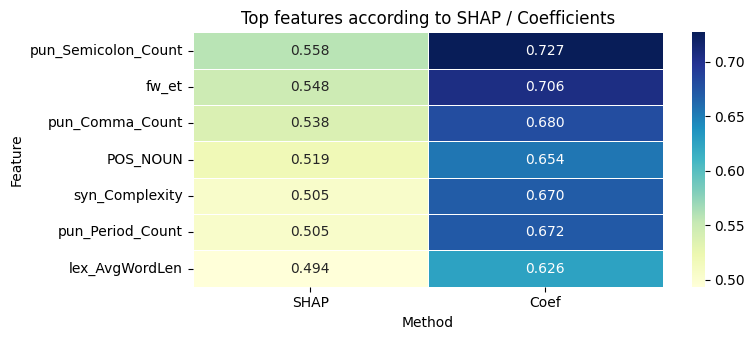

In [27]:
shap_set = set(top_shap.index)
coef_set = set(top_coefs.index)

# Récupération des scores pour toutes les features dans l'un des top 10
all_top_features = list( shap_set | coef_set)

# Création du DataFrame avec les vraies valeurs
value_df = pd.DataFrame(index=all_top_features)

value_df["SHAP"] = shap_df.reindex(all_top_features)
value_df["Coef"] = coef_abs_mean.reindex(all_top_features)

# Optionnel : trier les features pour affichage plus clair
value_df = value_df.sort_values(by="SHAP", ascending=False)

print(len(value_df)-n_top, "features différentes dans le tableau")

# Affichage heatmap
plt.figure(figsize=(8, len(value_df) * 0.5))
sns.heatmap(value_df, annot=True, fmt=".3f", cmap="YlGnBu", linewidths=0.5, cbar=True)
plt.title("Top features according to SHAP / Coefficients")
plt.xlabel("Method")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()


### Categories importance

In [28]:
# Exemple : "fw_et" → "fw", "syn_Complexity" → "syn"
def extract_prefix(feature_name):
    return feature_name.split("_")[0]

feature_categories = pd.Series([extract_prefix(f) for f in shap_df.index], index=shap_df.index)


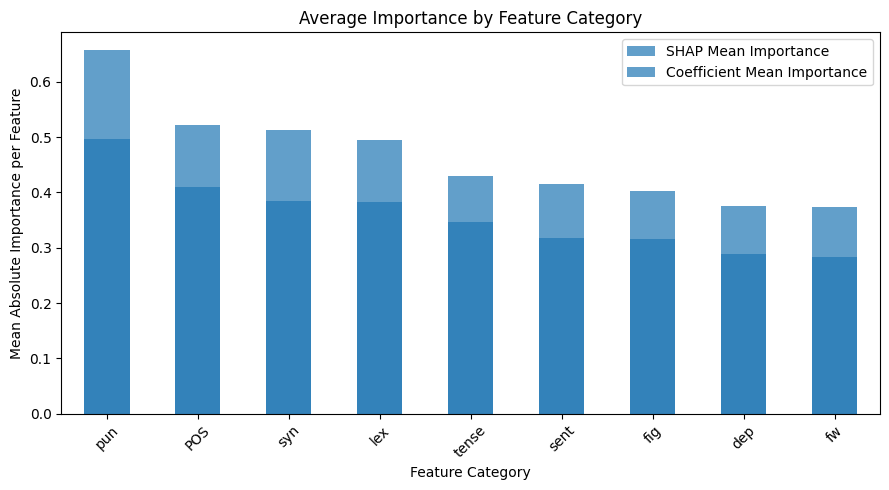

In [29]:
shap_by_category = shap_df.groupby(feature_categories).mean().sort_values(ascending=False)
coef_by_category = coef_abs_mean.groupby(feature_categories).mean().sort_values(ascending=False)

plt.figure(figsize=(9, 5))
shap_by_category.plot(kind='bar', alpha=0.7, label='SHAP Mean Importance')
coef_by_category.plot(kind='bar', alpha=0.7, label='Coefficient Mean Importance')

plt.ylabel("Mean Absolute Importance per Feature")
plt.title("Average Importance by Feature Category")
plt.xlabel("Feature Category")
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### From global to authors analysis

In [30]:
top_features = shap_df.sort_values(ascending=False).head(7).index.tolist()
bottom_features = shap_df.sort_values(ascending=True).head(2).index.tolist()
print("Top features:", top_features)
print("Bottom features:", bottom_features)

Top features: ['pun_Semicolon_Count', 'fw_et', 'pun_Comma_Count', 'POS_NOUN', 'syn_Complexity', 'pun_Period_Count', 'lex_AvgWordLen']
Bottom features: ['fw_m', 'fw_suis']


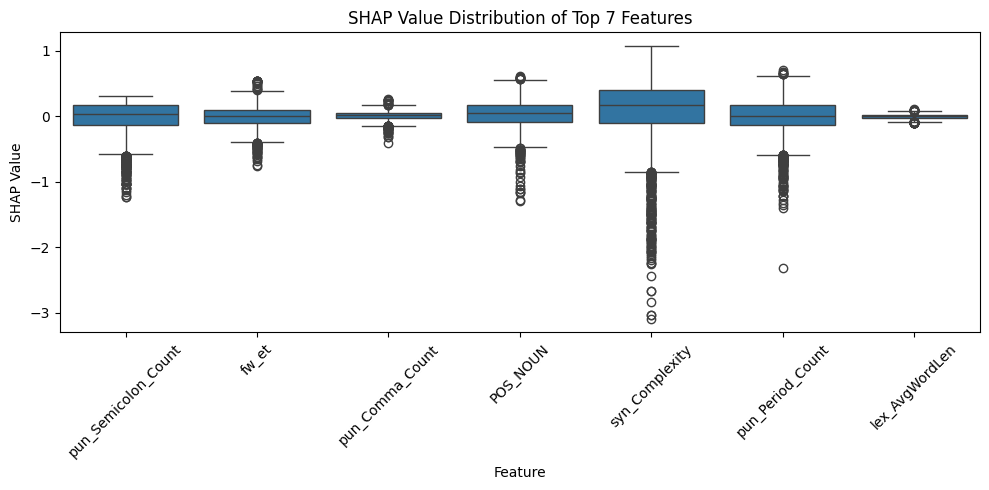

In [31]:
# shap_values.values: shape (n_texts, n_features, n_classes)
# y = auteur pour chaque texte
shap_array = shap_values.values  # (3858, 45, 28)
authors = shap_df.index.tolist()
classes = logreg_model.classes_

# On construit un DataFrame : lignes = textes, colonnes = feature × auteur
shap_per_text = pd.DataFrame(shap_array.mean(axis=2), columns=X.columns)
shap_per_text["author"] = stylo_df["author"].values

# Moyenne SHAP par auteur pour chaque feature
shap_by_author = shap_per_text.groupby("author").mean()

plt.figure(figsize=(10, 5))
sns.boxplot(data=shap_per_text[top_features].melt(var_name="Feature", value_name="SHAP Value"), 
            x="Feature", y="SHAP Value")
plt.title("SHAP Value Distribution of Top 7 Features")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

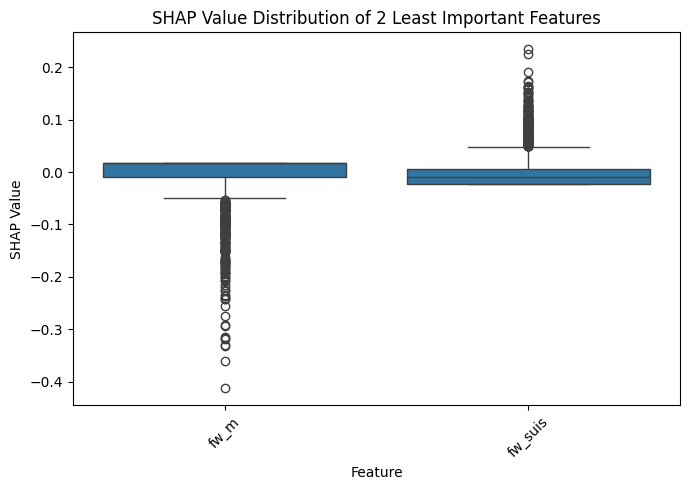

In [32]:
plt.figure(figsize=(7, 5))
sns.boxplot(data=shap_per_text[bottom_features].melt(var_name="Feature", value_name="SHAP Value"), 
            x="Feature", y="SHAP Value")
plt.title("SHAP Value Distribution of 2 Least Important Features")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Analysis by author

### Comparing shap and coeffs by author

In [ ]:
authors = logreg_model.classes_
features = X.columns


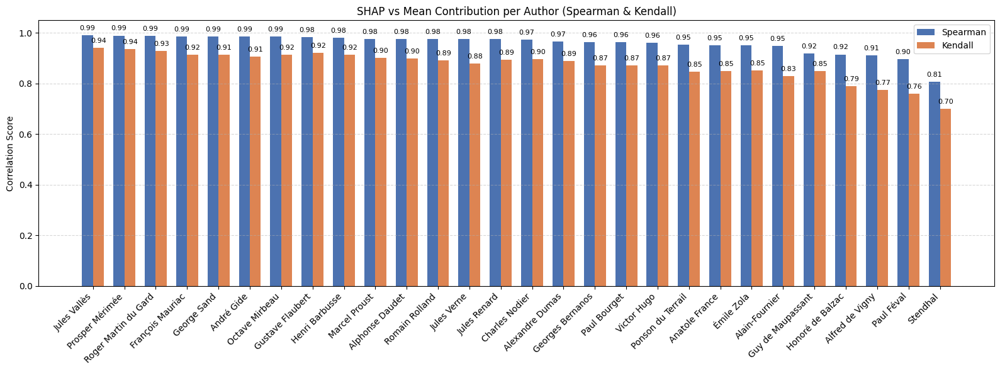

In [34]:
# Initialisation
spearman_scores = []
kendall_scores = []

# Liste des auteurs
authors = mean_contributions.index

# Boucle sur chaque auteur
for author in authors:
    # Extraire les valeurs (convertis en numpy pour être sûr)
    contribs = mean_contributions.loc[author].astype(float).values
    shap_vals = shap_authors.loc[author].astype(float).values

    # Corrélations
    spearman_corr, _ = spearmanr(contribs, shap_vals)
    kendall_corr, _ = kendalltau(contribs, shap_vals)

    spearman_scores.append(spearman_corr)
    kendall_scores.append(kendall_corr)

# DataFrame des résultats
corr_df = pd.DataFrame({
    "Author": authors,
    "Spearman": spearman_scores,
    "Kendall": kendall_scores
}).set_index("Author")

# Tri (optionnel) pour une meilleure lisibilité
corr_df_sorted = corr_df.sort_values("Spearman", ascending=False)

# --- Plot ---
plt.figure(figsize=(16, 6))
bar_width = 0.35
x = np.arange(len(corr_df_sorted))

# Barres
plt.bar(x - bar_width/2, corr_df_sorted["Spearman"], width=bar_width, label="Spearman", color="#4C72B0")
plt.bar(x + bar_width/2, corr_df_sorted["Kendall"], width=bar_width, label="Kendall", color="#DD8452")

# Annotations
for i, (s, k) in enumerate(zip(corr_df_sorted["Spearman"], corr_df_sorted["Kendall"])):
    plt.text(x[i] - bar_width/2, s + 0.02, f"{s:.2f}", ha='center', fontsize=8)
    plt.text(x[i] + bar_width/2, k + 0.02, f"{k:.2f}", ha='center', fontsize=8)

# Mise en forme
plt.xticks(x, corr_df_sorted.index, rotation=45, ha="right")
plt.ylim(0, 1.05)
plt.ylabel("Correlation Score")
plt.title("SHAP vs Mean Contribution per Author (Spearman & Kendall)")
plt.legend()
plt.grid(axis='y', linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

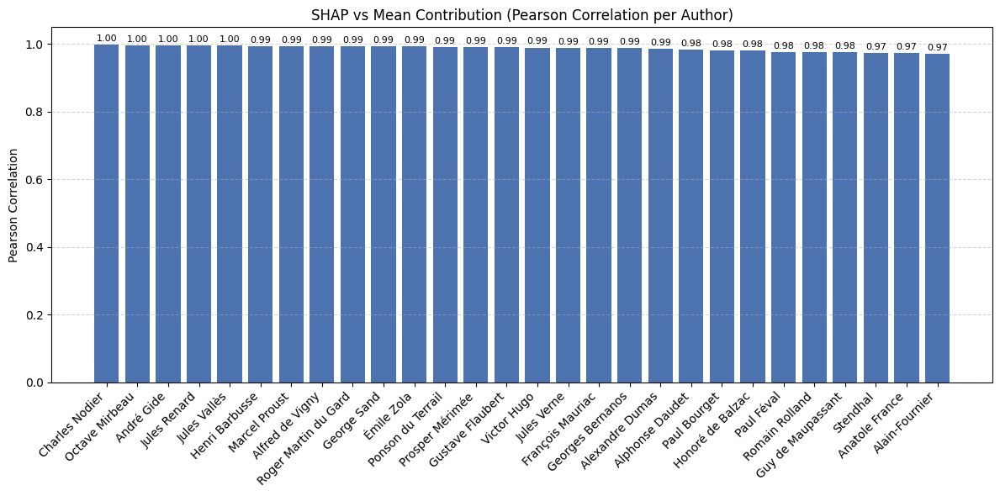

In [39]:
# Liste des auteurs
authors = mean_contributions.index

# Pearson correlations
pearson_scores = []

for author in authors:
    # Extraire les valeurs
    contribs = mean_contributions.loc[author].astype(float).values
    shap_vals = shap_authors.loc[author].astype(float).values

    # Pearson correlation
    pearson_corr, _ = pearsonr(contribs, shap_vals)
    pearson_scores.append(pearson_corr)

# Créer un DataFrame
pearson_df = pd.DataFrame({
    "Author": authors,
    "Pearson": pearson_scores
}).set_index("Author")

# Tri pour affichage
pearson_df_sorted = pearson_df.sort_values("Pearson", ascending=False)

# Plot
plt.figure(figsize=(12, 6))
x = np.arange(len(pearson_df_sorted))
plt.bar(x, pearson_df_sorted["Pearson"], color="#4C72B0")

# Annotations
for i, val in enumerate(pearson_df_sorted["Pearson"]):
    plt.text(x[i], val + 0.01, f"{val:.2f}", ha='center', fontsize=8)

plt.xticks(x, pearson_df_sorted.index, rotation=45, ha="right")
plt.ylim(0, 1.05)
plt.ylabel("Pearson Correlation")
plt.title("SHAP vs Mean Contribution (Pearson Correlation per Author)")
plt.grid(axis='y', linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


### Stylistic signature of authors

In [44]:
def get_prefix(feature_name):
    return feature_name.split("_")[0]

feature_categories = pd.Series([get_prefix(f) for f in X.columns], index=X.columns)
unique_categories = feature_categories.unique()

category_names = {
    "sent": "Sentence",
    "lex": "Lexical",
    "fig": "Figures",
    "dep": "Dependencies",
    "tense": "Tense",
    "syn": "Syntax",
    "POS": "POS",
    "pun": "Punctuation",
    "fw": "Function Word"
}

category_palette = {
    "fw": "orange",
    "pun": "green",
    "lex": "red",
    "POS": "blue",
    "syn": "dodgerblue",
    "sent": "purple",
    "tense": "pink",
    "dep": "gray",
    "fig": "olive"
}

legend_patches = [
    Patch(color=category_palette[cat], label=category_names[cat])
    for cat in category_palette
]

In [162]:
def interpretation_table(author_name):
    """
    Génère un tableau d'interprétation des features les plus importantes pour un auteur donné.
    """
    # Obtenir les valeurs SHAP pour l'auteur
    shap_vals = shap_by_author.loc[author_name]
    top5_feats = shap_vals.abs().sort_values(ascending=False).head(5).index

    # Obtenir les valeurs brutes
    author_vals_mean = df_raw_all.loc[author_name][X.columns].mean()
    global_vals_mean = df_raw_all[X.columns].mean()

    author_vals_top5 = author_vals_mean[top5_feats]
    global_vals_top5 = global_vals_mean[top5_feats]

    # Générer les interprétations automatiques
    def interpret_feature(shap_val, val_author, val_mean):
        direction = "more" if val_author > val_mean else "less"
        discriminant = "contributes to style" if shap_val > 0 else "is not distinctive"
        return f"{direction.capitalize()} than the average, {discriminant}"

    # Construire le DataFrame final
    interpret_df = pd.DataFrame({
        "Feature": top5_feats,
        "SHAP Value": shap_vals[top5_feats].round(3),
        "Author Value": author_vals_top5.round(3),
        "Global Mean": global_vals_top5.round(3),
        "Interpretation": [
            interpret_feature(shap_vals[f], author_vals_top5[f], global_vals_top5[f])
            for f in top5_feats
        ]
    })
    
    return interpret_df

interpretation_table("Victor Hugo")

,Feature,SHAP Value,Author Value,Global Mean,Interpretation
syn_Complexity,syn_Complexity,0.446,1.306,1.906,"Less than the average, contributes to style"
fig_Métaphore,fig_Métaphore,-0.206,7.059,3.522,"More than the average, is not distinctive"
pun_Period_Count,pun_Period_Count,-0.187,81.462,64.903,"More than the average, is not distinctive"
syn_SubCoordRatio,syn_SubCoordRatio,0.140,0.558,0.670,"Less than the average, contributes to style"
dep_advcl,dep_advcl,-0.137,24.339,31.261,"Less than the average, is not distinctive"


In [142]:
def display_stylistic_profile(author_name, 
                              matrix="Shap",  # "Shap", "Mean", or "Coefs"
                              shap_matrix=shap_authors,
                              mean_contrib_matrix=mean_contributions,
                              coefs_matrix=coefs,
                              return_interpretation=False):
    # Choix du bon jeu de données
    if matrix == "Shap":
        if shap_matrix is None:
            raise ValueError("You must provide shap_matrix when matrix='shap'")
        data_matrix = shap_matrix
        matrix_label = "SHAP"
    elif matrix == "Mean":
        if mean_contrib_matrix is None:
            raise ValueError("You must provide mean_contrib_matrix when matrix='mean'")
        data_matrix = mean_contrib_matrix
        matrix_label = "Mean Contribution"
    elif matrix == "Coefs":
        if coefs_matrix is None:
            raise ValueError("You must provide coefs_matrix when matrix='coefs'")
        data_matrix = coefs_matrix
        matrix_label = "Raw Coefficients"
    else:
        raise ValueError("Invalid matrix type. Choose from 'Shap', 'Mean', or 'Coefs'.")

    # Préparer les infos de feature
    feature_categories = pd.Series([f.split("_")[0] for f in X.columns], index=X.columns)
    feature_labels = pd.Series([f.split("_", 1)[1] if "_" in f else f for f in X.columns], index=X.columns)

    # 1. Radar général (hors Function Words)
    ordered_features, ordered_colors, display_labels = [], [], []
    for cat in category_palette.keys():
        if cat == "fw":
            continue
        feats = feature_categories[feature_categories == cat].index.tolist()
        ordered_features.extend(feats)
        ordered_colors.extend([category_palette[cat]] * len(feats))
        display_labels.extend([feature_labels[f] for f in feats])

    values = data_matrix.loc[author_name][ordered_features].tolist()
    values += values[:1]
    angles = np.linspace(0, 2 * np.pi, len(ordered_features), endpoint=False).tolist()
    angles += angles[:1]

    fig1 = plt.figure(figsize=(12, 10))
    ax1 = fig1.add_subplot(111, polar=True)
    
    ax1.set_theta_offset(np.pi / 2)  # Fac. lisibilité top
    ax1.set_thetagrids(np.degrees(angles[:-1]), labels=display_labels, fontsize=10)

    max_val = max(abs(v) for v in values)
    radial_max = round(max_val + 0.1, 1)  # marge de sécurité
    radial_grid = np.linspace(-radial_max, radial_max, 100)
    for r in radial_grid:
        alpha = min(abs(r) * 2, 1) * 0.15
        color = "blue" if r > 0 else "red"
        ax1.fill_between(angles, r, r + 0.01, color=color, alpha=alpha)

    for i in range(len(ordered_features)):
        ax1.plot(angles[i:i+2], values[i:i+2], color=ordered_colors[i], linewidth=2)
    ax1.plot(angles, [0]*len(angles), color="black", linewidth=1.5, linestyle="--")

    ax1.set_xticks(angles[:-1])
    ax1.set_xticklabels(display_labels, fontsize=10)
    for label, f in zip(ax1.get_xticklabels(), ordered_features):
        label.set_color(category_palette[feature_categories[f]])
        label.set_rotation_mode('anchor')
        label.set_horizontalalignment('center')
        label.set_y(label.get_position()[1] - 0.05)

    ax1.set_title(f"{author_name}'s Stylistic Signature ({matrix_label} x Stylometry)", size=14)
    ax1.legend(handles=legend_patches, bbox_to_anchor=(1.15, 1.1), title="Categories")
    plt.tight_layout()
    plt.show()

    # 2. Radar FW + Raw Values
    fig2, (ax2, ax3) = plt.subplots(1, 2, figsize=(14, 7), subplot_kw={ 'polar': False })

    # --- FW Radar ---
    fw_feats = feature_categories[feature_categories == "fw"].index
    fw_labels = [feature_labels[f] for f in fw_feats]
    fw_angles = np.linspace(0, 2 * np.pi, len(fw_feats), endpoint=False).tolist()
    fw_angles += fw_angles[:1]
    fw_values = data_matrix.loc[author_name][fw_feats].tolist()
    fw_values += fw_values[:1]
    fw_max = max(abs(v) for v in fw_values) + 0.05

    ax2 = fig2.add_subplot(1, 2, 1, polar=True)
    ax2.set_ylim(-fw_max, fw_max)
    ax2.set_yticks(np.linspace(-fw_max, fw_max, 5))
    ax2.set_yticklabels([f"{y:.2f}" for y in np.linspace(-fw_max, fw_max, 5)], fontsize=8)
    
    ax2.set_frame_on(False)  # cache le fond blanc de l’axe
    fig2.patch.set_facecolor('none')  # rend le fond global transparent (optionnel)


    ax2.plot(fw_angles, fw_values, color="orange", linewidth=2)
    ax2.fill(fw_angles, fw_values, color="orange", alpha=0.25)
    ax2.plot(fw_angles, [0]*len(fw_angles), color="black", linewidth=1.2, linestyle="--")
    ax2.set_xticks(fw_angles[:-1])
    ax2.set_xticklabels(fw_labels, fontsize=11)
    ax2.set_title(f"Function Words Shap Values for {author_name}", size=14)

    # --- Bar chart for raw values of important features ---
    shap_vals = shap_authors.loc[author_name]  # on garde SHAP ici pour importance
    author_shap_vals = shap_authors.loc[author_name]
    percentile = 85
    shap_threshold = np.percentile(abs(author_shap_vals), percentile) 
    significant_feats = shap_vals[shap_vals > shap_threshold].sort_values(ascending=False).index

    if len(significant_feats) == 0:
        ax3.text(0.5, 0.5, "No SHAP feature above threshold", ha="center", va="center")
        ax3.axis('off')
    else:
        # Moyennes brutes
        author_vals_mean = df_raw.loc[author_name][X.columns].mean()
        global_vals_mean = df_raw[X.columns].mean()

        # Subset
        author_vals_sig = author_vals_mean[significant_feats]
        global_vals_sig = global_vals_mean[significant_feats]

        x = np.arange(len(significant_feats))
        width = 0.35

        bars1 = ax3.bar(x - width/2, global_vals_sig.values, width, label="All Authors", color="lightgray")
        bars2 = ax3.bar(x + width/2, author_vals_sig.values, width, label=author_name, color="teal")
        
        ax3.set_yscale('log')

        ax3.set_xticks(x)
        ax3.set_xticklabels([feature_labels[f] for f in significant_feats], rotation=45, ha="right", fontsize=10)
        ax3.set_title(f"Raw Feature Values (SHAP > {percentile}th percentile)")
        ax3.legend()
        def log_fmt(val):
            return f"{val:.2g}" if val > 0 else ""

        ax3.bar_label(bars1, labels=[log_fmt(v) for v in global_vals_sig.values], padding=3)
        ax3.bar_label(bars2, labels=[log_fmt(v) for v in author_vals_sig.values], padding=3)
        
    plt.tight_layout()
    plt.show()
    

    # --- Interpretation Table (inline) ---
    # Use SHAP (even if using mean contributions for radar)
    shap_vals = shap_authors.loc[author_name]
    top_feats = shap_vals.abs().sort_values(ascending=False).head(5).index.tolist()

    # Raw means
    author_vals_mean = df_raw.loc[author_name][X.columns].mean()
    global_vals_mean = df_raw[X.columns].mean()
    
    interpretation_strings = []
    interpretation_strings.append(
        f"### 🔍 Interpretation Summary for **{author_name}** — Top features with SHAP values above the {percentile}ᵗʰ percentile"
    )

    # Header
    display(Markdown(f"### 🔍 Interpretation Summary for **{author_name}** - Top features with shap values above the {percentile}th percentile)"))

    # Utiliser le même seuil de percentile
    shap_vals = shap_authors.loc[author_name]
    abs_shap_vals = shap_vals.abs()
    threshold = np.percentile(abs_shap_vals, percentile)
    important_feats = abs_shap_vals[abs_shap_vals > threshold].sort_values(ascending=False).index.tolist()

    # Fonctions utilitaires
    def ordinal(n):
        return f"{n}ᵗʰ" if 10 <= n % 100 <= 20 else f"{n}{['ᵗʰ','ˢᵗ','ⁿᵈ','ʳᵈ','ᵗʰ'][min(n % 10, 4)]}"

    def shorten(name):
        return name.split("_", 1)[1] if "_" in name else name

    def format_val(v):
        return f"{v:.2g}" if v > 0.001 else f"{v:.1e}"

    # Boucle ajustée
    for rank, feat in enumerate(important_feats, 1):
        shap_val = shap_vals[feat]
        val_author = author_vals_mean[feat]
        val_mean = global_vals_mean[feat]

        direction = "higher" if val_author > val_mean else "lower"
        trait = "frequent use" if val_author > val_mean else "reduced use"
        clean_feat = shorten(feat)

        line = (
            f"**{rank}. `{clean_feat}`**: The average value of this feature for *{author_name}* "
            f"is **{direction}** than the global mean "
            f"(*{format_val(val_author)} vs {format_val(val_mean)}*). "
            f"This comparatively **{direction} usage** of *{clean_feat}* is characteristic of {author_name}'s style, "
            f"making it the **{ordinal(rank)} most important** stylistic indicator "
            f"in this classification task (*SHAP: {shap_val:.2f}*)."
        )

        # Affichage interactif
        display(Markdown(line))

        # Sauvegarde pour export
        interpretation_strings.append(line)
    if return_interpretation:
        return fig1, fig2, interpretation_strings
    else:
        return fig1, fig2

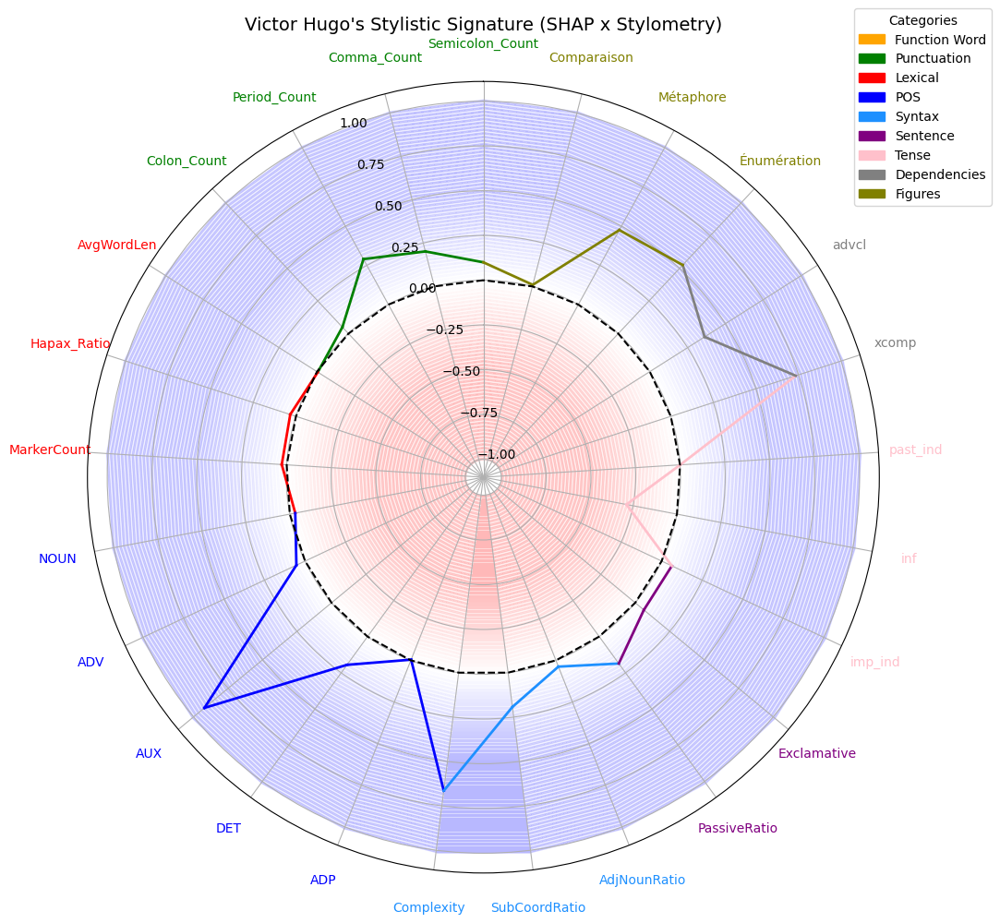

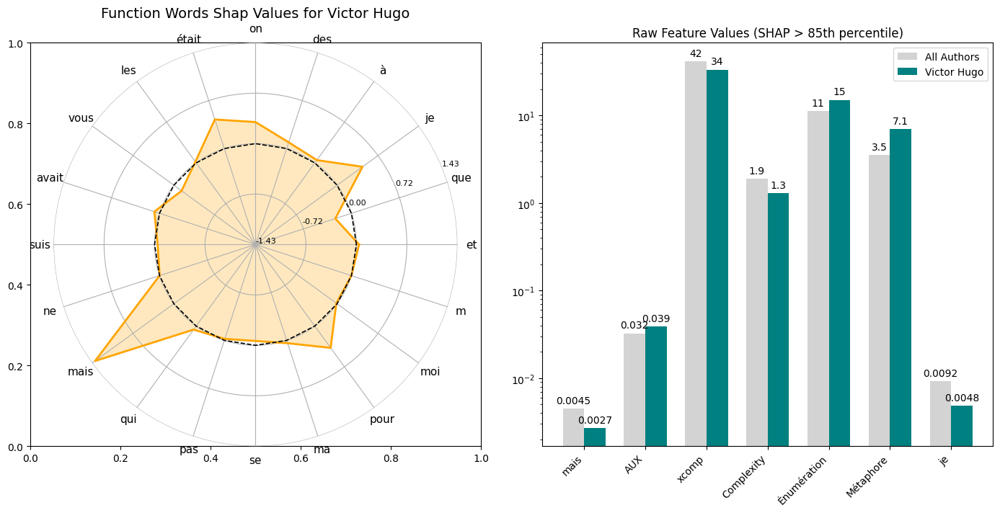

### 🔍 Interpretation Summary for **Victor Hugo** - Top features with shap values above the 85th percentile)

**1. `mais`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*0.0027 vs 0.0045*). This comparatively **lower usage** of *mais* is characteristic of Victor Hugo's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.38*).

**2. `AUX`**: The average value of this feature for *Victor Hugo* is **higher** than the global mean (*0.039 vs 0.032*). This comparatively **higher usage** of *AUX* is characteristic of Victor Hugo's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.92*).

**3. `xcomp`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*34 vs 42*). This comparatively **lower usage** of *xcomp* is characteristic of Victor Hugo's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.73*).

**4. `Complexity`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*1.3 vs 1.9*). This comparatively **lower usage** of *Complexity* is characteristic of Victor Hugo's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.67*).

**5. `Énumération`**: The average value of this feature for *Victor Hugo* is **higher** than the global mean (*15 vs 11*). This comparatively **higher usage** of *Énumération* is characteristic of Victor Hugo's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.53*).

**6. `Métaphore`**: The average value of this feature for *Victor Hugo* is **higher** than the global mean (*7.1 vs 3.5*). This comparatively **higher usage** of *Métaphore* is characteristic of Victor Hugo's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.48*).

**7. `je`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*0.0048 vs 0.0092*). This comparatively **lower usage** of *je* is characteristic of Victor Hugo's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.44*).

(<Figure size 1200x1000 with 1 Axes>, <Figure size 1400x700 with 3 Axes>)

In [143]:
display_stylistic_profile("Victor Hugo", "Shap") #Test

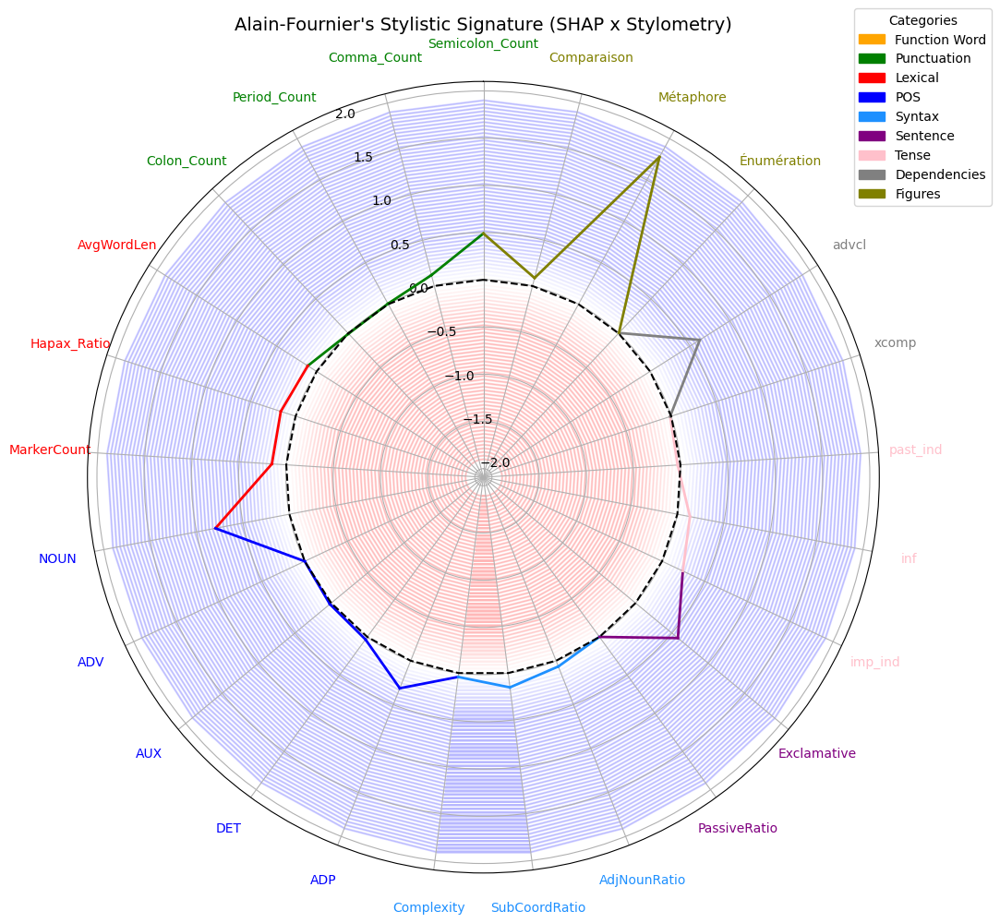

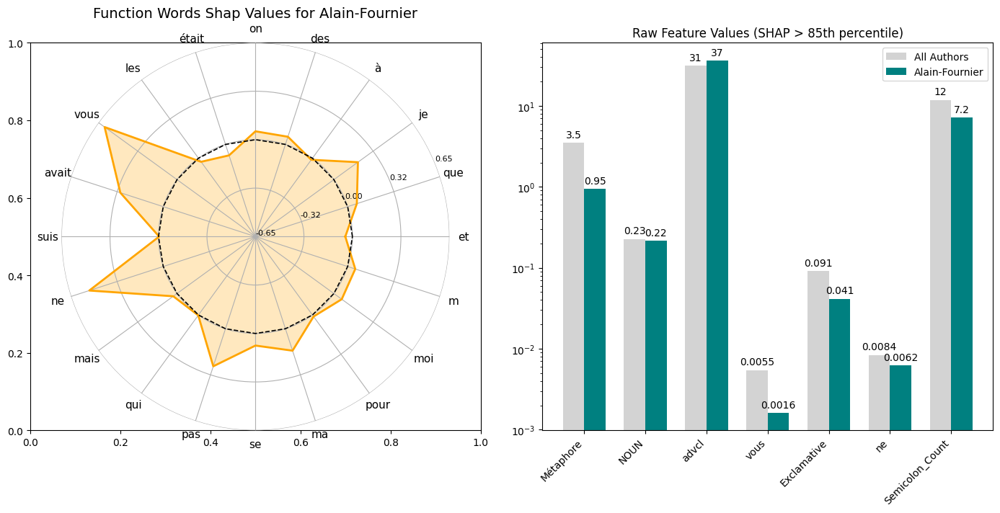

### 🔍 Interpretation Summary for **Alain-Fournier** - Top features with shap values above the 85th percentile)

**1. `Métaphore`**: The average value of this feature for *Alain-Fournier* is **lower** than the global mean (*0.95 vs 3.5*). This comparatively **lower usage** of *Métaphore* is characteristic of Alain-Fournier's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.78*).

**2. `NOUN`**: The average value of this feature for *Alain-Fournier* is **lower** than the global mean (*0.22 vs 0.23*). This comparatively **lower usage** of *NOUN* is characteristic of Alain-Fournier's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.80*).

**3. `advcl`**: The average value of this feature for *Alain-Fournier* is **higher** than the global mean (*37 vs 31*). This comparatively **higher usage** of *advcl* is characteristic of Alain-Fournier's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.62*).

**4. `vous`**: The average value of this feature for *Alain-Fournier* is **lower** than the global mean (*0.0016 vs 0.0055*). This comparatively **lower usage** of *vous* is characteristic of Alain-Fournier's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.60*).

**5. `Exclamative`**: The average value of this feature for *Alain-Fournier* is **lower** than the global mean (*0.041 vs 0.091*). This comparatively **lower usage** of *Exclamative* is characteristic of Alain-Fournier's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.58*).

**6. `ne`**: The average value of this feature for *Alain-Fournier* is **lower** than the global mean (*0.0062 vs 0.0084*). This comparatively **lower usage** of *ne* is characteristic of Alain-Fournier's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.52*).

**7. `Semicolon_Count`**: The average value of this feature for *Alain-Fournier* is **lower** than the global mean (*7.2 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Alain-Fournier's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.49*).

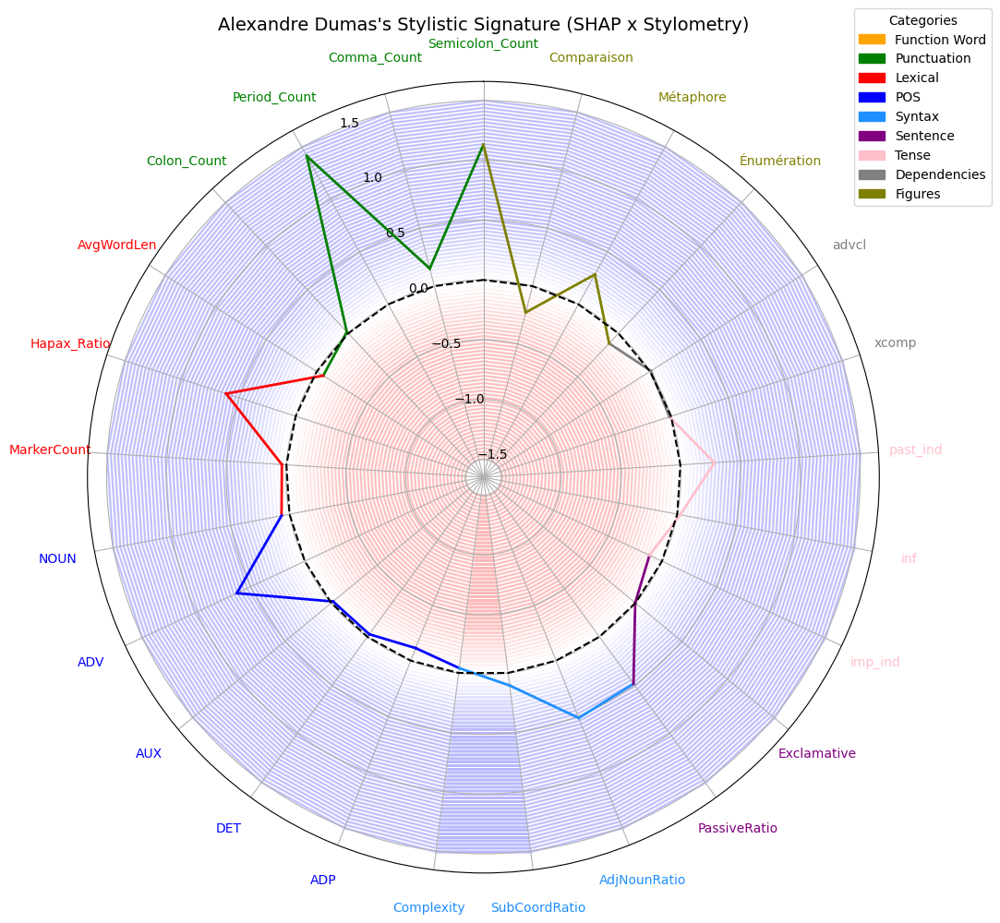

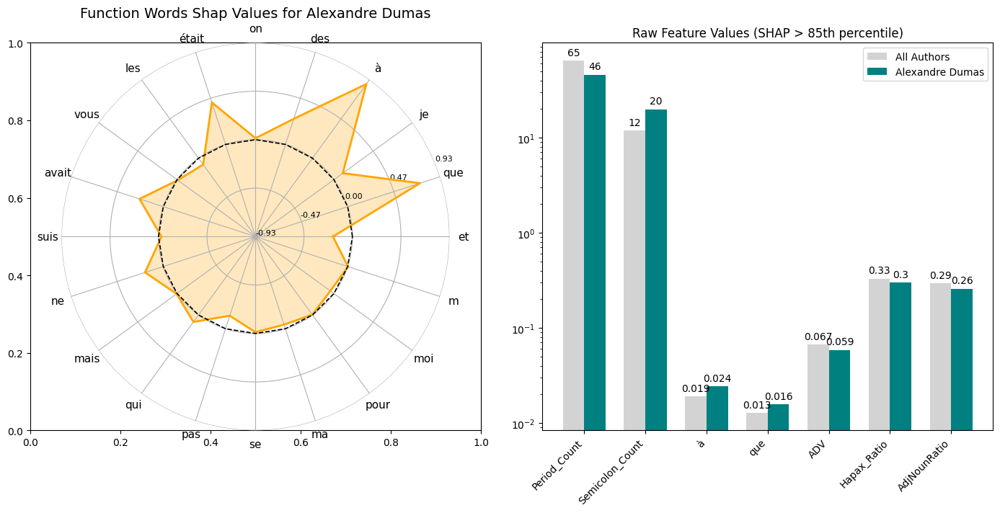

### 🔍 Interpretation Summary for **Alexandre Dumas** - Top features with shap values above the 85th percentile)

**1. `Period_Count`**: The average value of this feature for *Alexandre Dumas* is **lower** than the global mean (*46 vs 65*). This comparatively **lower usage** of *Period_Count* is characteristic of Alexandre Dumas's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.42*).

**2. `Semicolon_Count`**: The average value of this feature for *Alexandre Dumas* is **higher** than the global mean (*20 vs 12*). This comparatively **higher usage** of *Semicolon_Count* is characteristic of Alexandre Dumas's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.13*).

**3. `à`**: The average value of this feature for *Alexandre Dumas* is **higher** than the global mean (*0.024 vs 0.019*). This comparatively **higher usage** of *à* is characteristic of Alexandre Dumas's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.88*).

**4. `que`**: The average value of this feature for *Alexandre Dumas* is **higher** than the global mean (*0.016 vs 0.013*). This comparatively **higher usage** of *que* is characteristic of Alexandre Dumas's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.73*).

**5. `ADV`**: The average value of this feature for *Alexandre Dumas* is **lower** than the global mean (*0.059 vs 0.067*). This comparatively **lower usage** of *ADV* is characteristic of Alexandre Dumas's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.63*).

**6. `Hapax_Ratio`**: The average value of this feature for *Alexandre Dumas* is **lower** than the global mean (*0.3 vs 0.33*). This comparatively **lower usage** of *Hapax_Ratio* is characteristic of Alexandre Dumas's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.61*).

**7. `AdjNounRatio`**: The average value of this feature for *Alexandre Dumas* is **lower** than the global mean (*0.26 vs 0.29*). This comparatively **lower usage** of *AdjNounRatio* is characteristic of Alexandre Dumas's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.52*).

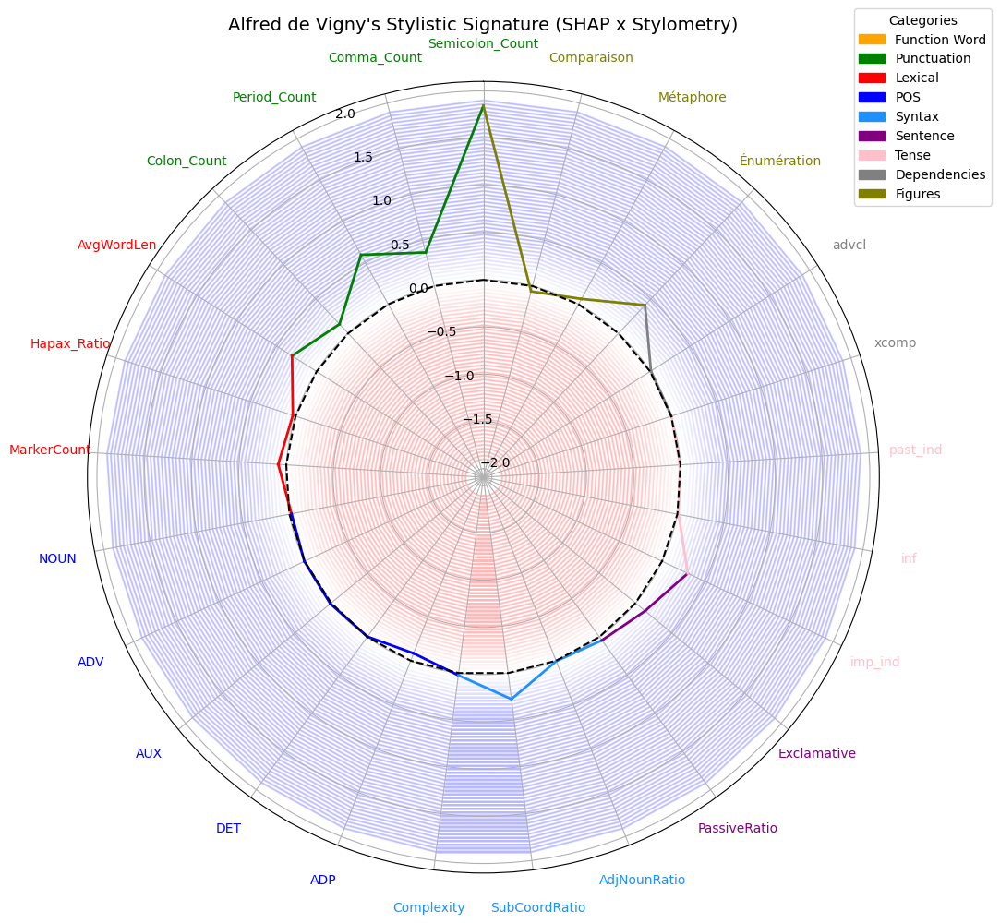

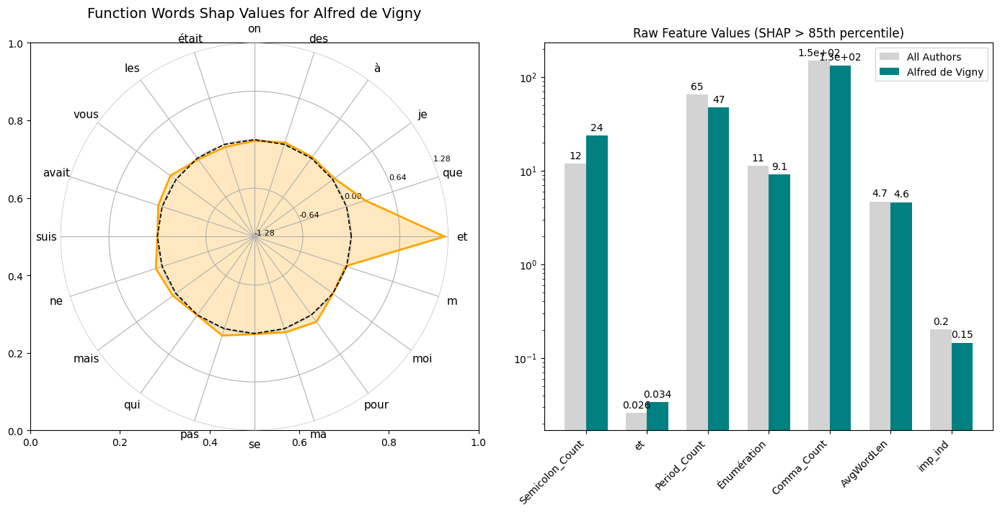

### 🔍 Interpretation Summary for **Alfred de Vigny** - Top features with shap values above the 85th percentile)

**1. `Semicolon_Count`**: The average value of this feature for *Alfred de Vigny* is **higher** than the global mean (*24 vs 12*). This comparatively **higher usage** of *Semicolon_Count* is characteristic of Alfred de Vigny's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.84*).

**2. `et`**: The average value of this feature for *Alfred de Vigny* is **higher** than the global mean (*0.034 vs 0.026*). This comparatively **higher usage** of *et* is characteristic of Alfred de Vigny's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.23*).

**3. `Period_Count`**: The average value of this feature for *Alfred de Vigny* is **lower** than the global mean (*47 vs 65*). This comparatively **lower usage** of *Period_Count* is characteristic of Alfred de Vigny's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.60*).

**4. `Énumération`**: The average value of this feature for *Alfred de Vigny* is **lower** than the global mean (*9.1 vs 11*). This comparatively **lower usage** of *Énumération* is characteristic of Alfred de Vigny's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.41*).

**5. `Comma_Count`**: The average value of this feature for *Alfred de Vigny* is **lower** than the global mean (*1.3e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of Alfred de Vigny's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.37*).

**6. `AvgWordLen`**: The average value of this feature for *Alfred de Vigny* is **lower** than the global mean (*4.6 vs 4.7*). This comparatively **lower usage** of *AvgWordLen* is characteristic of Alfred de Vigny's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.31*).

**7. `imp_ind`**: The average value of this feature for *Alfred de Vigny* is **lower** than the global mean (*0.15 vs 0.2*). This comparatively **lower usage** of *imp_ind* is characteristic of Alfred de Vigny's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.30*).

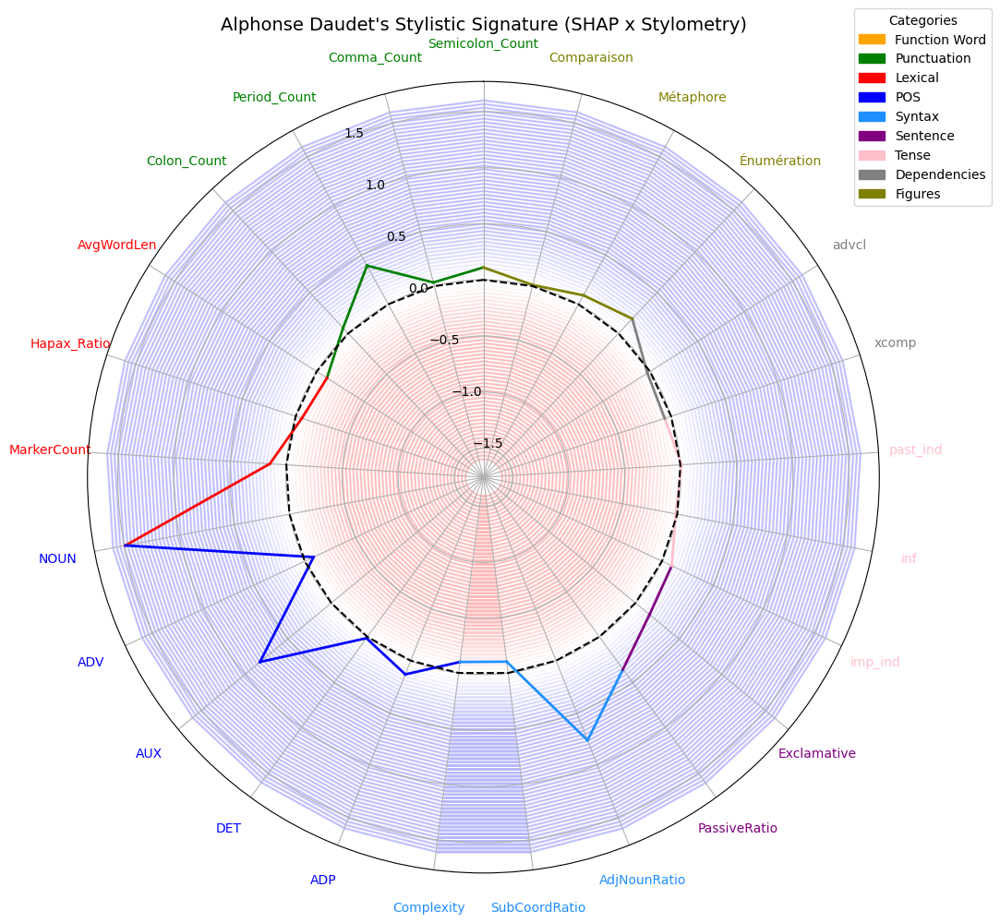

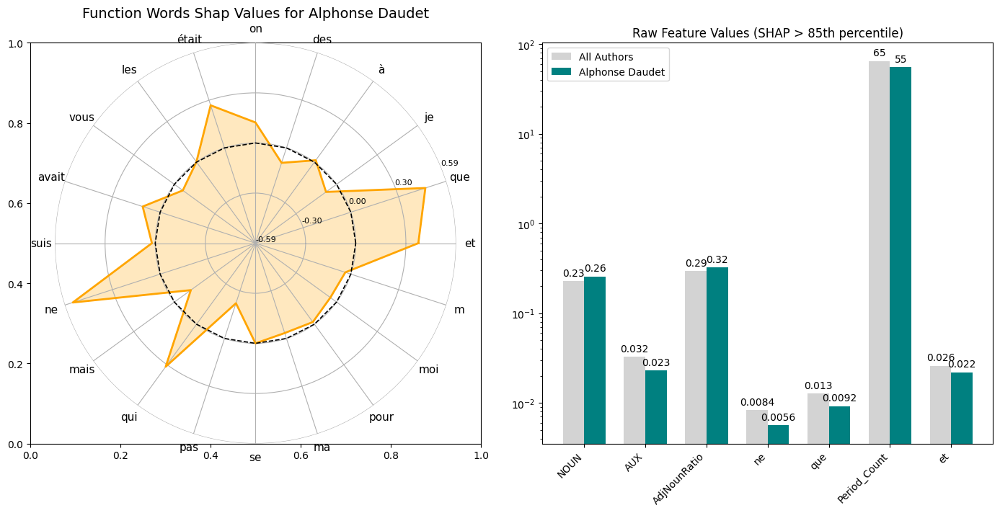

### 🔍 Interpretation Summary for **Alphonse Daudet** - Top features with shap values above the 85th percentile)

**1. `NOUN`**: The average value of this feature for *Alphonse Daudet* is **higher** than the global mean (*0.26 vs 0.23*). This comparatively **higher usage** of *NOUN* is characteristic of Alphonse Daudet's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.49*).

**2. `AUX`**: The average value of this feature for *Alphonse Daudet* is **lower** than the global mean (*0.023 vs 0.032*). This comparatively **lower usage** of *AUX* is characteristic of Alphonse Daudet's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.83*).

**3. `AdjNounRatio`**: The average value of this feature for *Alphonse Daudet* is **higher** than the global mean (*0.32 vs 0.29*). This comparatively **higher usage** of *AdjNounRatio* is characteristic of Alphonse Daudet's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.76*).

**4. `ne`**: The average value of this feature for *Alphonse Daudet* is **lower** than the global mean (*0.0056 vs 0.0084*). This comparatively **lower usage** of *ne* is characteristic of Alphonse Daudet's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.54*).

**5. `que`**: The average value of this feature for *Alphonse Daudet* is **lower** than the global mean (*0.0092 vs 0.013*). This comparatively **lower usage** of *que* is characteristic of Alphonse Daudet's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.46*).

**6. `Period_Count`**: The average value of this feature for *Alphonse Daudet* is **lower** than the global mean (*55 vs 65*). This comparatively **lower usage** of *Period_Count* is characteristic of Alphonse Daudet's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.39*).

**7. `et`**: The average value of this feature for *Alphonse Daudet* is **lower** than the global mean (*0.022 vs 0.026*). This comparatively **lower usage** of *et* is characteristic of Alphonse Daudet's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.37*).

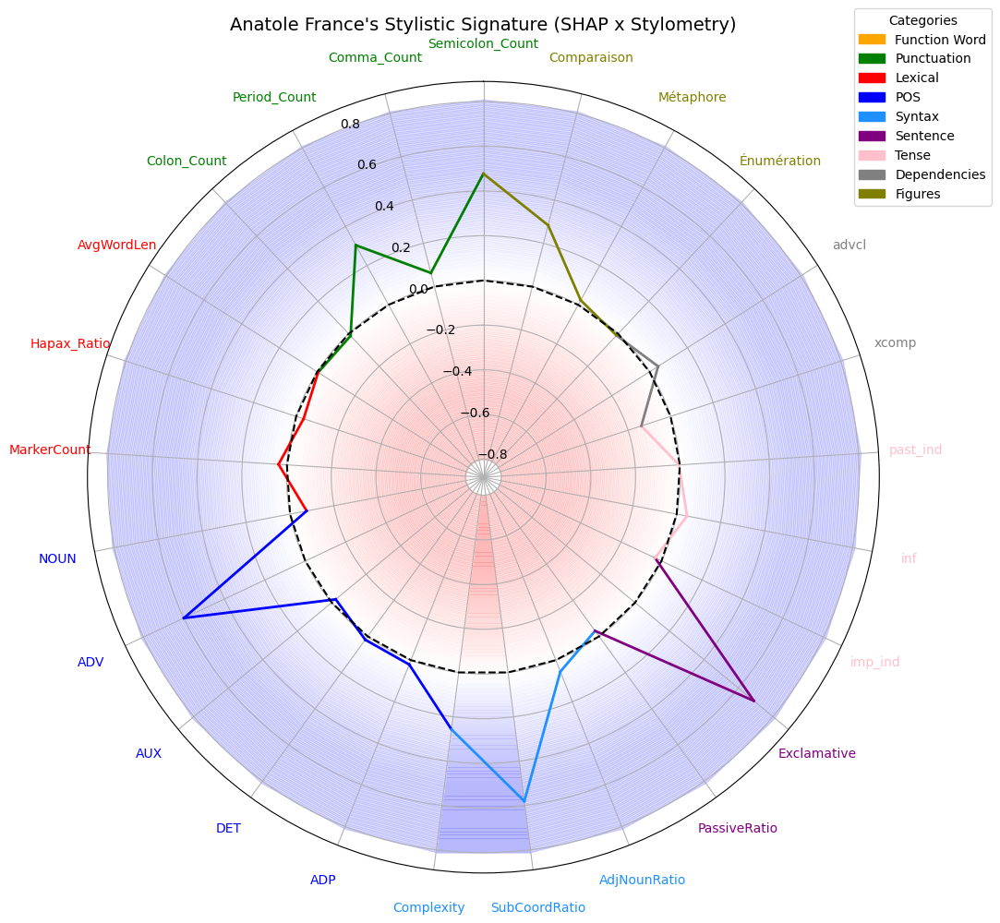

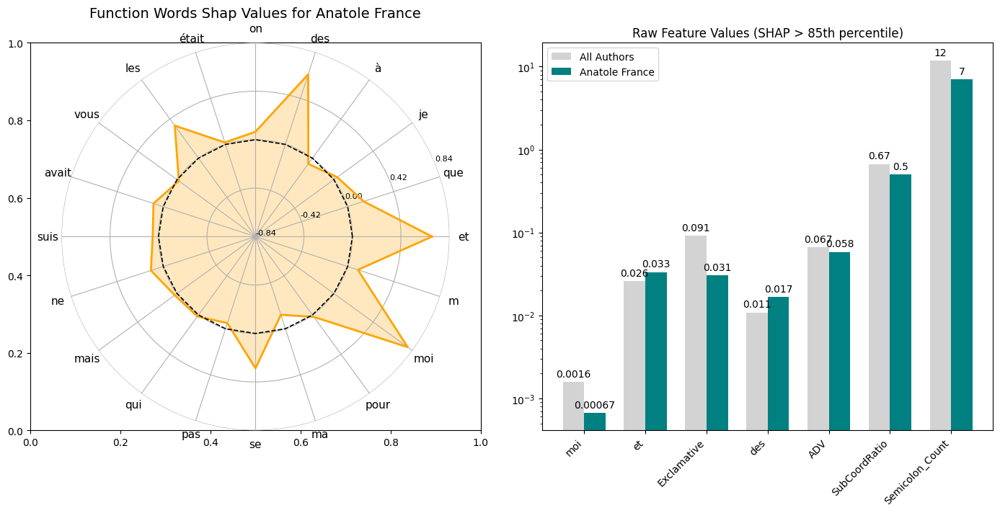

### 🔍 Interpretation Summary for **Anatole France** - Top features with shap values above the 85th percentile)

**1. `moi`**: The average value of this feature for *Anatole France* is **lower** than the global mean (*6.7e-04 vs 0.0016*). This comparatively **lower usage** of *moi* is characteristic of Anatole France's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 0.79*).

**2. `et`**: The average value of this feature for *Anatole France* is **higher** than the global mean (*0.033 vs 0.026*). This comparatively **higher usage** of *et* is characteristic of Anatole France's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.69*).

**3. `Exclamative`**: The average value of this feature for *Anatole France* is **lower** than the global mean (*0.031 vs 0.091*). This comparatively **lower usage** of *Exclamative* is characteristic of Anatole France's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.69*).

**4. `des`**: The average value of this feature for *Anatole France* is **higher** than the global mean (*0.017 vs 0.011*). This comparatively **higher usage** of *des* is characteristic of Anatole France's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.64*).

**5. `ADV`**: The average value of this feature for *Anatole France* is **lower** than the global mean (*0.058 vs 0.067*). This comparatively **lower usage** of *ADV* is characteristic of Anatole France's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.60*).

**6. `SubCoordRatio`**: The average value of this feature for *Anatole France* is **lower** than the global mean (*0.5 vs 0.67*). This comparatively **lower usage** of *SubCoordRatio* is characteristic of Anatole France's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.58*).

**7. `Semicolon_Count`**: The average value of this feature for *Anatole France* is **lower** than the global mean (*7 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Anatole France's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.48*).

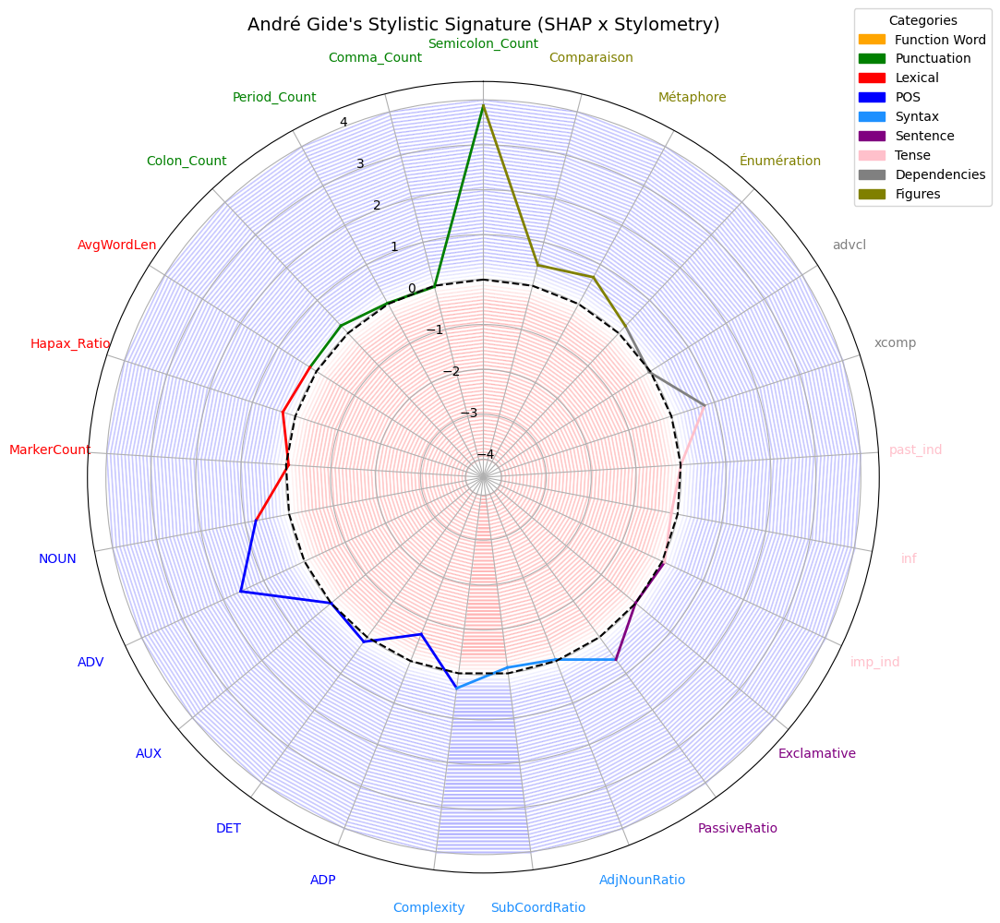

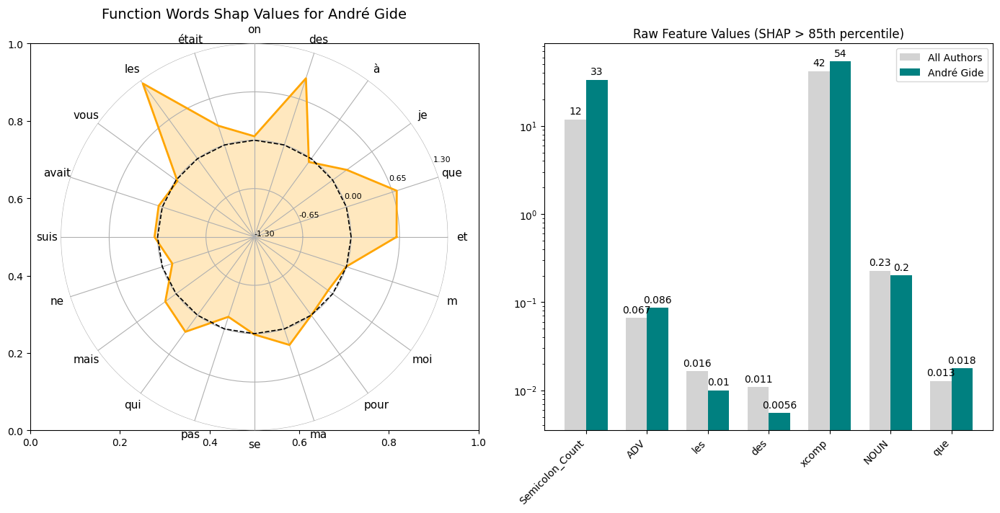

### 🔍 Interpretation Summary for **André Gide** - Top features with shap values above the 85th percentile)

**1. `Semicolon_Count`**: The average value of this feature for *André Gide* is **higher** than the global mean (*33 vs 12*). This comparatively **higher usage** of *Semicolon_Count* is characteristic of André Gide's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 3.87*).

**2. `ADV`**: The average value of this feature for *André Gide* is **higher** than the global mean (*0.086 vs 0.067*). This comparatively **higher usage** of *ADV* is characteristic of André Gide's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.57*).

**3. `les`**: The average value of this feature for *André Gide* is **lower** than the global mean (*0.01 vs 0.016*). This comparatively **lower usage** of *les* is characteristic of André Gide's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.25*).

**4. `des`**: The average value of this feature for *André Gide* is **lower** than the global mean (*0.0056 vs 0.011*). This comparatively **lower usage** of *des* is characteristic of André Gide's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.94*).

**5. `xcomp`**: The average value of this feature for *André Gide* is **higher** than the global mean (*54 vs 42*). This comparatively **higher usage** of *xcomp* is characteristic of André Gide's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.78*).

**6. `NOUN`**: The average value of this feature for *André Gide* is **lower** than the global mean (*0.2 vs 0.23*). This comparatively **lower usage** of *NOUN* is characteristic of André Gide's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.75*).

**7. `que`**: The average value of this feature for *André Gide* is **higher** than the global mean (*0.018 vs 0.013*). This comparatively **higher usage** of *que* is characteristic of André Gide's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.71*).

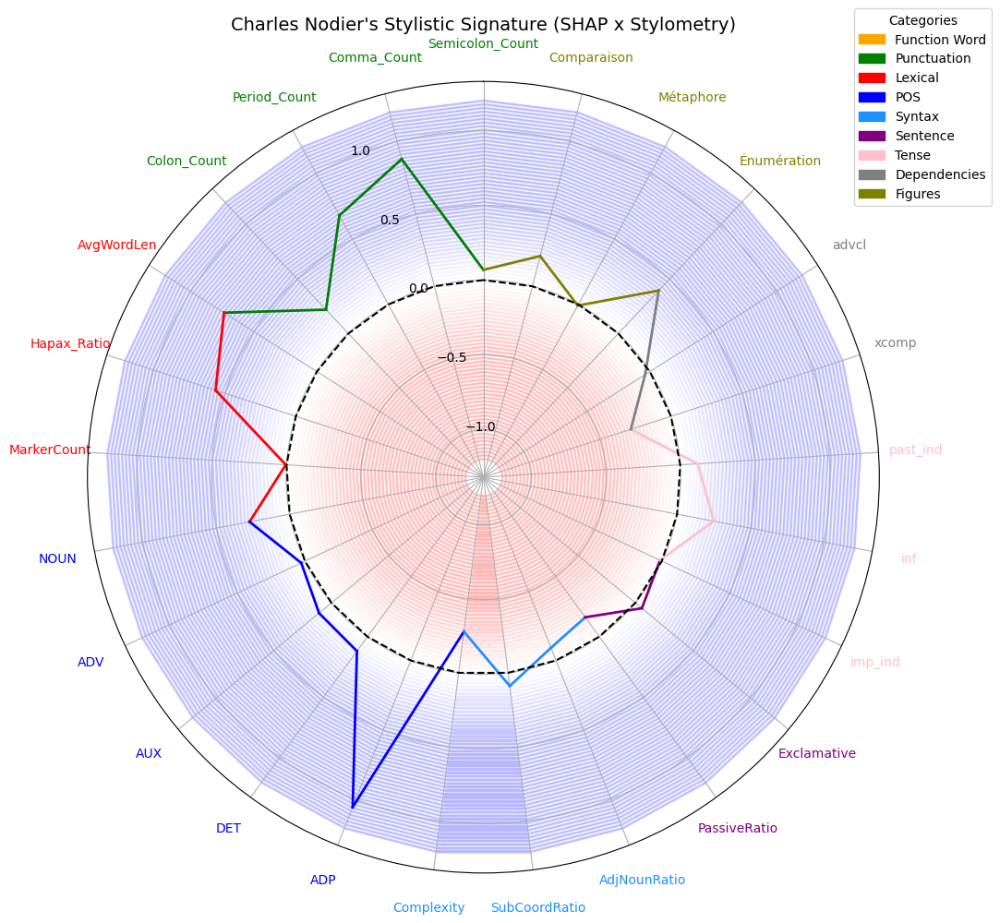

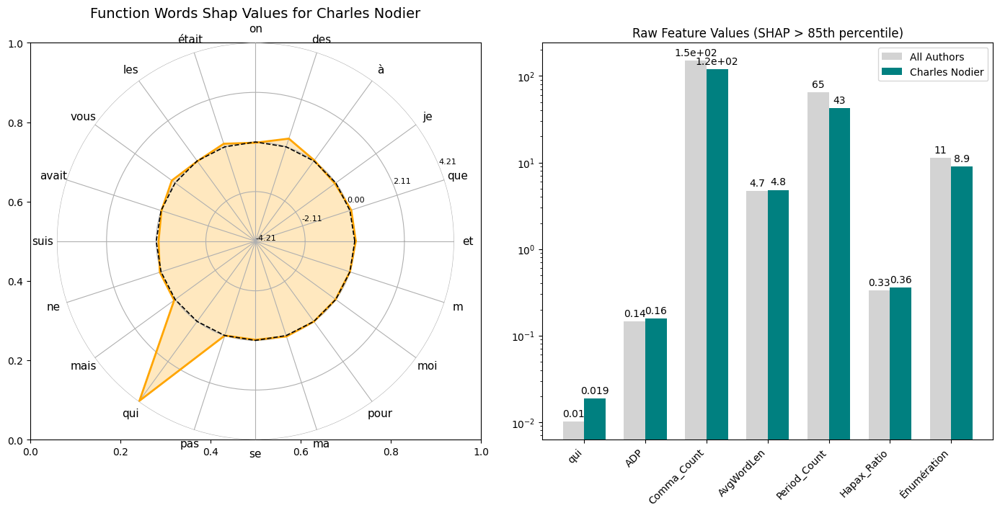

### 🔍 Interpretation Summary for **Charles Nodier** - Top features with shap values above the 85th percentile)

**1. `qui`**: The average value of this feature for *Charles Nodier* is **higher** than the global mean (*0.019 vs 0.01*). This comparatively **higher usage** of *qui* is characteristic of Charles Nodier's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 4.16*).

**2. `ADP`**: The average value of this feature for *Charles Nodier* is **higher** than the global mean (*0.16 vs 0.14*). This comparatively **higher usage** of *ADP* is characteristic of Charles Nodier's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.06*).

**3. `Comma_Count`**: The average value of this feature for *Charles Nodier* is **lower** than the global mean (*1.2e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of Charles Nodier's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.88*).

**4. `AvgWordLen`**: The average value of this feature for *Charles Nodier* is **higher** than the global mean (*4.8 vs 4.7*). This comparatively **higher usage** of *AvgWordLen* is characteristic of Charles Nodier's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.74*).

**5. `Period_Count`**: The average value of this feature for *Charles Nodier* is **lower** than the global mean (*43 vs 65*). This comparatively **lower usage** of *Period_Count* is characteristic of Charles Nodier's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.68*).

**6. `Hapax_Ratio`**: The average value of this feature for *Charles Nodier* is **higher** than the global mean (*0.36 vs 0.33*). This comparatively **higher usage** of *Hapax_Ratio* is characteristic of Charles Nodier's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.56*).

**7. `Énumération`**: The average value of this feature for *Charles Nodier* is **lower** than the global mean (*8.9 vs 11*). This comparatively **lower usage** of *Énumération* is characteristic of Charles Nodier's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.39*).

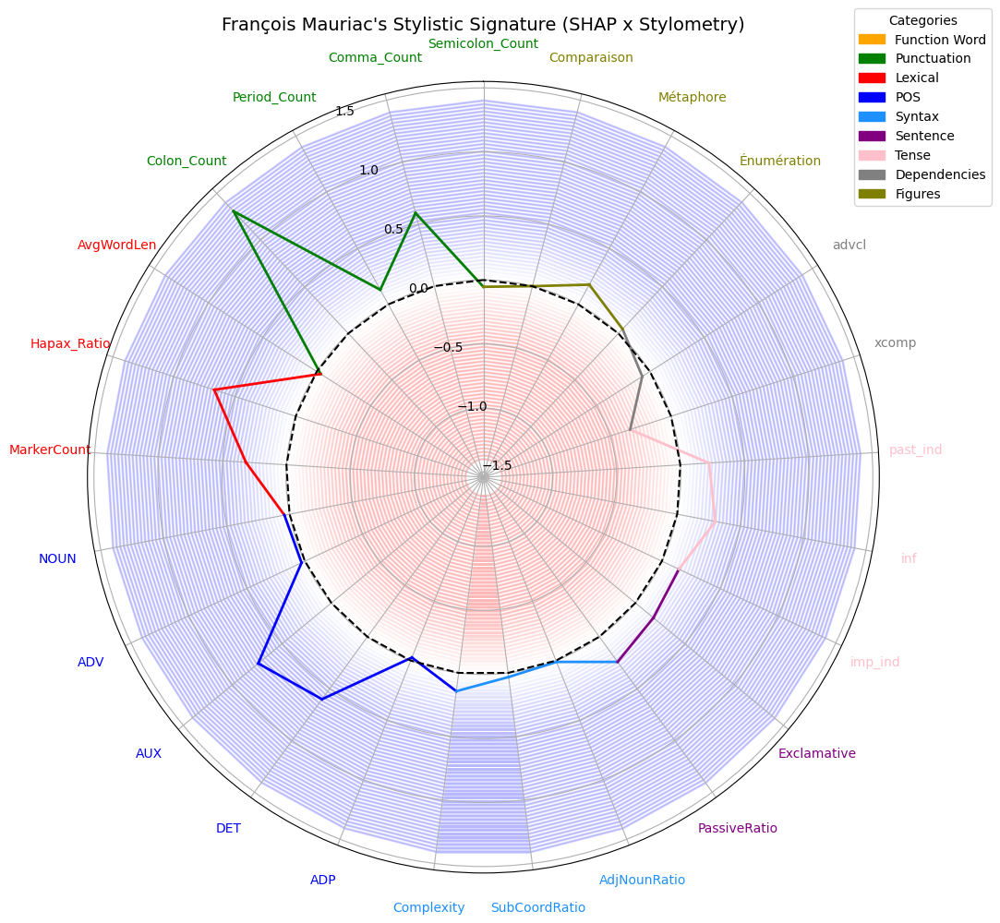

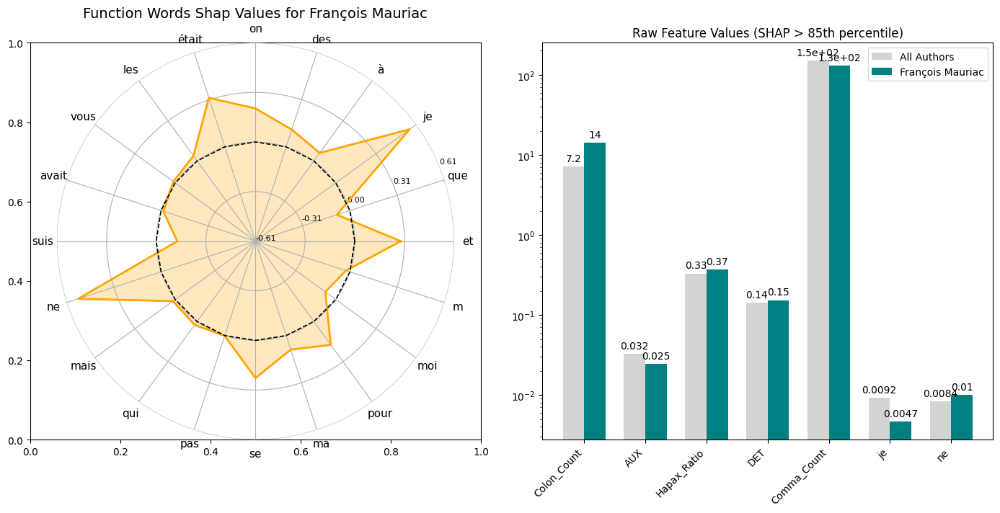

### 🔍 Interpretation Summary for **François Mauriac** - Top features with shap values above the 85th percentile)

**1. `Colon_Count`**: The average value of this feature for *François Mauriac* is **higher** than the global mean (*14 vs 7.2*). This comparatively **higher usage** of *Colon_Count* is characteristic of François Mauriac's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.31*).

**2. `AUX`**: The average value of this feature for *François Mauriac* is **lower** than the global mean (*0.025 vs 0.032*). This comparatively **lower usage** of *AUX* is characteristic of François Mauriac's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.74*).

**3. `Hapax_Ratio`**: The average value of this feature for *François Mauriac* is **higher** than the global mean (*0.37 vs 0.33*). This comparatively **higher usage** of *Hapax_Ratio* is characteristic of François Mauriac's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.67*).

**4. `DET`**: The average value of this feature for *François Mauriac* is **higher** than the global mean (*0.15 vs 0.14*). This comparatively **higher usage** of *DET* is characteristic of François Mauriac's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.60*).

**5. `Comma_Count`**: The average value of this feature for *François Mauriac* is **lower** than the global mean (*1.3e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of François Mauriac's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.59*).

**6. `je`**: The average value of this feature for *François Mauriac* is **lower** than the global mean (*0.0047 vs 0.0092*). This comparatively **lower usage** of *je* is characteristic of François Mauriac's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.56*).

**7. `ne`**: The average value of this feature for *François Mauriac* is **higher** than the global mean (*0.01 vs 0.0084*). This comparatively **higher usage** of *ne* is characteristic of François Mauriac's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.54*).

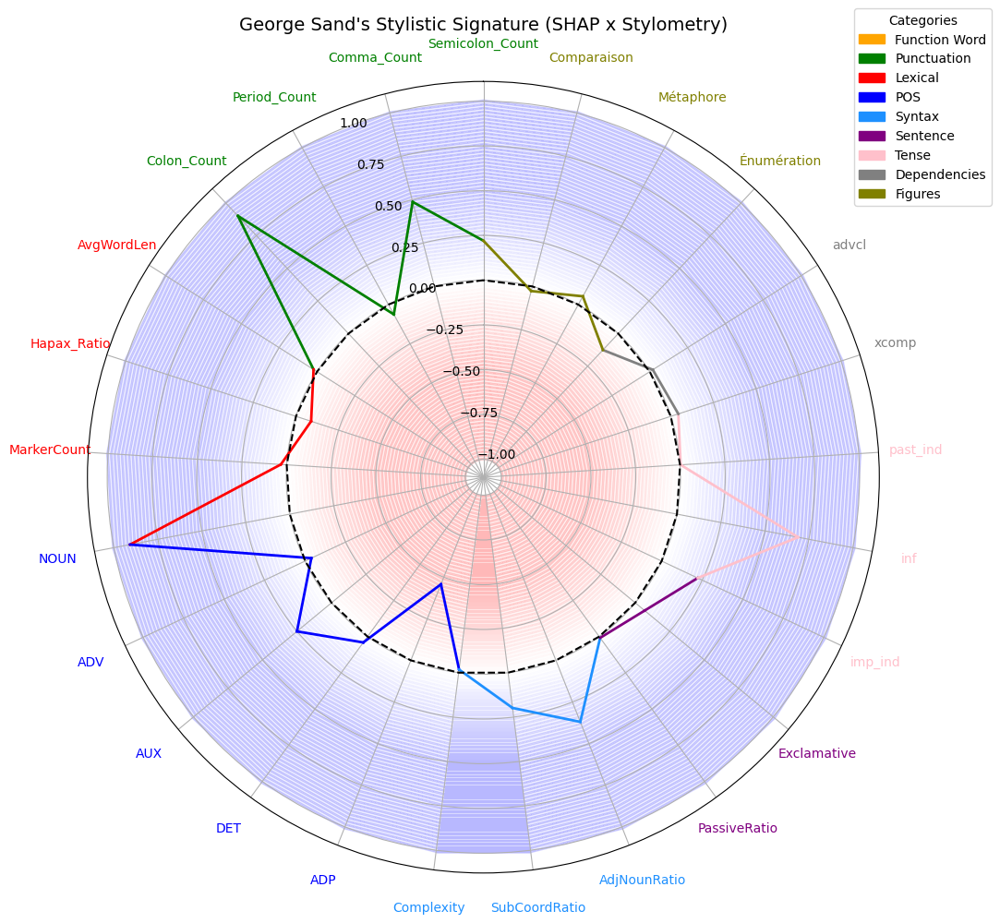

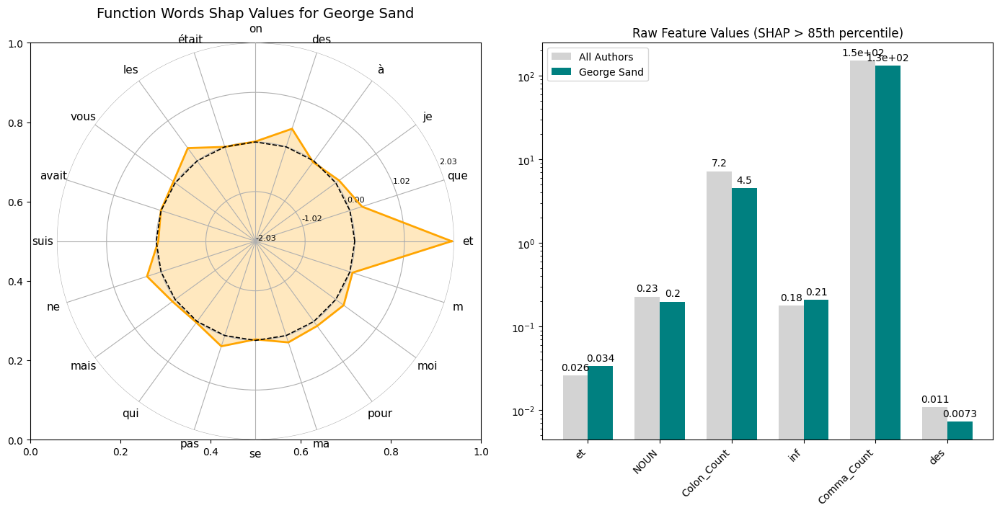

### 🔍 Interpretation Summary for **George Sand** - Top features with shap values above the 85th percentile)

**1. `et`**: The average value of this feature for *George Sand* is **higher** than the global mean (*0.034 vs 0.026*). This comparatively **higher usage** of *et* is characteristic of George Sand's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.98*).

**2. `NOUN`**: The average value of this feature for *George Sand* is **lower** than the global mean (*0.2 vs 0.23*). This comparatively **lower usage** of *NOUN* is characteristic of George Sand's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.91*).

**3. `Colon_Count`**: The average value of this feature for *George Sand* is **lower** than the global mean (*4.5 vs 7.2*). This comparatively **lower usage** of *Colon_Count* is characteristic of George Sand's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.90*).

**4. `inf`**: The average value of this feature for *George Sand* is **higher** than the global mean (*0.21 vs 0.18*). This comparatively **higher usage** of *inf* is characteristic of George Sand's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.69*).

**5. `Comma_Count`**: The average value of this feature for *George Sand* is **lower** than the global mean (*1.3e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of George Sand's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.49*).

**6. `ADP`**: The average value of this feature for *George Sand* is **lower** than the global mean (*0.14 vs 0.14*). This comparatively **lower usage** of *ADP* is characteristic of George Sand's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: -0.46*).

**7. `des`**: The average value of this feature for *George Sand* is **lower** than the global mean (*0.0073 vs 0.011*). This comparatively **lower usage** of *des* is characteristic of George Sand's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.39*).

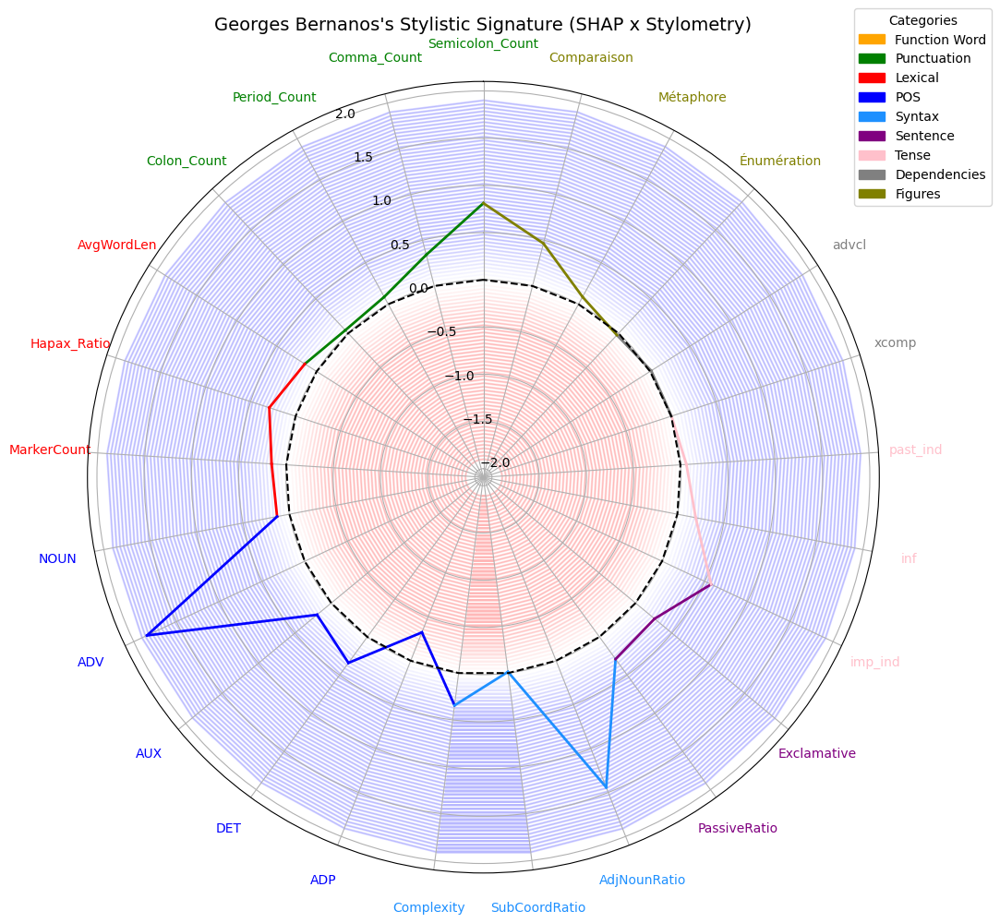

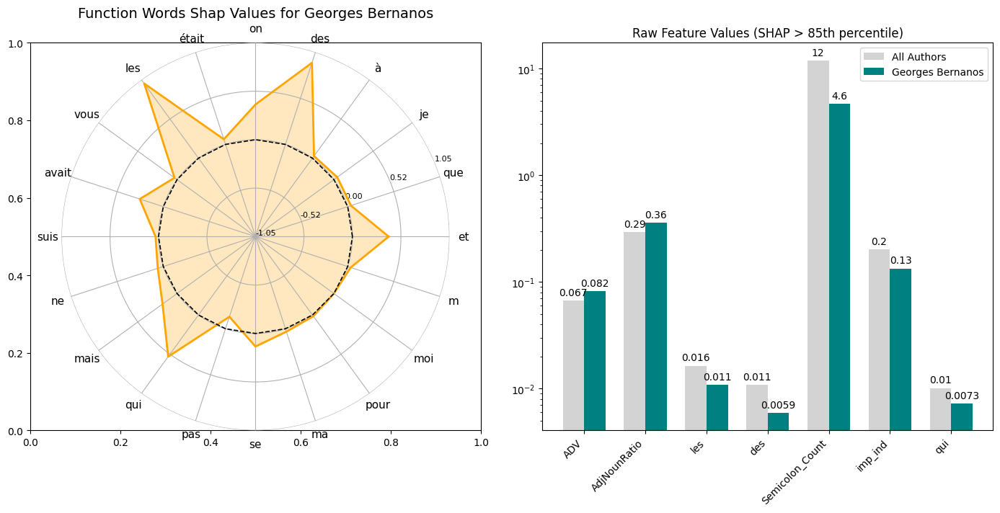

### 🔍 Interpretation Summary for **Georges Bernanos** - Top features with shap values above the 85th percentile)

**1. `ADV`**: The average value of this feature for *Georges Bernanos* is **higher** than the global mean (*0.082 vs 0.067*). This comparatively **higher usage** of *ADV* is characteristic of Georges Bernanos's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.84*).

**2. `AdjNounRatio`**: The average value of this feature for *Georges Bernanos* is **higher** than the global mean (*0.36 vs 0.29*). This comparatively **higher usage** of *AdjNounRatio* is characteristic of Georges Bernanos's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.44*).

**3. `les`**: The average value of this feature for *Georges Bernanos* is **lower** than the global mean (*0.011 vs 0.016*). This comparatively **lower usage** of *les* is characteristic of Georges Bernanos's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.00*).

**4. `des`**: The average value of this feature for *Georges Bernanos* is **lower** than the global mean (*0.0059 vs 0.011*). This comparatively **lower usage** of *des* is characteristic of Georges Bernanos's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.93*).

**5. `Semicolon_Count`**: The average value of this feature for *Georges Bernanos* is **lower** than the global mean (*4.6 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Georges Bernanos's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.81*).

**6. `imp_ind`**: The average value of this feature for *Georges Bernanos* is **lower** than the global mean (*0.13 vs 0.2*). This comparatively **lower usage** of *imp_ind* is characteristic of Georges Bernanos's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.57*).

**7. `qui`**: The average value of this feature for *Georges Bernanos* is **lower** than the global mean (*0.0073 vs 0.01*). This comparatively **lower usage** of *qui* is characteristic of Georges Bernanos's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.56*).

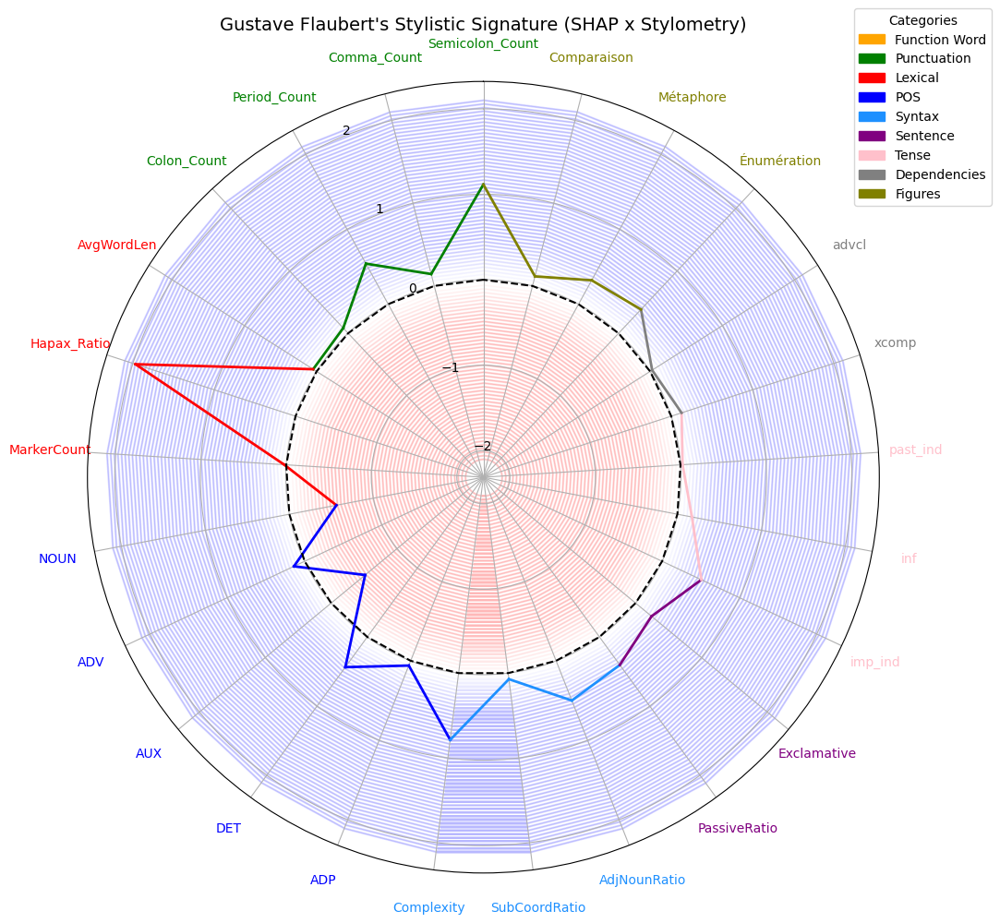

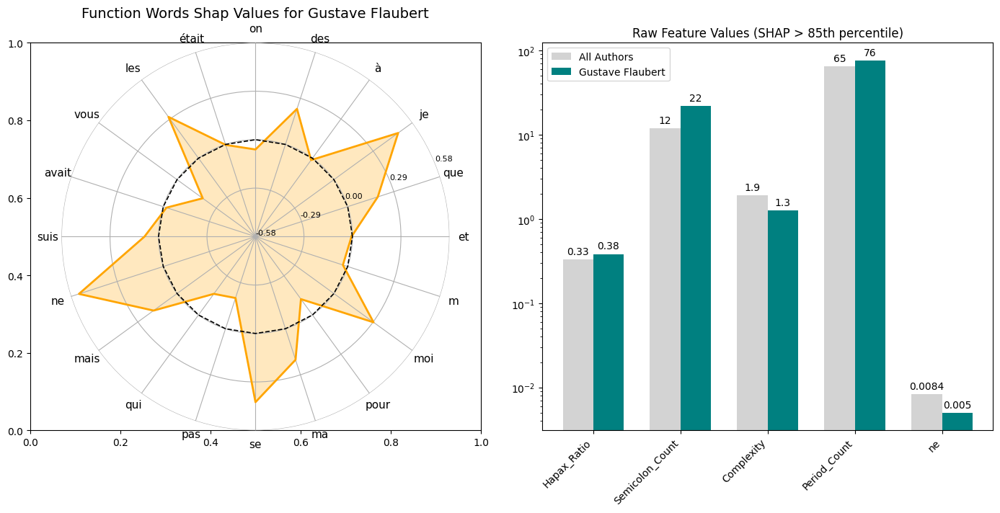

### 🔍 Interpretation Summary for **Gustave Flaubert** - Top features with shap values above the 85th percentile)

**1. `Hapax_Ratio`**: The average value of this feature for *Gustave Flaubert* is **higher** than the global mean (*0.38 vs 0.33*). This comparatively **higher usage** of *Hapax_Ratio* is characteristic of Gustave Flaubert's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.97*).

**2. `Semicolon_Count`**: The average value of this feature for *Gustave Flaubert* is **higher** than the global mean (*22 vs 12*). This comparatively **higher usage** of *Semicolon_Count* is characteristic of Gustave Flaubert's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.11*).

**3. `Complexity`**: The average value of this feature for *Gustave Flaubert* is **lower** than the global mean (*1.3 vs 1.9*). This comparatively **lower usage** of *Complexity* is characteristic of Gustave Flaubert's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.79*).

**4. `NOUN`**: The average value of this feature for *Gustave Flaubert* is **higher** than the global mean (*0.25 vs 0.23*). This comparatively **higher usage** of *NOUN* is characteristic of Gustave Flaubert's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: -0.56*).

**5. `Period_Count`**: The average value of this feature for *Gustave Flaubert* is **higher** than the global mean (*76 vs 65*). This comparatively **higher usage** of *Period_Count* is characteristic of Gustave Flaubert's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.54*).

**6. `ne`**: The average value of this feature for *Gustave Flaubert* is **lower** than the global mean (*0.005 vs 0.0084*). This comparatively **lower usage** of *ne* is characteristic of Gustave Flaubert's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.53*).

**7. `AUX`**: The average value of this feature for *Gustave Flaubert* is **lower** than the global mean (*0.024 vs 0.032*). This comparatively **lower usage** of *AUX* is characteristic of Gustave Flaubert's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: -0.52*).

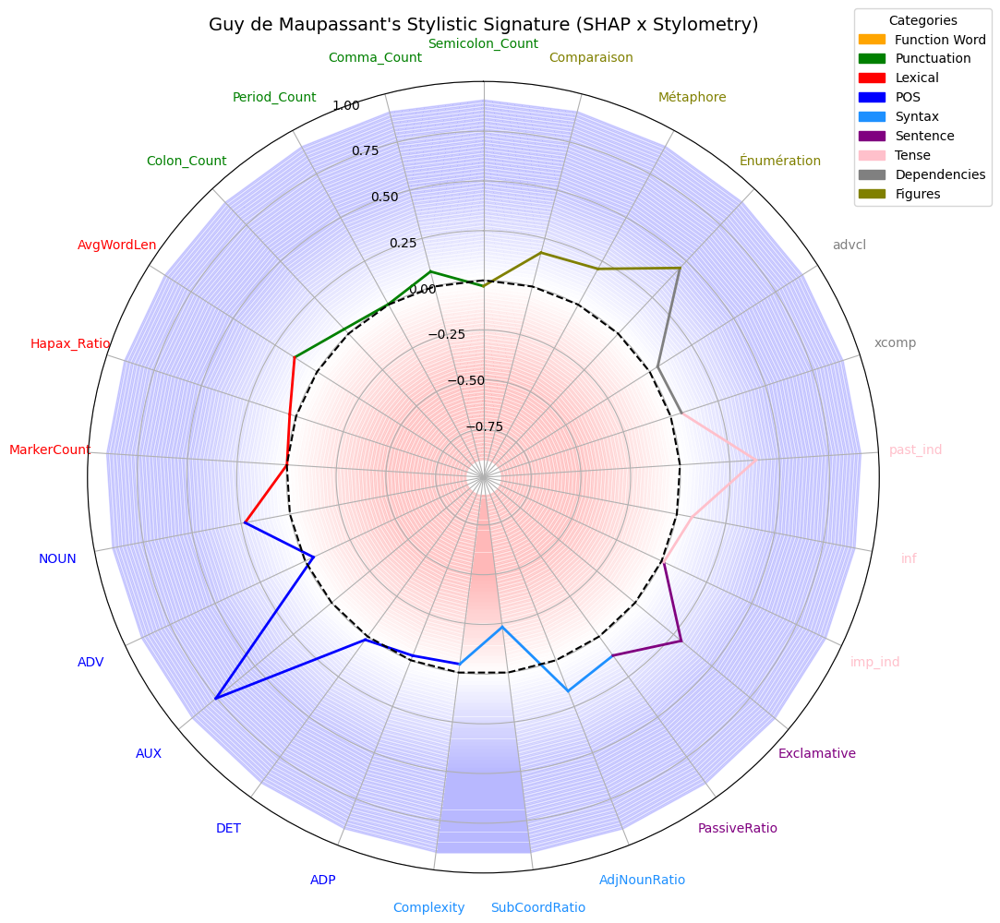

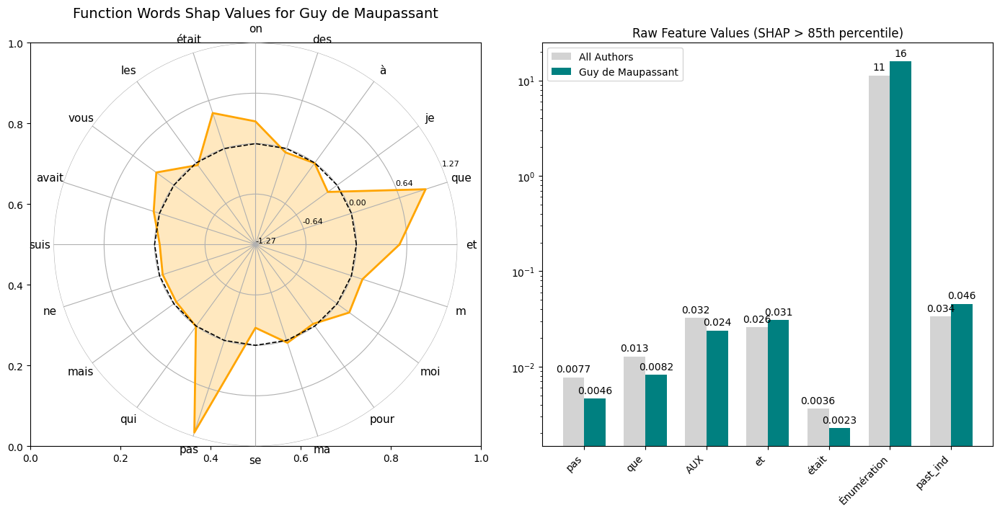

### 🔍 Interpretation Summary for **Guy de Maupassant** - Top features with shap values above the 85th percentile)

**1. `pas`**: The average value of this feature for *Guy de Maupassant* is **lower** than the global mean (*0.0046 vs 0.0077*). This comparatively **lower usage** of *pas* is characteristic of Guy de Maupassant's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.22*).

**2. `que`**: The average value of this feature for *Guy de Maupassant* is **lower** than the global mean (*0.0082 vs 0.013*). This comparatively **lower usage** of *que* is characteristic of Guy de Maupassant's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.98*).

**3. `AUX`**: The average value of this feature for *Guy de Maupassant* is **lower** than the global mean (*0.024 vs 0.032*). This comparatively **lower usage** of *AUX* is characteristic of Guy de Maupassant's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.76*).

**4. `et`**: The average value of this feature for *Guy de Maupassant* is **higher** than the global mean (*0.031 vs 0.026*). This comparatively **higher usage** of *et* is characteristic of Guy de Maupassant's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.54*).

**5. `était`**: The average value of this feature for *Guy de Maupassant* is **lower** than the global mean (*0.0023 vs 0.0036*). This comparatively **lower usage** of *était* is characteristic of Guy de Maupassant's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.47*).

**6. `Énumération`**: The average value of this feature for *Guy de Maupassant* is **higher** than the global mean (*16 vs 11*). This comparatively **higher usage** of *Énumération* is characteristic of Guy de Maupassant's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.45*).

**7. `past_ind`**: The average value of this feature for *Guy de Maupassant* is **higher** than the global mean (*0.046 vs 0.034*). This comparatively **higher usage** of *past_ind* is characteristic of Guy de Maupassant's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.38*).

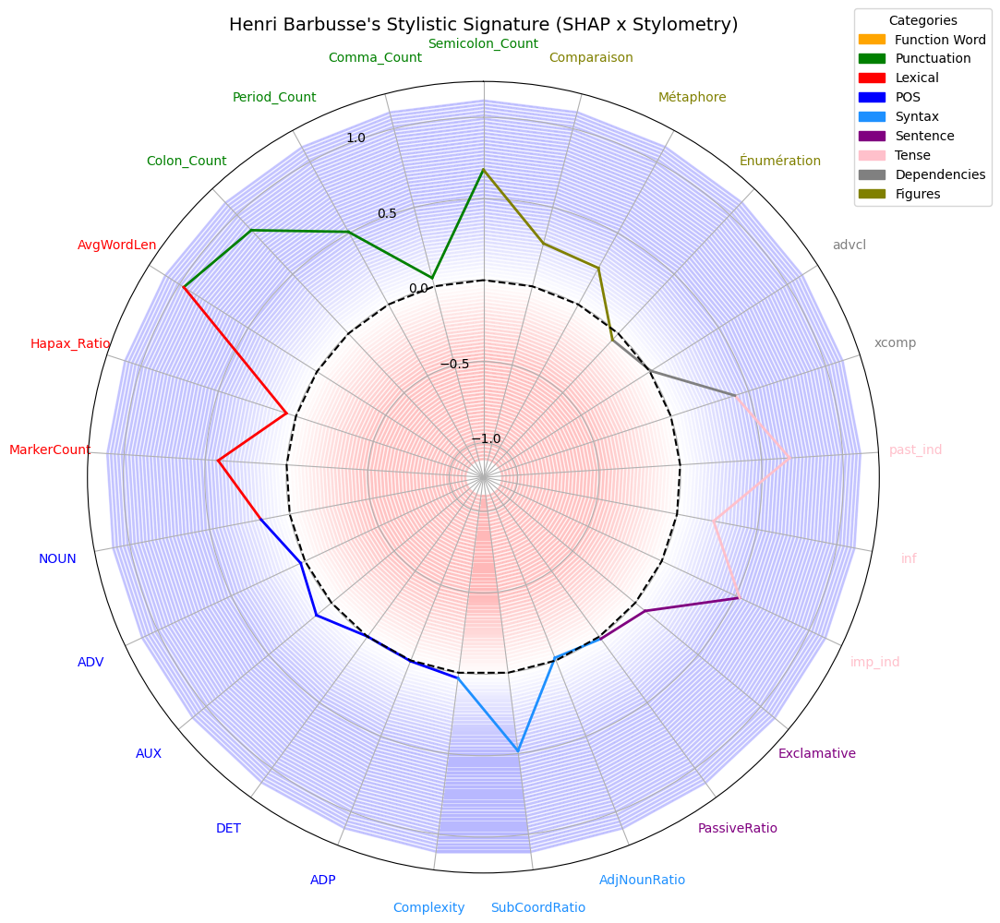

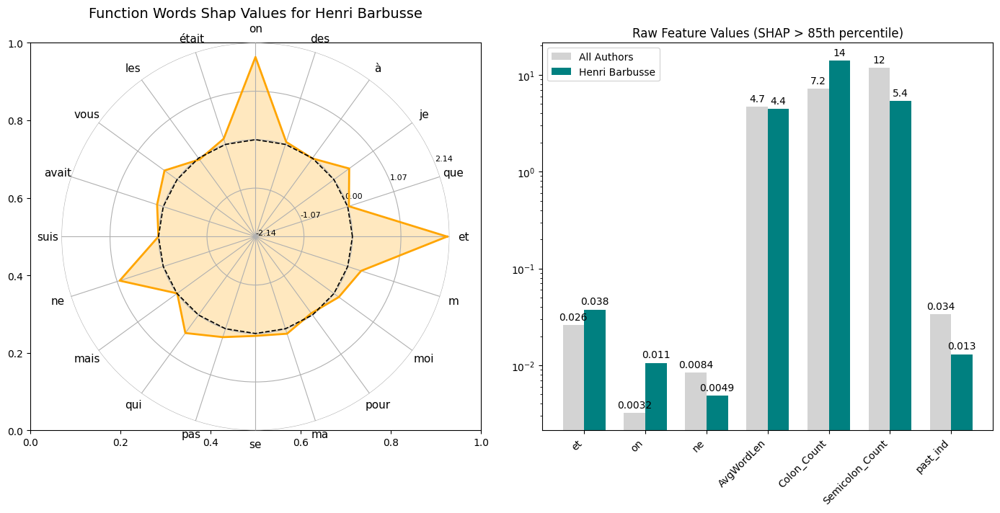

### 🔍 Interpretation Summary for **Henri Barbusse** - Top features with shap values above the 85th percentile)

**1. `et`**: The average value of this feature for *Henri Barbusse* is **higher** than the global mean (*0.038 vs 0.026*). This comparatively **higher usage** of *et* is characteristic of Henri Barbusse's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 2.09*).

**2. `on`**: The average value of this feature for *Henri Barbusse* is **higher** than the global mean (*0.011 vs 0.0032*). This comparatively **higher usage** of *on* is characteristic of Henri Barbusse's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.82*).

**3. `ne`**: The average value of this feature for *Henri Barbusse* is **lower** than the global mean (*0.0049 vs 0.0084*). This comparatively **lower usage** of *ne* is characteristic of Henri Barbusse's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.01*).

**4. `AvgWordLen`**: The average value of this feature for *Henri Barbusse* is **lower** than the global mean (*4.4 vs 4.7*). This comparatively **lower usage** of *AvgWordLen* is characteristic of Henri Barbusse's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.97*).

**5. `Colon_Count`**: The average value of this feature for *Henri Barbusse* is **higher** than the global mean (*14 vs 7.2*). This comparatively **higher usage** of *Colon_Count* is characteristic of Henri Barbusse's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.87*).

**6. `Semicolon_Count`**: The average value of this feature for *Henri Barbusse* is **lower** than the global mean (*5.4 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Henri Barbusse's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.68*).

**7. `past_ind`**: The average value of this feature for *Henri Barbusse* is **lower** than the global mean (*0.013 vs 0.034*). This comparatively **lower usage** of *past_ind* is characteristic of Henri Barbusse's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.67*).

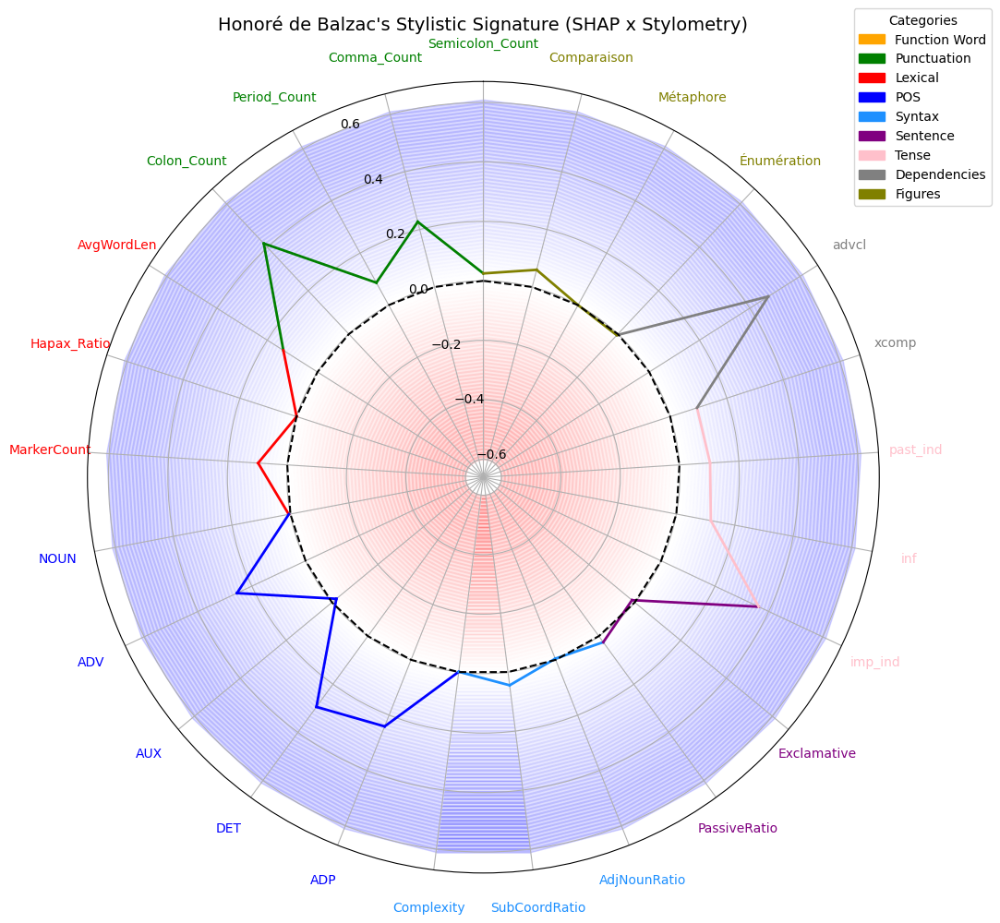

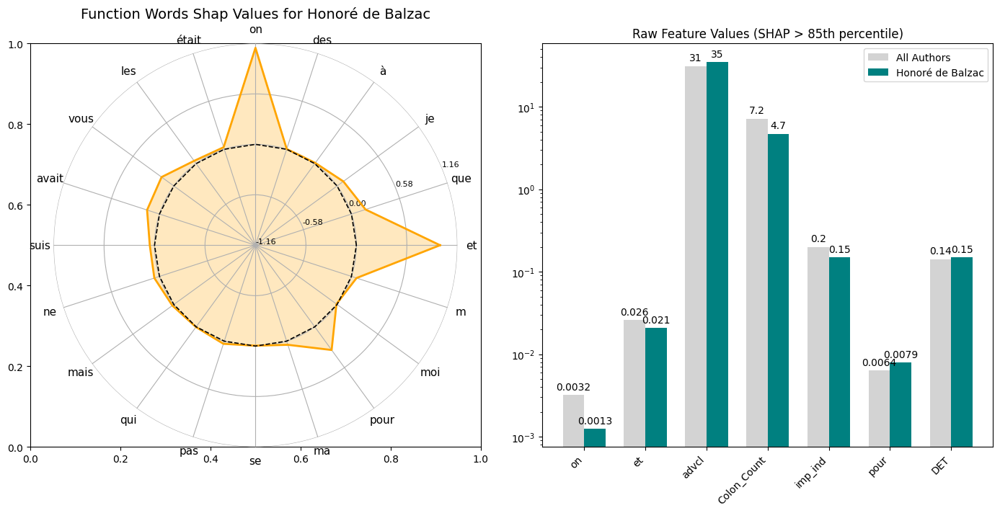

### 🔍 Interpretation Summary for **Honoré de Balzac** - Top features with shap values above the 85th percentile)

**1. `on`**: The average value of this feature for *Honoré de Balzac* is **lower** than the global mean (*0.0013 vs 0.0032*). This comparatively **lower usage** of *on* is characteristic of Honoré de Balzac's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.11*).

**2. `et`**: The average value of this feature for *Honoré de Balzac* is **lower** than the global mean (*0.021 vs 0.026*). This comparatively **lower usage** of *et* is characteristic of Honoré de Balzac's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.96*).

**3. `advcl`**: The average value of this feature for *Honoré de Balzac* is **higher** than the global mean (*35 vs 31*). This comparatively **higher usage** of *advcl* is characteristic of Honoré de Balzac's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.47*).

**4. `Colon_Count`**: The average value of this feature for *Honoré de Balzac* is **lower** than the global mean (*4.7 vs 7.2*). This comparatively **lower usage** of *Colon_Count* is characteristic of Honoré de Balzac's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.42*).

**5. `imp_ind`**: The average value of this feature for *Honoré de Balzac* is **lower** than the global mean (*0.15 vs 0.2*). This comparatively **lower usage** of *imp_ind* is characteristic of Honoré de Balzac's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.36*).

**6. `pour`**: The average value of this feature for *Honoré de Balzac* is **higher** than the global mean (*0.0079 vs 0.0064*). This comparatively **higher usage** of *pour* is characteristic of Honoré de Balzac's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.33*).

**7. `DET`**: The average value of this feature for *Honoré de Balzac* is **higher** than the global mean (*0.15 vs 0.14*). This comparatively **higher usage** of *DET* is characteristic of Honoré de Balzac's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.29*).

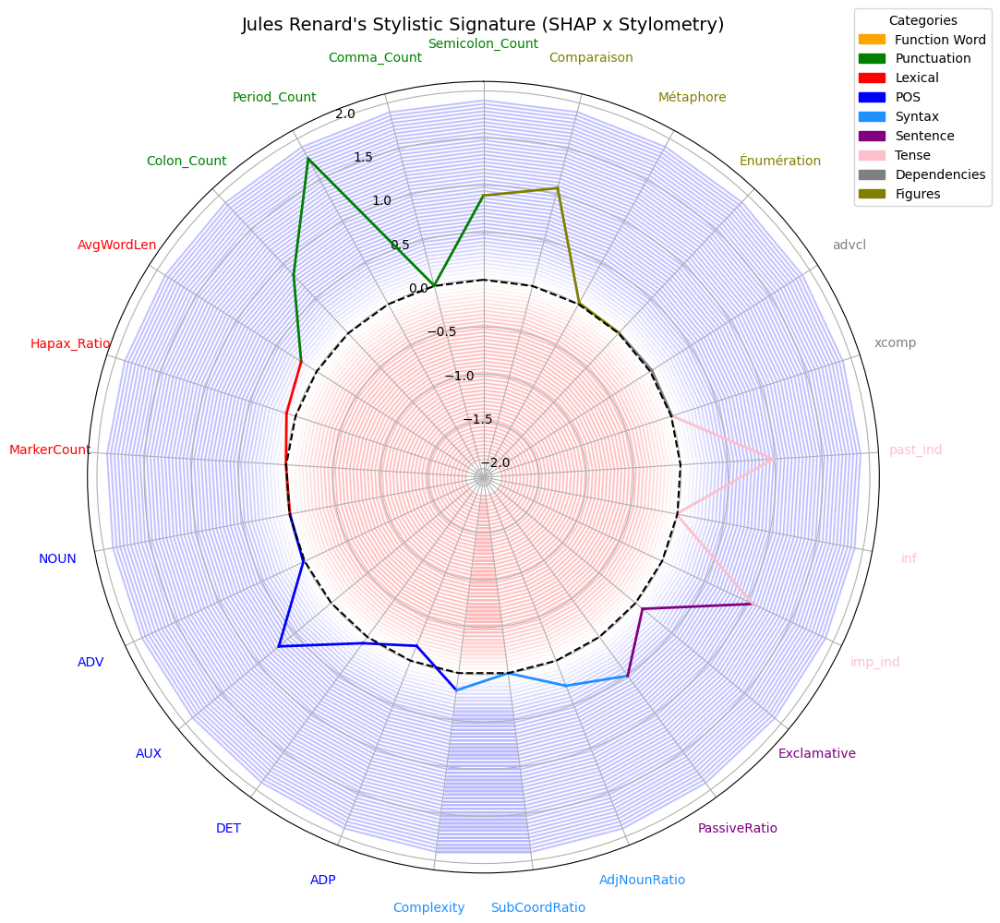

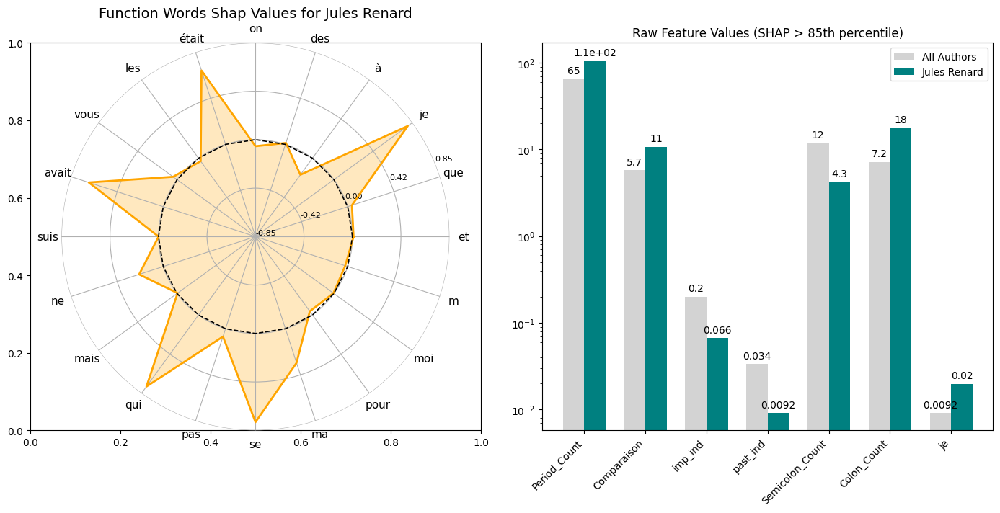

### 🔍 Interpretation Summary for **Jules Renard** - Top features with shap values above the 85th percentile)

**1. `Period_Count`**: The average value of this feature for *Jules Renard* is **higher** than the global mean (*1.1e+02 vs 65*). This comparatively **higher usage** of *Period_Count* is characteristic of Jules Renard's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.76*).

**2. `Comparaison`**: The average value of this feature for *Jules Renard* is **higher** than the global mean (*11 vs 5.7*). This comparatively **higher usage** of *Comparaison* is characteristic of Jules Renard's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.07*).

**3. `imp_ind`**: The average value of this feature for *Jules Renard* is **lower** than the global mean (*0.066 vs 0.2*). This comparatively **lower usage** of *imp_ind* is characteristic of Jules Renard's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.06*).

**4. `past_ind`**: The average value of this feature for *Jules Renard* is **lower** than the global mean (*0.0092 vs 0.034*). This comparatively **lower usage** of *past_ind* is characteristic of Jules Renard's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.98*).

**5. `Semicolon_Count`**: The average value of this feature for *Jules Renard* is **lower** than the global mean (*4.3 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Jules Renard's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.89*).

**6. `Colon_Count`**: The average value of this feature for *Jules Renard* is **higher** than the global mean (*18 vs 7.2*). This comparatively **higher usage** of *Colon_Count* is characteristic of Jules Renard's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.84*).

**7. `je`**: The average value of this feature for *Jules Renard* is **higher** than the global mean (*0.02 vs 0.0092*). This comparatively **higher usage** of *je* is characteristic of Jules Renard's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.80*).

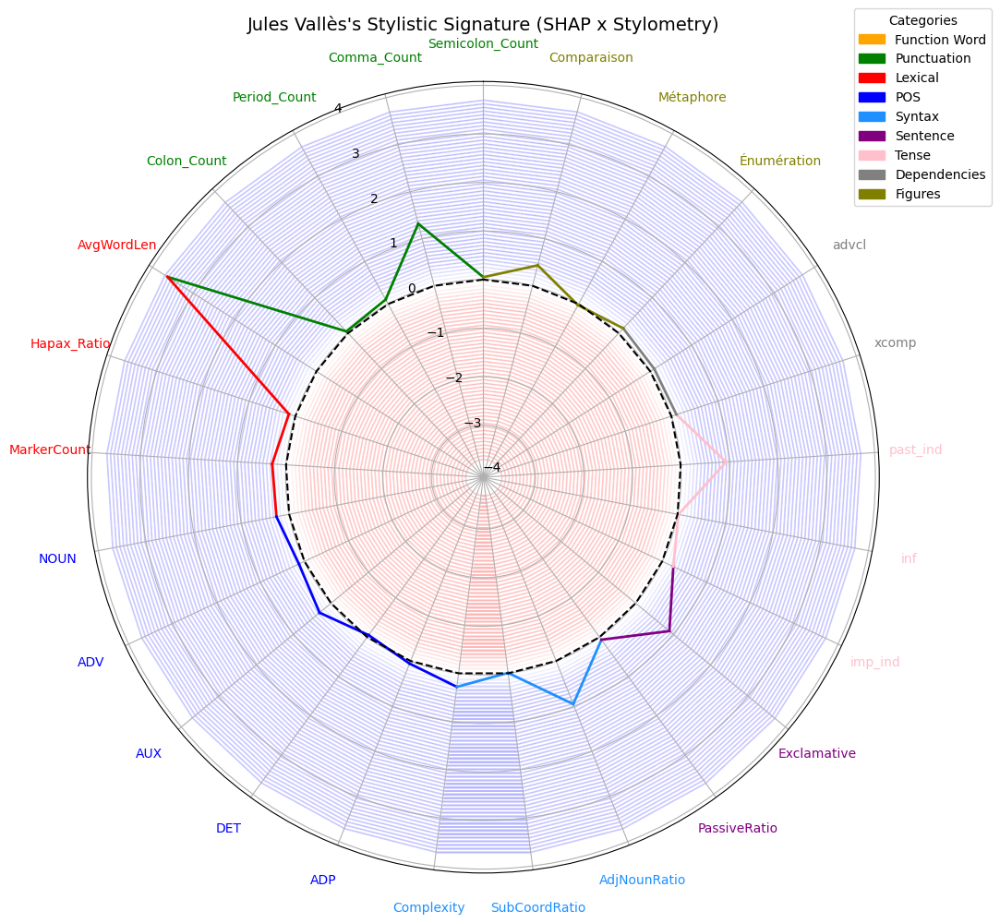

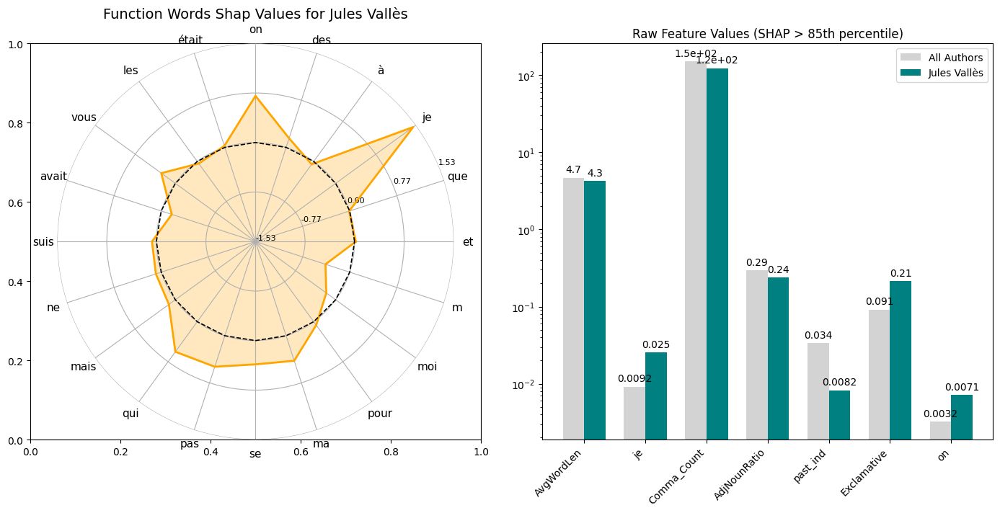

### 🔍 Interpretation Summary for **Jules Vallès** - Top features with shap values above the 85th percentile)

**1. `AvgWordLen`**: The average value of this feature for *Jules Vallès* is **lower** than the global mean (*4.3 vs 4.7*). This comparatively **lower usage** of *AvgWordLen* is characteristic of Jules Vallès's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 3.63*).

**2. `je`**: The average value of this feature for *Jules Vallès* is **higher** than the global mean (*0.025 vs 0.0092*). This comparatively **higher usage** of *je* is characteristic of Jules Vallès's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.48*).

**3. `Comma_Count`**: The average value of this feature for *Jules Vallès* is **lower** than the global mean (*1.2e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of Jules Vallès's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.32*).

**4. `AdjNounRatio`**: The average value of this feature for *Jules Vallès* is **lower** than the global mean (*0.24 vs 0.29*). This comparatively **lower usage** of *AdjNounRatio* is characteristic of Jules Vallès's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.96*).

**5. `past_ind`**: The average value of this feature for *Jules Vallès* is **lower** than the global mean (*0.0082 vs 0.034*). This comparatively **lower usage** of *past_ind* is characteristic of Jules Vallès's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.94*).

**6. `Exclamative`**: The average value of this feature for *Jules Vallès* is **higher** than the global mean (*0.21 vs 0.091*). This comparatively **higher usage** of *Exclamative* is characteristic of Jules Vallès's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.90*).

**7. `on`**: The average value of this feature for *Jules Vallès* is **higher** than the global mean (*0.0071 vs 0.0032*). This comparatively **higher usage** of *on* is characteristic of Jules Vallès's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.72*).

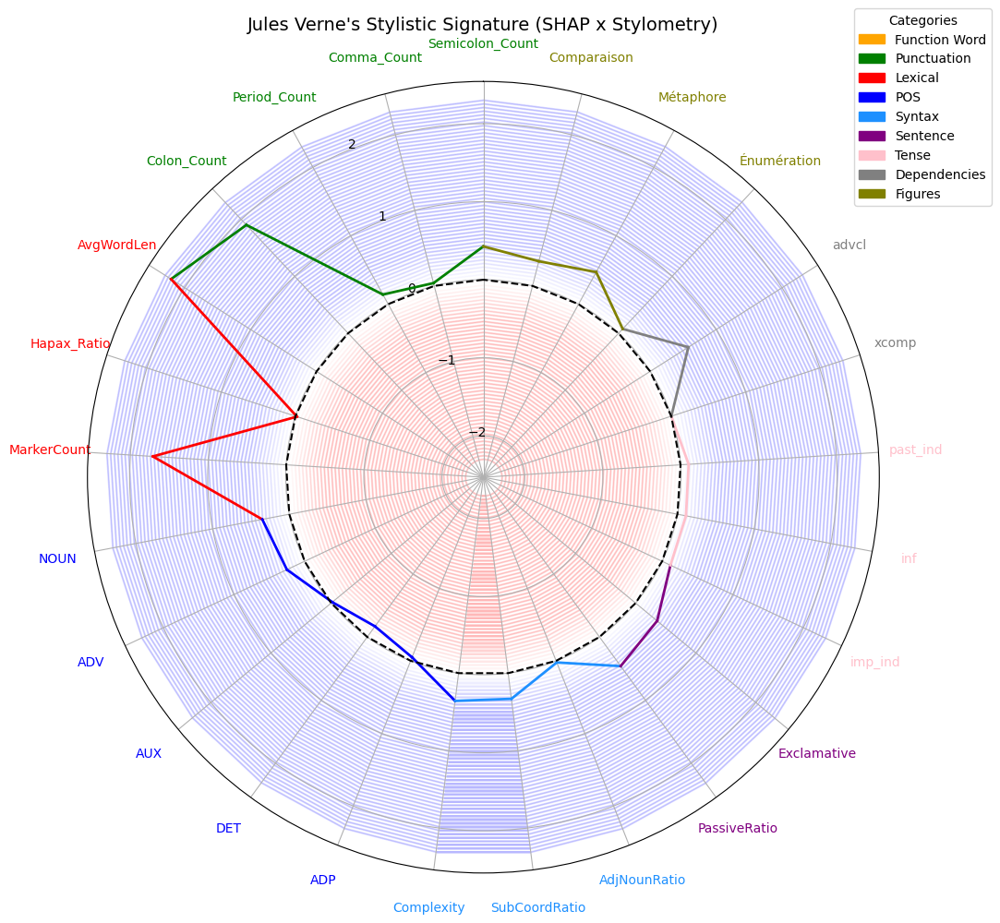

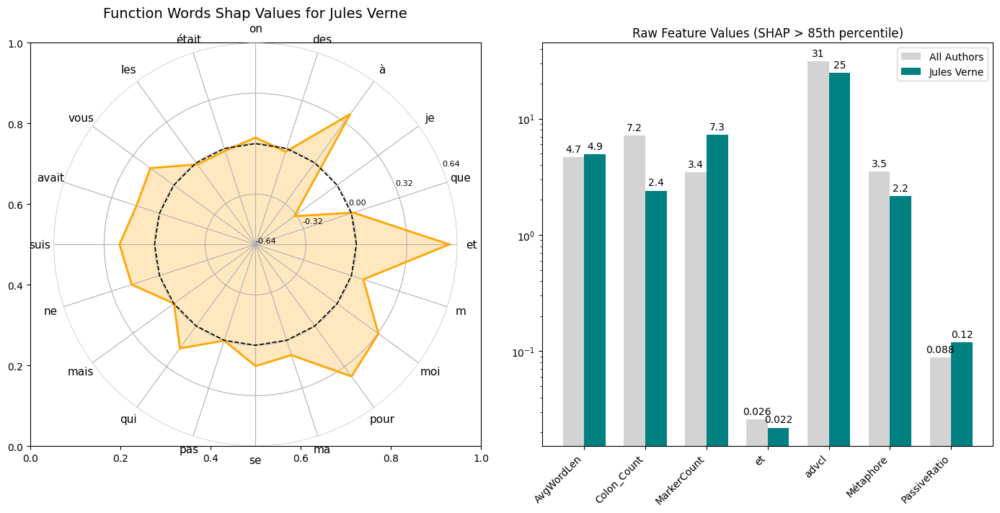

### 🔍 Interpretation Summary for **Jules Verne** - Top features with shap values above the 85th percentile)

**1. `AvgWordLen`**: The average value of this feature for *Jules Verne* is **higher** than the global mean (*4.9 vs 4.7*). This comparatively **higher usage** of *AvgWordLen* is characteristic of Jules Verne's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 2.21*).

**2. `Colon_Count`**: The average value of this feature for *Jules Verne* is **lower** than the global mean (*2.4 vs 7.2*). This comparatively **lower usage** of *Colon_Count* is characteristic of Jules Verne's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.90*).

**3. `MarkerCount`**: The average value of this feature for *Jules Verne* is **higher** than the global mean (*7.3 vs 3.4*). This comparatively **higher usage** of *MarkerCount* is characteristic of Jules Verne's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.71*).

**4. `et`**: The average value of this feature for *Jules Verne* is **lower** than the global mean (*0.022 vs 0.026*). This comparatively **lower usage** of *et* is characteristic of Jules Verne's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.59*).

**5. `advcl`**: The average value of this feature for *Jules Verne* is **lower** than the global mean (*25 vs 31*). This comparatively **lower usage** of *advcl* is characteristic of Jules Verne's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.58*).

**6. `Métaphore`**: The average value of this feature for *Jules Verne* is **lower** than the global mean (*2.2 vs 3.5*). This comparatively **lower usage** of *Métaphore* is characteristic of Jules Verne's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.47*).

**7. `PassiveRatio`**: The average value of this feature for *Jules Verne* is **higher** than the global mean (*0.12 vs 0.088*). This comparatively **higher usage** of *PassiveRatio* is characteristic of Jules Verne's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.46*).

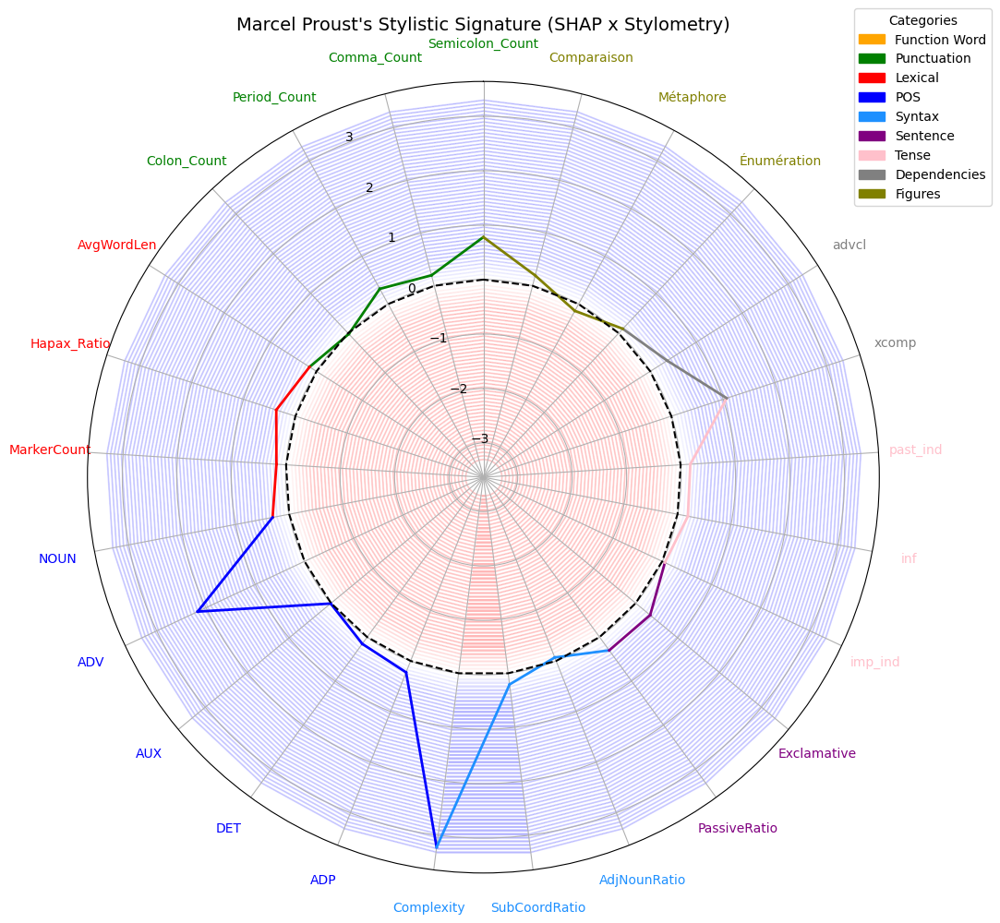

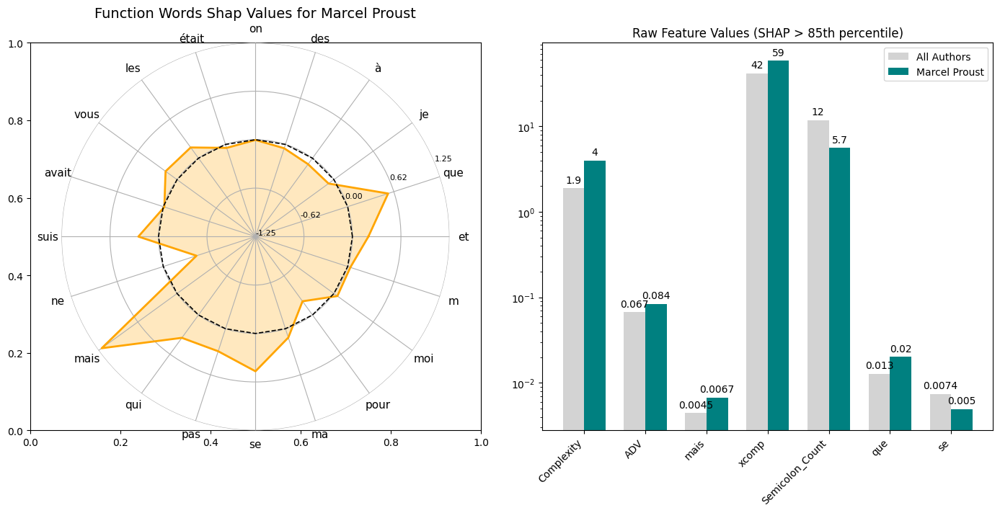

### 🔍 Interpretation Summary for **Marcel Proust** - Top features with shap values above the 85th percentile)

**1. `Complexity`**: The average value of this feature for *Marcel Proust* is **higher** than the global mean (*4 vs 1.9*). This comparatively **higher usage** of *Complexity* is characteristic of Marcel Proust's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 3.22*).

**2. `ADV`**: The average value of this feature for *Marcel Proust* is **higher** than the global mean (*0.084 vs 0.067*). This comparatively **higher usage** of *ADV* is characteristic of Marcel Proust's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 2.17*).

**3. `mais`**: The average value of this feature for *Marcel Proust* is **higher** than the global mean (*0.0067 vs 0.0045*). This comparatively **higher usage** of *mais* is characteristic of Marcel Proust's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.20*).

**4. `xcomp`**: The average value of this feature for *Marcel Proust* is **higher** than the global mean (*59 vs 42*). This comparatively **higher usage** of *xcomp* is characteristic of Marcel Proust's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 1.07*).

**5. `Semicolon_Count`**: The average value of this feature for *Marcel Proust* is **lower** than the global mean (*5.7 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Marcel Proust's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.78*).

**6. `que`**: The average value of this feature for *Marcel Proust* is **higher** than the global mean (*0.02 vs 0.013*). This comparatively **higher usage** of *que* is characteristic of Marcel Proust's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.55*).

**7. `se`**: The average value of this feature for *Marcel Proust* is **lower** than the global mean (*0.005 vs 0.0074*). This comparatively **lower usage** of *se* is characteristic of Marcel Proust's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.49*).

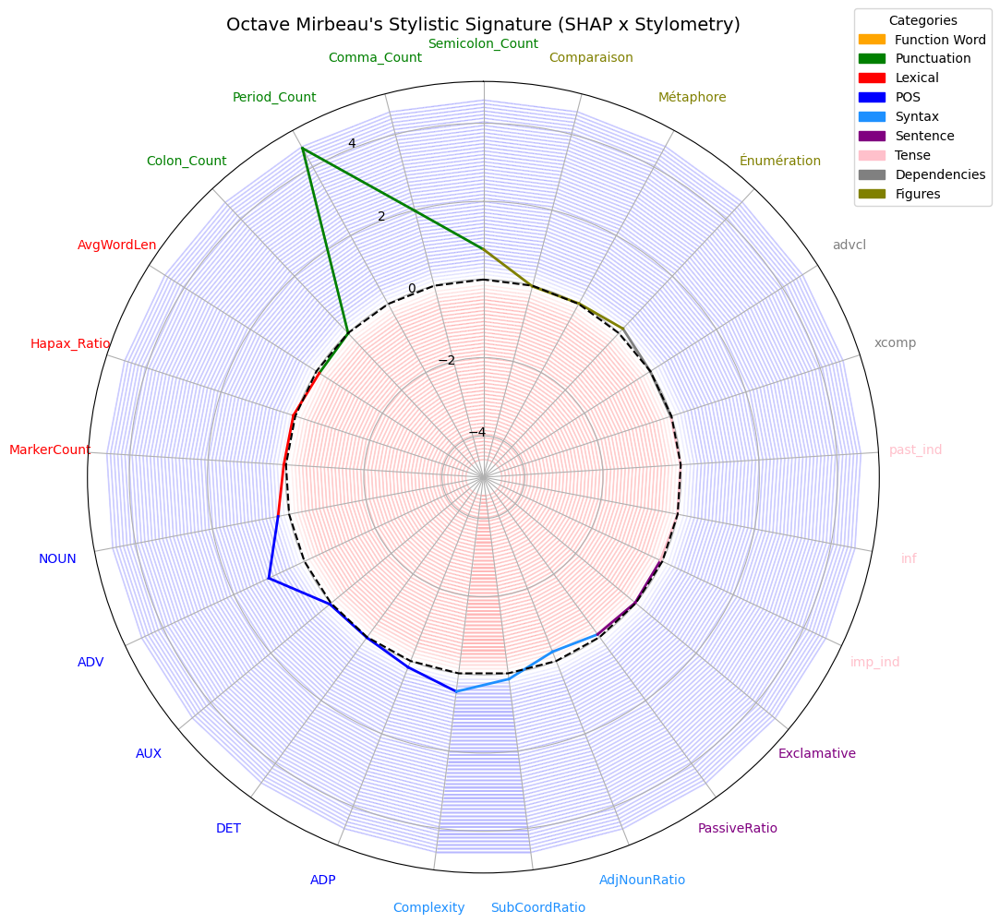

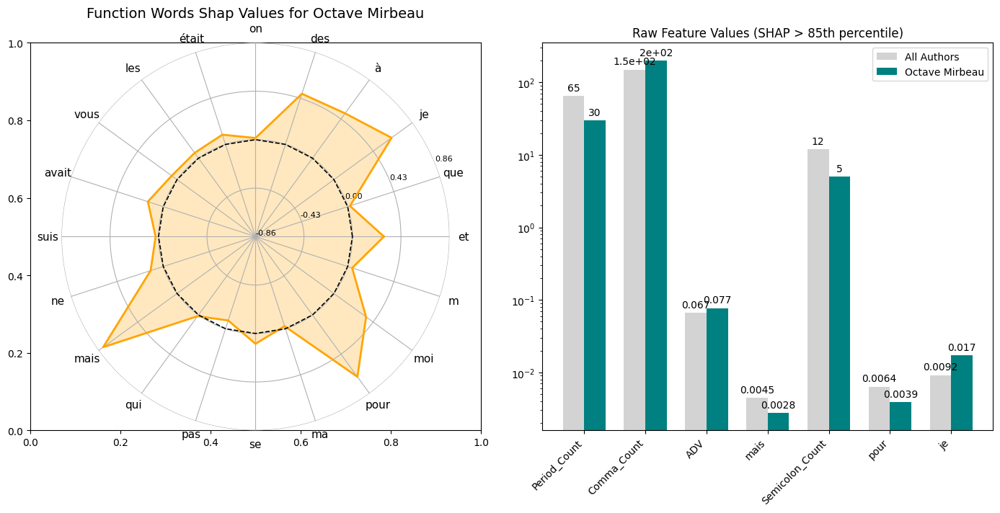

### 🔍 Interpretation Summary for **Octave Mirbeau** - Top features with shap values above the 85th percentile)

**1. `Period_Count`**: The average value of this feature for *Octave Mirbeau* is **lower** than the global mean (*30 vs 65*). This comparatively **lower usage** of *Period_Count* is characteristic of Octave Mirbeau's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 4.55*).

**2. `Comma_Count`**: The average value of this feature for *Octave Mirbeau* is **higher** than the global mean (*2e+02 vs 1.5e+02*). This comparatively **higher usage** of *Comma_Count* is characteristic of Octave Mirbeau's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.98*).

**3. `ADV`**: The average value of this feature for *Octave Mirbeau* is **higher** than the global mean (*0.077 vs 0.067*). This comparatively **higher usage** of *ADV* is characteristic of Octave Mirbeau's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.01*).

**4. `mais`**: The average value of this feature for *Octave Mirbeau* is **lower** than the global mean (*0.0028 vs 0.0045*). This comparatively **lower usage** of *mais* is characteristic of Octave Mirbeau's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.81*).

**5. `Semicolon_Count`**: The average value of this feature for *Octave Mirbeau* is **lower** than the global mean (*5 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Octave Mirbeau's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.77*).

**6. `pour`**: The average value of this feature for *Octave Mirbeau* is **lower** than the global mean (*0.0039 vs 0.0064*). This comparatively **lower usage** of *pour* is characteristic of Octave Mirbeau's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.68*).

**7. `je`**: The average value of this feature for *Octave Mirbeau* is **higher** than the global mean (*0.017 vs 0.0092*). This comparatively **higher usage** of *je* is characteristic of Octave Mirbeau's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.64*).

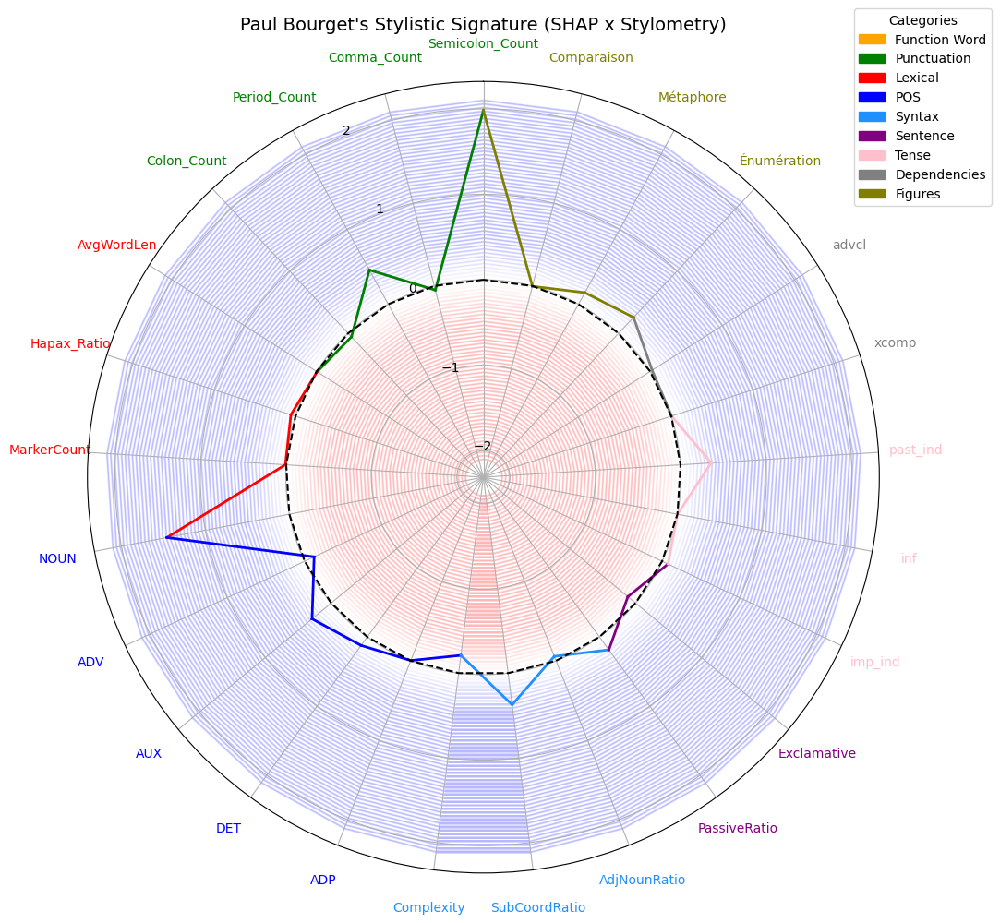

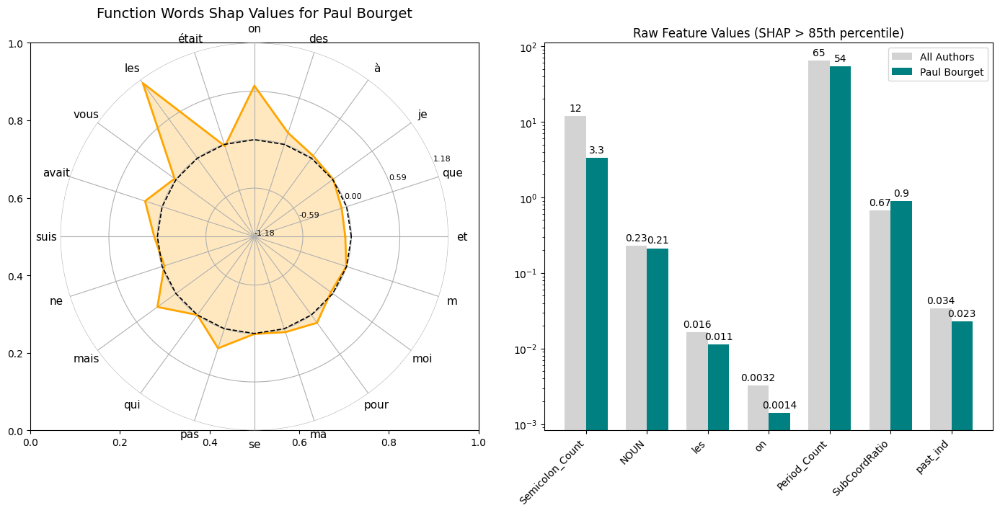

### 🔍 Interpretation Summary for **Paul Bourget** - Top features with shap values above the 85th percentile)

**1. `Semicolon_Count`**: The average value of this feature for *Paul Bourget* is **lower** than the global mean (*3.3 vs 12*). This comparatively **lower usage** of *Semicolon_Count* is characteristic of Paul Bourget's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.98*).

**2. `NOUN`**: The average value of this feature for *Paul Bourget* is **lower** than the global mean (*0.21 vs 0.23*). This comparatively **lower usage** of *NOUN* is characteristic of Paul Bourget's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.46*).

**3. `les`**: The average value of this feature for *Paul Bourget* is **lower** than the global mean (*0.011 vs 0.016*). This comparatively **lower usage** of *les* is characteristic of Paul Bourget's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.13*).

**4. `on`**: The average value of this feature for *Paul Bourget* is **lower** than the global mean (*0.0014 vs 0.0032*). This comparatively **lower usage** of *on* is characteristic of Paul Bourget's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.66*).

**5. `Period_Count`**: The average value of this feature for *Paul Bourget* is **lower** than the global mean (*54 vs 65*). This comparatively **lower usage** of *Period_Count* is characteristic of Paul Bourget's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.46*).

**6. `SubCoordRatio`**: The average value of this feature for *Paul Bourget* is **higher** than the global mean (*0.9 vs 0.67*). This comparatively **higher usage** of *SubCoordRatio* is characteristic of Paul Bourget's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.37*).

**7. `past_ind`**: The average value of this feature for *Paul Bourget* is **lower** than the global mean (*0.023 vs 0.034*). This comparatively **lower usage** of *past_ind* is characteristic of Paul Bourget's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.36*).

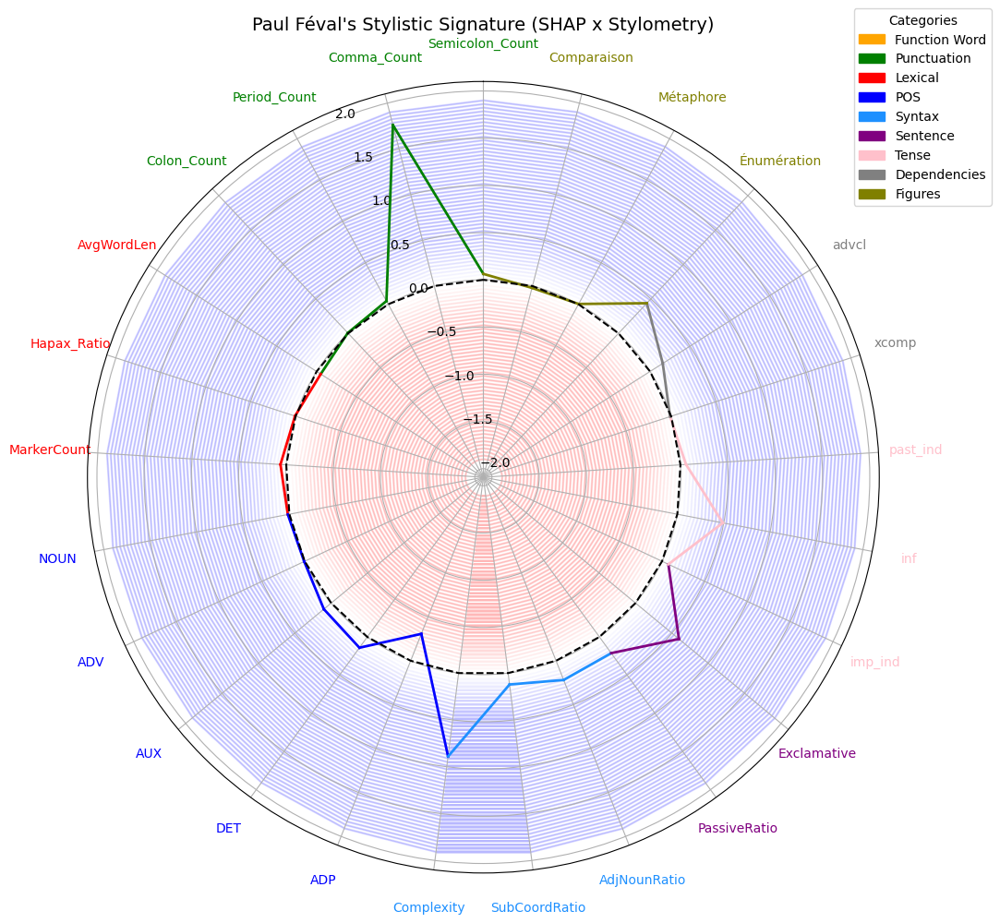

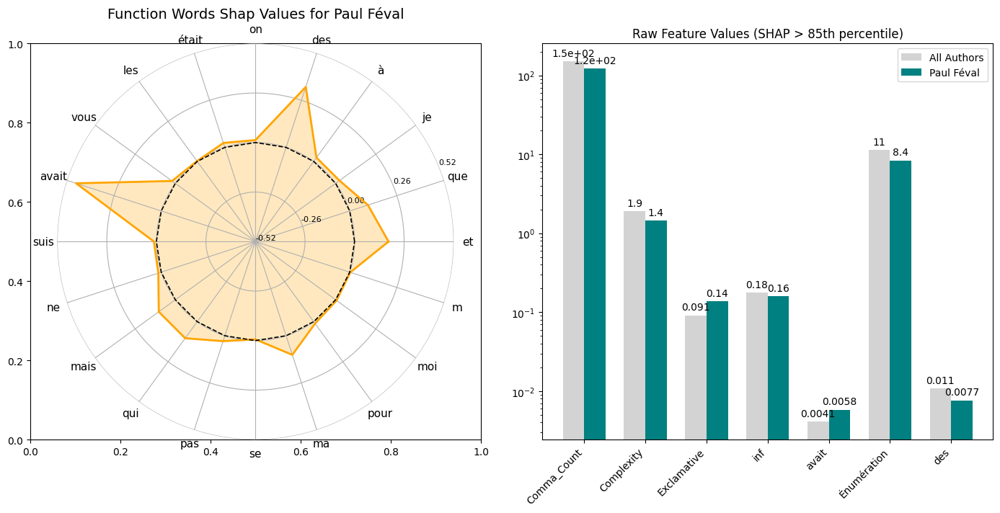

### 🔍 Interpretation Summary for **Paul Féval** - Top features with shap values above the 85th percentile)

**1. `Comma_Count`**: The average value of this feature for *Paul Féval* is **lower** than the global mean (*1.2e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of Paul Féval's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.76*).

**2. `Complexity`**: The average value of this feature for *Paul Féval* is **lower** than the global mean (*1.4 vs 1.9*). This comparatively **lower usage** of *Complexity* is characteristic of Paul Féval's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.89*).

**3. `Exclamative`**: The average value of this feature for *Paul Féval* is **higher** than the global mean (*0.14 vs 0.091*). This comparatively **higher usage** of *Exclamative* is characteristic of Paul Féval's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.60*).

**4. `inf`**: The average value of this feature for *Paul Féval* is **lower** than the global mean (*0.16 vs 0.18*). This comparatively **lower usage** of *inf* is characteristic of Paul Féval's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.49*).

**5. `avait`**: The average value of this feature for *Paul Féval* is **higher** than the global mean (*0.0058 vs 0.0041*). This comparatively **higher usage** of *avait* is characteristic of Paul Féval's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.47*).

**6. `Énumération`**: The average value of this feature for *Paul Féval* is **lower** than the global mean (*8.4 vs 11*). This comparatively **lower usage** of *Énumération* is characteristic of Paul Féval's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.44*).

**7. `des`**: The average value of this feature for *Paul Féval* is **lower** than the global mean (*0.0077 vs 0.011*). This comparatively **lower usage** of *des* is characteristic of Paul Féval's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.33*).

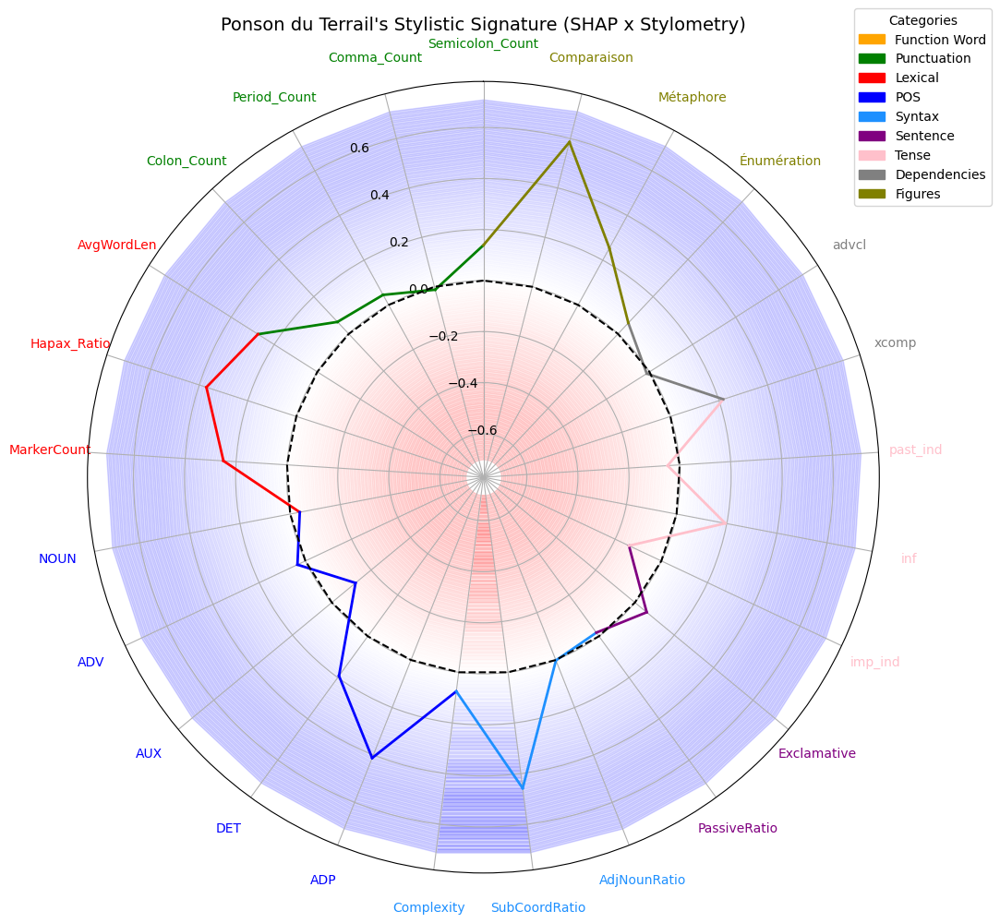

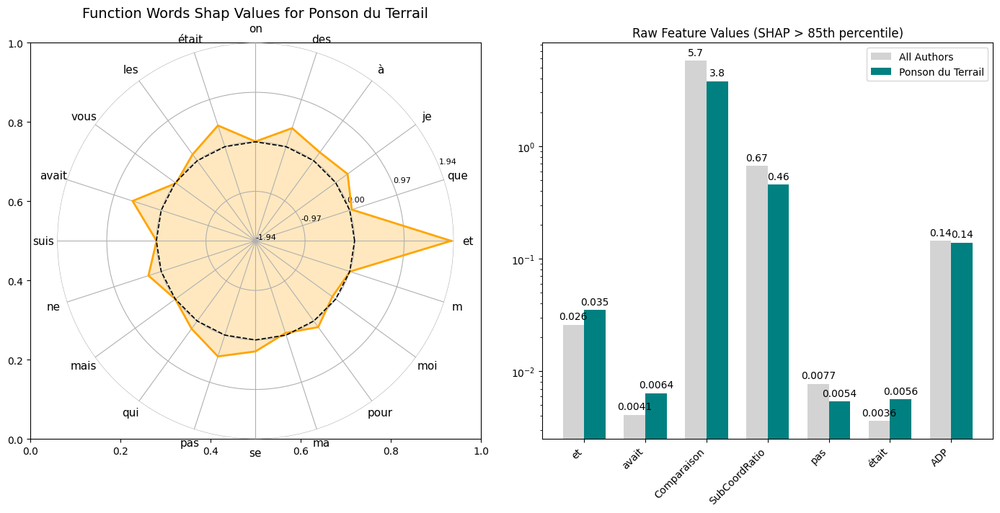

### 🔍 Interpretation Summary for **Ponson du Terrail** - Top features with shap values above the 85th percentile)

**1. `et`**: The average value of this feature for *Ponson du Terrail* is **higher** than the global mean (*0.035 vs 0.026*). This comparatively **higher usage** of *et* is characteristic of Ponson du Terrail's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.89*).

**2. `avait`**: The average value of this feature for *Ponson du Terrail* is **higher** than the global mean (*0.0064 vs 0.0041*). This comparatively **higher usage** of *avait* is characteristic of Ponson du Terrail's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.59*).

**3. `Comparaison`**: The average value of this feature for *Ponson du Terrail* is **lower** than the global mean (*3.8 vs 5.7*). This comparatively **lower usage** of *Comparaison* is characteristic of Ponson du Terrail's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.59*).

**4. `SubCoordRatio`**: The average value of this feature for *Ponson du Terrail* is **lower** than the global mean (*0.46 vs 0.67*). This comparatively **lower usage** of *SubCoordRatio* is characteristic of Ponson du Terrail's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.46*).

**5. `pas`**: The average value of this feature for *Ponson du Terrail* is **lower** than the global mean (*0.0054 vs 0.0077*). This comparatively **lower usage** of *pas* is characteristic of Ponson du Terrail's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.44*).

**6. `était`**: The average value of this feature for *Ponson du Terrail* is **higher** than the global mean (*0.0056 vs 0.0036*). This comparatively **higher usage** of *était* is characteristic of Ponson du Terrail's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.44*).

**7. `ADP`**: The average value of this feature for *Ponson du Terrail* is **lower** than the global mean (*0.14 vs 0.14*). This comparatively **lower usage** of *ADP* is characteristic of Ponson du Terrail's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.41*).

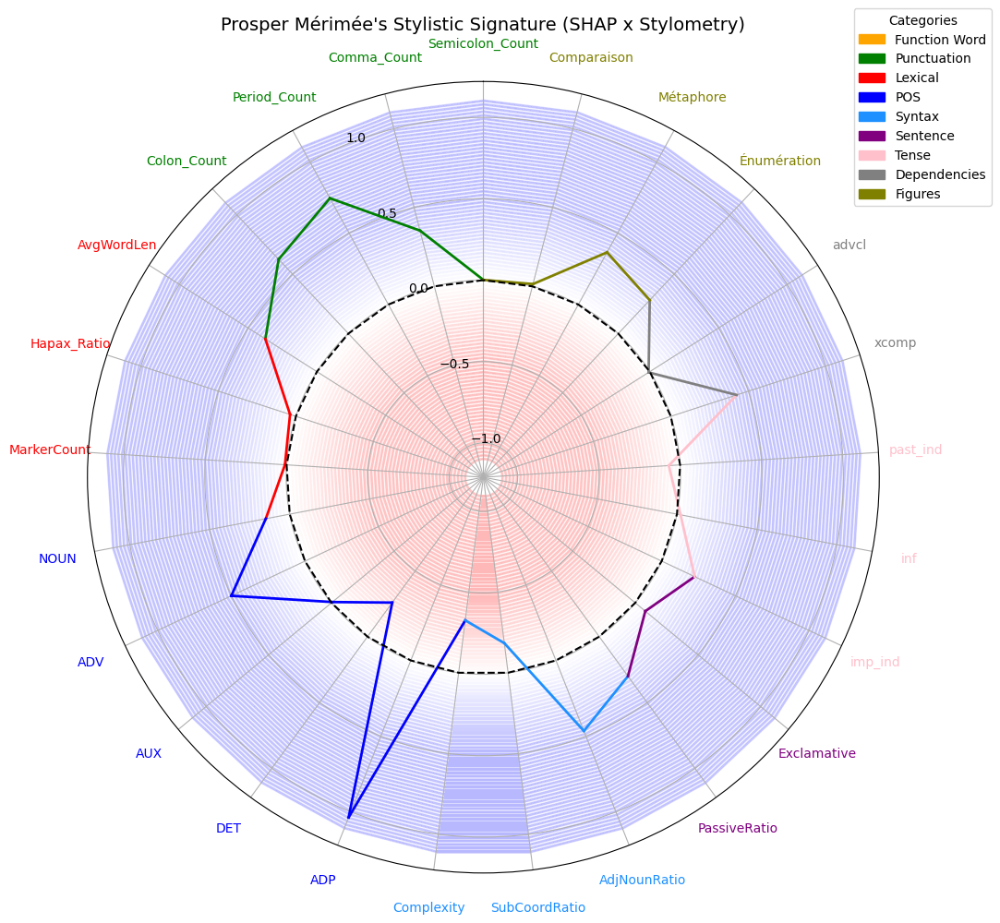

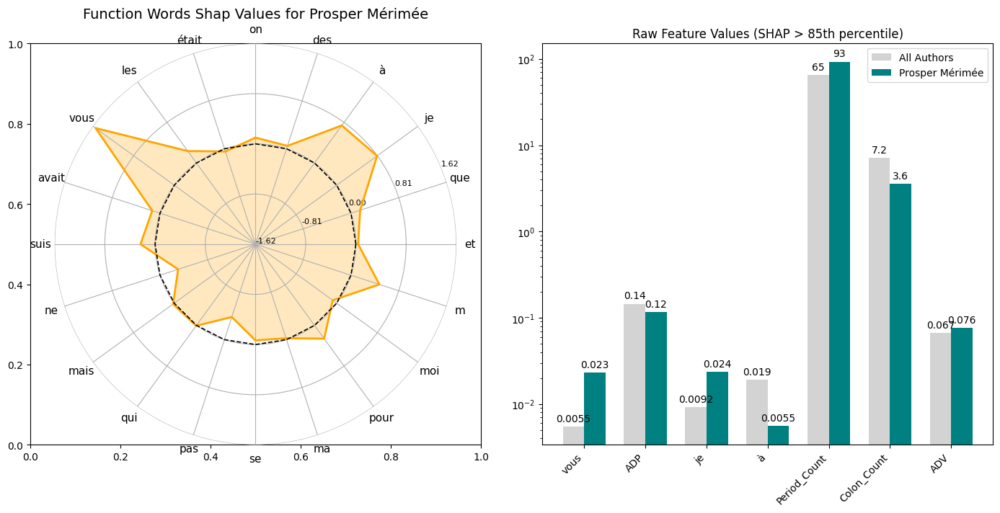

### 🔍 Interpretation Summary for **Prosper Mérimée** - Top features with shap values above the 85th percentile)

**1. `vous`**: The average value of this feature for *Prosper Mérimée* is **higher** than the global mean (*0.023 vs 0.0055*). This comparatively **higher usage** of *vous* is characteristic of Prosper Mérimée's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.57*).

**2. `ADP`**: The average value of this feature for *Prosper Mérimée* is **lower** than the global mean (*0.12 vs 0.14*). This comparatively **lower usage** of *ADP* is characteristic of Prosper Mérimée's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.04*).

**3. `je`**: The average value of this feature for *Prosper Mérimée* is **higher** than the global mean (*0.024 vs 0.0092*). This comparatively **higher usage** of *je* is characteristic of Prosper Mérimée's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.80*).

**4. `à`**: The average value of this feature for *Prosper Mérimée* is **lower** than the global mean (*0.0055 vs 0.019*). This comparatively **lower usage** of *à* is characteristic of Prosper Mérimée's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.75*).

**5. `Period_Count`**: The average value of this feature for *Prosper Mérimée* is **higher** than the global mean (*93 vs 65*). This comparatively **higher usage** of *Period_Count* is characteristic of Prosper Mérimée's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.75*).

**6. `Colon_Count`**: The average value of this feature for *Prosper Mérimée* is **lower** than the global mean (*3.6 vs 7.2*). This comparatively **lower usage** of *Colon_Count* is characteristic of Prosper Mérimée's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.63*).

**7. `ADV`**: The average value of this feature for *Prosper Mérimée* is **higher** than the global mean (*0.076 vs 0.067*). This comparatively **higher usage** of *ADV* is characteristic of Prosper Mérimée's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.50*).

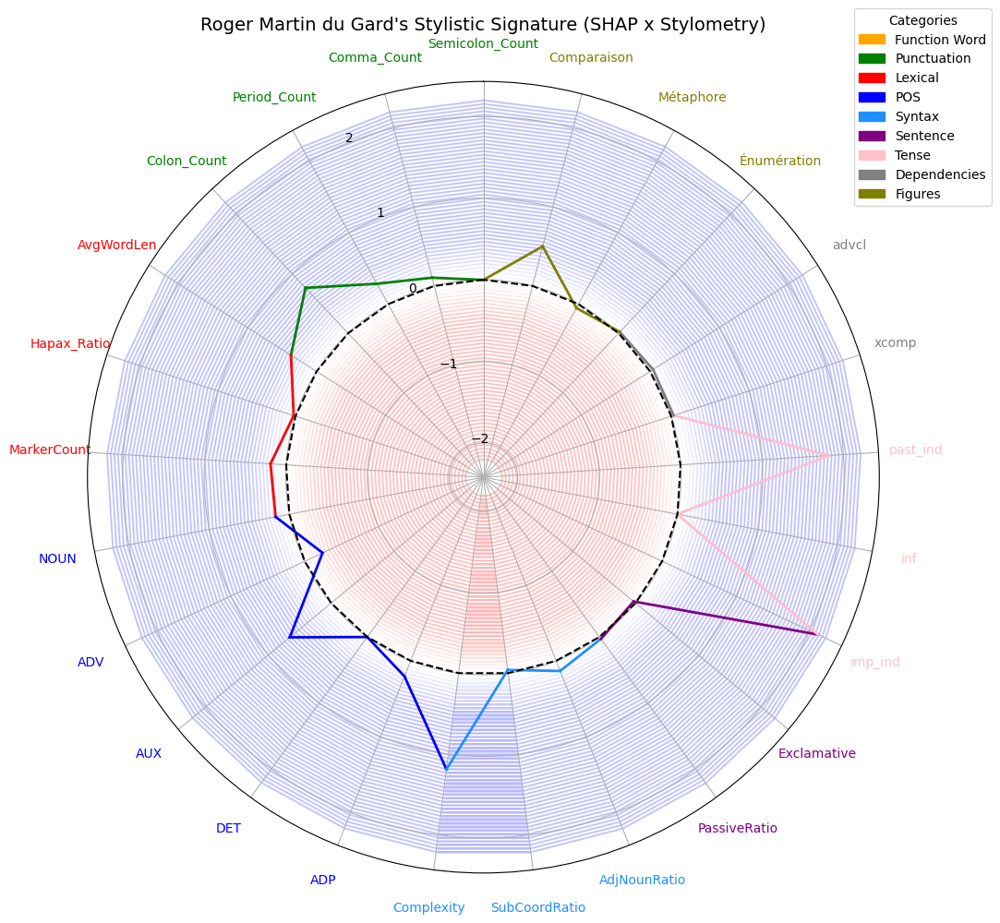

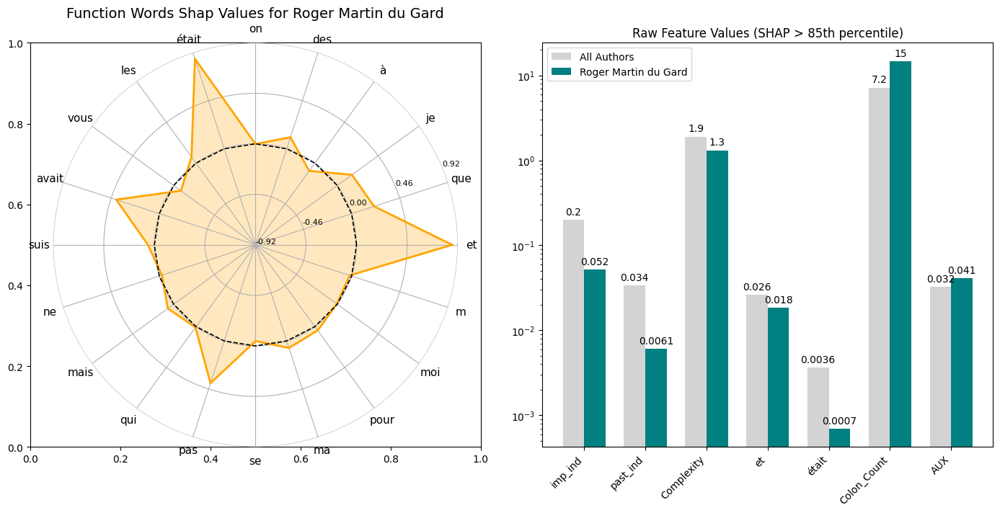

### 🔍 Interpretation Summary for **Roger Martin du Gard** - Top features with shap values above the 85th percentile)

**1. `imp_ind`**: The average value of this feature for *Roger Martin du Gard* is **lower** than the global mean (*0.052 vs 0.2*). This comparatively **lower usage** of *imp_ind* is characteristic of Roger Martin du Gard's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 2.11*).

**2. `past_ind`**: The average value of this feature for *Roger Martin du Gard* is **lower** than the global mean (*0.0061 vs 0.034*). This comparatively **lower usage** of *past_ind* is characteristic of Roger Martin du Gard's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.83*).

**3. `Complexity`**: The average value of this feature for *Roger Martin du Gard* is **lower** than the global mean (*1.3 vs 1.9*). This comparatively **lower usage** of *Complexity* is characteristic of Roger Martin du Gard's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.19*).

**4. `et`**: The average value of this feature for *Roger Martin du Gard* is **lower** than the global mean (*0.018 vs 0.026*). This comparatively **lower usage** of *et* is characteristic of Roger Martin du Gard's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.87*).

**5. `était`**: The average value of this feature for *Roger Martin du Gard* is **lower** than the global mean (*7.0e-04 vs 0.0036*). This comparatively **lower usage** of *était* is characteristic of Roger Martin du Gard's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.86*).

**6. `Colon_Count`**: The average value of this feature for *Roger Martin du Gard* is **higher** than the global mean (*15 vs 7.2*). This comparatively **higher usage** of *Colon_Count* is characteristic of Roger Martin du Gard's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.76*).

**7. `AUX`**: The average value of this feature for *Roger Martin du Gard* is **higher** than the global mean (*0.041 vs 0.032*). This comparatively **higher usage** of *AUX* is characteristic of Roger Martin du Gard's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.66*).

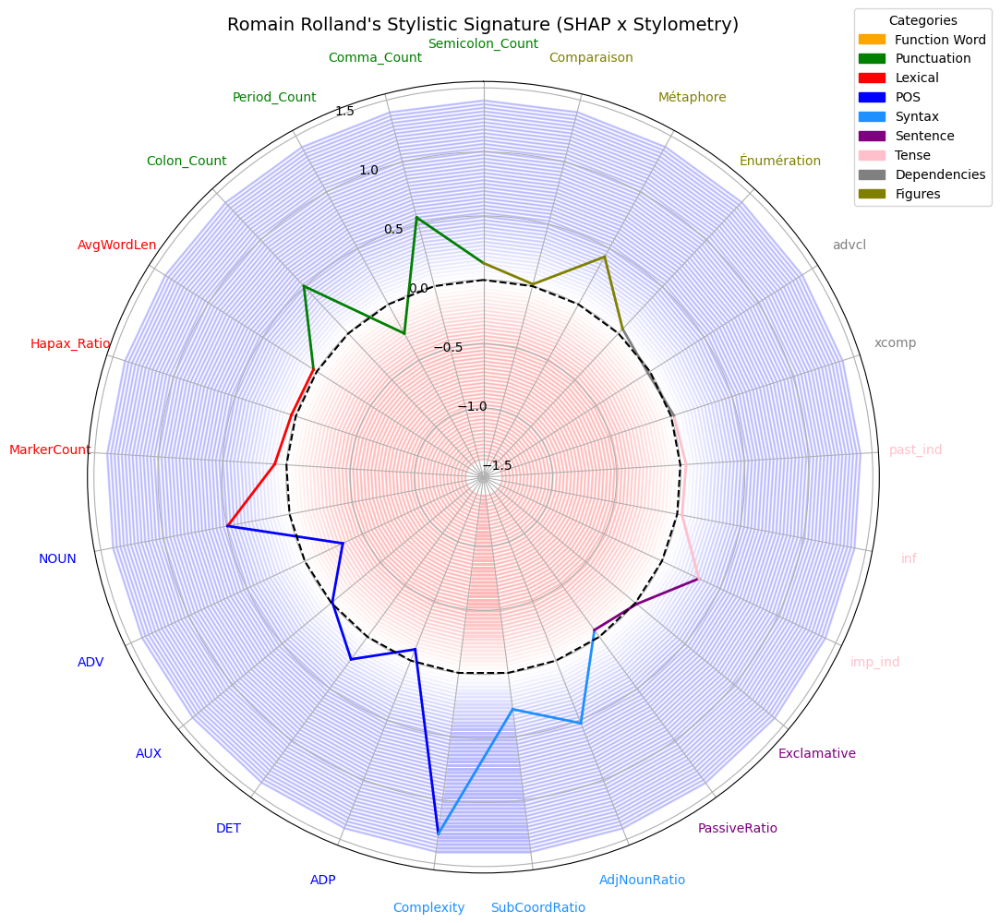

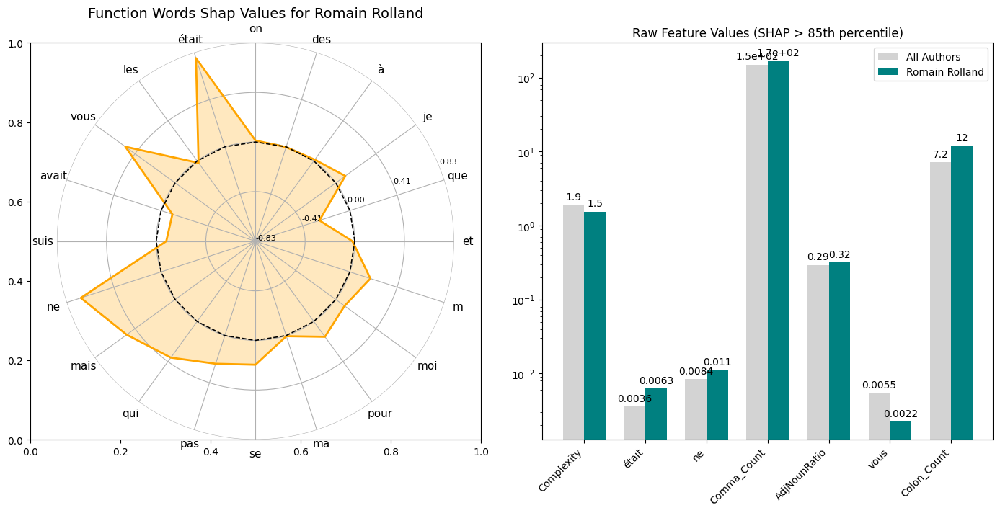

### 🔍 Interpretation Summary for **Romain Rolland** - Top features with shap values above the 85th percentile)

**1. `Complexity`**: The average value of this feature for *Romain Rolland* is **lower** than the global mean (*1.5 vs 1.9*). This comparatively **lower usage** of *Complexity* is characteristic of Romain Rolland's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.27*).

**2. `était`**: The average value of this feature for *Romain Rolland* is **higher** than the global mean (*0.0063 vs 0.0036*). This comparatively **higher usage** of *était* is characteristic of Romain Rolland's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.78*).

**3. `ne`**: The average value of this feature for *Romain Rolland* is **higher** than the global mean (*0.011 vs 0.0084*). This comparatively **higher usage** of *ne* is characteristic of Romain Rolland's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.70*).

**4. `Comma_Count`**: The average value of this feature for *Romain Rolland* is **higher** than the global mean (*1.7e+02 vs 1.5e+02*). This comparatively **higher usage** of *Comma_Count* is characteristic of Romain Rolland's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.55*).

**5. `AdjNounRatio`**: The average value of this feature for *Romain Rolland* is **higher** than the global mean (*0.32 vs 0.29*). This comparatively **higher usage** of *AdjNounRatio* is characteristic of Romain Rolland's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.53*).

**6. `vous`**: The average value of this feature for *Romain Rolland* is **lower** than the global mean (*0.0022 vs 0.0055*). This comparatively **lower usage** of *vous* is characteristic of Romain Rolland's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.51*).

**7. `Colon_Count`**: The average value of this feature for *Romain Rolland* is **higher** than the global mean (*12 vs 7.2*). This comparatively **higher usage** of *Colon_Count* is characteristic of Romain Rolland's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.51*).

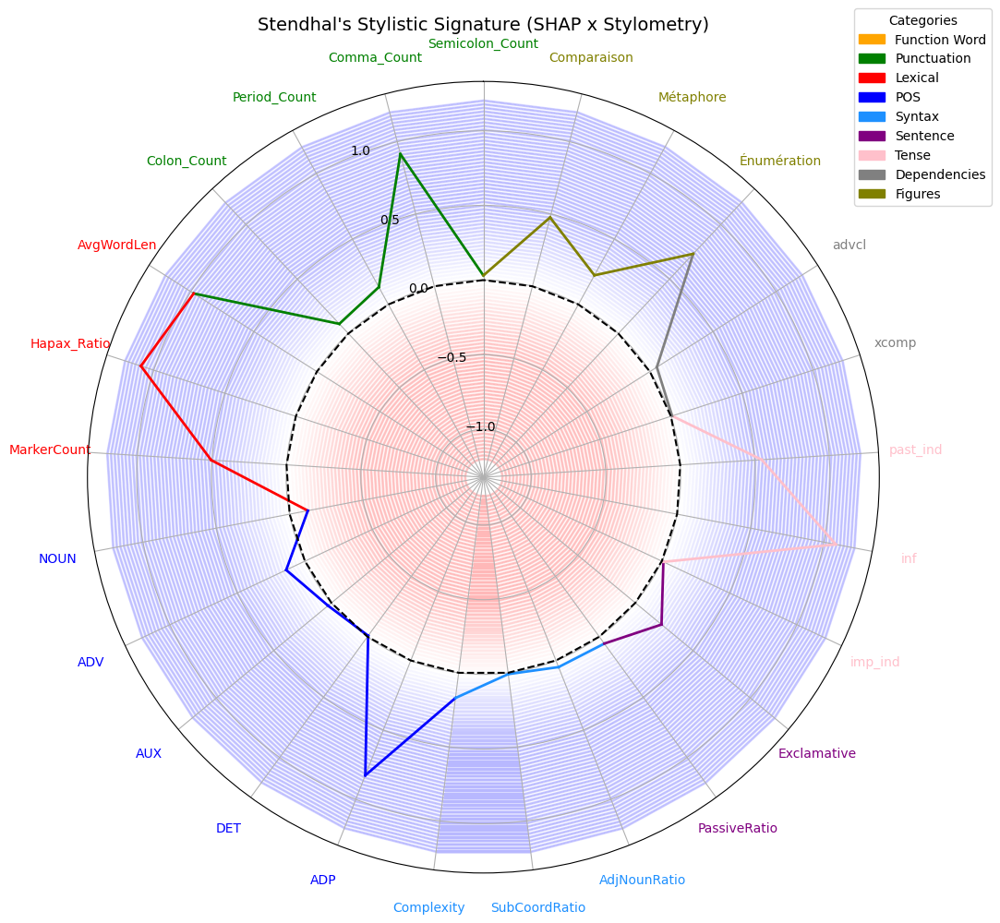

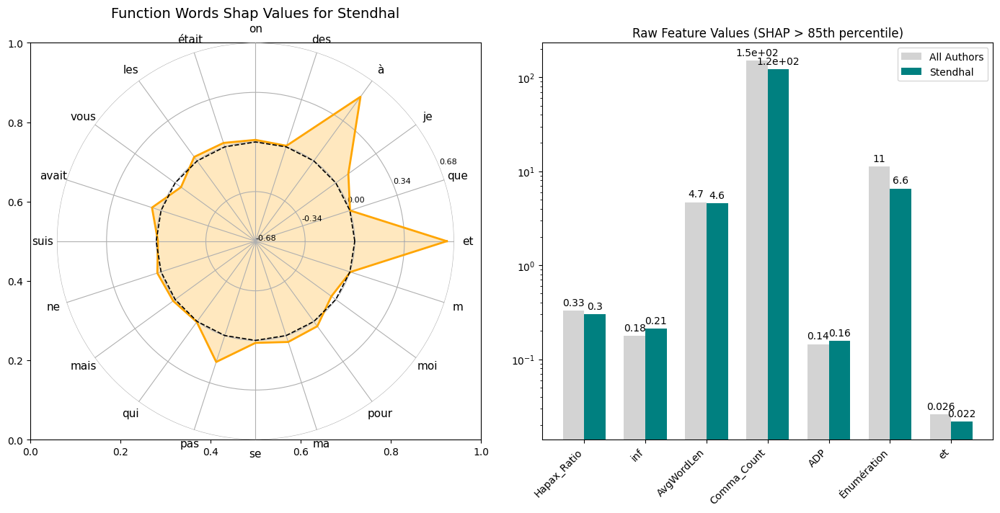

### 🔍 Interpretation Summary for **Stendhal** - Top features with shap values above the 85th percentile)

**1. `Hapax_Ratio`**: The average value of this feature for *Stendhal* is **lower** than the global mean (*0.3 vs 0.33*). This comparatively **lower usage** of *Hapax_Ratio* is characteristic of Stendhal's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.09*).

**2. `inf`**: The average value of this feature for *Stendhal* is **higher** than the global mean (*0.21 vs 0.18*). This comparatively **higher usage** of *inf* is characteristic of Stendhal's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.08*).

**3. `AvgWordLen`**: The average value of this feature for *Stendhal* is **lower** than the global mean (*4.6 vs 4.7*). This comparatively **lower usage** of *AvgWordLen* is characteristic of Stendhal's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.98*).

**4. `Comma_Count`**: The average value of this feature for *Stendhal* is **lower** than the global mean (*1.2e+02 vs 1.5e+02*). This comparatively **lower usage** of *Comma_Count* is characteristic of Stendhal's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.91*).

**5. `ADP`**: The average value of this feature for *Stendhal* is **higher** than the global mean (*0.16 vs 0.14*). This comparatively **higher usage** of *ADP* is characteristic of Stendhal's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.83*).

**6. `Énumération`**: The average value of this feature for *Stendhal* is **lower** than the global mean (*6.6 vs 11*). This comparatively **lower usage** of *Énumération* is characteristic of Stendhal's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.73*).

**7. `et`**: The average value of this feature for *Stendhal* is **lower** than the global mean (*0.022 vs 0.026*). This comparatively **lower usage** of *et* is characteristic of Stendhal's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.63*).

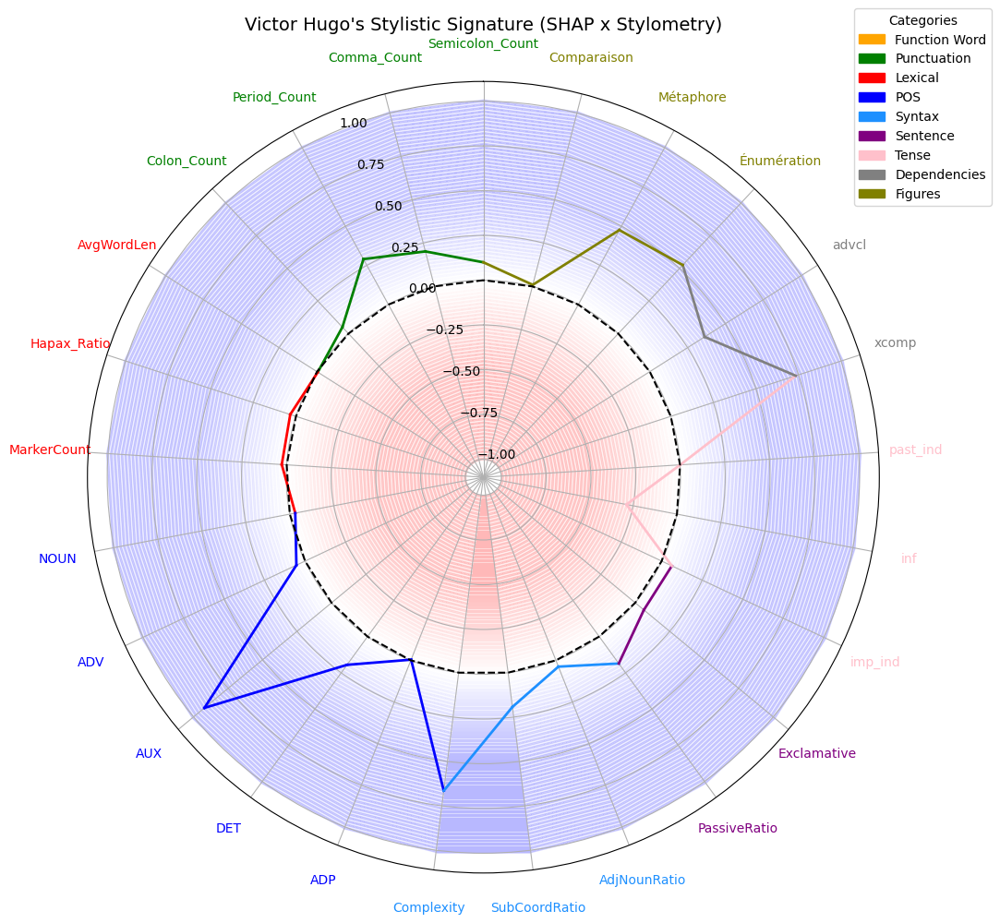

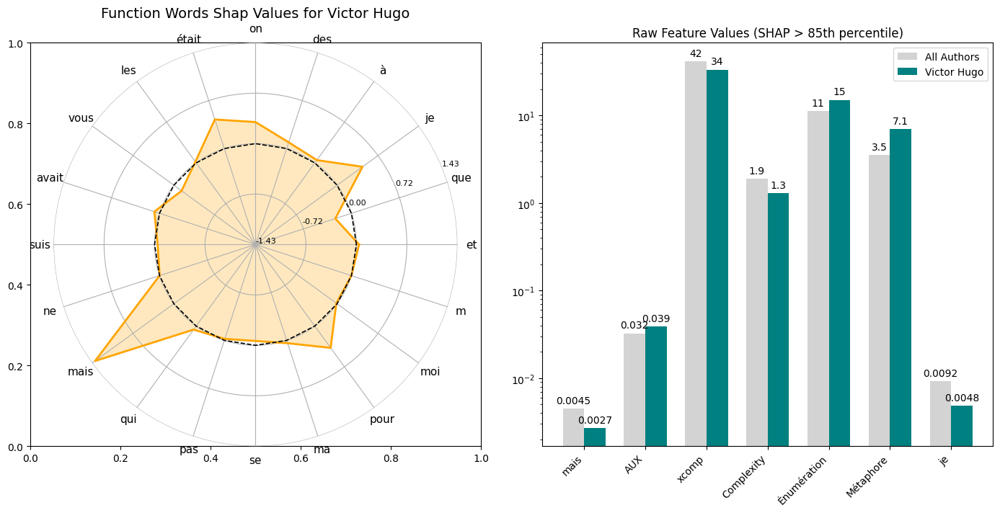

### 🔍 Interpretation Summary for **Victor Hugo** - Top features with shap values above the 85th percentile)

**1. `mais`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*0.0027 vs 0.0045*). This comparatively **lower usage** of *mais* is characteristic of Victor Hugo's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 1.38*).

**2. `AUX`**: The average value of this feature for *Victor Hugo* is **higher** than the global mean (*0.039 vs 0.032*). This comparatively **higher usage** of *AUX* is characteristic of Victor Hugo's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 0.92*).

**3. `xcomp`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*34 vs 42*). This comparatively **lower usage** of *xcomp* is characteristic of Victor Hugo's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 0.73*).

**4. `Complexity`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*1.3 vs 1.9*). This comparatively **lower usage** of *Complexity* is characteristic of Victor Hugo's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.67*).

**5. `Énumération`**: The average value of this feature for *Victor Hugo* is **higher** than the global mean (*15 vs 11*). This comparatively **higher usage** of *Énumération* is characteristic of Victor Hugo's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.53*).

**6. `Métaphore`**: The average value of this feature for *Victor Hugo* is **higher** than the global mean (*7.1 vs 3.5*). This comparatively **higher usage** of *Métaphore* is characteristic of Victor Hugo's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.48*).

**7. `je`**: The average value of this feature for *Victor Hugo* is **lower** than the global mean (*0.0048 vs 0.0092*). This comparatively **lower usage** of *je* is characteristic of Victor Hugo's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.44*).

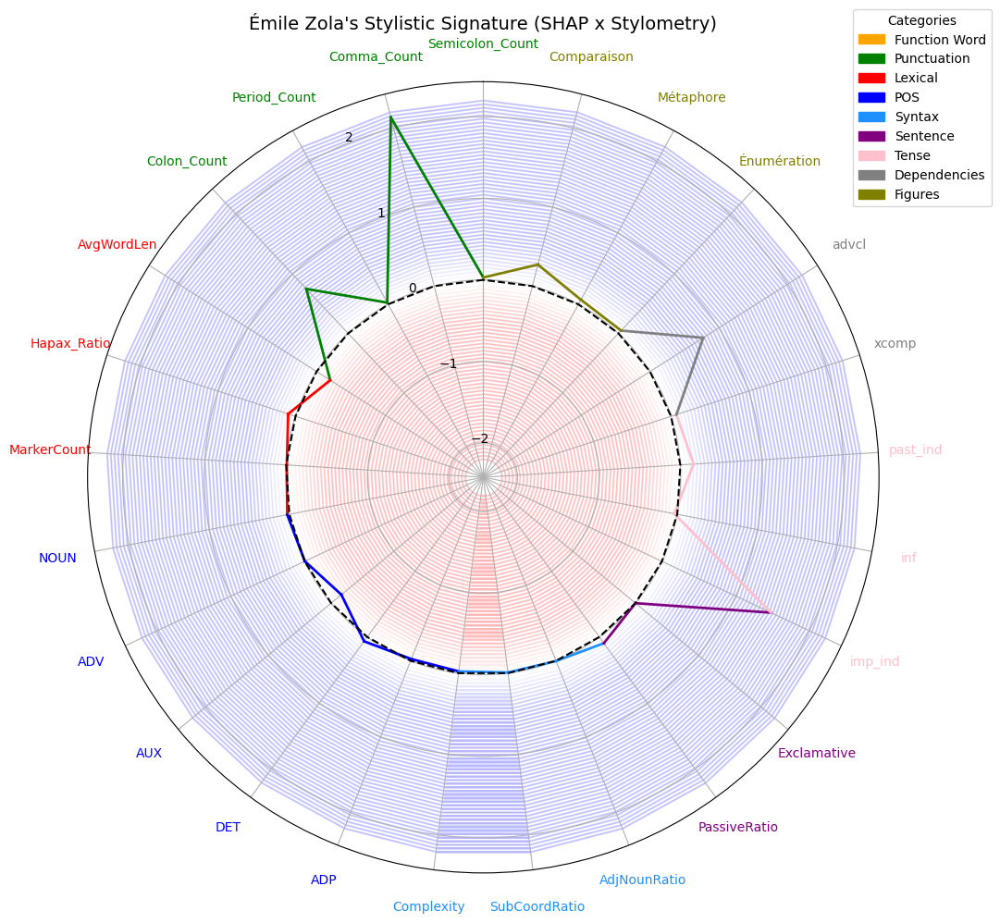

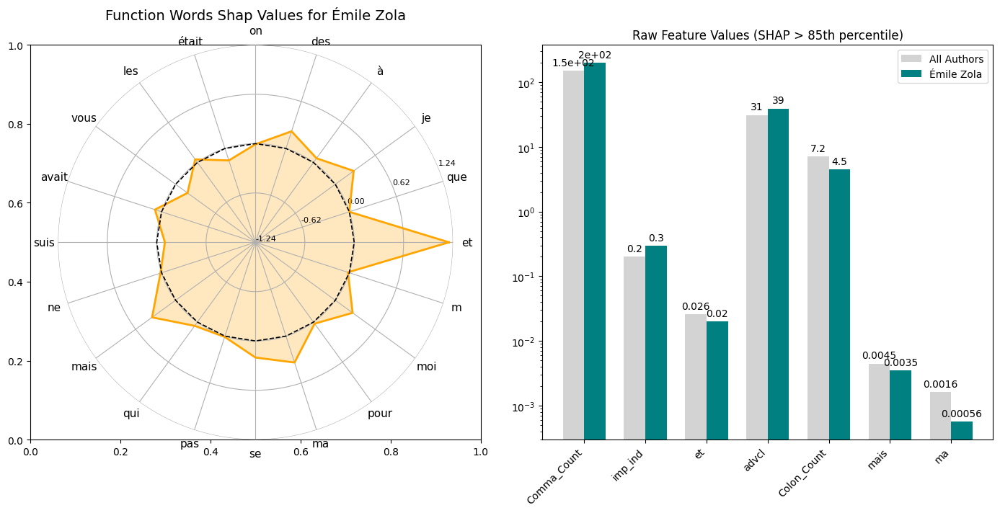

### 🔍 Interpretation Summary for **Émile Zola** - Top features with shap values above the 85th percentile)

**1. `Comma_Count`**: The average value of this feature for *Émile Zola* is **higher** than the global mean (*2e+02 vs 1.5e+02*). This comparatively **higher usage** of *Comma_Count* is characteristic of Émile Zola's style, making it the **1ˢᵗ most important** stylistic indicator in this classification task (*SHAP: 2.14*).

**2. `imp_ind`**: The average value of this feature for *Émile Zola* is **higher** than the global mean (*0.3 vs 0.2*). This comparatively **higher usage** of *imp_ind* is characteristic of Émile Zola's style, making it the **2ⁿᵈ most important** stylistic indicator in this classification task (*SHAP: 1.48*).

**3. `et`**: The average value of this feature for *Émile Zola* is **lower** than the global mean (*0.02 vs 0.026*). This comparatively **lower usage** of *et* is characteristic of Émile Zola's style, making it the **3ʳᵈ most important** stylistic indicator in this classification task (*SHAP: 1.19*).

**4. `advcl`**: The average value of this feature for *Émile Zola* is **higher** than the global mean (*39 vs 31*). This comparatively **higher usage** of *advcl* is characteristic of Émile Zola's style, making it the **4ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.77*).

**5. `Colon_Count`**: The average value of this feature for *Émile Zola* is **lower** than the global mean (*4.5 vs 7.2*). This comparatively **lower usage** of *Colon_Count* is characteristic of Émile Zola's style, making it the **5ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.75*).

**6. `mais`**: The average value of this feature for *Émile Zola* is **lower** than the global mean (*0.0035 vs 0.0045*). This comparatively **lower usage** of *mais* is characteristic of Émile Zola's style, making it the **6ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.37*).

**7. `ma`**: The average value of this feature for *Émile Zola* is **lower** than the global mean (*5.6e-04 vs 0.0016*). This comparatively **lower usage** of *ma* is characteristic of Émile Zola's style, making it the **7ᵗʰ most important** stylistic indicator in this classification task (*SHAP: 0.35*).

✅ All author profiles saved to: /Users/hadrienstrichard/Documents/Research Paper/Authors_Stylometric_Signatures


In [146]:
# Dossier racine
output_dir = Path("../Authors_Stylometric_Signatures")  # ← adapter ici
output_dir.mkdir(parents=True, exist_ok=True)

# Désactiver affichage interactif
plt.ioff()

for author in author_labels:
    # Nettoyage du nom pour fichiers/dossiers
    safe_name = (
        author.lower()
        .replace(" ", "_")
        .replace("'", "")
        .replace("é", "e")
        .replace("è", "e")
        .replace("ê", "e")
        .replace("â", "a")
        .replace("û", "u")
    )

    # Créer un sous-dossier pour l’auteur
    author_dir = output_dir / safe_name
    try:
        author_dir.mkdir(parents=True, exist_ok=True)
    except Exception as e:
        print(f"⚠️ Could not create directory for {author}, falling back: {e}")
        author_dir = output_dir  # fallback

    # Appeler la fonction et récupérer les figures
    fig1, fig2, interpretation_lines = display_stylistic_profile(
        author_name=author,
        matrix="Shap",
        shap_matrix=shap_authors,
        mean_contrib_matrix=mean_contributions,
        coefs_matrix=coefs,
        return_interpretation=True 
    )

    # Sauvegarder les figures
    fig1.savefig(author_dir / f"{safe_name}_fig1.png", dpi=300, bbox_inches="tight")
    fig2.savefig(author_dir / f"{safe_name}_fig2.png", dpi=300, bbox_inches="tight")
    plt.close(fig1)
    plt.close(fig2)

    # Sauvegarder le texte d’analyse
    analysis_path = author_dir / f"{safe_name}_analysis.md"
    with open(analysis_path, "w", encoding="utf-8") as f:
        f.write(f"# Stylometric Interpretation – {author}\n\n")
        for line in interpretation_lines:
            f.write(line + "\n\n")
            

print(f"✅ All author profiles saved to: {output_dir.resolve()}")


## YO2

In [37]:
author = "Victor Hugo"

shap_hugo = shap_df.loc[author].astype(float)
coef_hugo = coefs.loc[author].astype(float)

shap_rank = shap_hugo.sort_values(ascending=False)
coef_rank = coef_hugo.sort_values(ascending=False)

comparison_df = pd.DataFrame({
    "SHAP Importance": shap_rank,
    "Coef Importance": coef_hugo[shap_rank.index]  # aligné sur l’ordre SHAP
})
comparison_df["Coef Rank"] = coef_hugo.rank(ascending=False)[shap_rank.index].astype(int)
comparison_df["SHAP Rank"] = shap_hugo.rank(ascending=False)[shap_rank.index].astype(int)

# Afficher les 20 premières lignes
comparison_df.head(45)


,SHAP Importance,Coef Importance,Coef Rank,SHAP Rank
fw_mais,1.380184,-1.632824,45,1
POS_AUX,0.921356,1.207952,1,2
dep_xcomp,0.733584,-1.076239,43,3
syn_Complexity,0.665026,-0.707831,40,4
fig_Énumération,0.525748,0.909477,2,5
fig_Métaphore,0.475074,0.495715,7,6
fw_je,0.444775,-0.816686,42,7
fw_était,0.433650,0.498804,6,8
fw_pour,0.381762,-0.705318,39,9
dep_advcl,0.362728,-0.474214,36,10


In [47]:
X.describe()

,syn_Complexity,fw_et,pun_Semicolon_Count,pun_Comma_Count,pun_Period_Count,lex_AvgWordLen,fw_que,fw_je,POS_NOUN,fw_à,POS_ADV,lex_Hapax_Ratio,sent_PassiveRatio,tense_imp_ind,fw_des,fw_on,dep_xcomp,fig_Énumération,fw_était,fw_les,POS_AUX,tense_inf,POS_DET,fw_vous,pun_Colon_Count,fw_avait,fw_suis,tense_past_ind,syn_SubCoordRatio,fw_ne,fw_mais,sent_Exclamative,syn_AdjNounRatio,fw_qui,POS_ADP,fw_pas,fig_Métaphore,fw_se,fw_ma,lex_MarkerCount,fig_Comparaison,dep_advcl,fw_pour,fw_moi,fw_m
count,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3858.000000,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3858.000000,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03,3.858000e+03
mean,2.946782e-17,-8.840345e-17,-2.946782e-17,9.577041e-17,-2.946782e-16,-5.304207e-16,8.840345e-17,7.366954e-17,5.893563e-17,1.473391e-16,3.388799e-16,-3.388799e-16,1.473391e-16,1.768069e-16,-1.178713e-16,0.000000,-7.366954e-17,2.946782e-17,2.946782e-17,-5.893563e-17,5.893563e-17,-3.536138e-16,-1.208180e-15,-3.683477e-17,0.000000,-8.840345e-17,2.946782e-17,-1.326052e-16,1.915408e-16,2.725773e-16,-1.547060e-16,5.525216e-18,3.941321e-16,-8.103650e-17,-7.219615e-16,-7.366954e-17,-8.103650e-17,-1.583895e-16,6.998607e-17,5.893563e-17,1.141878e-16,-1.326052e-16,-1.031374e-16,6.261911e-17,5.893563e-17
std,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00,1.000130e+00
min,-2.087011e+00,-3.610155e+00,-1.332255e+00,-4.233676e+00,-2.786347e+00,-3.429623e+00,-2.290254e+00,-1.011531e+00,-2.831560e+00,-3.367122e+00,-3.128350e+00,-3.982076e+00,-1.664157e+00,-2.039421e+00,-1.732626e+00,-1.149507,-3.364113e+00,-2.165508e+00,-1.331483e+00,-2.335375e+00,-2.771631e+00,-3.993175e+00,-7.773682e+00,-7.251022e-01,-1.236458,-1.313587e+00,-6.921221e-01,-1.491527e+00,-2.157208e+00,-2.253406e+00,-2.146769e+00,-1.153603e+00,-2.949684e+00,-2.766960e+00,-5.495262e+00,-2.081910e+00,-1.089215e+00,-2.106603e+00,-7.304648e-01,-1.409780e+00,-1.741840e+00,-3.423454e+00,-2.419460e+00,-8.873942e-01,-5.106809e-01
25%,-6.573825e-01,-6.757032e-01,-7.720423e-01,-6.969404e-01,-6.601355e-01,-6.270466e-01,-7.025752e-01,-8.090046e-01,-6.583241e-01,-5.316047e-01,-6.966741e-01,-6.594691e-01,-6.868494e-01,-7.681557e-01,-6.828413e-01,-0.705745,-6.495649e-01,-8.248301e-01,-7.090835e-01,-7.047904e-01,-6.798801e-01,-6.615355e-01,-5.903400e-01,-6.453587e-01,-0.719544,-7.401960e-01,-6.921221e-01,-7.953245e-01,-6.121890e-01,-7.127787e-01,-6.983373e-01,-7.705361e-01,-7.246571e-01,-7.034310e-01,-6.227787e-01,-7.515531e-01,-7.799805e-01,-7.431642e-01,-7.304648e-01,-5.924487e-01,-8.329924e-01,-5.952074e-01,-7.115161e-01,-8.873942e-01,-5.106809e-01
50%,-1.859125e-01,-1.047765e-01,-2.118295e-01,-8.312675e-02,-3.999047e-02,3.730992e-02,-1.338752e-01,-3.334324e-01,-3.108618e-02,2.204007e-02,-6.529952e-02,-4.064315e-02,-1.945762e-01,-7.513147e-04,-1.939171e-01,-0.258232,-7.375168e-02,-5.872850e-02,-1.717563e-01,-1.328308e-01,-2.166896e-02,-3.722160e-02,6.108297e-02,-3.863957e-01,-0.202630,-1.605984e-01,-2.387988e-01,-1.341106e-01,-1.432539e-01,-1.127255e-01,-9.108432e-02,-2.221461e-01,-4.855129e-02,-8.540440e-02,3.013966e-02,-1.2272

In [46]:
data = pd.read_parquet("../Data/stylo_embedds_with_fos.parquet")

# Option : afficher toutes les colonnes
pd.set_option('display.max_columns', None)

# Option : afficher toutes les lignes (si besoin aussi)
pd.set_option('display.max_rows', None)

# Option : élargir la largeur d'affichage (utile en console)
pd.set_option('display.width', 0)

data.describe()



,lex_WordCount,fw_étés,fw_moi,fw_étions,fw_ont,fw_auront,fw_en,fw_eusse,fw_nous,fw_auriez,fw_t,fw_des,fw_avec,fw_qu,fw_avons,fw_par,fw_ma,fw_eussent,fw_pas,fw_avait,fw_lui,fw_étant,fw_étiez,fw_ait,fw_sois,fw_aie,fw_on,fw_seras,fw_aurons,fw_aurait,fw_eûtes,fw_se,fw_aurai,fw_de,fw_s,fw_eûmes,fw_eurent,fw_aurez,fw_sur,fw_est,fw_étais,fw_et,fw_son,fw_soit,fw_fûtes,fw_d,fw_que,fw_seraient,fw_suis,fw_fussent,fw_les,fw_me,fw_te,fw_sommes,fw_serais,fw_la,fw_étaient,fw_pour,fw_ayez,fw_ton,fw_aurais,fw_ai,fw_es,fw_serait,fw_même,fw_à,fw_eus,fw_serions,fw_serai,fw_l,fw_soyons,fw_ou,fw_avaient,fw_vous,fw_ils,fw_un,fw_il,fw_notre,fw_vos,fw_sont,fw_eues,fw_aient,fw_tu,fw_auras,fw_fût,fw_mes,fw_sa,fw_fusses,fw_elle,fw_je,fw_fus,fw_eût,fw_votre,fw_avais,fw_du,fw_avez,fw_était,fw_eux,fw_eussions,fw_j,fw_aura,fw_seront,fw_soient,fw_mon,fw_serez,fw_auraient,fw_aux,fw_as,fw_c,fw_y,fw_fussions,fw_eusses,fw_ne,fw_n,fw_eut,fw_aies,fw_ce,fw_seriez,fw_aurions,fw_fussiez,fw_ses,fw_aviez,fw_ayons,fw_été,fw_tes,fw_une,fw_furent,fw_m,fw_nos,fw_dans,fw_fut,fw_avions,fw_êtes,fw_sera,fw_eue,fw_toi,fw_eussiez,fw_ta,fw_eu,fw_mais,fw_fûmes,fw_qui,fw_le,fw_soyez,fw_ces,fw_fusse,fw_ayant,fw_leur,fw_au,fw_serons,gfw_article,gfw_preposition,gfw_pronoun,gfw_conjunction,gfw_auxiliary,POS_NOUN,POS_VERB,POS_AUX,POS_ADJ,POS_ADV,POS_PRON,POS_DET,POS_ADP,POS_CCONJ,POS_SCONJ,POS_INTJ,lex_TTR,lex_Hapax_Ratio,lex_AvgWordLen,lex_YuleK,lex_SimpsonD,lex_Entropy,syn_Complexity,syn_NomVerbRatio,syn_AdjNounRatio,syn_AdvVerbRatio,syn_AlternanceRate,pun_Period_Count,pun_Comma_Count,pun_Semicolon_Count,pun_QuestionMark_Count,pun_ExclamationMark_Count,pun_Colon_Count,dep_advcl,dep_acl,dep_mark,dep_ccomp,dep_xcomp,sent_Count,sent_AvgLength,sent_MinLength,sent_MaxLength,sent_StdLength,sent_PassiveRatio,sent_Interrogative,sent_Exclamative,sent_Exclamative_INTJ,tense_pres_ind,tense_past_ind,tense_imp_ind,tense_cond,tense_subj,tense_inf,syn_CoordCount,syn_SubordCount,syn_SubCoordRatio,lex_MarkerCount,fig_Comparaison,fig_Métaphore,fig_Personnification,fig_Hyperbole,fig_Litote,fig_Antithèse,fig_Oxymore,fig_Répétition,fig_Énumération,fig_Euphémisme
count,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3.858000e+03,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3.858000e+03,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,3858.000000,

In [38]:
from scipy.stats import spearmanr

author = "Victor Hugo"

# Récupérer les séries
shap_hugo = shap_df.loc[author].astype(float)
coef_hugo = coefs.loc[author].astype(float)

# 1. Corrélation Spearman brute
spearman_raw, _ = spearmanr(shap_hugo, coef_hugo)

# 2. Corrélation Spearman en valeur absolue
spearman_abs, _ = spearmanr(shap_hugo.abs(), coef_hugo.abs())

print(f"Spearman (raw)    = {spearman_raw:.4f}")
print(f"Spearman (abs)    = {spearman_abs:.4f}")


Spearman (raw)    = -0.1590
Spearman (abs)    = 0.8014


In [40]:
from scipy.stats import spearmanr
import pandas as pd

# Résultat : un DataFrame avec les corrélations pour chaque auteur
corr_results = []

for author in coefs.index:
    shap_vals = shap_df.loc[author].astype(float)
    coef_vals = coefs.loc[author].astype(float)

    spearman_raw, _ = spearmanr(shap_vals, coef_vals)
    spearman_abs, _ = spearmanr(shap_vals.abs(), coef_vals.abs())

    corr_results.append({
        "Author": author,
        "Spearman_raw": spearman_raw,
        "Spearman_abs": spearman_abs
    })

correlation_df = pd.DataFrame(corr_results).set_index("Author")


In [42]:
correlation_df.sort_values("Spearman_abs", ascending=False).head(28)

,Spearman_raw,Spearman_abs
Author,,
Jules Verne,-0.123847,0.920422
Charles Nodier,0.014097,0.918445
Octave Mirbeau,-0.146113,0.916337
Alphonse Daudet,-0.292754,0.889723
Stendhal,-0.362846,0.884848
Guy de Maupassant,-0.234783,0.876812
Jules Renard,-0.148221,0.873913
Émile Zola,-0.098155,0.871146
André Gide,-0.029908,0.865613


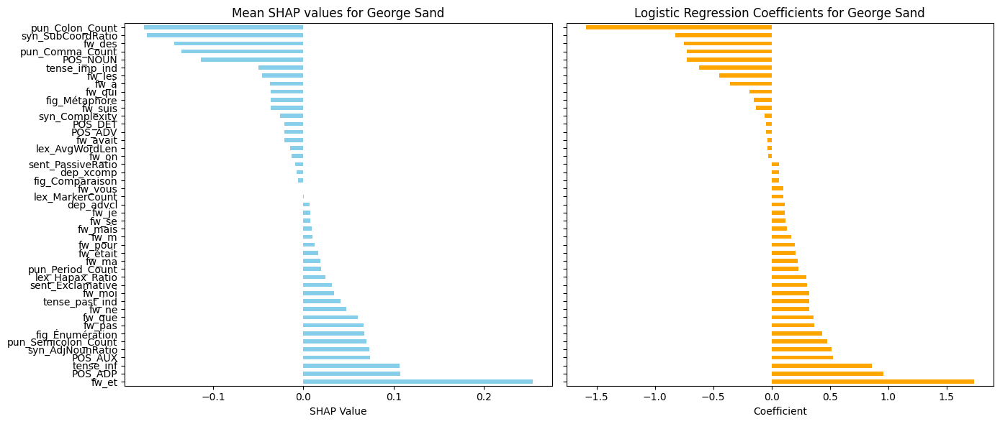

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# 🔧 Nom de l’auteur à analyser (doit correspondre à stylo_df["author"])
target_author = "George Sand"

# 🔍 Moyenne des SHAP values pour cet auteur (par feature)
author_shap_mean = shap_per_text[stylo_df["author"] == target_author].drop(columns="author").mean()

# 🔍 Coefficients du modèle pour cet auteur
# logreg_model.coef_ a shape (28, n_features) → on récupère l’index de l’auteur
author_idx = list(logreg_model.classes_).index(target_author)
author_coefs = pd.Series(logreg_model.coef_[author_idx], index=X.columns)

# 📊 Plots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

# Bar chart SHAP
author_shap_mean.sort_values(ascending=False).plot(kind="barh", ax=axes[0], color="skyblue")
axes[0].set_title(f"Mean SHAP values for {target_author}")
axes[0].set_xlabel("SHAP Value")
axes[0].invert_yaxis()

# Bar chart Coefficients
author_coefs.sort_values(ascending=False).plot(kind="barh", ax=axes[1], color="orange")
axes[1].set_title(f"Logistic Regression Coefficients for {target_author}")
axes[1].set_xlabel("Coefficient")

plt.tight_layout()
plt.show()




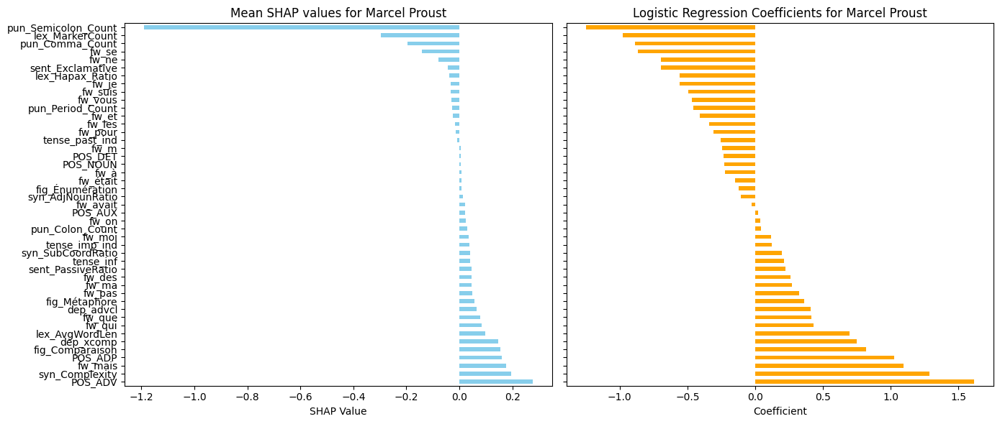

In [98]:

# 🔧 Nom de l’auteur à analyser (doit correspondre à stylo_df["author"])
target_author = "Marcel Proust"

# 🔍 Moyenne des SHAP values pour cet auteur (par feature)
author_shap_mean = shap_per_text[stylo_df["author"] == target_author].drop(columns="author").mean()

# 🔍 Coefficients du modèle pour cet auteur
# logreg_model.coef_ a shape (28, n_features) → on récupère l’index de l’auteur
author_idx = list(logreg_model.classes_).index(target_author)
author_coefs = pd.Series(logreg_model.coef_[author_idx], index=X.columns)

# 📊 Plots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

# Bar chart SHAP
author_shap_mean.sort_values(ascending=False).plot(kind="barh", ax=axes[0], color="skyblue")
axes[0].set_title(f"Mean SHAP values for {target_author}")
axes[0].set_xlabel("SHAP Value")
axes[0].invert_yaxis()

# Bar chart Coefficients
author_coefs.sort_values(ascending=False).plot(kind="barh", ax=axes[1], color="orange")
axes[1].set_title(f"Logistic Regression Coefficients for {target_author}")
axes[1].set_xlabel("Coefficient")

plt.tight_layout()

In [102]:
N = 15

shap_top = shap_mean.abs().sort_values(ascending=False).head(N)
coef_top = coef[shap_top.index]

spearman_corr, _ = spearmanr(shap_top, coef_top)
pearson_corr, _ = pearsonr(shap_top, coef_top)

In [103]:
from scipy.stats import spearmanr, pearsonr

results = []

for author in logreg_model.classes_:
    # Indice dans le modèle
    idx = list(logreg_model.classes_).index(author)

    # Moyenne SHAP pour l'auteur (sur tous ses extraits)
    shap_mean = shap_per_text[stylo_df["author"] == author].drop(columns="author").mean()

    # Coefficients du modèle pour cet auteur
    coef = pd.Series(logreg_model.coef_[idx], index=shap_mean.index)

    N = 15

    shap_top = shap_mean.abs().sort_values(ascending=False).head(N)
    coef_top = coef[shap_top.index]

    spearman_corr, _ = spearmanr(shap_top, coef_top)
    pearson_corr, _ = pearsonr(shap_top, coef_top)

    results.append({
        "Author": author,
        "Spearman": spearman_corr,
        "Pearson": pearson_corr
    })

correlation_df = pd.DataFrame(results).sort_values("Spearman", ascending=False)
display(correlation_df)


,Author,Spearman,Pearson
4,Anatole France,0.464286,0.319510
14,Jules Renard,0.428571,0.428661
13,Honoré de Balzac,0.317857,0.308080
8,George Sand,0.225000,0.160063
6,Charles Nodier,0.192857,0.166078
7,François Mauriac,0.150000,0.147352
5,André Gide,0.150000,0.446224
27,Émile Zola,0.139286,0.133915
11,Guy de Maupassant,0.121429,0.204656
2,Alfred de Vigny,0.110714,0.422485


In [107]:
shap_mean = shap_per_text[stylo_df["author"] == author].drop(columns="author").mean()
coef = pd.Series(logreg_model.coef_[idx], index=shap_mean.index)

rank_shap = shap_mean.rank(ascending=False)
rank_coef = coef.rank(ascending=False)
print("Auteur en cours :", author)

rank_diff = (rank_shap - rank_coef).abs().sort_values()

Auteur en cours : Émile Zola


In [109]:
author_rank_diffs = {}

for author in logreg_model.classes_:
    idx = list(logreg_model.classes_).index(author)
    shap_mean = shap_per_text[stylo_df["author"] == author].drop(columns="author").mean()
    coef = pd.Series(logreg_model.coef_[idx], index=shap_mean.index)

    rank_shap = shap_mean.rank(ascending=False)
    rank_coef = coef.rank(ascending=False)
    rank_diff = (rank_shap - rank_coef).abs()

    author_rank_diffs[author] = rank_diff


In [110]:
author_rank_diffs["Marcel Proust"].sort_values(ascending=False).head(10)


syn_Complexity         43.0
pun_Semicolon_Count    40.0
pun_Period_Count       32.0
fw_mais                29.0
sent_PassiveRatio      28.0
POS_NOUN               27.0
syn_SubCoordRatio      27.0
fw_pas                 27.0
sent_Exclamative       26.0
fw_et                  25.0
dtype: float64

In [91]:
# Moyenne SHAP sur tous les textes, pour chaque feature et chaque auteur
# (3858, 45, 28) → shap_values.values

import numpy as np
import pandas as pd

# Index des features et des classes
feature_names = list(X.columns)
author_names = list(logreg_model.classes_)

# Moyenne SHAP par (auteur, feature)
author_shap_dict = {
    author_names[i]: pd.Series(
        np.abs(shap_values.values[:, :, i]).mean(axis=0), 
        index=feature_names
    ) for i in range(len(author_names))
}

# Réel (signé) aussi disponible si besoin :
author_shap_signed = {
    author_names[i]: pd.Series(
        shap_values.values[:, :, i].mean(axis=0), 
        index=feature_names
    ) for i in range(len(author_names))
}


In [87]:
author_coefs = coefs # Coefficients pour chaque auteur

def plot_author_feature_importance(author, top_n=10):
    shap_vals = author_shap_dict[author]
    shap_signed = author_shap_signed[author]
    coef_vals = author_coefs.loc[author]

    # Top N features selon valeur absolue SHAP
    top_features = shap_vals.abs().sort_values(ascending=False).head(top_n).index

    # Préparer les barres
    shap_bar = shap_signed[top_features]
    coef_bar = coef_vals[top_features]

    x = np.arange(top_n)
    width = 0.35

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.bar(x - width/2, shap_bar, width, label="SHAP", color="skyblue")
    ax.bar(x + width/2, coef_bar, width, label="Coefficient", color="lightgreen")

    ax.set_xticks(x)
    ax.set_xticklabels(top_features, rotation=45, ha="right")
    ax.set_ylabel("Value")
    ax.set_title(f"Top {top_n} Features for Author: {author}")
    ax.legend()
    plt.tight_layout()
    plt.show()


In [88]:
# Chaque ligne de coefs correspond à un auteur dans logreg_model.classes_
author_coefs = pd.DataFrame(logreg_model.coef_, 
                            index=logreg_model.classes_, 
                            columns=X.columns)

# On suppose que shap_per_text contient les SHAP values pour chaque texte, plus la colonne 'author'
shap_per_author = shap_per_text.groupby("author").mean()
shap_per_author = shap_per_author[X.columns]  # même ordre

author_corrs = []

for author in logreg_model.classes_:
    shap_vec = shap_per_author.loc[author]
    coef_vec = author_coefs.loc[author]
    
    spearman_corr, _ = spearmanr(shap_vec, coef_vec)
    kendall_corr, _ = kendalltau(shap_vec, coef_vec)
    
    author_corrs.append({
        "Author": author,
        "Spearman": spearman_corr,
        "Kendall": kendall_corr
    })

author_corrs_df = pd.DataFrame(author_corrs).sort_values(by="Spearman", ascending=False)

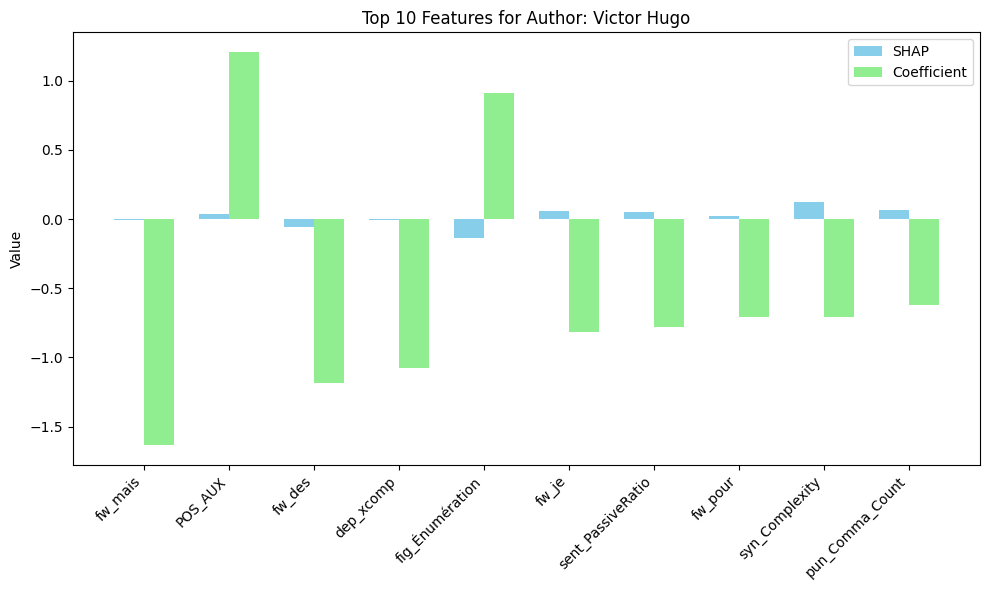

In [89]:
plot_author_feature_importance("Victor Hugo")

In [77]:
# Pour un auteur donné, ex : "Victor Hugo"
shap_per_text[stylo_df["author"] == "Victor Hugo"][["syn_Complexity", "pun_Semicolon_Count"]].describe()


,syn_Complexity,pun_Semicolon_Count
count,186.000000,186.000000
mean,0.445796,-0.064649
std,0.231122,0.248473
min,-0.383985,-1.096909
25%,0.303371,-0.186954
50%,0.469103,0.006066
75%,0.610964,0.116364
max,0.975780,0.309385


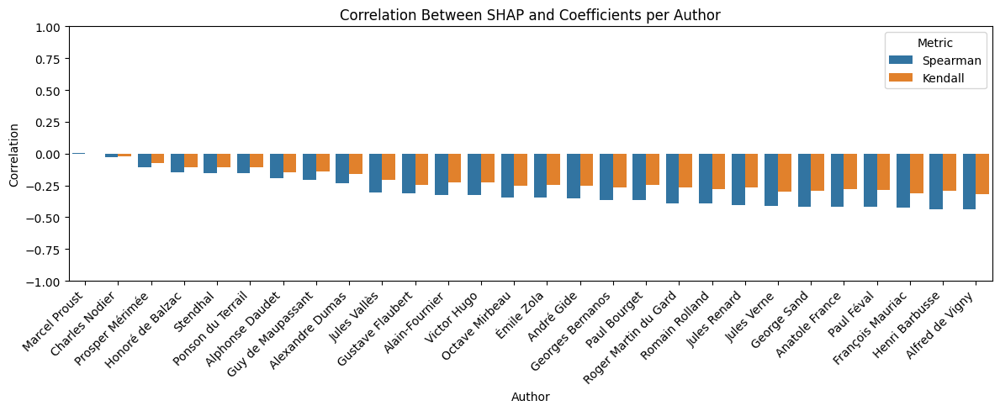

In [70]:
plt.figure(figsize=(12, 5))
sns.barplot(data=author_corrs_df.melt(id_vars="Author", var_name="Metric", value_name="Correlation"),
            x="Author", y="Correlation", hue="Metric")

plt.title("Correlation Between SHAP and Coefficients per Author")
plt.xticks(rotation=45, ha="right")
plt.ylim(-1, 1)
plt.tight_layout()
plt.show()

In [74]:
shap_per_author.loc["Alfred de Vigny"].sort_values(ascending=False).head(10)

pun_Period_Count     0.196843
syn_SubCoordRatio    0.111709
POS_NOUN             0.083775
fig_Métaphore        0.070000
fw_que               0.056052
pun_Comma_Count      0.037079
syn_Complexity       0.036002
tense_imp_ind        0.030569
fw_était             0.027050
fw_des               0.025492
Name: Alfred de Vigny, dtype: float64

In [62]:
author_name = "Alfred de Vigny"

# Index du bon classifieur OVR
coef_vec = author_coefs.loc[author_name]
top_coef_features = coef_vec.abs().sort_values(ascending=False).head(10)
print("🔹 Top 10 Coefficients for Marcel Proust:\n")
print(top_coef_features)

🔹 Top 10 Coefficients for Marcel Proust:

pun_Semicolon_Count    1.309240
fw_et                  1.054785
pun_Period_Count       0.769555
fig_Énumération        0.703583
syn_SubCoordRatio      0.695408
fw_que                 0.694977
tense_imp_ind          0.663593
pun_Colon_Count        0.618321
fw_ma                  0.613403
pun_Comma_Count        0.610356
Name: Alfred de Vigny, dtype: float64


In [63]:
shap_vec = shap_per_author.loc[author_name]
top_shap_features = shap_vec.abs().sort_values(ascending=False).head(10)
print("\n🔸 Top 10 SHAP Mean Values for Marcel Proust:\n")
print(top_shap_features)


🔸 Top 10 SHAP Mean Values for Marcel Proust:

pun_Semicolon_Count    0.346248
pun_Period_Count       0.196843
fw_et                  0.180152
syn_SubCoordRatio      0.111709
POS_NOUN               0.083775
POS_ADP                0.070072
fig_Métaphore          0.070000
fw_que                 0.056052
lex_MarkerCount        0.048806
pun_Comma_Count        0.037079
Name: Alfred de Vigny, dtype: float64


## yo

In [ ]:
def plot_coefficient_boxplot_by_prefix(coef_df):
    """
    Plot a boxplot of logistic regression coefficients grouped by feature prefix.
    `coef_df` is expected to be a DataFrame: rows = authors, cols = features.
    """
    # Step 1: Melt the DataFrame to long format
    melted = coef_df.reset_index().melt(id_vars='index', var_name='feature', value_name='coefficient')
    
    # Step 2: Extract the prefix (before underscore)
    melted['prefix'] = melted['feature'].str.extract(r'(^[^_]+_)')
    
    # Optional: Clean trailing underscore for display
    melted['prefix'] = melted['prefix'].str.replace('_$', '', regex=True)

    # Step 3: Plot
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=melted, x='prefix', y='coefficient', palette='Set2')
    plt.title("Distribution of Logistic Regression Coefficients by Feature Category")
    plt.xlabel("Feature Category (Prefix)")
    plt.ylabel("Coefficient Value")
    plt.axhline(0, color='gray', linestyle='--')
    plt.tight_layout()
    plt.show()

/var/folders/xn/v7b7dbbn6xg3hzr5h4395gbc0000gn/T/ipykernel_31191/2734682879.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=melted, x='prefix', y='coefficient', palette='Set2')


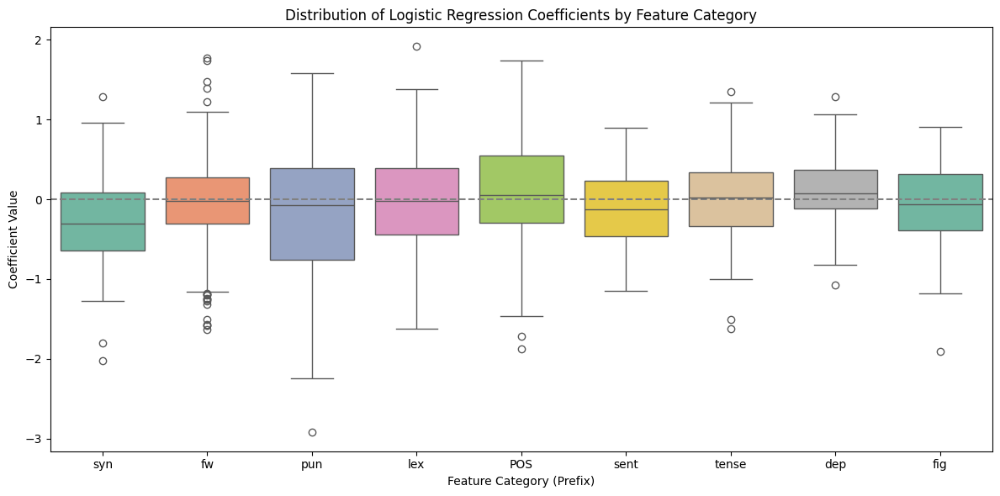

In [365]:
plot_coefficient_boxplot_by_prefix(coefs)

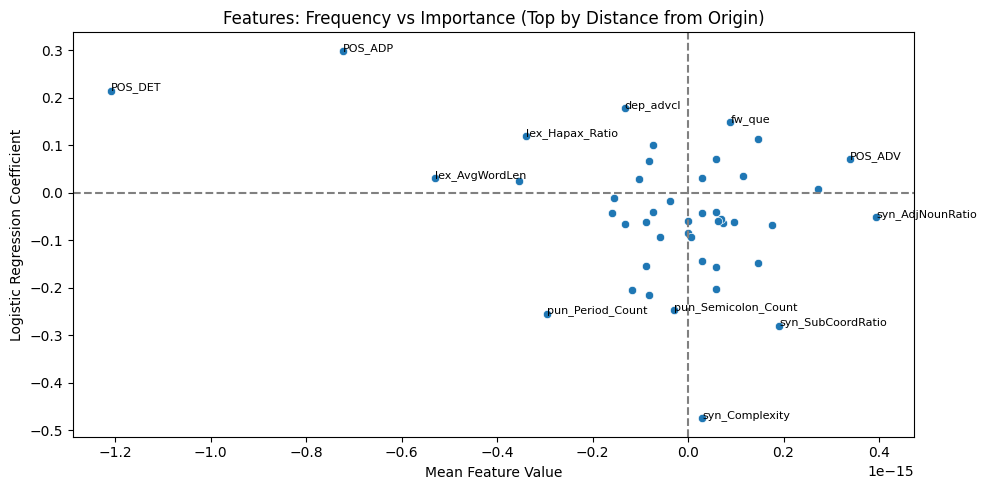

In [407]:
def plot_feature_mean_vs_coeff_normalized(coefs, stylo_df, annotate_top_n=10):
    """
    Scatter plot of mean feature value vs logistic regression coefficient.
    Annotates features furthest from (0,0) using normalized axes.
    """

    feature_cols = [col for col in coefs.columns if col in stylo_df.columns and stylo_df[col].dtype != 'object']
    feature_means = stylo_df[feature_cols].mean()
    feature_coeffs = coefs[feature_cols].mean()
    
    df = pd.DataFrame({
        'MeanValue': feature_means,
        'Coeff': feature_coeffs
    }).dropna()

    # Normalize axes for fair distance computation
    df['NormMean'] = (df['MeanValue'] - df['MeanValue'].mean()) / df['MeanValue'].std()
    df['NormCoeff'] = (df['Coeff'] - df['Coeff'].mean()) / df['Coeff'].std()
    df['Distance'] = np.sqrt(df['NormMean']**2 + df['NormCoeff']**2)

    # Plot
    plt.figure(figsize=(10, 5))
    sns.scatterplot(data=df, x='MeanValue', y='Coeff')

    # Annotate top distant points
    for feat in df.sort_values('Distance', ascending=False).head(annotate_top_n).index:
        x, y = df.loc[feat, ['MeanValue', 'Coeff']]
        plt.text(x, y, feat, fontsize=8)

    plt.axhline(0, ls='--', color='grey')
    plt.axvline(0, ls='--', color='grey')
    plt.xlabel("Mean Feature Value")
    plt.ylabel("Logistic Regression Coefficient")
    plt.title("Features: Frequency vs Importance (Top by Distance from Origin)")
    plt.tight_layout()
    plt.show()


plot_feature_mean_vs_coeff_normalized(coefs, stylo_df, annotate_top_n=12)


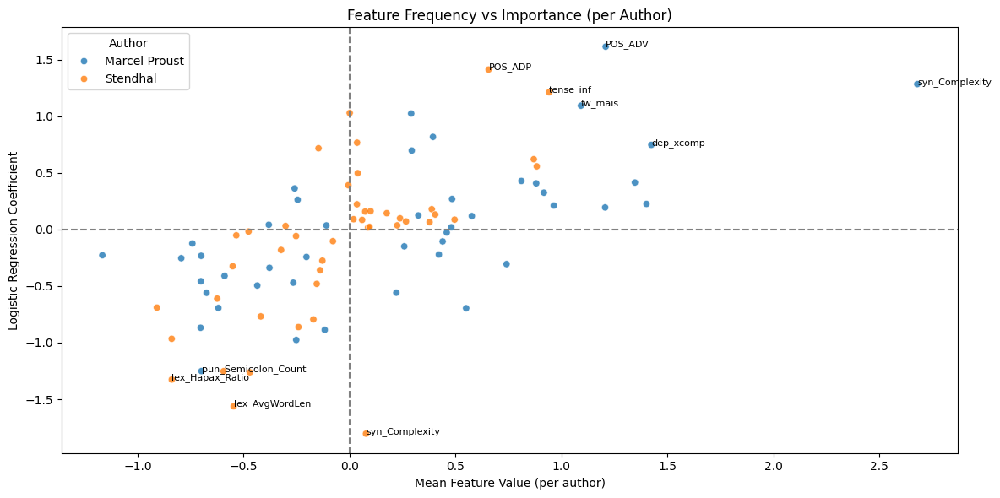

In [413]:
def plot_feature_value_vs_coeff_by_author(authors_list, coefs, stylo_df, annotate_top_n=10, fit_line=False):
    """
    Scatter plot: feature mean per author vs their LR coefficient, colored by author.
    Optionally adds a global regression line (ignoring authors) with R² score.
    """

    feature_cols = [col for col in coefs.columns if col in stylo_df.columns and stylo_df[col].dtype != 'object']
    df_plot = []

    for author in authors_list:
        if author not in coefs.index:
            continue
        # Mean values of features for this author
        author_mean = stylo_df[stylo_df['author'] == author][feature_cols].mean()
        # Corresponding coefficients
        author_coefs = coefs.loc[author, feature_cols]
        
        for feat in feature_cols:
            df_plot.append({
                'Author': author,
                'Feature': feat,
                'MeanValue': author_mean.get(feat, np.nan),
                'Coeff': author_coefs.get(feat, np.nan)
            })

    df = pd.DataFrame(df_plot).dropna()

    plt.figure(figsize=(12, 6))
    sns.scatterplot(data=df, x='MeanValue', y='Coeff', hue='Author', alpha=0.8)

    # Annotate top N points (most distant from origin)
    df['NormMean'] = (df['MeanValue'] - df['MeanValue'].mean()) / df['MeanValue'].std()
    df['NormCoeff'] = (df['Coeff'] - df['Coeff'].mean()) / df['Coeff'].std()
    df['Distance'] = np.sqrt(df['NormMean']**2 + df['NormCoeff']**2)

    for _, row in df.sort_values('Distance', ascending=False).head(annotate_top_n).iterrows():
        plt.text(row['MeanValue'], row['Coeff'], row['Feature'], fontsize=8)

    # Optional fit line
    if fit_line:
        X = df[['MeanValue']].values
        y = df['Coeff'].values
        model = LinearRegression().fit(X, y)
        y_pred = model.predict(X)
        r2 = r2_score(y, y_pred)
        x_range = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)
        y_range = model.predict(x_range)
        print(r2)
        plt.plot(x_range, y_range, color='black', linestyle='--', label=f'Fit (R²={r2:.2f})')
        plt.legend()

    plt.axhline(0, ls='--', color='grey')
    plt.axvline(0, ls='--', color='grey')
    plt.xlabel("Mean Feature Value (per author)")
    plt.ylabel("Logistic Regression Coefficient")
    plt.title("Feature Frequency vs Importance (per Author)")
    plt.tight_layout()
    plt.show()



authors_list = ["Marcel Proust", "Stendhal"]
plot_feature_value_vs_coeff_by_author(authors_list, coefs, stylo_df, annotate_top_n=10)

0.3747759959461615


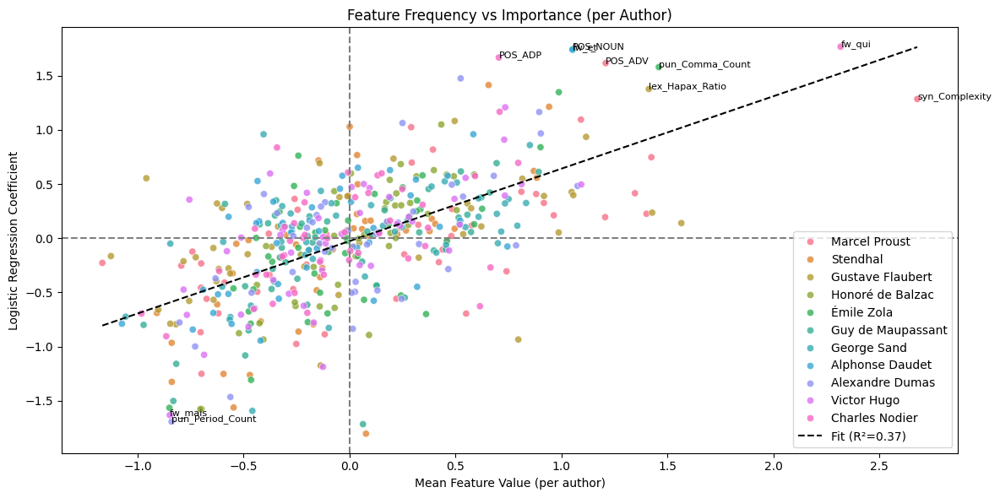

In [415]:
authors_list = ["Marcel Proust", "Stendhal", "Gustave Flaubert", "Honoré de Balzac", "Émile Zola", "Guy de Maupassant", "George Sand", "Alphonse Daudet", "Alexandre Dumas", "Victor Hugo", "Charles Nodier", "Francois Mauriac"]
plot_feature_value_vs_coeff_by_author(authors_list, coefs, stylo_df, annotate_top_n=10, fit_line=True)

## Selecting key authors

In [234]:
for idx, row in authors_df.iterrows():
    print(f"Author: {row['Name']}")
    print(f"  Mouvement: {row['Mouvement']}")
    print(f"  Genres: {row['Genres']}")
    print("-" * 40)

Author: Charles Nodier
  Mouvement: Romantisme
  Genres: Fantastique, Gothique, Philosophique
----------------------------------------
Author: Stendhal
  Mouvement: Réalisme
  Genres: Psychologique, Amour, Social / Moeurs, Autobiographique / Autofiction
----------------------------------------
Author: Alfred de Vigny
  Mouvement: Romantisme
  Genres: Philosophique, Psychologique, Amour
----------------------------------------
Author: Honoré de Balzac
  Mouvement: Réalisme
  Genres: Amour, Social / Moeurs, Historique, Satirique
----------------------------------------
Author: Alexandre Dumas
  Mouvement: Romantisme
  Genres: Amour, Aventure, Historique, Cape et d’épée
----------------------------------------
Author: Victor Hugo
  Mouvement: Romantisme
  Genres: Historique, Amour, Social / Moeurs, Satirique
----------------------------------------
Author: Prosper Mérimée
  Mouvement: Romantisme
  Genres: Amour, Fantastique, Psychologique, Aventure
----------------------------------------

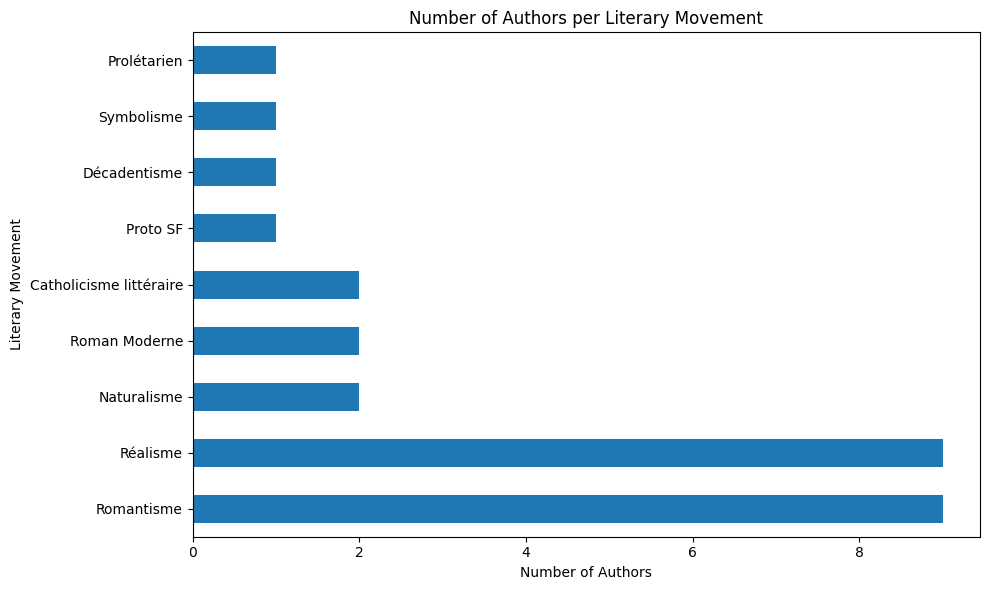

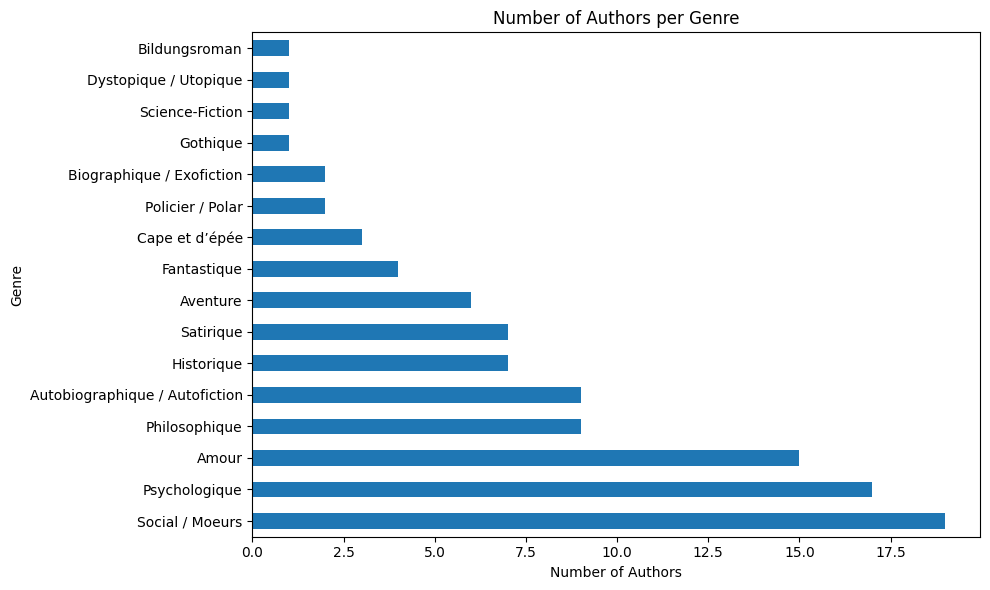

In [235]:
# Count how many authors are associated with each literary movement
mouvement_counts = authors_df['Mouvement'].value_counts()

# Plot the counts as a horizontal bar chart
plt.figure(figsize=(10, 6))
mouvement_counts.plot(kind='barh')
plt.title('Number of Authors per Literary Movement')
plt.xlabel('Number of Authors')
plt.ylabel('Literary Movement')
plt.tight_layout()
plt.show()

# --- Count of authors per 'Genre' ---

# Step 1: Split the 'Genres' column by commas and strip spaces
# This creates a new Series where each row is a list of genres
authors_df['Genre_List'] = authors_df['Genres'].apply(lambda x: [g.strip() for g in x.split(',')])

# Step 2: Explode the list into multiple rows, one per genre per author
exploded_genres = authors_df.explode('Genre_List')

# Step 3: Count how many authors are associated with each genre
genre_counts = exploded_genres['Genre_List'].value_counts()

# Plot the counts as a horizontal bar chart
plt.figure(figsize=(10, 6))
genre_counts.plot(kind='barh')
plt.title('Number of Authors per Genre')
plt.xlabel('Number of Authors')
plt.ylabel('Genre')
plt.tight_layout()
plt.show()

In [236]:

# Step 1: Keep only feature columns from stylo_df
feature_cols = stylo_df.columns.difference(['author'])
X_stylo = stylo_df[feature_cols]
authors = stylo_df['author']

# Step 2: Compute average stylistic vector per author
author_vectors = stylo_df.groupby('author')[feature_cols].mean()

# Step 3: Compute pairwise cosine distances between author vectors
distance_matrix = pd.DataFrame(
    cosine_distances(author_vectors),
    index=author_vectors.index,
    columns=author_vectors.index
)

# Step 4: Compute unicity and centrality for each author
unicity = distance_matrix.mean(axis=1)
centrality = 1 / (unicity + 1e-6)  # add small epsilon to avoid division by zero

# Step 5: Merge unicity, centrality, and WikiLangCount into authors_df
# First, set Name as index to match with unicity/centrality (which use author names as index)
authors_df = authors_df.set_index('Name')

# Add new columns
authors_df['Unicity'] = unicity
authors_df['Centrality'] = centrality

# Make sure WikiLangCount is float (for sorting)
authors_df['WikiLangCount'] = authors_df['WikiLangCount'].astype(float)

# Step 6: Select top authors by each criterion
top_unique = authors_df.sort_values('Unicity', ascending=False).head(5)
top_central = authors_df.sort_values('Centrality', ascending=False).head(5)
top_known = authors_df.sort_values('WikiLangCount', ascending=False).head(5)

# Step 7: Print results
print("Most unique authors:")
for name in top_unique.index:
    print(f"- {name}")

print("\nMost central authors:")
for name in top_central.index:
    print(f"- {name}")

print("\nMost renowned authors:")
for name in top_known.index:
    print(f"- {name}")

Most unique authors:
- Alexandre Dumas
- Marcel Proust
- Émile Zola
- Jules Verne
- George Sand

Most central authors:
- François Mauriac
- Jules Renard
- Georges Bernanos
- Roger Martin du Gard
- Alphonse Daudet

Most renowned authors:
- Victor Hugo
- Jules Verne
- Marcel Proust
- Alexandre Dumas
- Honoré de Balzac


Correlation (Pearson) between Renown and Unicity: 0.438
Correlation (Spearman) between Renown and Unicity: 0.419


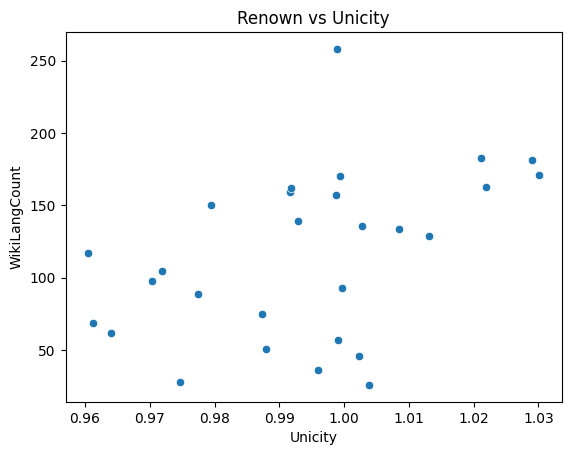

ANOVA result for Renown ~ Mouvement: F = 0.88, p = 0.5524


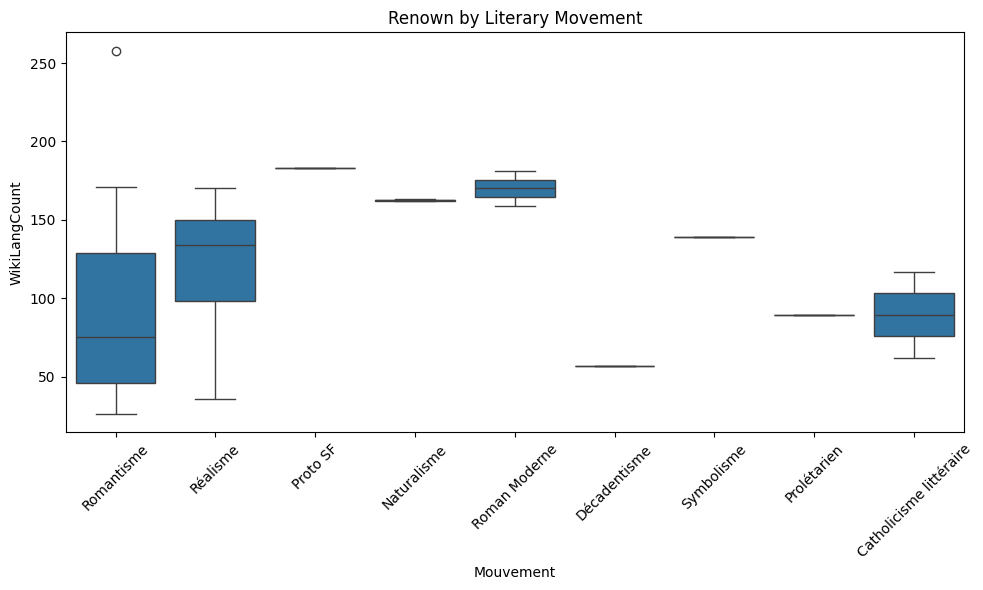

ANOVA result for Unicity ~ Mouvement: F = 1.97, p = 0.1073


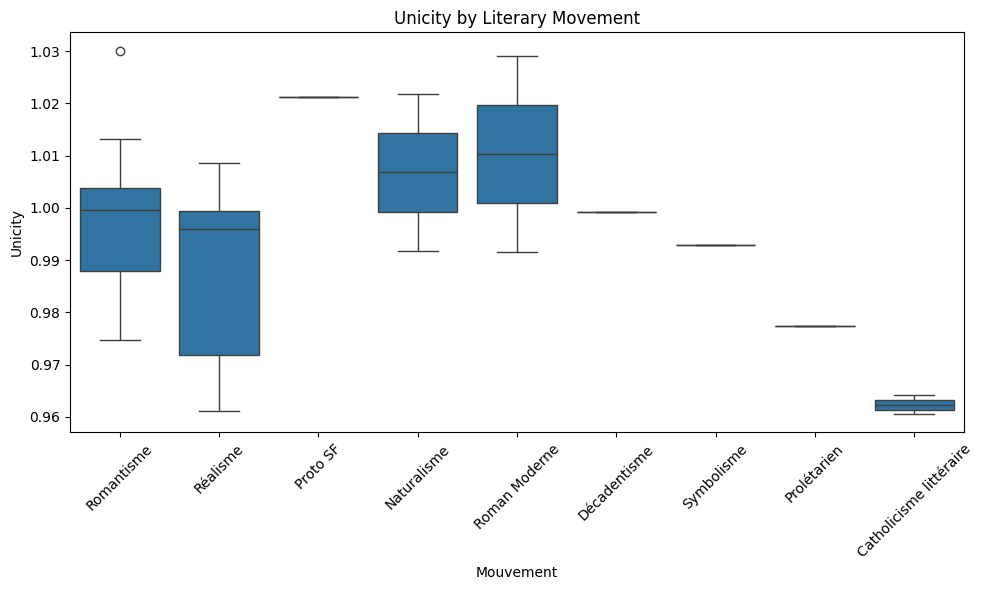

In [237]:


# Make sure WikiLangCount is numeric
authors_df['WikiLangCount'] = authors_df['WikiLangCount'].astype(float)

# --- Correlation between Renown and Unicity  ---

# Calculate both Pearson and Spearman correlations
pearson_uni, _ = pearsonr(authors_df['WikiLangCount'], authors_df['Unicity'])
spearman_uni, _ = spearmanr(authors_df['WikiLangCount'], authors_df['Unicity'])


print(f"Correlation (Pearson) between Renown and Unicity: {pearson_uni:.3f}")
print(f"Correlation (Spearman) between Renown and Unicity: {spearman_uni:.3f}")

# --- Visualization ---

sns.scatterplot(data=authors_df, x='Unicity', y='WikiLangCount')
plt.title('Renown vs Unicity')
plt.show()


# --- ANOVA: Does Renown vary significantly by Mouvement? ---

# Drop rows with missing Mouvement or WikiLangCount
subset = authors_df.dropna(subset=['Mouvement', 'WikiLangCount'])

# Prepare WikiLangCount grouped by Mouvement
groups = [group['WikiLangCount'].values for name, group in subset.groupby('Mouvement')]

# Perform one-way ANOVA test
anova_stat, anova_p = f_oneway(*groups)

print(f"ANOVA result for Renown ~ Mouvement: F = {anova_stat:.2f}, p = {anova_p:.4f}")

# Boxplot to visualize
plt.figure(figsize=(10, 6))
sns.boxplot(data=subset, x='Mouvement', y='WikiLangCount')
plt.xticks(rotation=45)
plt.title('Renown by Literary Movement')
plt.tight_layout()
plt.show()

# --- ANOVA: Does Unicity vary significantly by Mouvement? ---

# Drop rows with missing Mouvement or Unicity
subset_unicity = authors_df.dropna(subset=['Mouvement', 'Unicity'])

# Prepare Unicity values grouped by Mouvement
groups_uni = [group['Unicity'].values for name, group in subset_unicity.groupby('Mouvement')]

# Perform one-way ANOVA test
anova_uni_stat, anova_uni_p = f_oneway(*groups_uni)

print(f"ANOVA result for Unicity ~ Mouvement: F = {anova_uni_stat:.2f}, p = {anova_uni_p:.4f}")

# Boxplot to visualize Unicity by Movement
plt.figure(figsize=(10, 6))
sns.boxplot(data=subset_unicity, x='Mouvement', y='Unicity')
plt.xticks(rotation=45)
plt.title('Unicity by Literary Movement')
plt.tight_layout()
plt.show()


In [238]:
authors_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28 entries, Charles Nodier to Georges Bernanos
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   birth_date     28 non-null     object 
 1   death_date     28 non-null     object 
 2   n_books        28 non-null     int64  
 3   Mouvement      28 non-null     object 
 4   Genres         28 non-null     object 
 5   n_excerpts     28 non-null     int64  
 6   WikiLangCount  28 non-null     float64
 7   Genre_List     28 non-null     object 
 8   Unicity        28 non-null     float64
 9   Centrality     28 non-null     float64
dtypes: float64(3), int64(2), object(5)
memory usage: 3.5+ KB


## XAI - Log Reg coefficients

### Features coeffs by author

In [239]:
# Récupérer les noms des auteurs
author_labels = logreg_model.classes_

# Récupérer les coefficients du modèle
coefs = pd.DataFrame(
    logreg_model.coef_,
    index=author_labels,
    columns=stylo_df.columns[1:]  # on exclut la colonne "author"
)

In [240]:
def plot_top_features(author, k=None, threshold=None):
    """
    Plot influential features for a given author from the logistic regression model.
    
    Parameters:
    - author: str, name of the author
    - k: int or None, number of top features by absolute coefficient
    - threshold: float or None, minimum absolute coefficient value
    """
    # Get coefficients for this author
    author_coefs = coefs.loc[author]
    
    # Select features
    if threshold is not None:
        selected = author_coefs[author_coefs.abs() >= threshold]
    elif k is not None:
        top_features = author_coefs.abs().sort_values(ascending=False).head(k).index
        selected = author_coefs[top_features]
    else:
        raise ValueError("Specify either k or threshold.")
    
    # Sort for visualization
    selected = selected.sort_values()

    # Plot
    plt.figure(figsize=(8, 5))
    selected.plot(kind="barh")
    plt.title(f"Influential features for {author}")
    plt.xlabel("Coefficient")
    plt.tight_layout()
    plt.show()


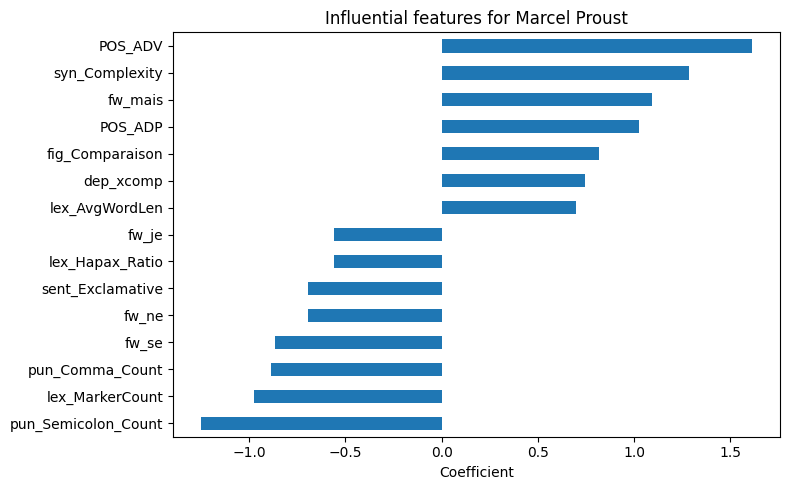

In [241]:
plot_top_features("Marcel Proust", threshold=0.5)

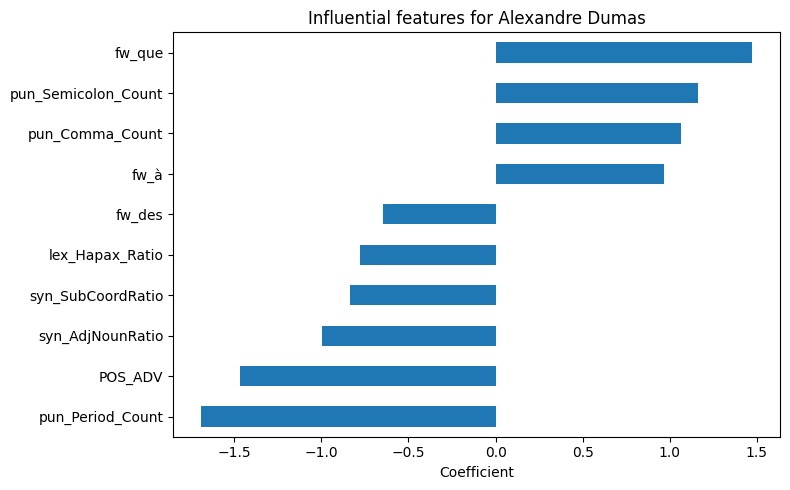

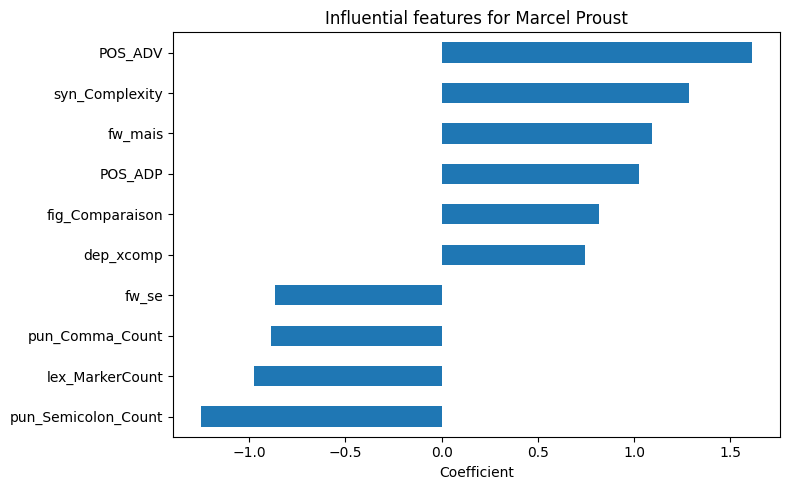

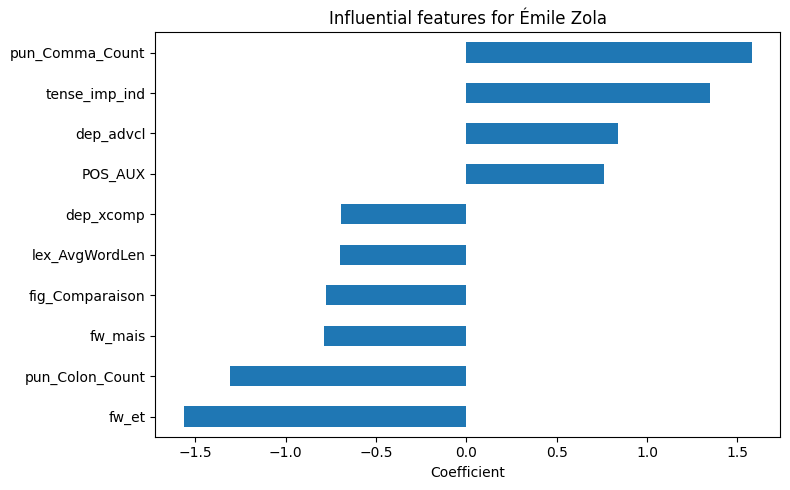

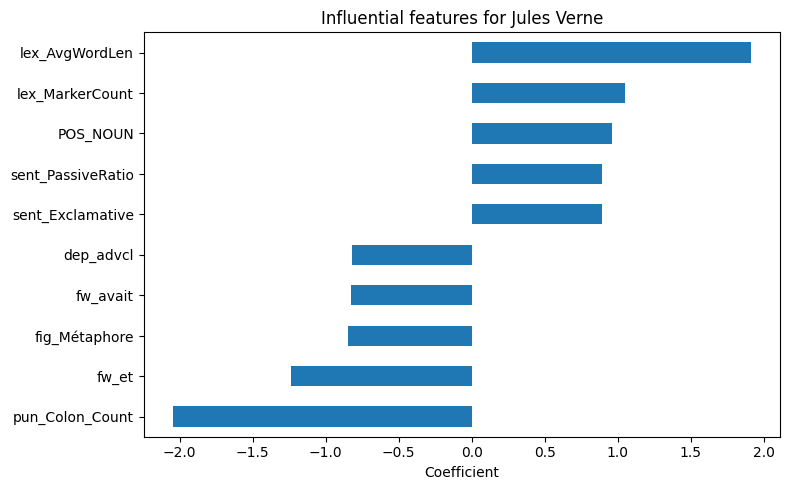

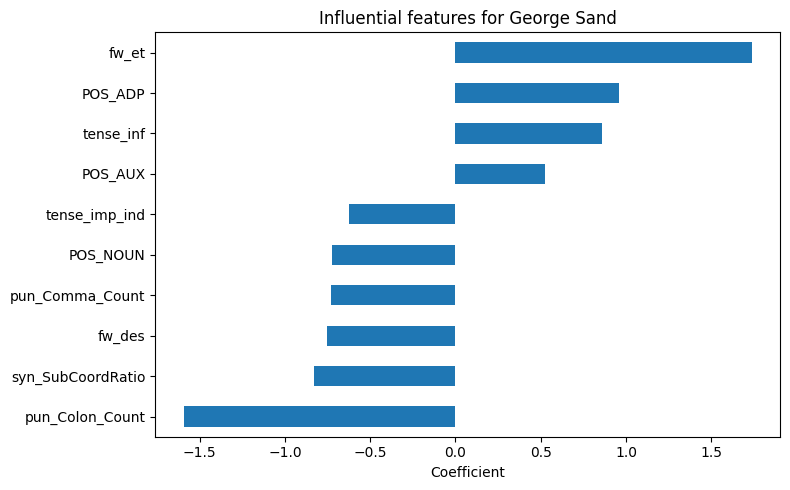

In [242]:
for author in top_unique.index:
    plot_top_features(author, k=10)

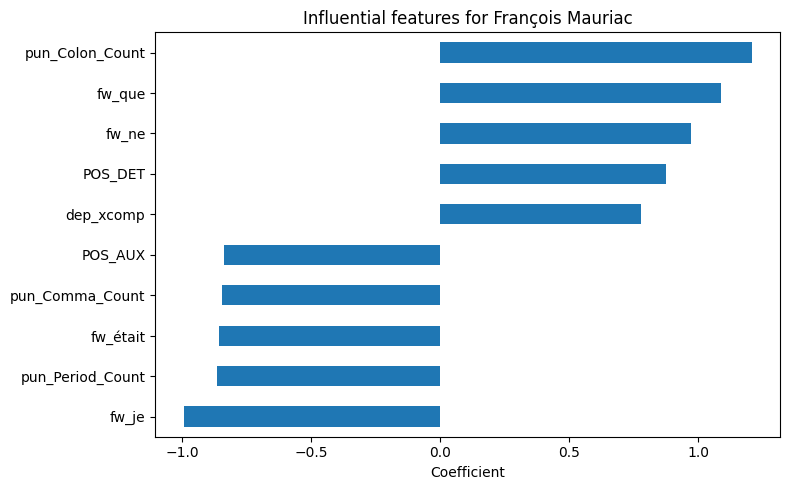

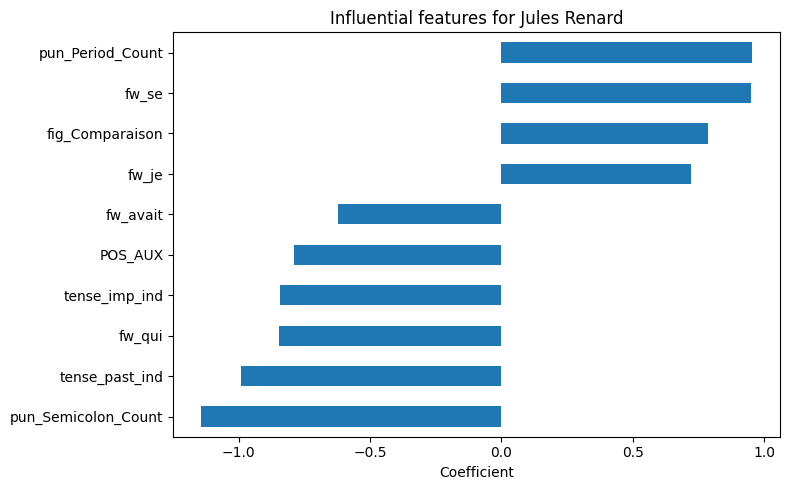

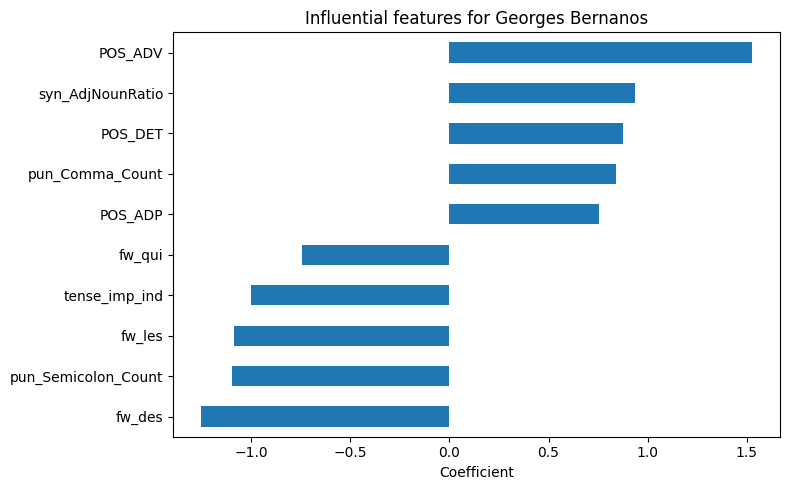

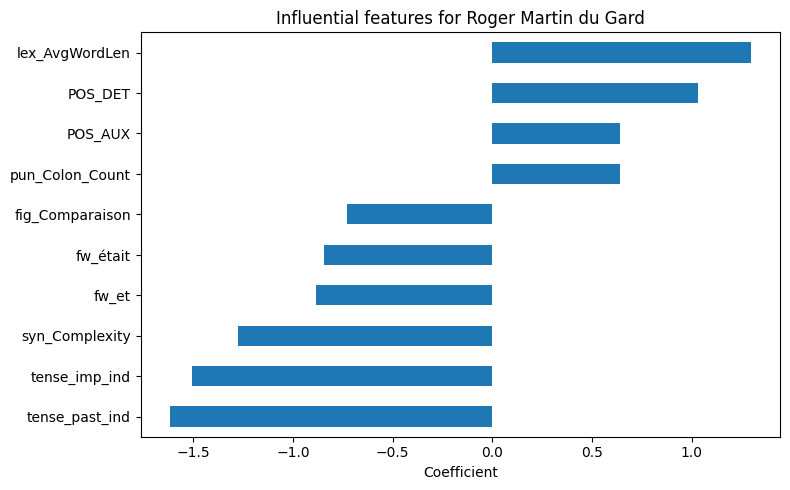

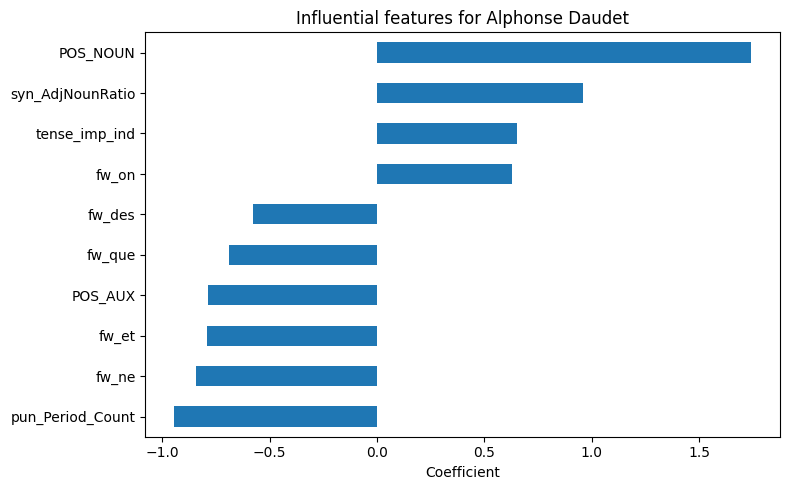

In [243]:
for author in top_central.index:
    plot_top_features(author, k=10)

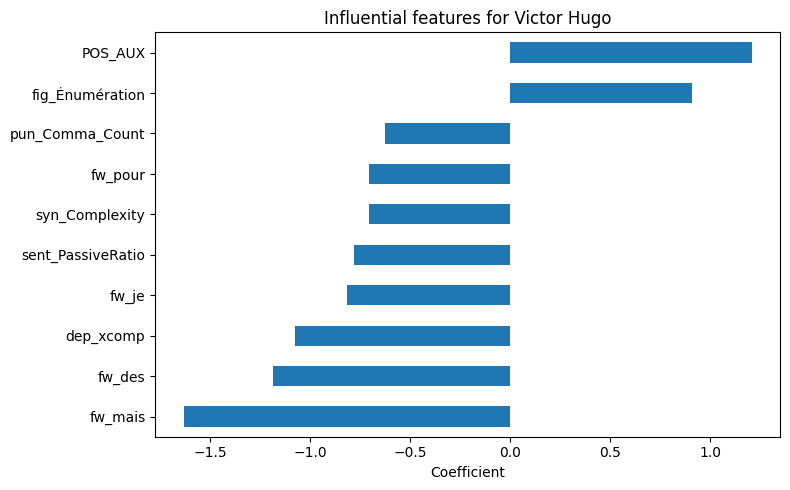

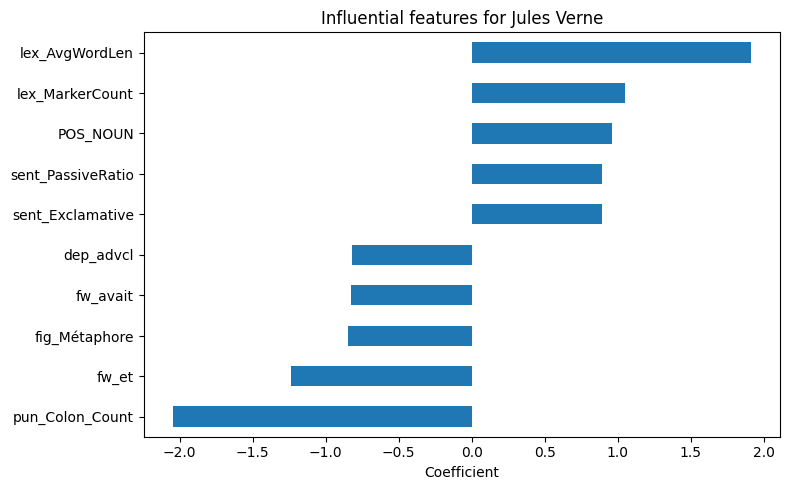

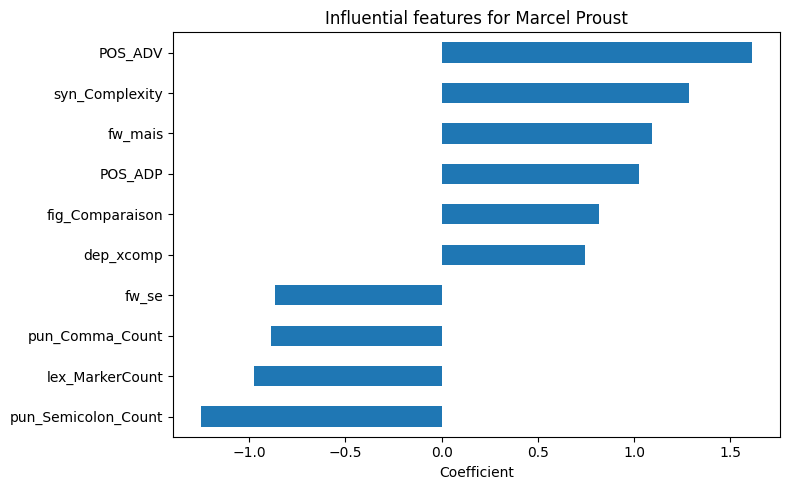

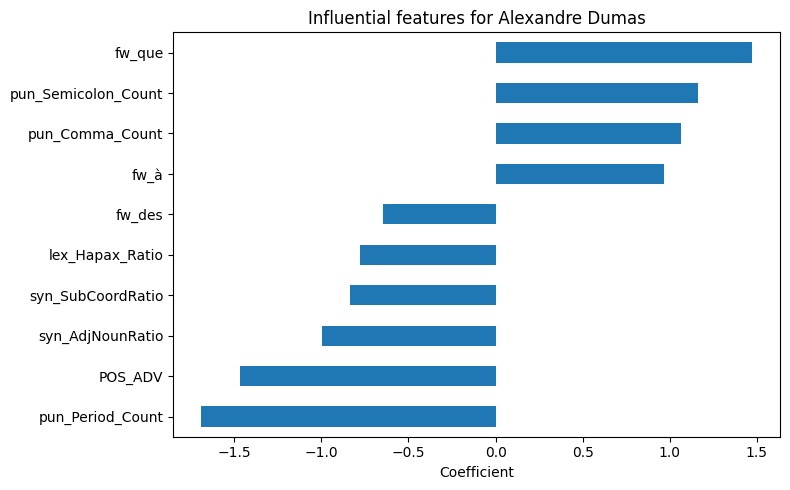

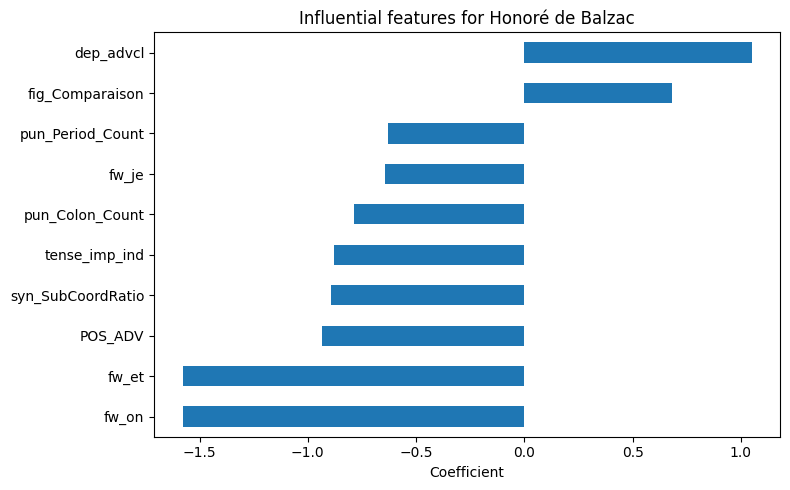

In [244]:
for author in top_known.index:
    plot_top_features(author, k=10)

### by group of authors

In [245]:
def plot_group_signature(authors_list, title="Group Style Signature", top_n=10):
    """
    Show the average signed coefficient for a group of authors,
    selecting the top_n most discriminative features (by absolute value).
    """
    group_coefs = coefs.loc[authors_list]

    # Step 1: Get absolute mean to rank top features
    mean_abs = group_coefs.abs().mean().sort_values(ascending=False).head(top_n)

    # Step 2: Retrieve real signed values for plotting
    mean_signed = group_coefs.mean()[mean_abs.index].sort_values()

    # Plot
    plt.figure(figsize=(8, 5))
    mean_signed.plot(kind="barh", color=['red' if v < 0 else 'blue' for v in mean_signed])
    plt.title(title)
    plt.xlabel("Average coefficient (signed)")
    plt.tight_layout()
    plt.show()



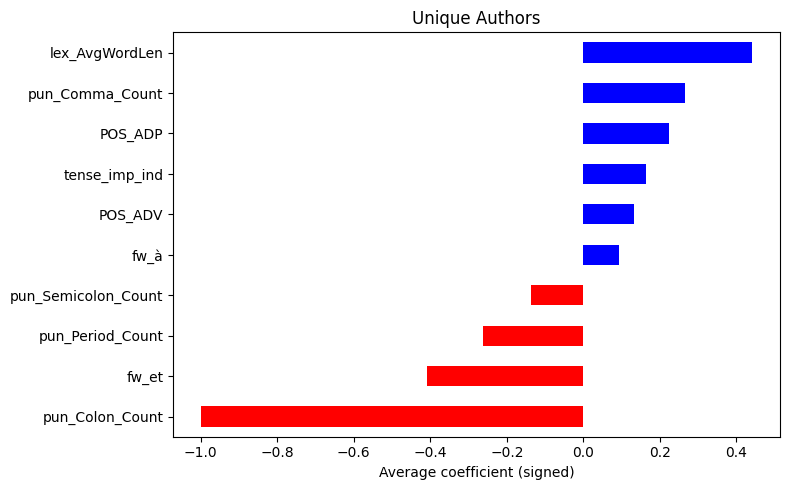

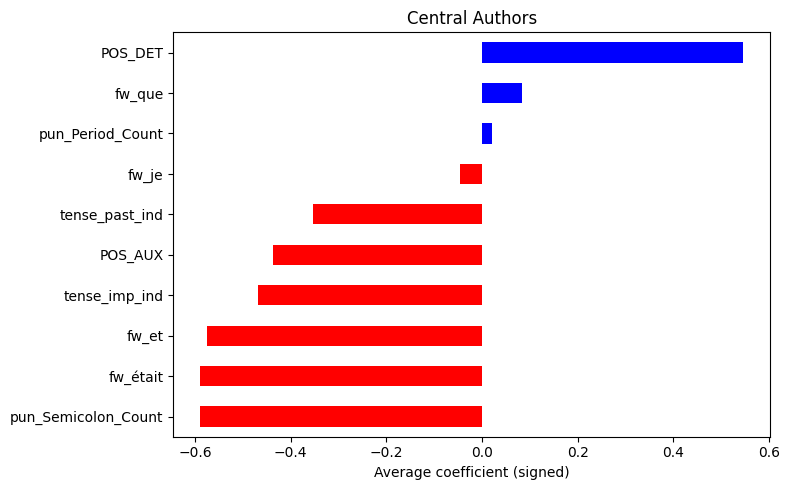

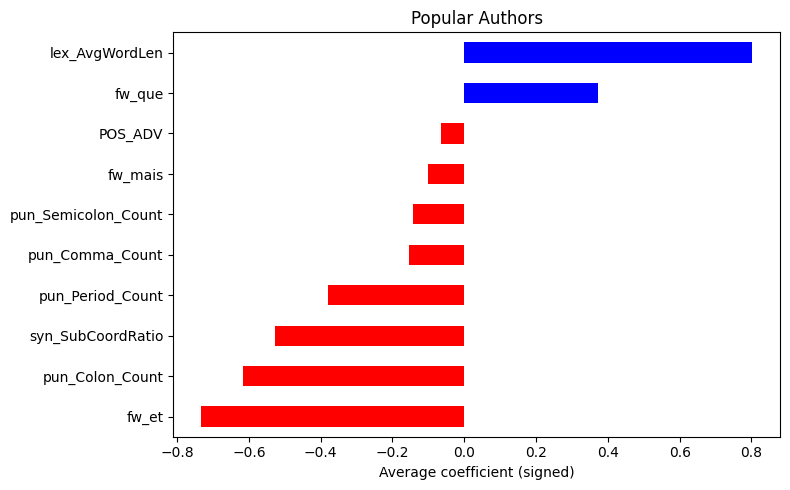

In [246]:
plot_group_signature(top_unique.index, title="Unique Authors")
plot_group_signature(top_central.index, title="Central Authors")
plot_group_signature(top_known.index, title="Popular Authors")

In [247]:
def plot_style_by_category(category_col, category_value, top_n=10):
    """
    Plot average absolute coefficient signature for a genre or movement category.
    
    Parameters:
    - category_col: 'Mouvement' or 'Genres'
    - category_value: the category name to filter on
    - top_n: number of top stylometric features to display
    """
    if category_col == "Genres":
        # Handle multiple genres per author
        exploded = authors_df.copy()
        exploded['Genre_List'] = exploded['Genres'].apply(lambda x: [g.strip() for g in x.split(',')])
        exploded = exploded.explode('Genre_List')
        authors_in_cat = exploded[exploded['Genre_List'] == category_value].index
    else:
        # Direct filter for Mouvement
        authors_in_cat = authors_df[authors_df[category_col] == category_value].index

    n_authors = len(authors_in_cat)
    if n_authors == 0:
        print(f"No authors found for {category_col} = {category_value}")
        return

    # Plot average signature
    title = f"{category_col}: {category_value} ({n_authors} author{'s' if n_authors > 1 else ''})"
    plot_group_signature(authors_in_cat, title=title, top_n=top_n)


=== MOVEMENTS ===


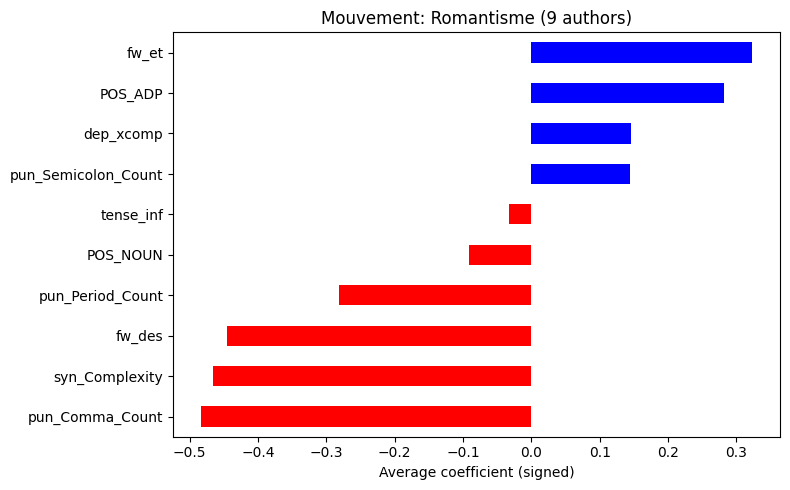

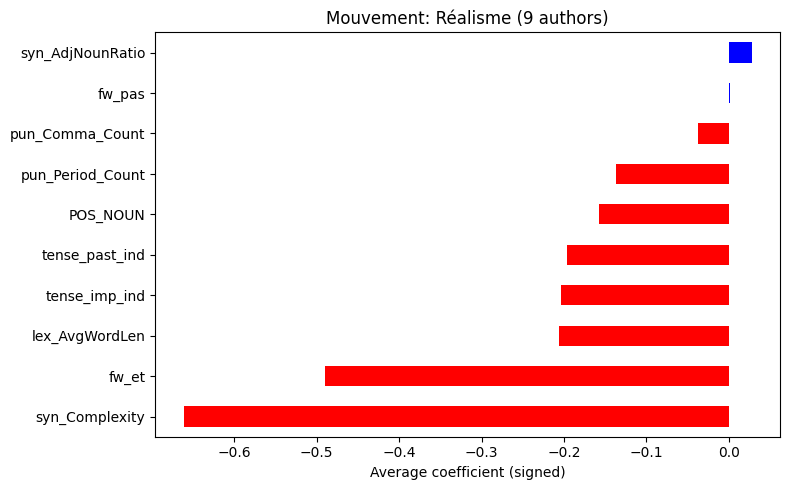

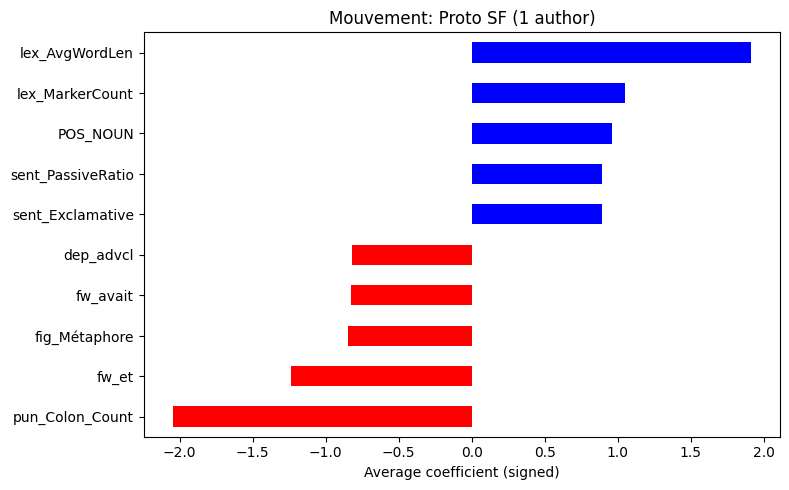

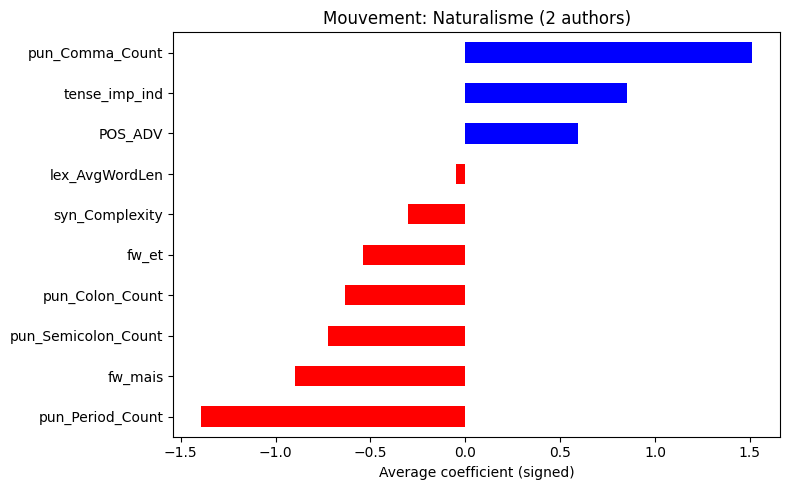

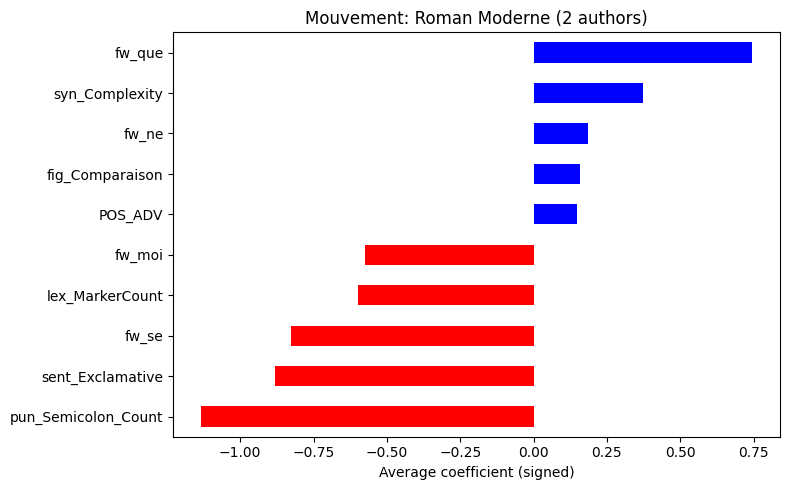

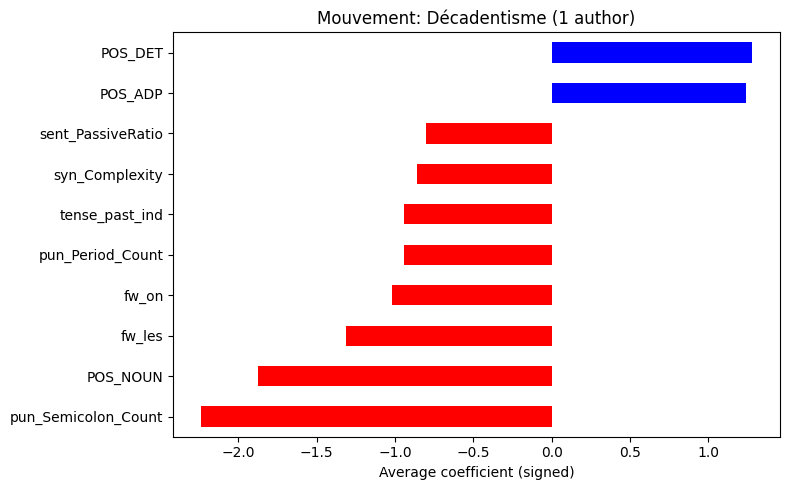

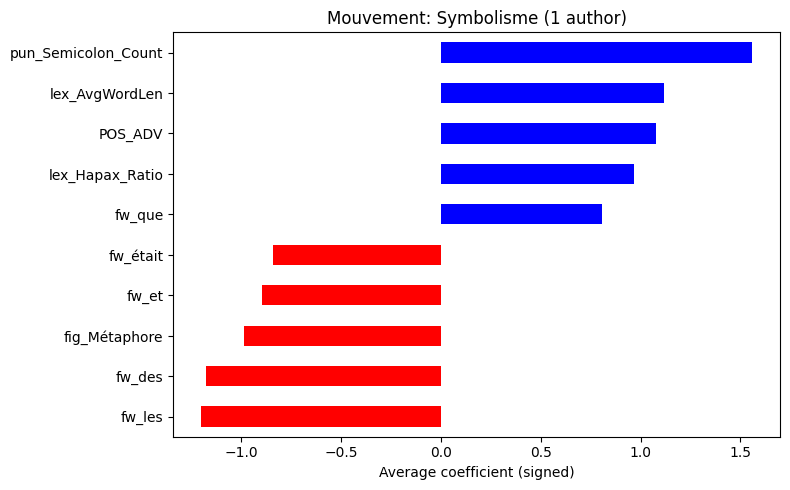

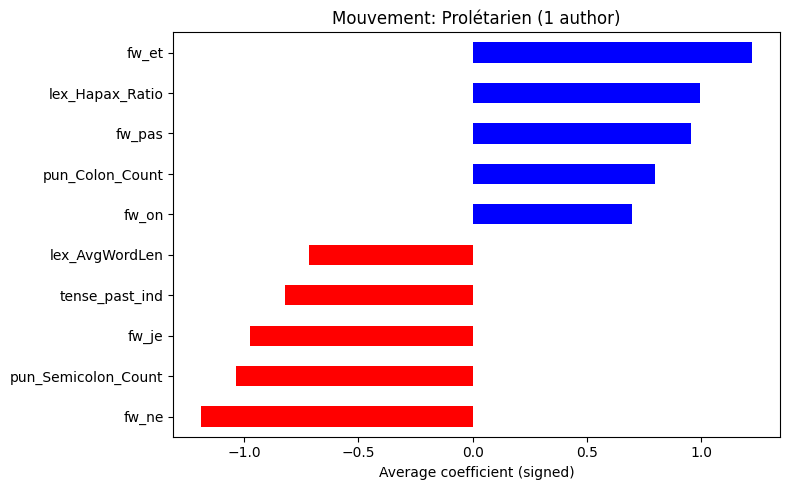

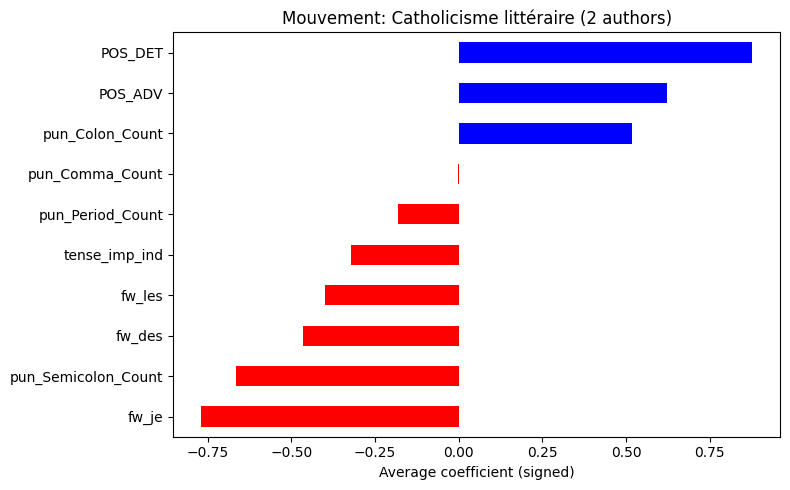


=== GENRES ===


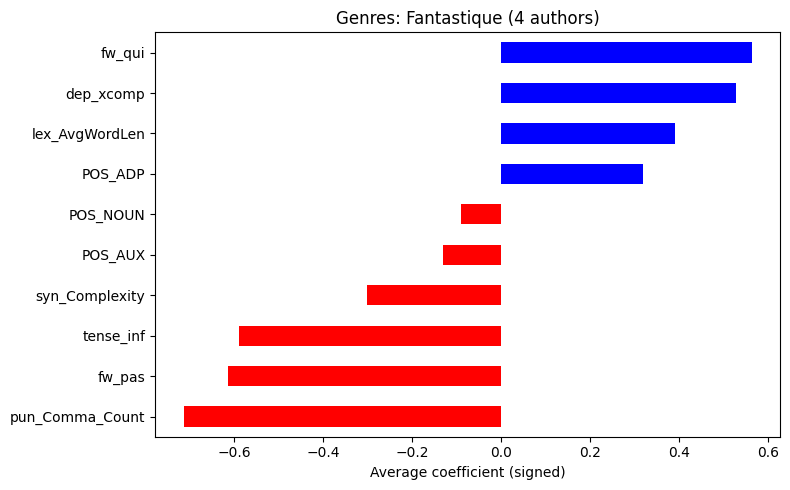

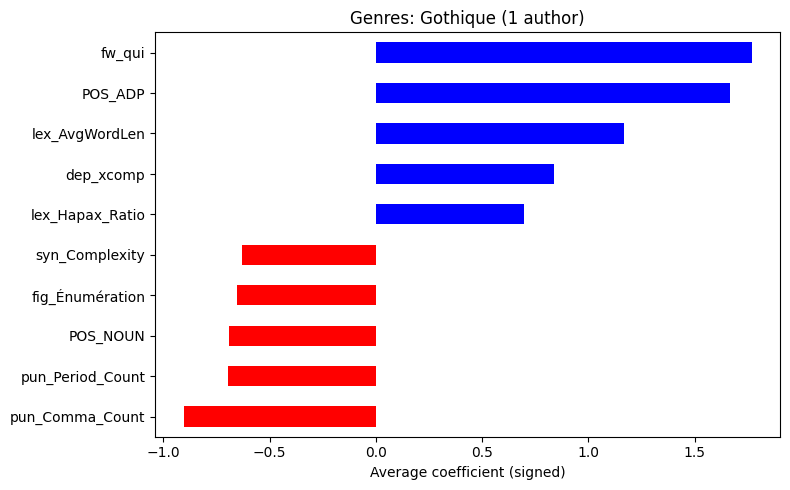

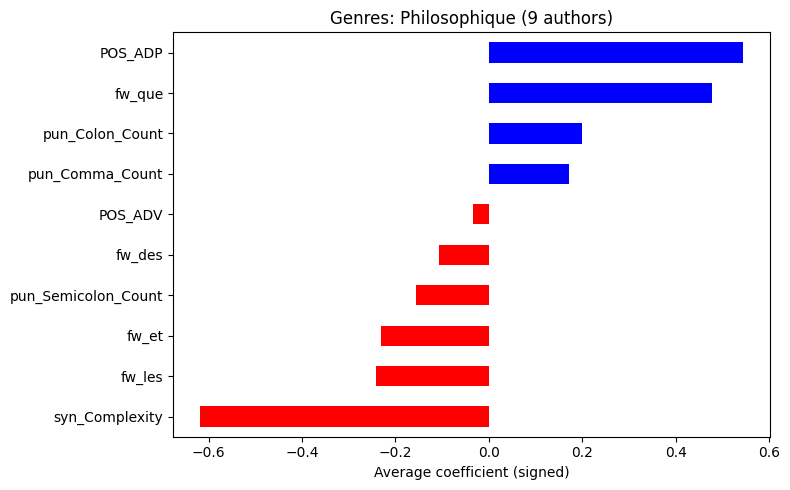

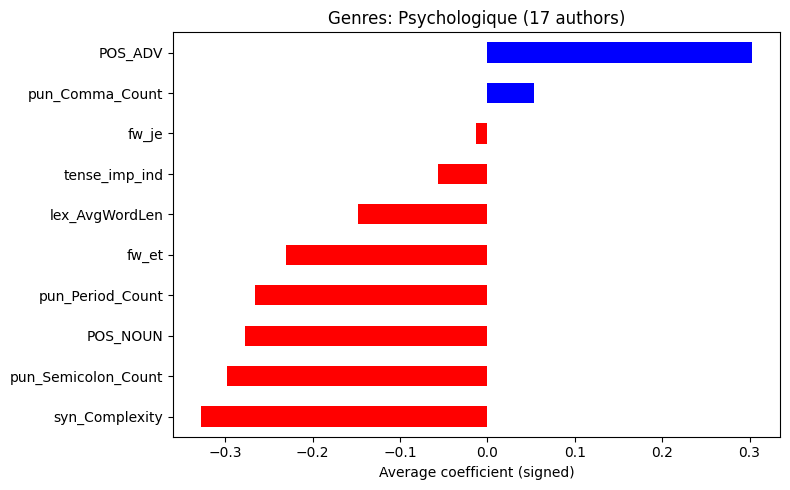

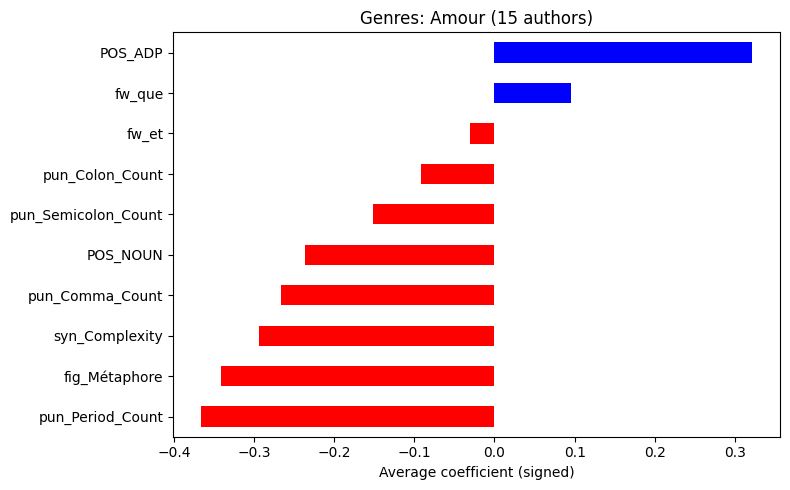

...

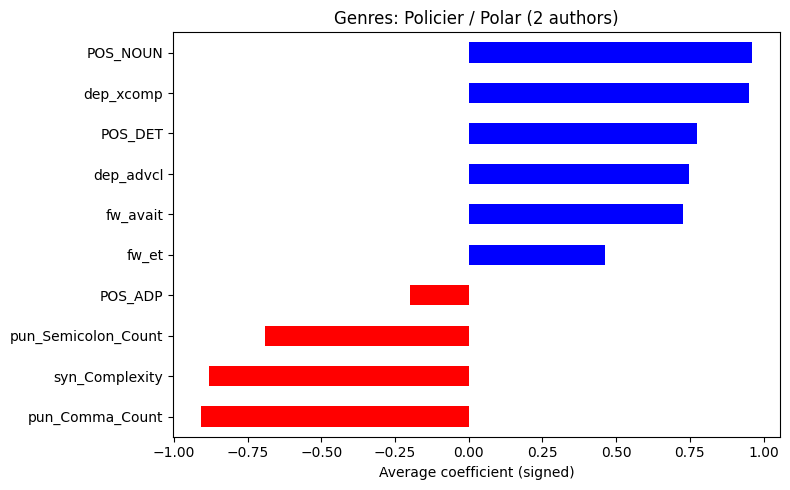

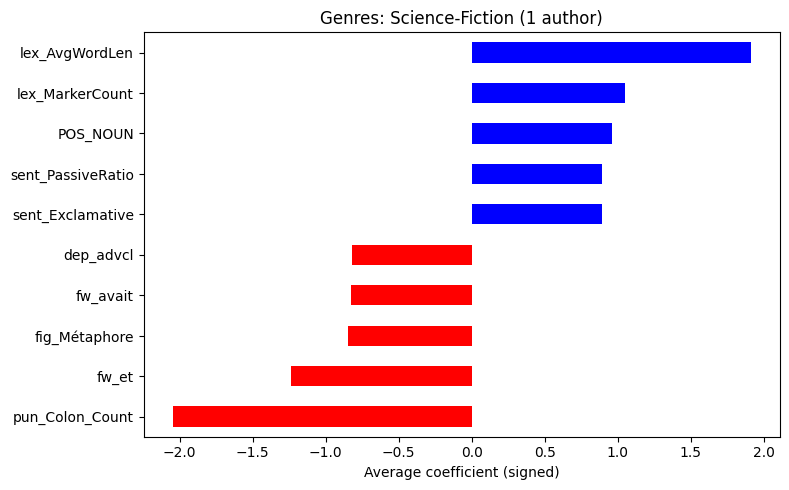

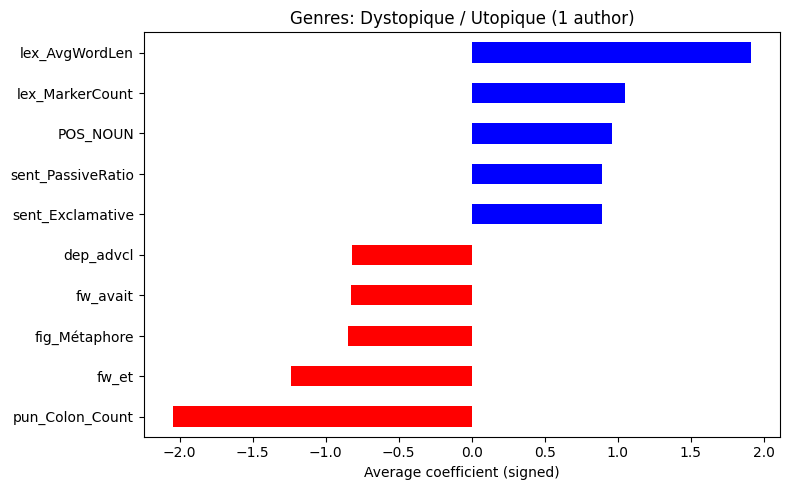

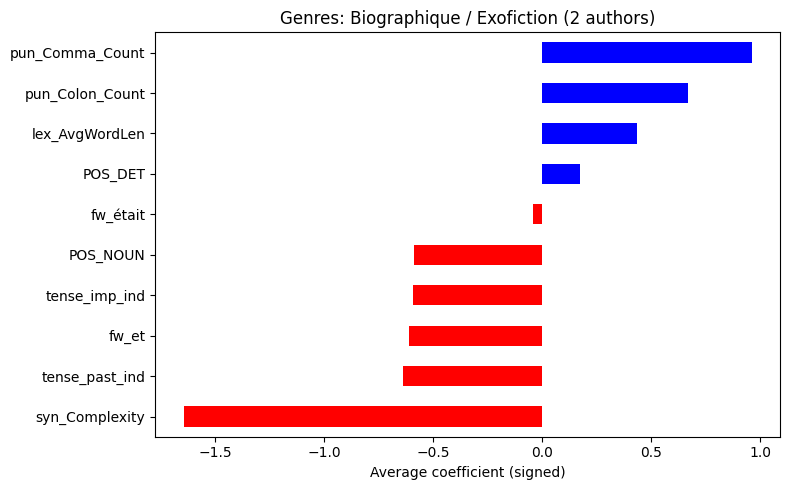

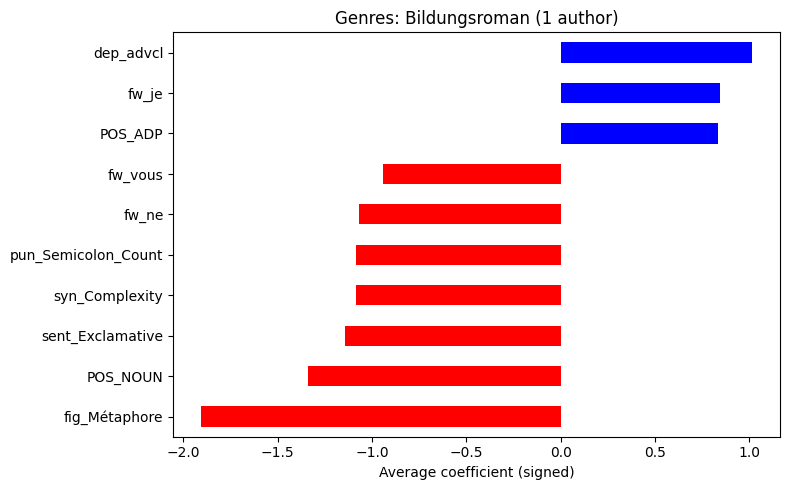

In [248]:
# For movements
print("=== MOVEMENTS ===")
for mouvement in authors_df['Mouvement'].dropna().unique():
    plot_style_by_category("Mouvement", mouvement)

# For genres (exploded list)
genre_series = authors_df['Genres'].apply(lambda x: [g.strip() for g in x.split(',')])
all_genres = pd.Series([genre for sublist in genre_series for genre in sublist]).unique()

print("\n=== GENRES ===")
for genre in all_genres:
    plot_style_by_category("Genres", genre)



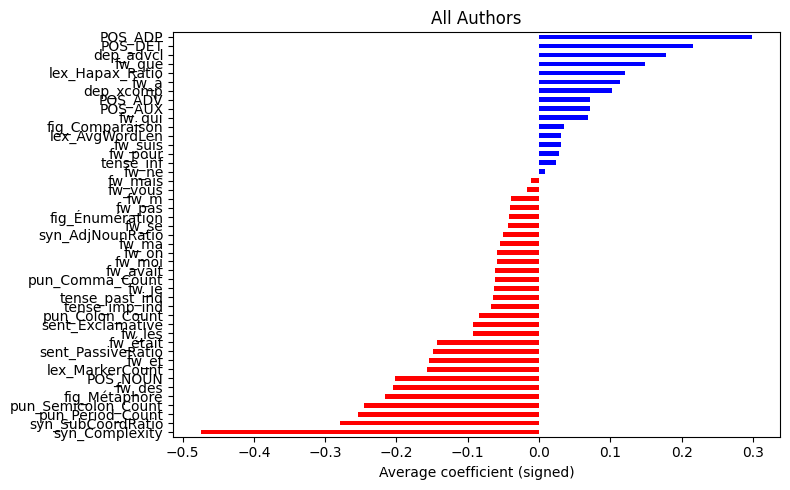

In [311]:
plot_group_signature(authors_df.index, title="All Authors", top_n=45)

### Evolution of style by author

In [249]:
def plot_evolution_with_titles(author, prefix="fw_", min_year=1800, max_year=1950):
    """
    Plot stylistic evolution over time for one author, labeling books by year (clean display).
    """

    # Merge stylometry with excerpt IDs and metadata
    stylo_with_id = stylo_df.copy()
    stylo_with_id['Excerpt_ID'] = texts['Excerpt_ID'].values
    stylo_with_id['Author'] = texts['Author'].values
    stylo_with_id['Title'] = texts['Title'].values

    # Filter for author
    author_df = stylo_with_id[stylo_with_id['Author'] == author].copy()
    if author_df.empty:
        return

    # Get book ID from Excerpt_ID
    author_df['EBook-No'] = author_df['Excerpt_ID'].apply(lambda x: int(str(x).split('_')[0]))

    # Merge with book dates and clean
    author_df = author_df.merge(books_df[['EBook-No', 'Date', 'Title']], on='EBook-No', how='left', suffixes=('', '_Book'))
    author_df = author_df.dropna(subset=['Date'])
    author_df['Year'] = author_df['Date'].astype(int)

    # Filter features
    feature_cols = [col for col in stylo_df.columns if col.startswith(prefix)]
    if not feature_cols:
        return

    # Group by year and average
    grouped = author_df.groupby(['Year'])[feature_cols].mean()
    titles_by_year = author_df.groupby('Year')['Title_Book'].first()

    grouped = grouped[(grouped.index >= min_year) & (grouped.index <= max_year)]

    if grouped.empty:
        return

    # Plot
    plt.figure(figsize=(12, 6))
    for col in grouped.columns:
        plt.plot(grouped.index, grouped[col], label=col)

    # Annotate book titles (cleaned)
    for year, title in titles_by_year.items():
        if min_year <= year <= max_year:
            if isinstance(title, str):
                short_title = title.split(":")[0].split(".")[0].strip()[:25]  # limit & clean
                plt.text(year, plt.ylim()[0] - (plt.ylim()[1] - plt.ylim()[0]) * 0.05,
                        short_title, rotation=45, ha='right', va='top', fontsize=8, alpha=0.8)

    plt.title(f"{author} — stylistic evolution ({prefix})")
    plt.xlabel("Year")
    plt.ylabel("Average feature value")
    plt.legend(loc="upper left", bbox_to_anchor=(1.01, 1.0))
    plt.xticks(rotation=0)
    plt.tight_layout()


    plt.show()



=== Honoré de Balzac ===
→ Plotting prefix: fw_


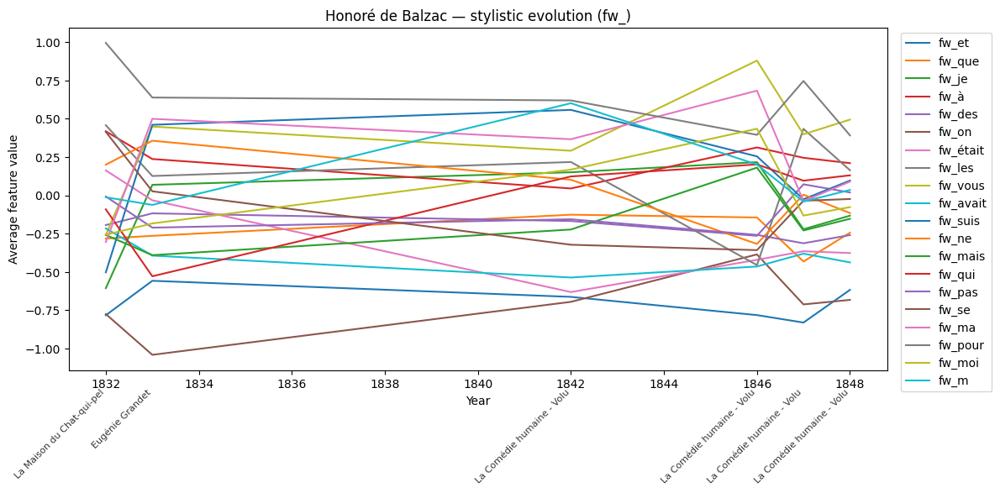

→ Plotting prefix: pun_


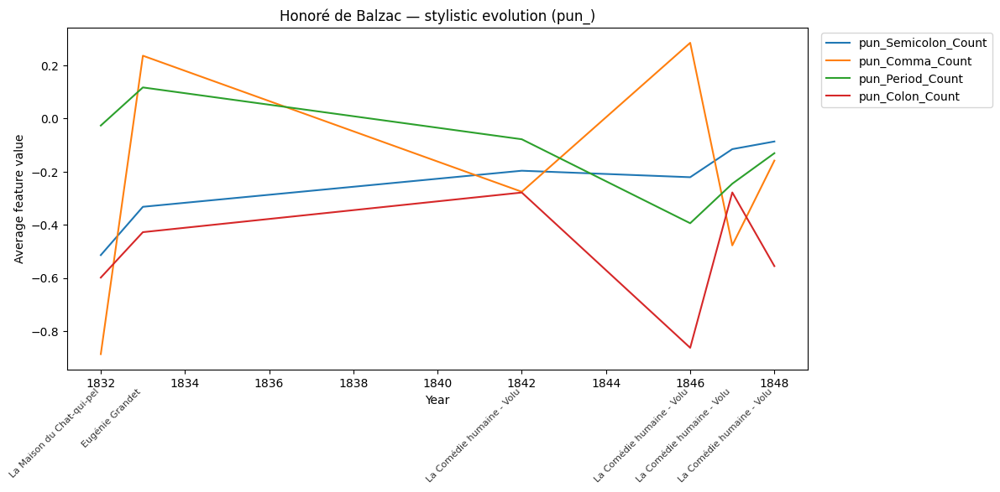

→ Plotting prefix: lex_


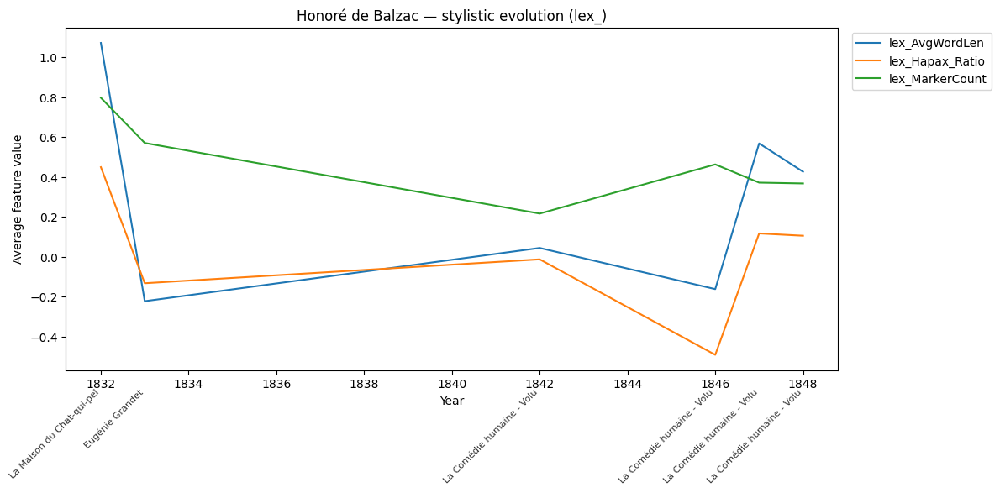

→ Plotting prefix: POS_


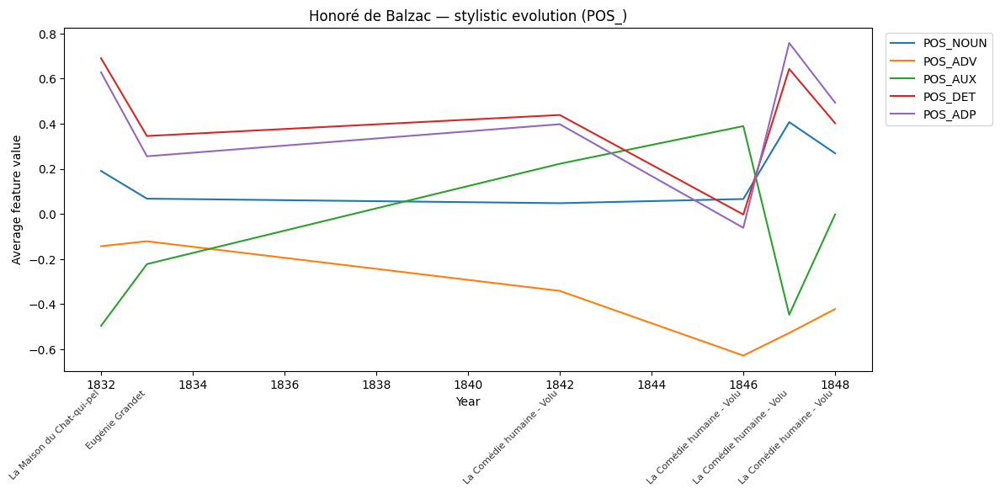

→ Plotting prefix: syn_


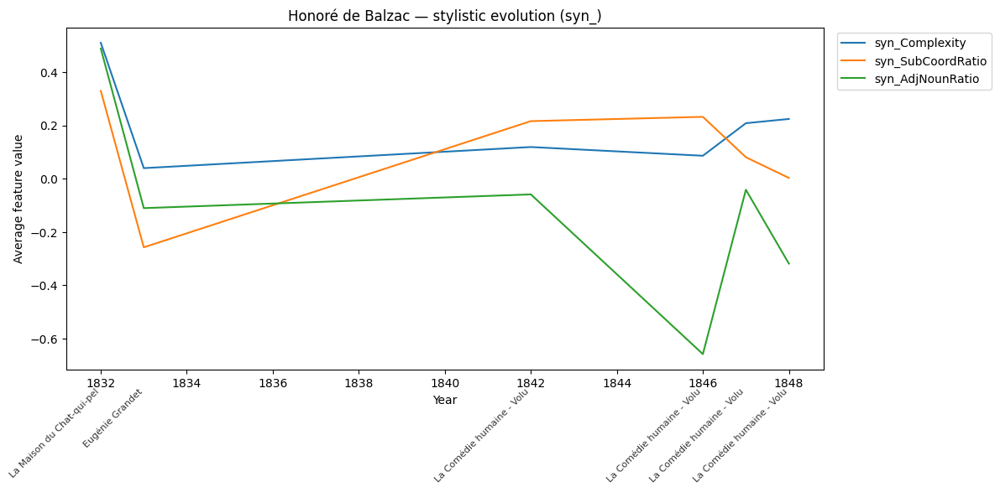

→ Plotting prefix: tense_


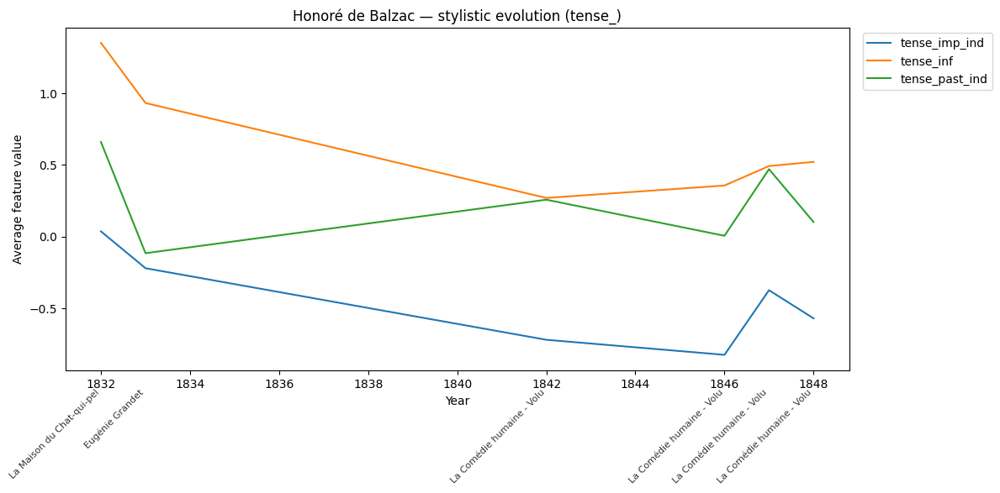

→ Plotting prefix: sent_


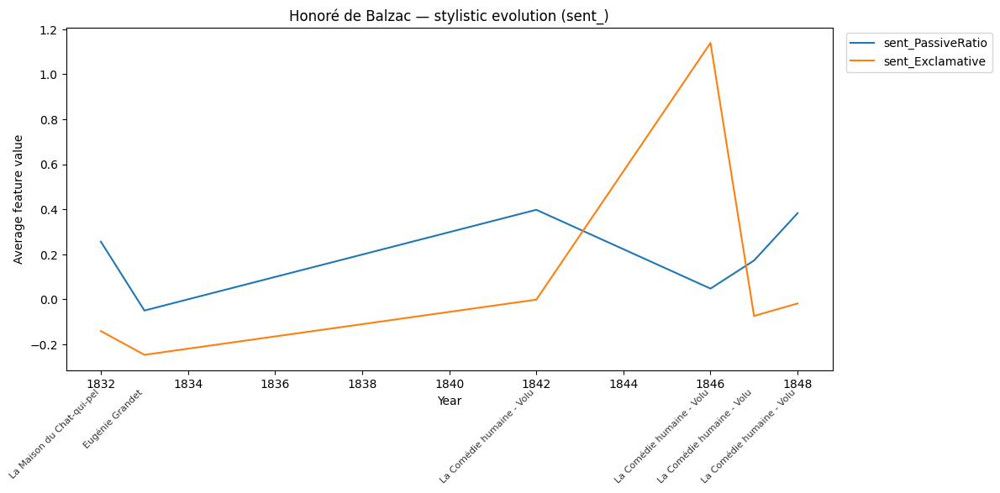

→ Plotting prefix: dep_


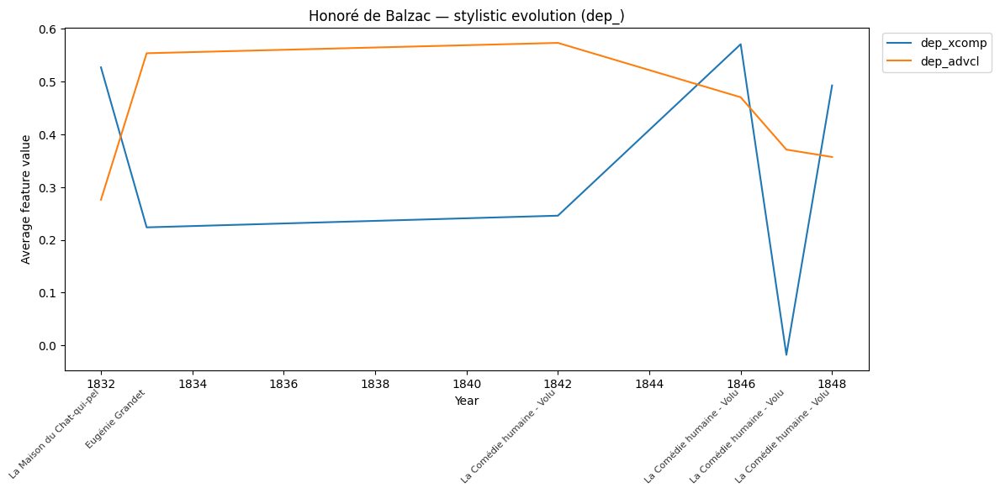

→ Plotting prefix: fig_


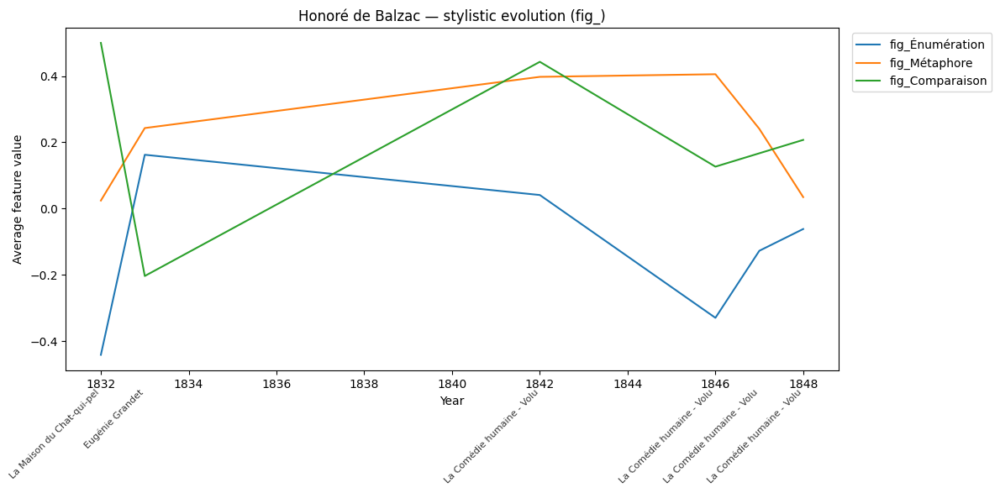


=== Alexandre Dumas ===
→ Plotting prefix: fw_


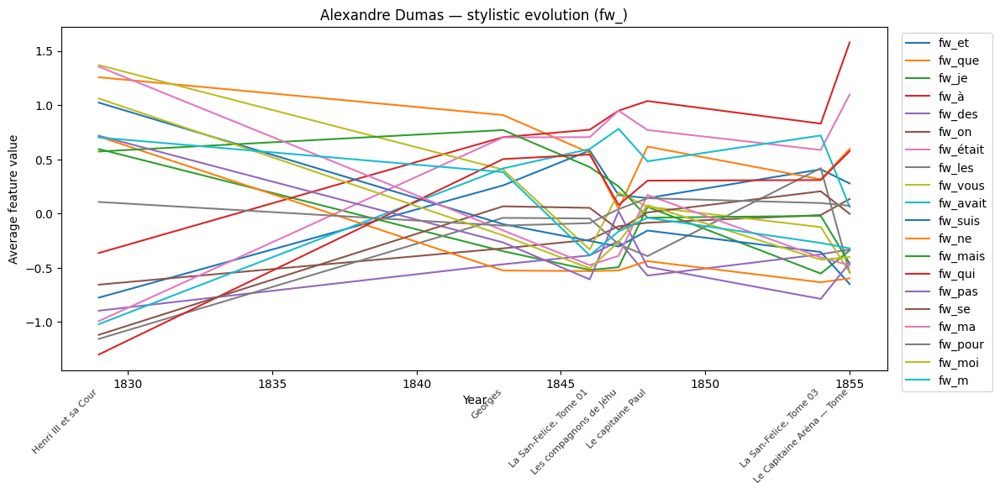

→ Plotting prefix: pun_


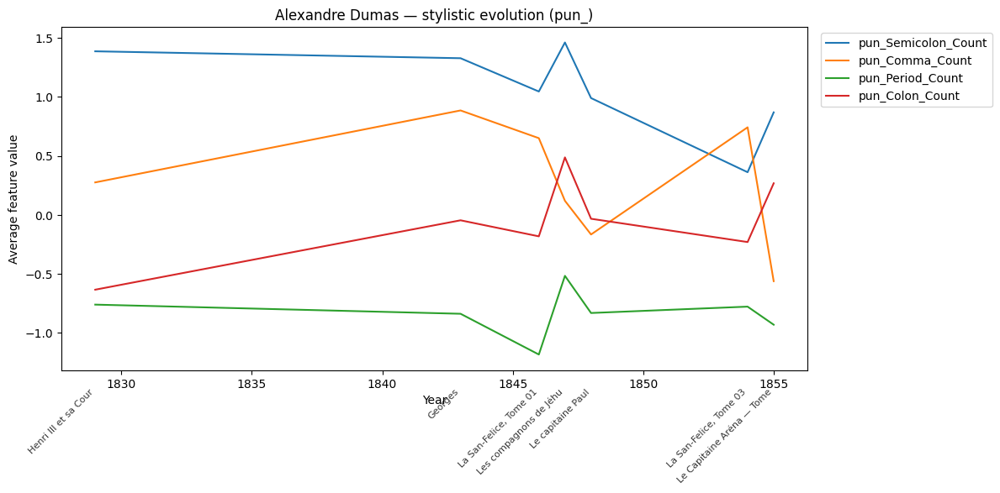

→ Plotting prefix: lex_


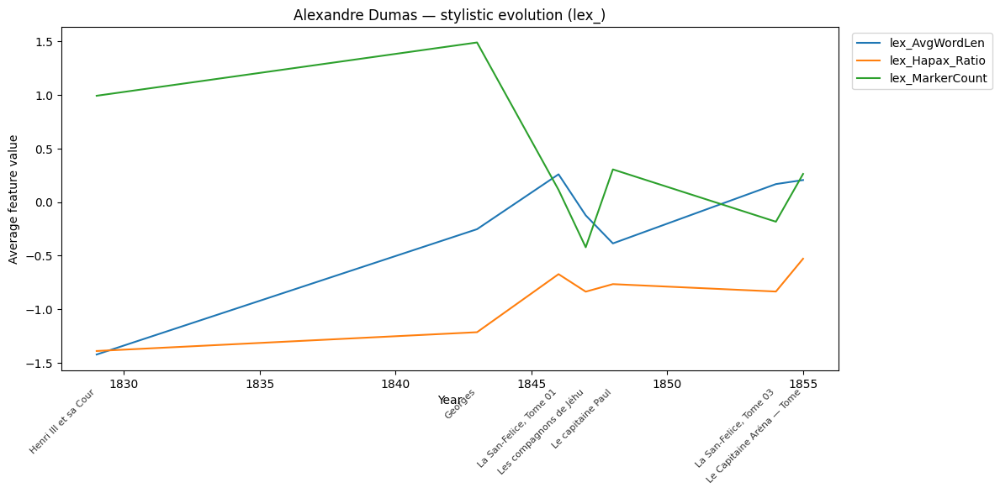

→ Plotting prefix: POS_


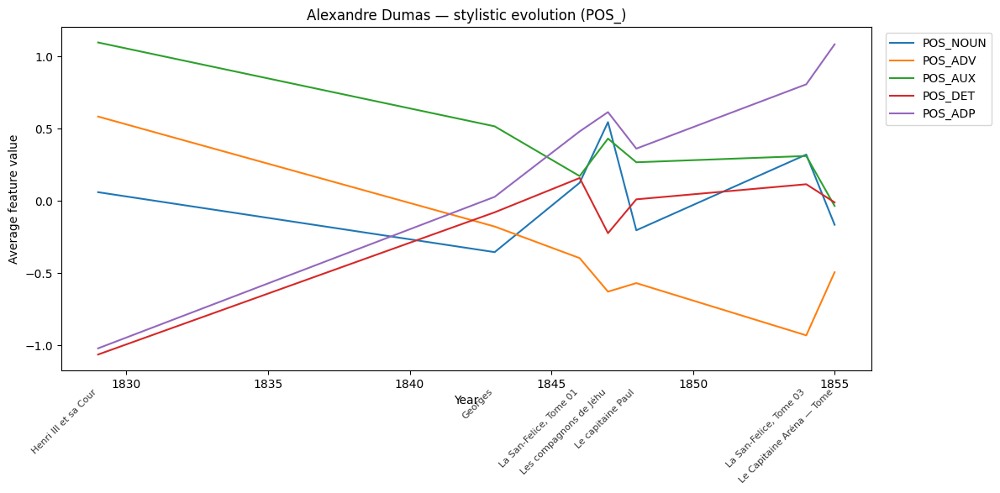

→ Plotting prefix: syn_


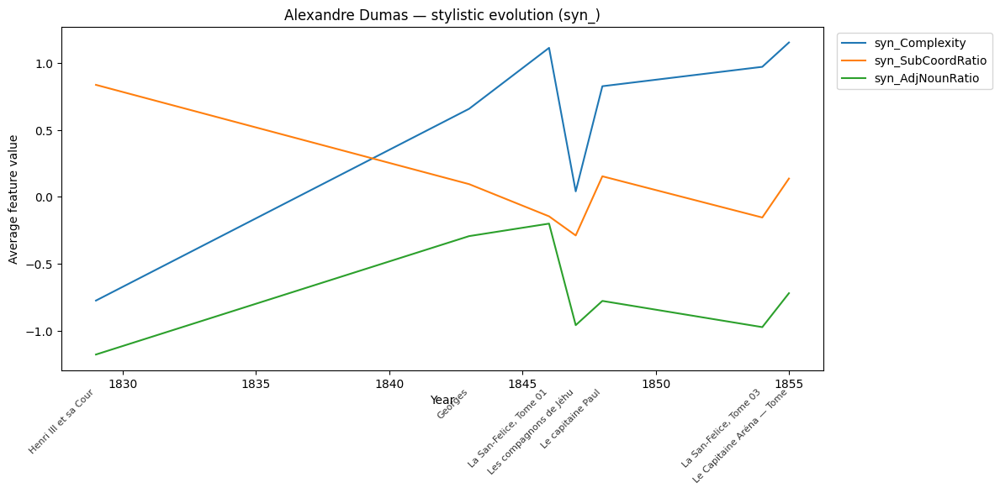

→ Plotting prefix: tense_


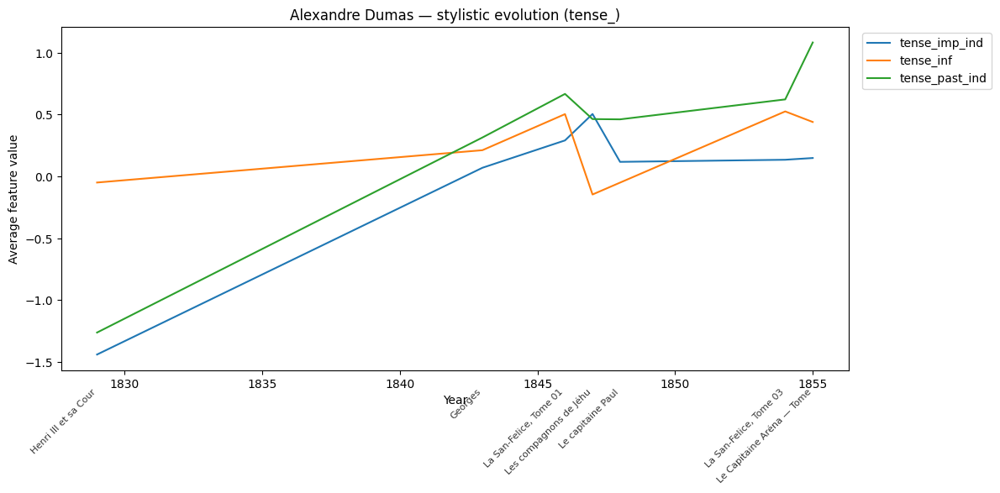

→ Plotting prefix: sent_


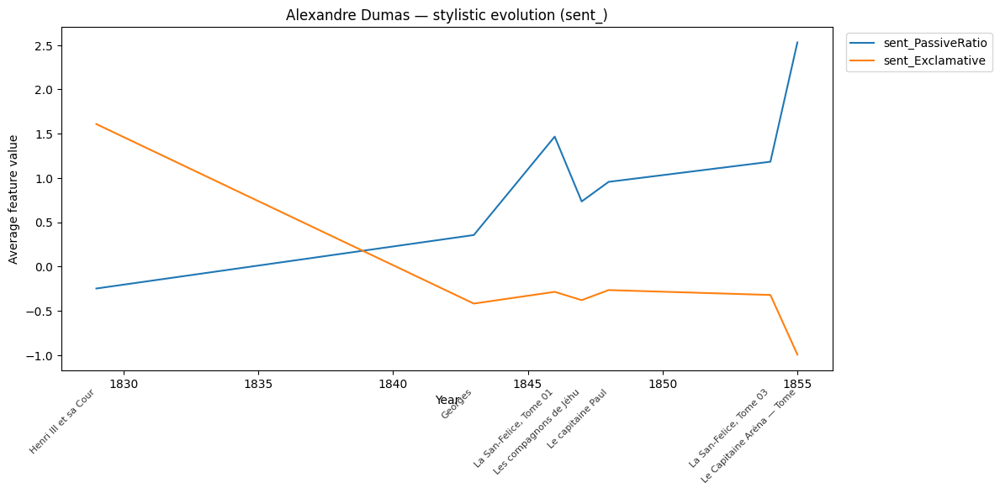

→ Plotting prefix: dep_


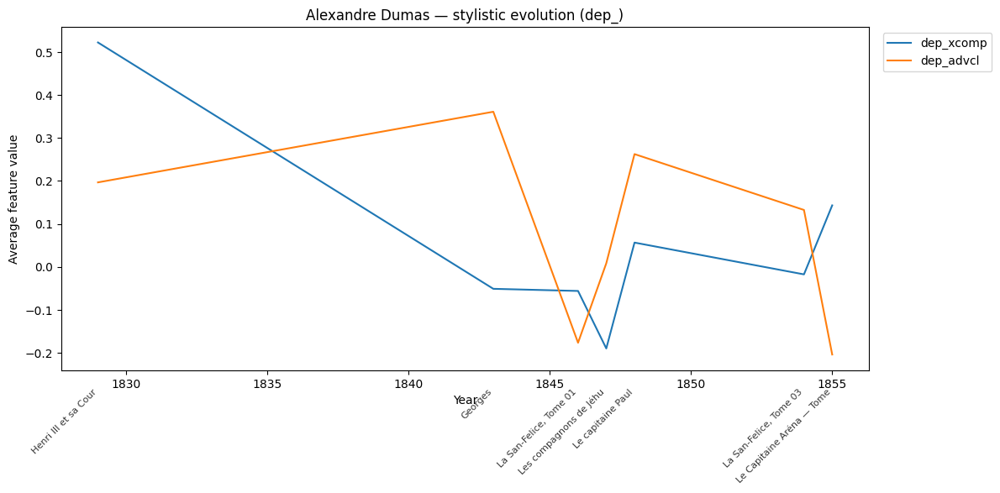

→ Plotting prefix: fig_


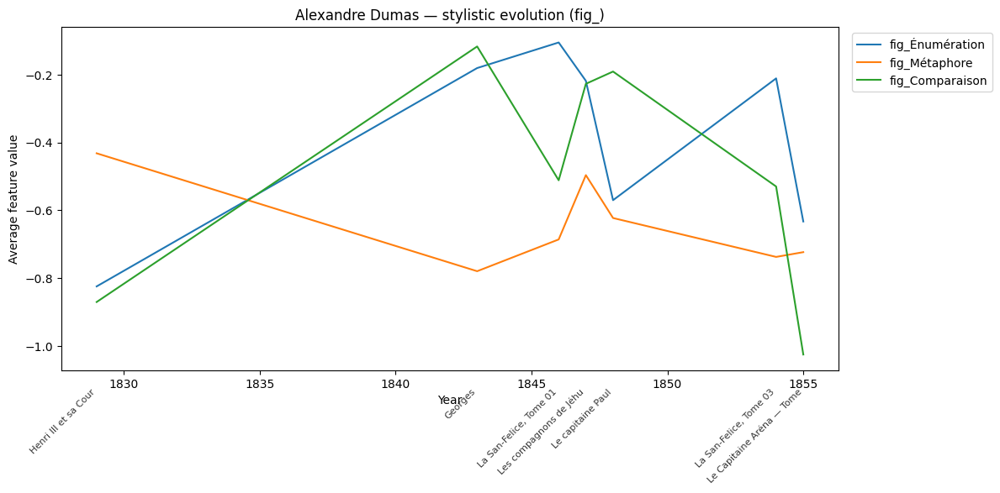


=== George Sand ===
→ Plotting prefix: fw_


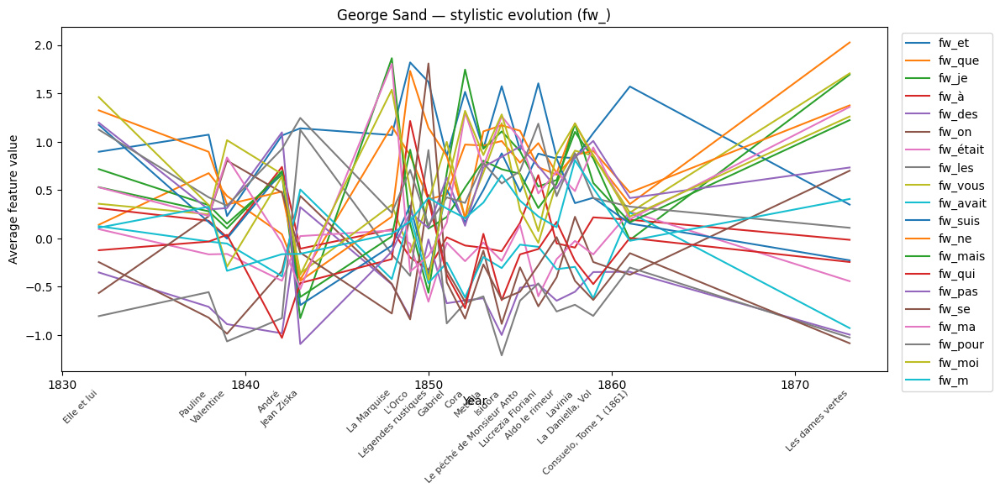

→ Plotting prefix: pun_


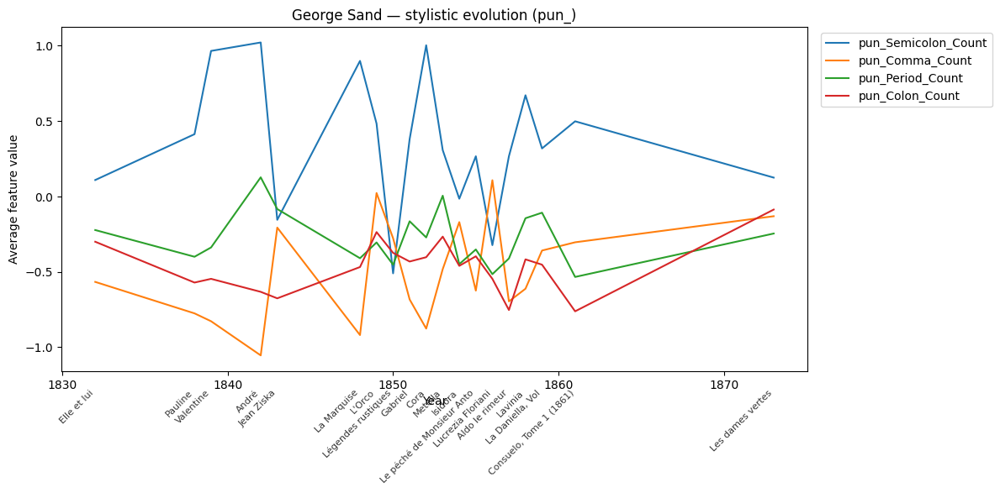

→ Plotting prefix: lex_


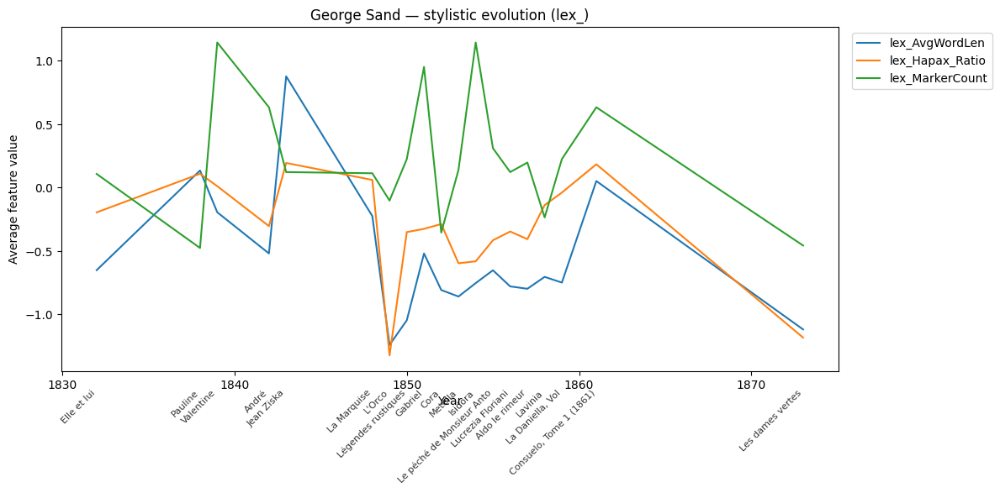

→ Plotting prefix: POS_


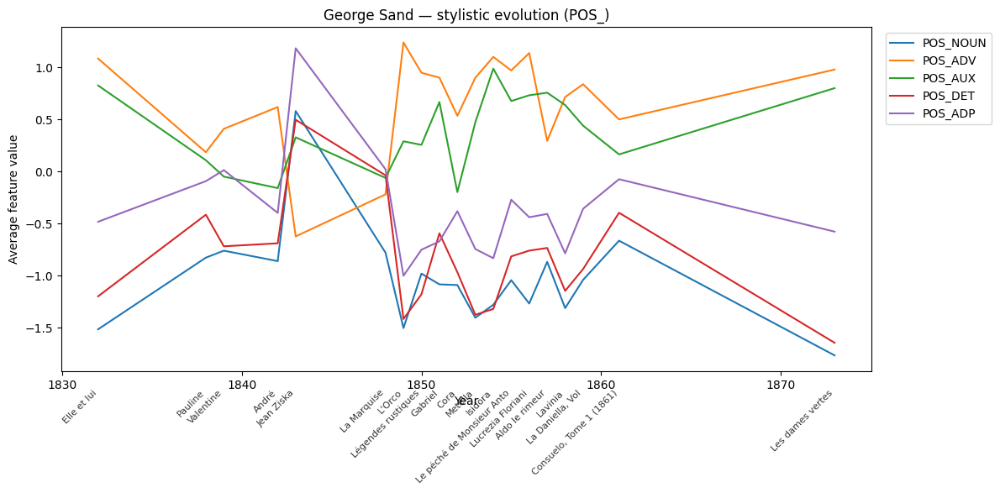

→ Plotting prefix: syn_


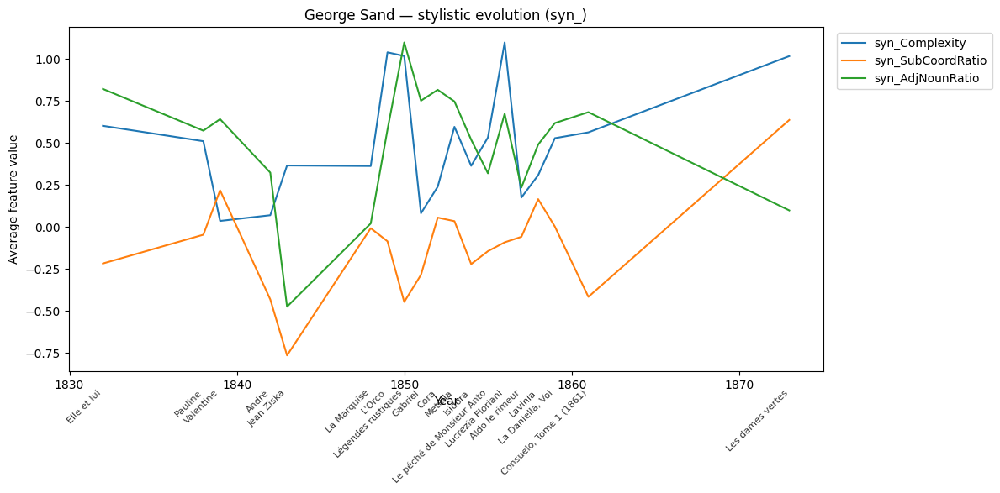

→ Plotting prefix: tense_


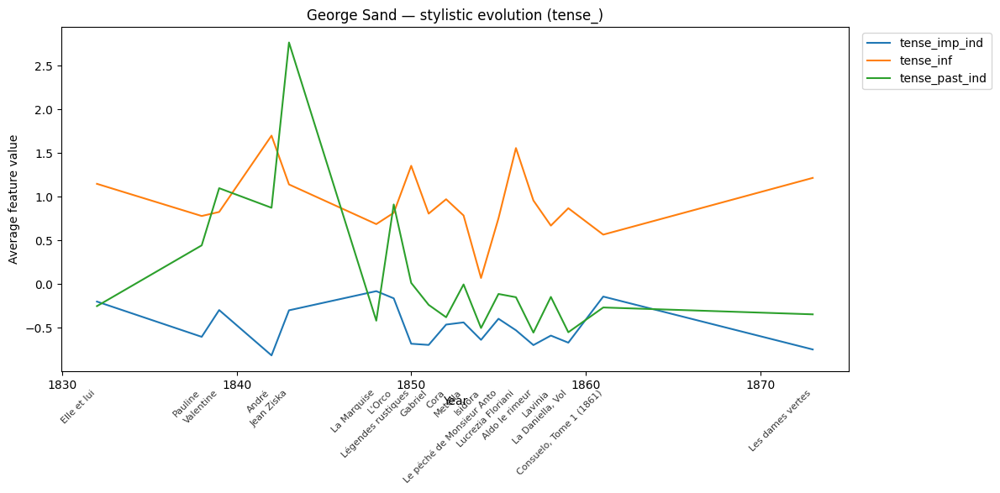

→ Plotting prefix: sent_


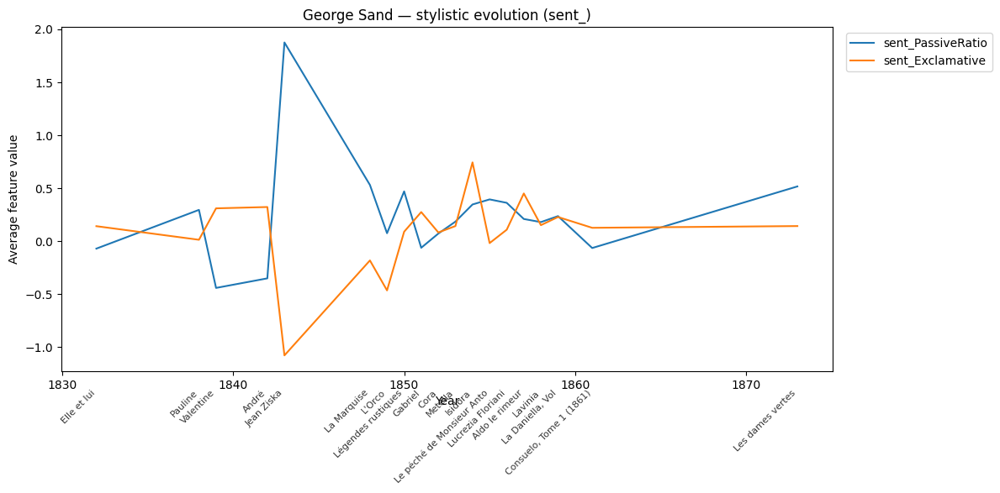

→ Plotting prefix: dep_


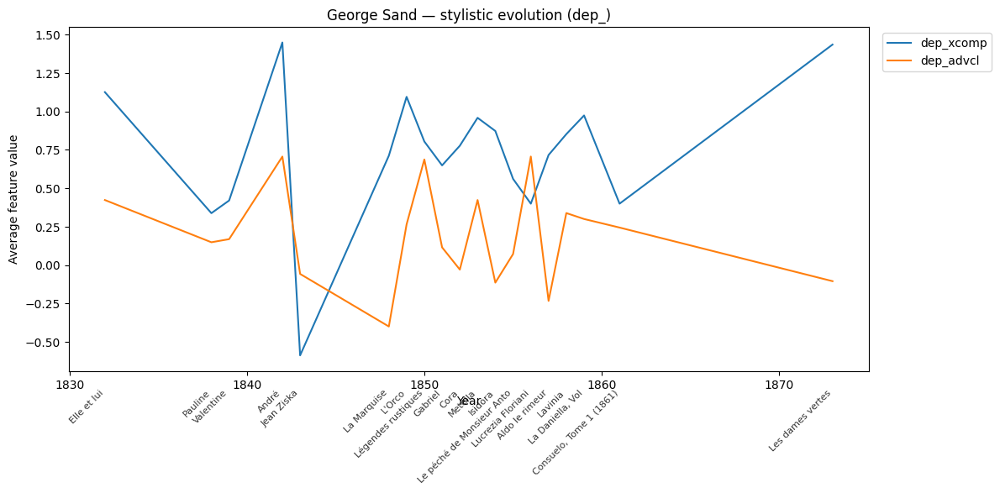

→ Plotting prefix: fig_


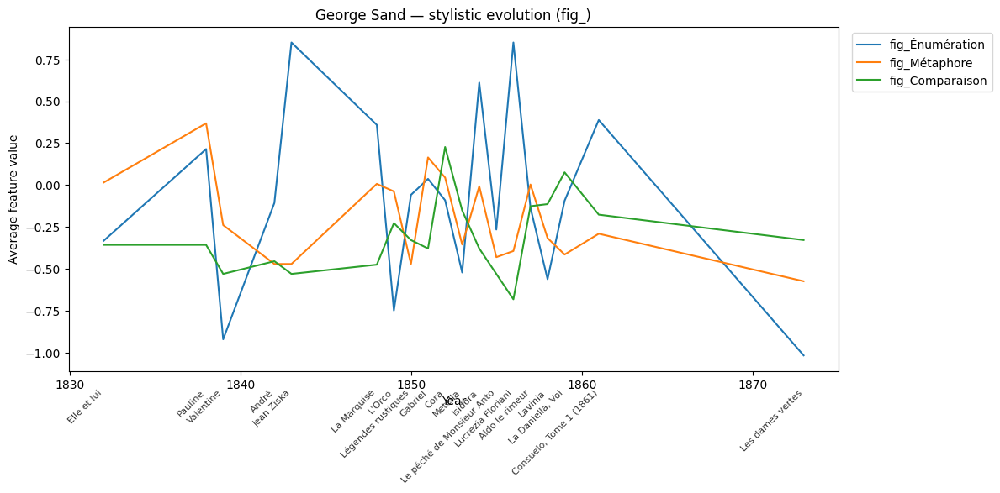


=== Paul Féval ===
→ Plotting prefix: fw_


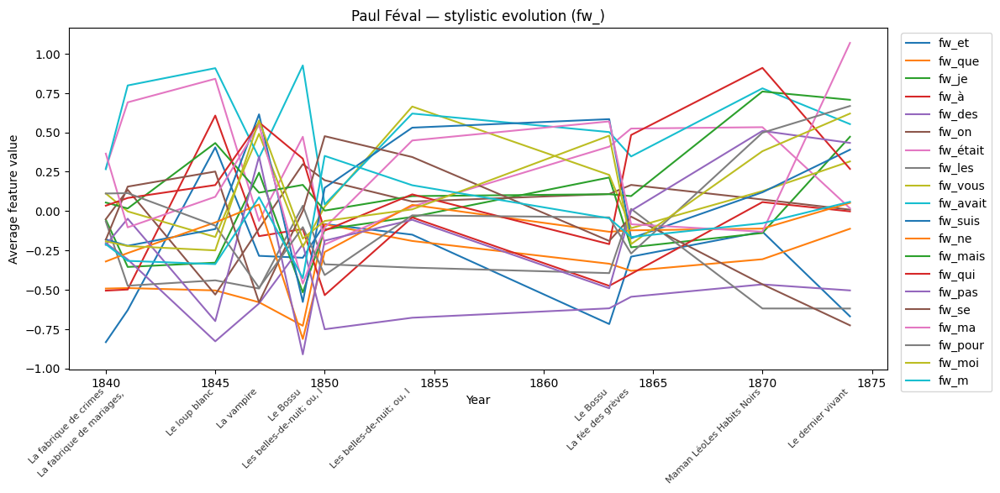

→ Plotting prefix: pun_


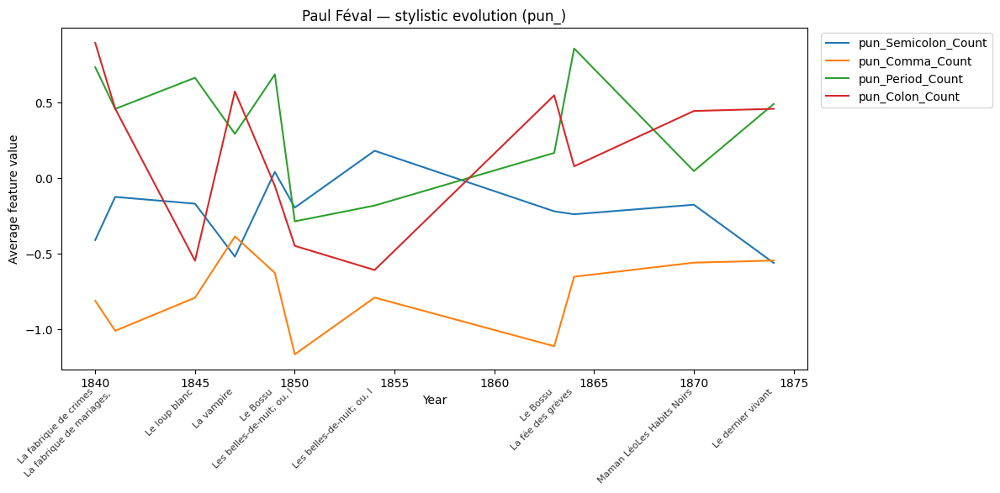

→ Plotting prefix: lex_


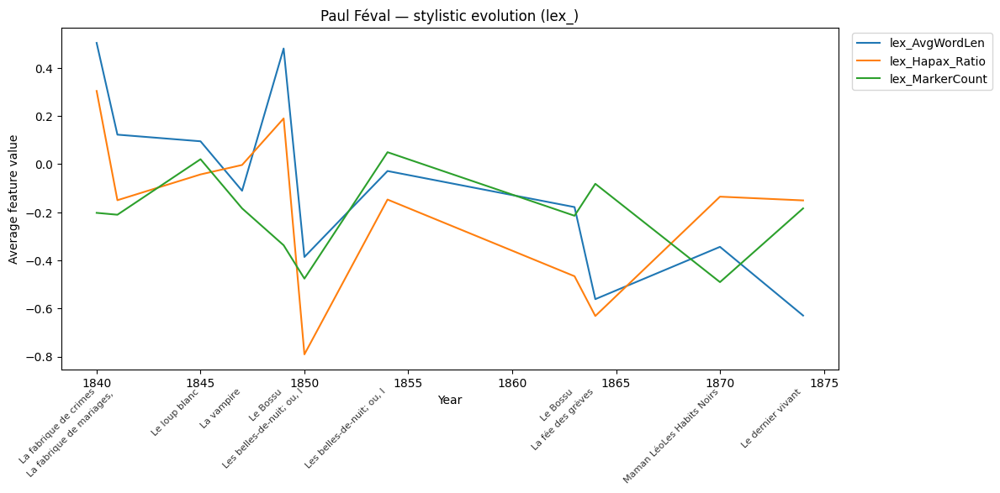

→ Plotting prefix: POS_


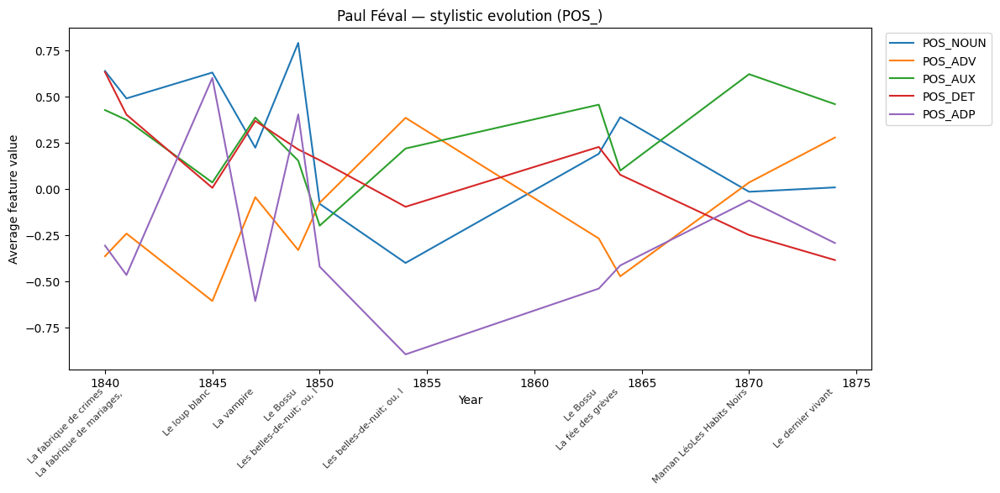

→ Plotting prefix: syn_


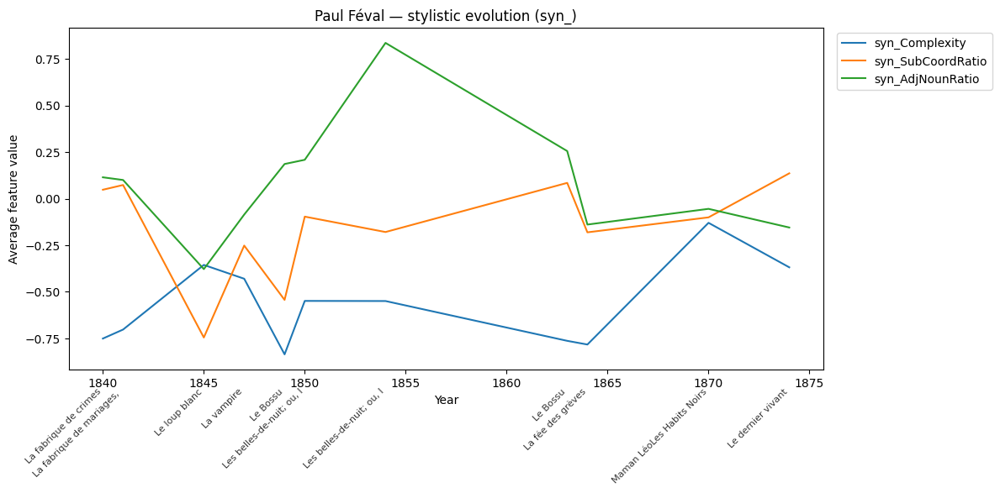

→ Plotting prefix: tense_


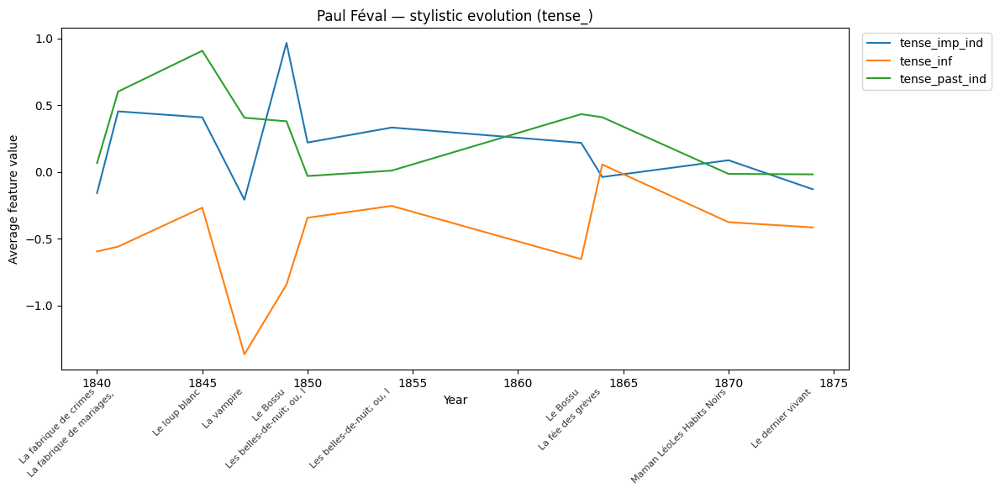

→ Plotting prefix: sent_


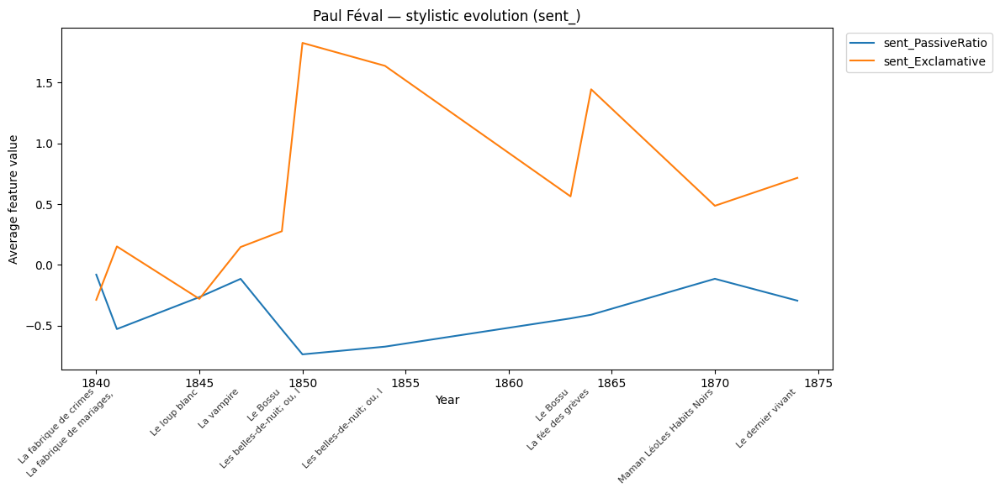

→ Plotting prefix: dep_


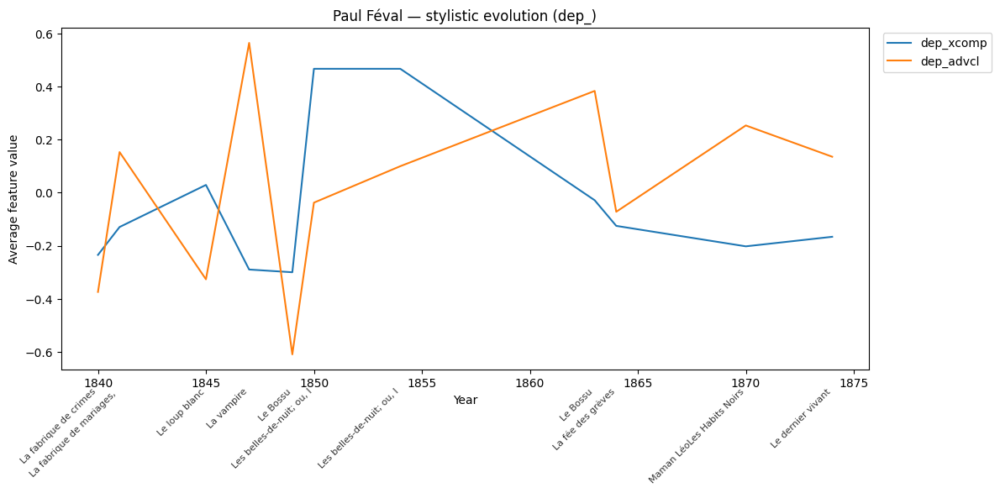

→ Plotting prefix: fig_


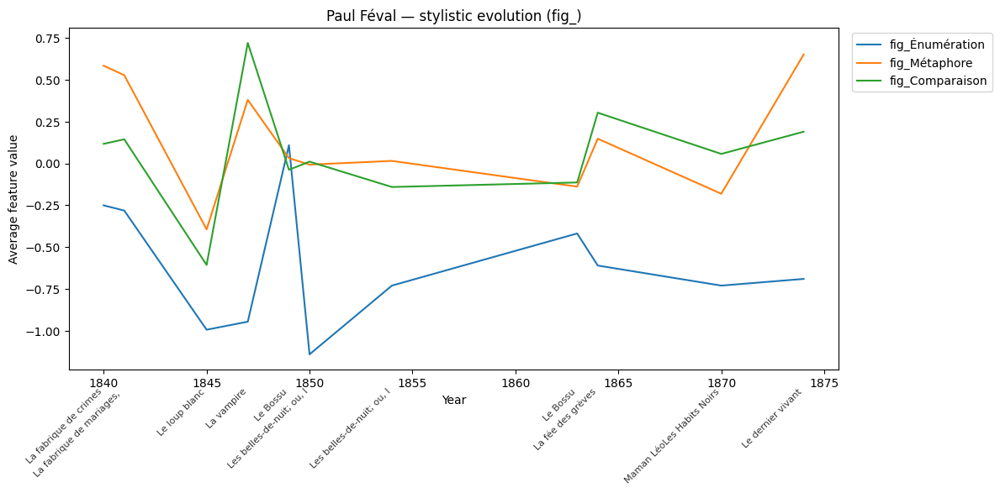


=== Jules Verne ===
→ Plotting prefix: fw_


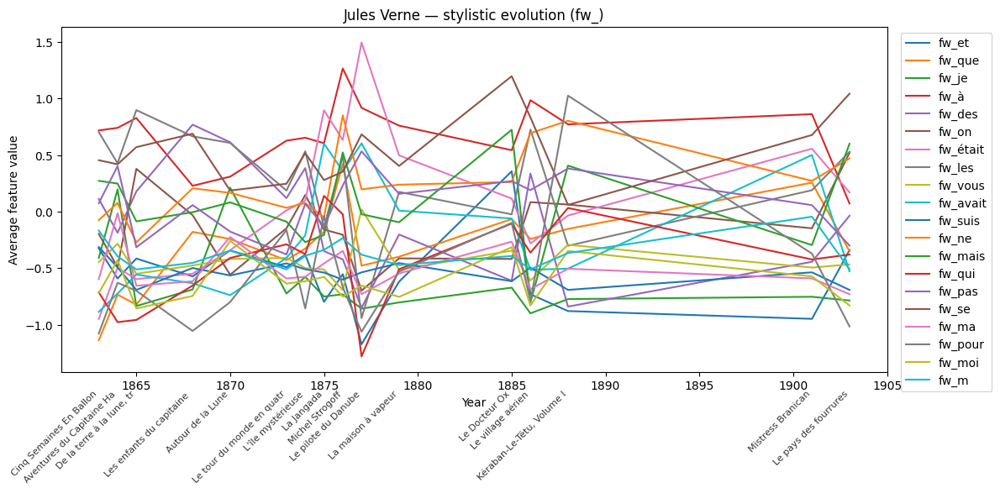

→ Plotting prefix: pun_


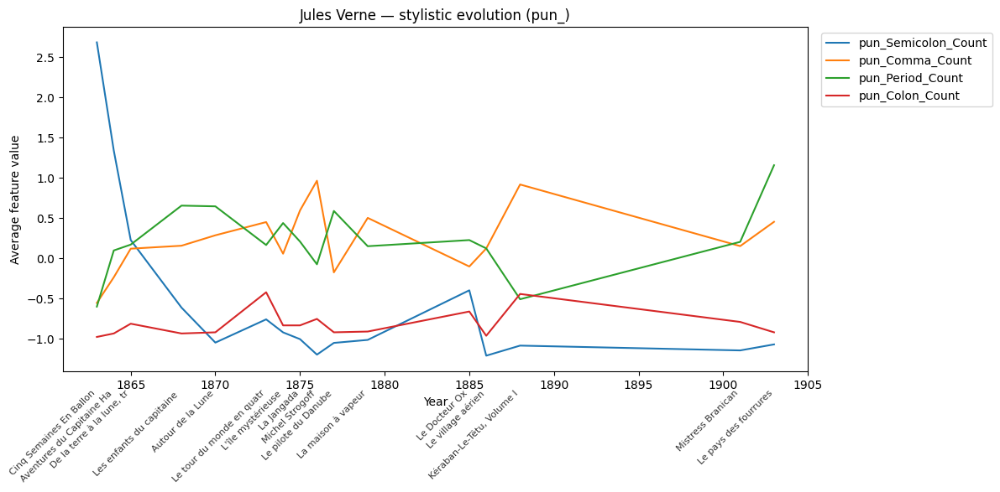

→ Plotting prefix: lex_


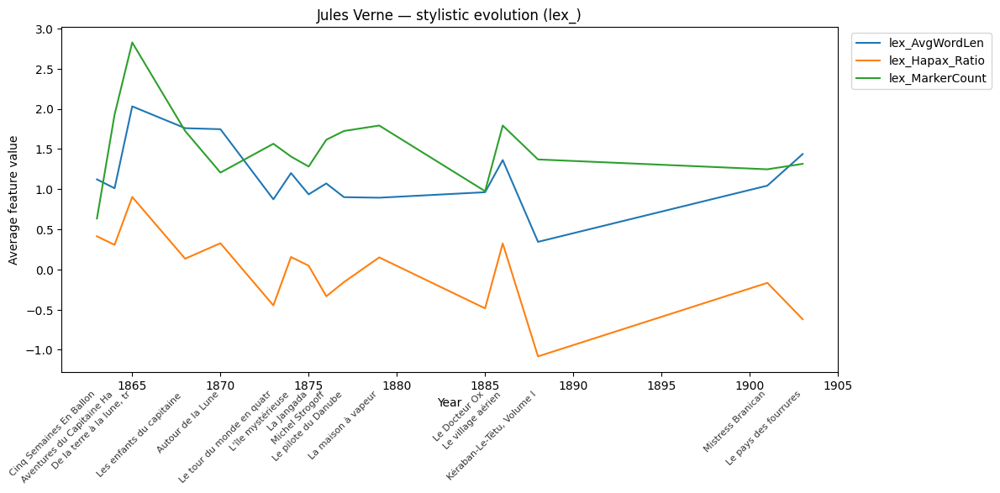

→ Plotting prefix: POS_


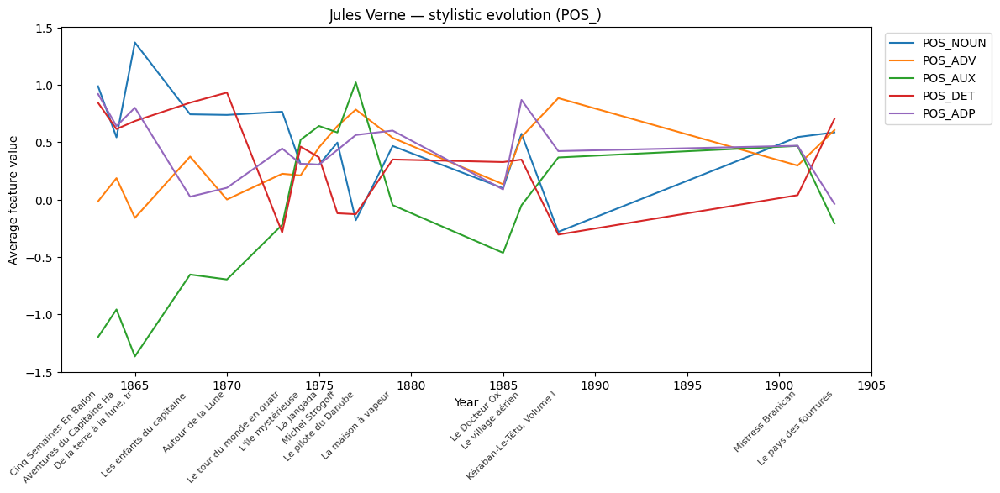

→ Plotting prefix: syn_


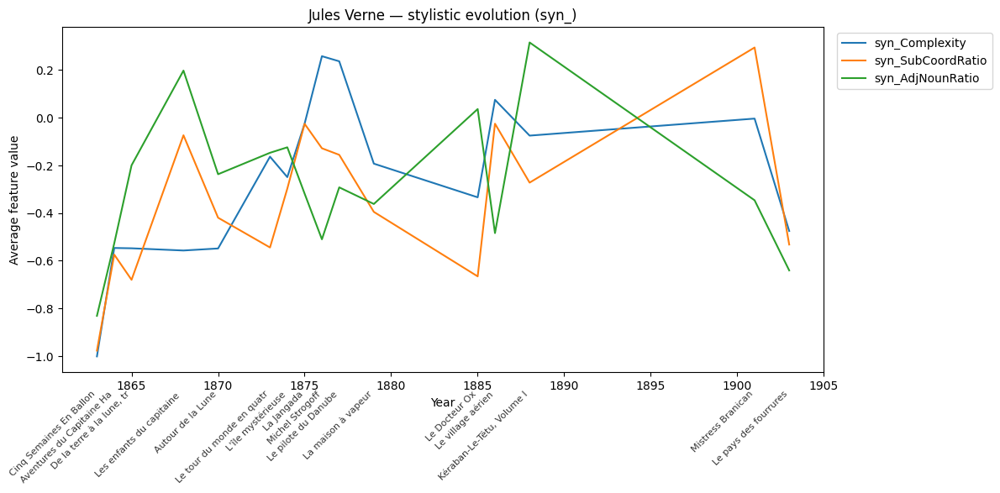

→ Plotting prefix: tense_


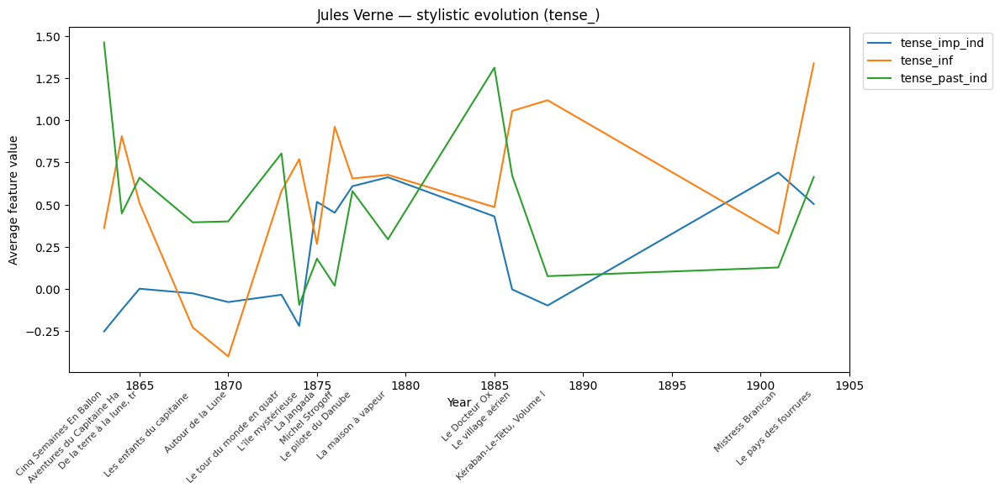

→ Plotting prefix: sent_


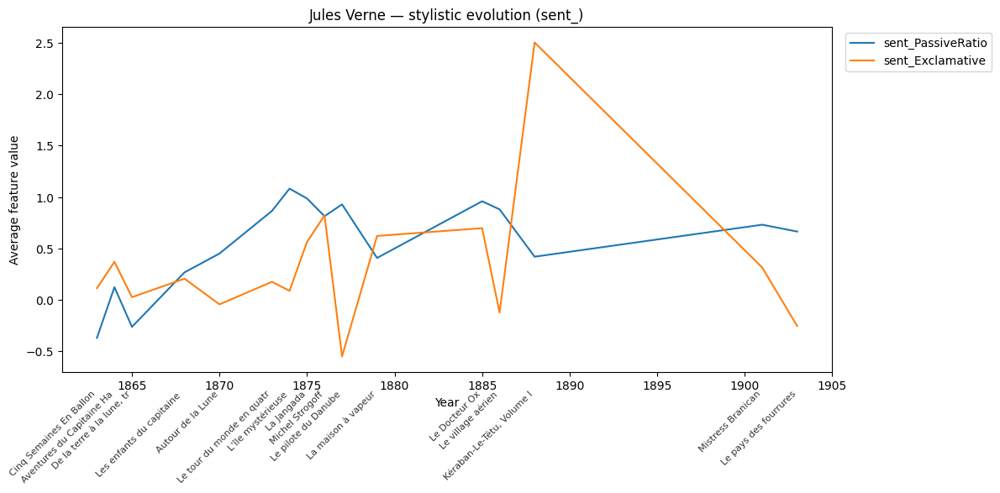

→ Plotting prefix: dep_


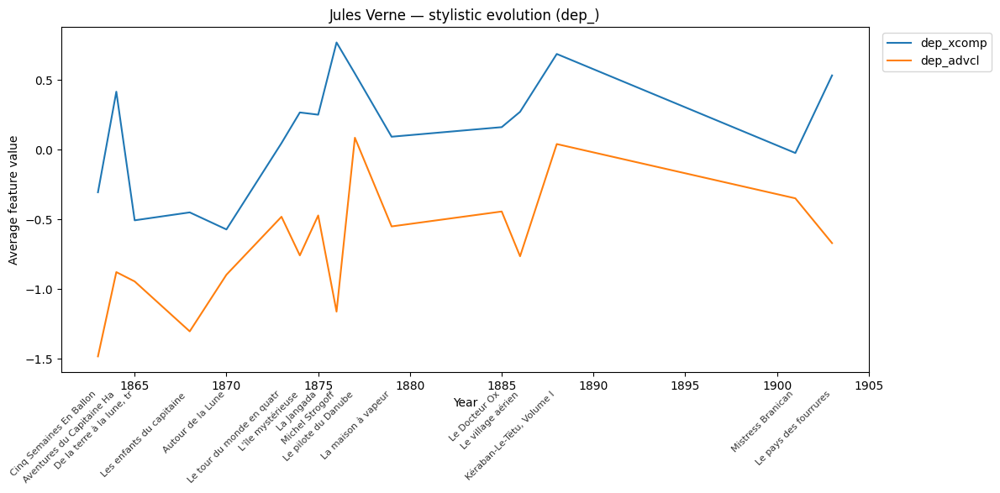

→ Plotting prefix: fig_


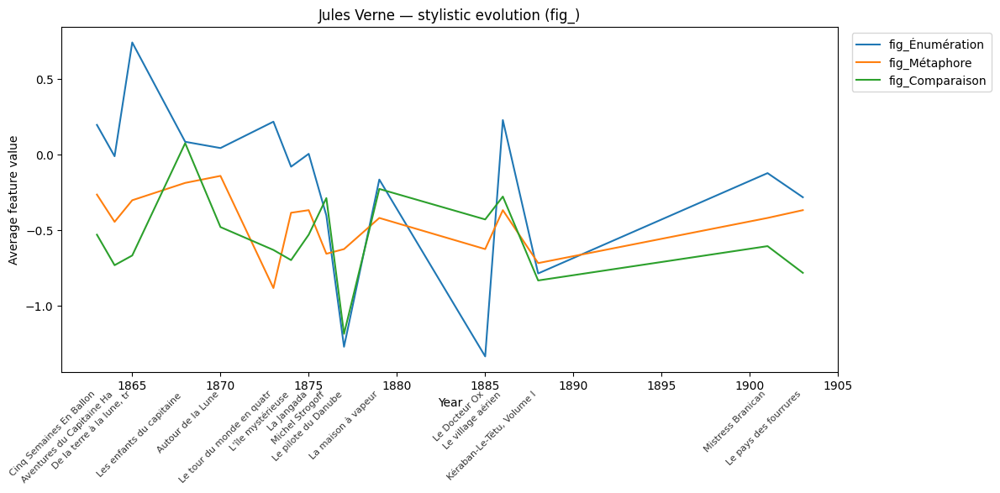


=== Émile Zola ===
→ Plotting prefix: fw_


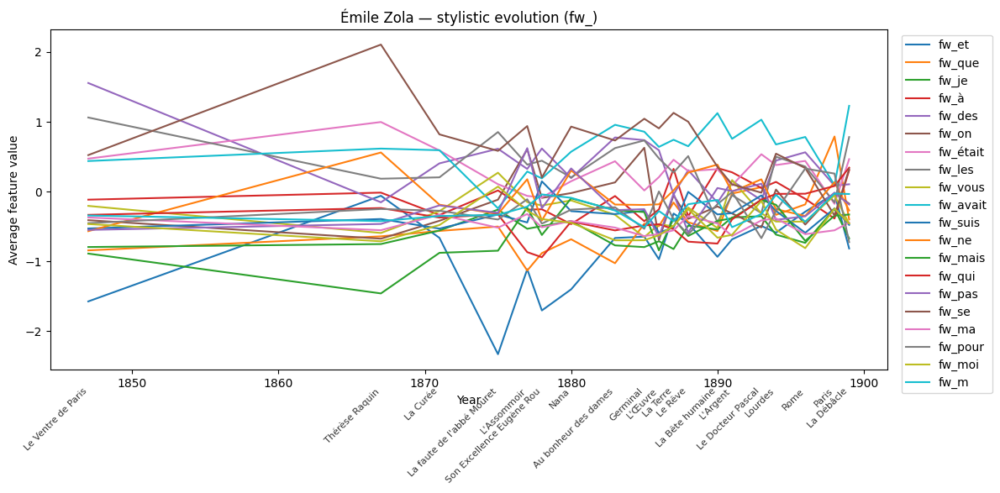

→ Plotting prefix: pun_


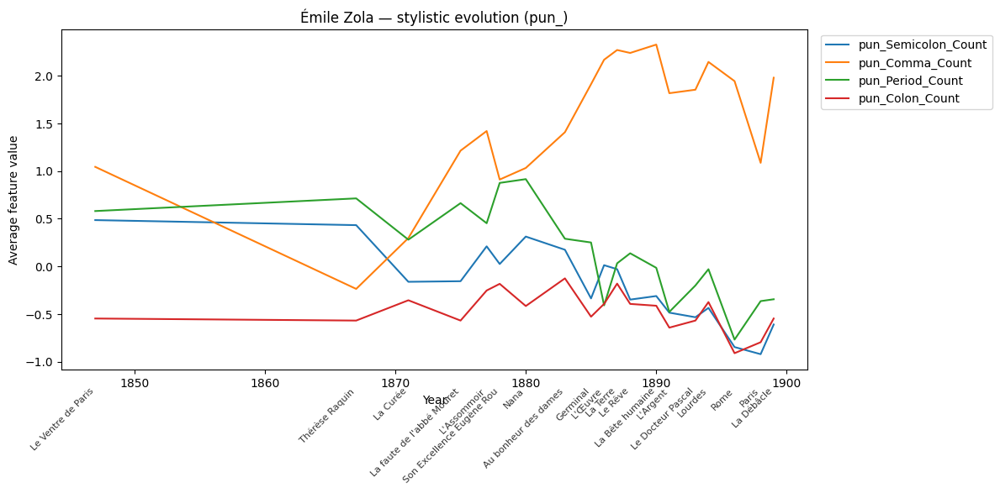

→ Plotting prefix: lex_


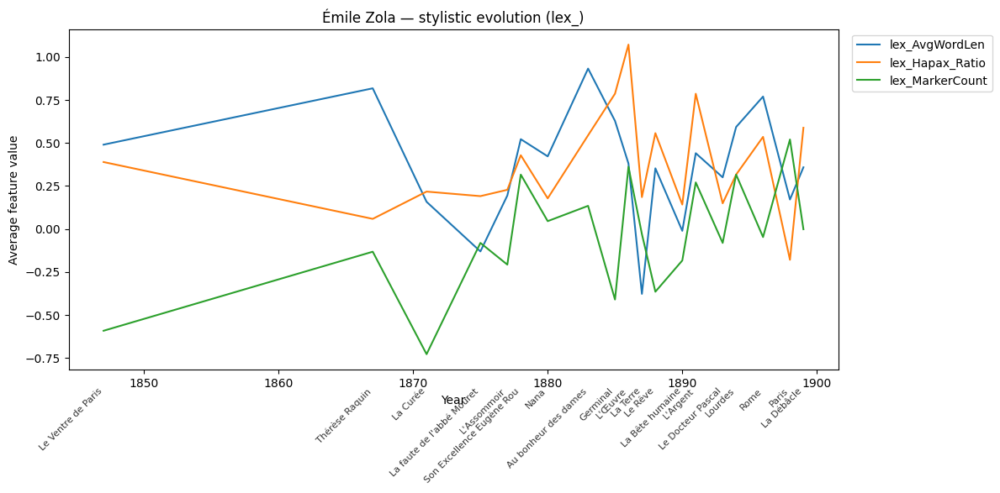

→ Plotting prefix: POS_


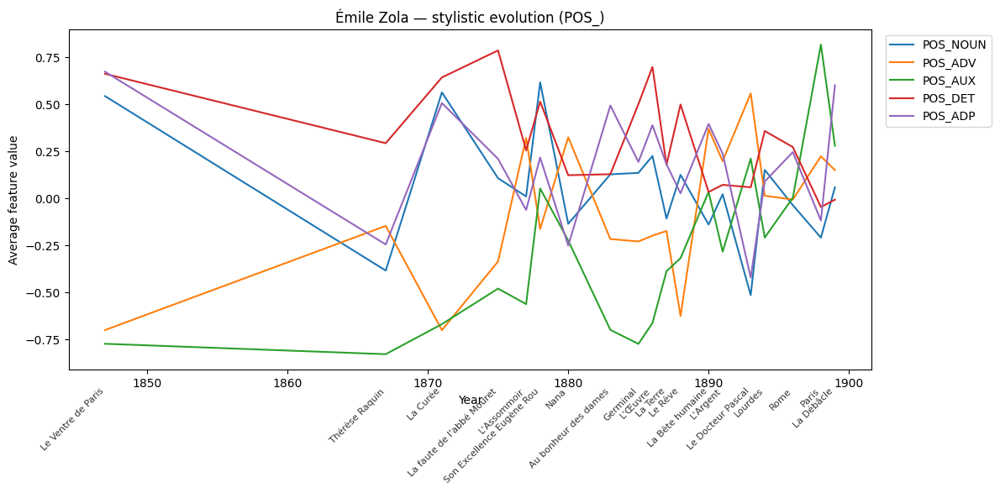

→ Plotting prefix: syn_


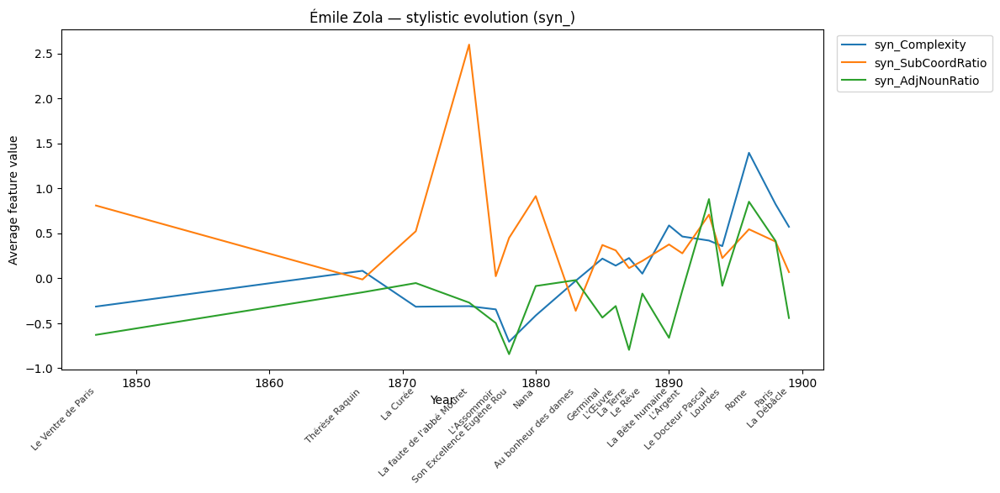

→ Plotting prefix: tense_


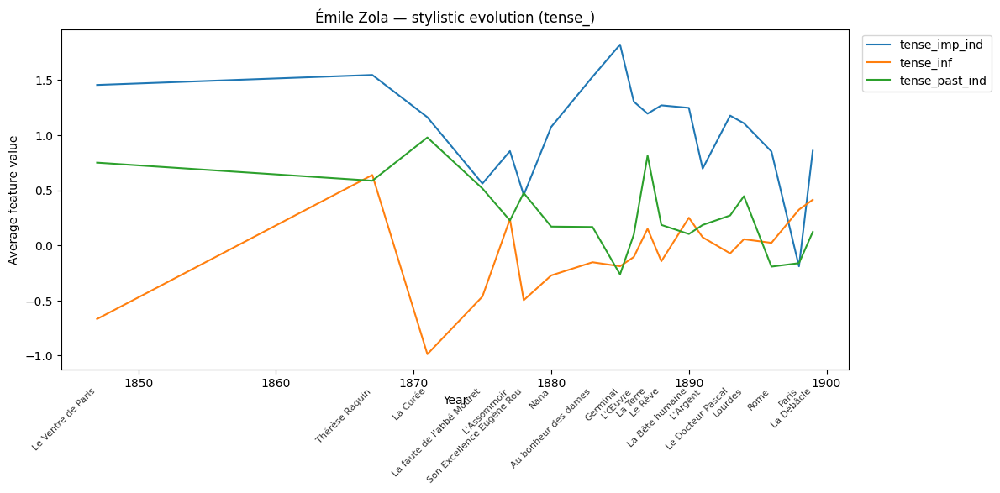

→ Plotting prefix: sent_


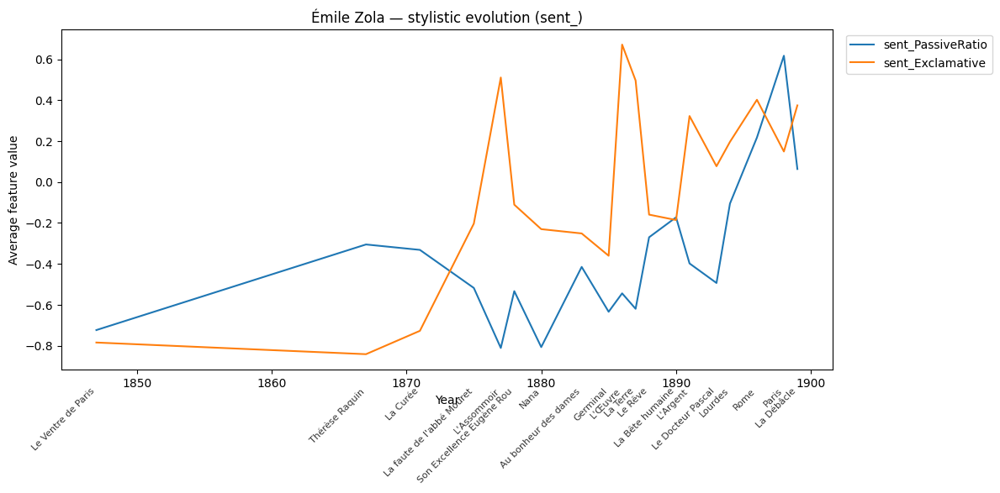

→ Plotting prefix: dep_


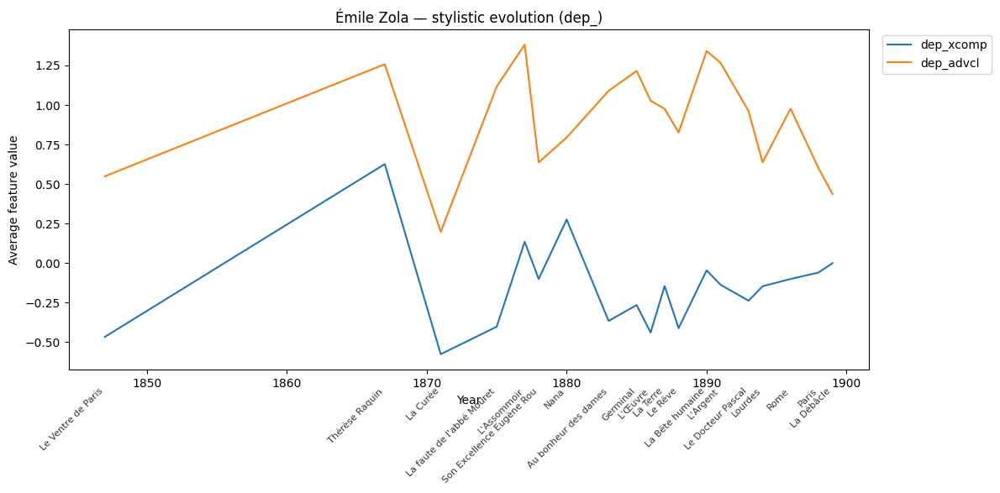

→ Plotting prefix: fig_


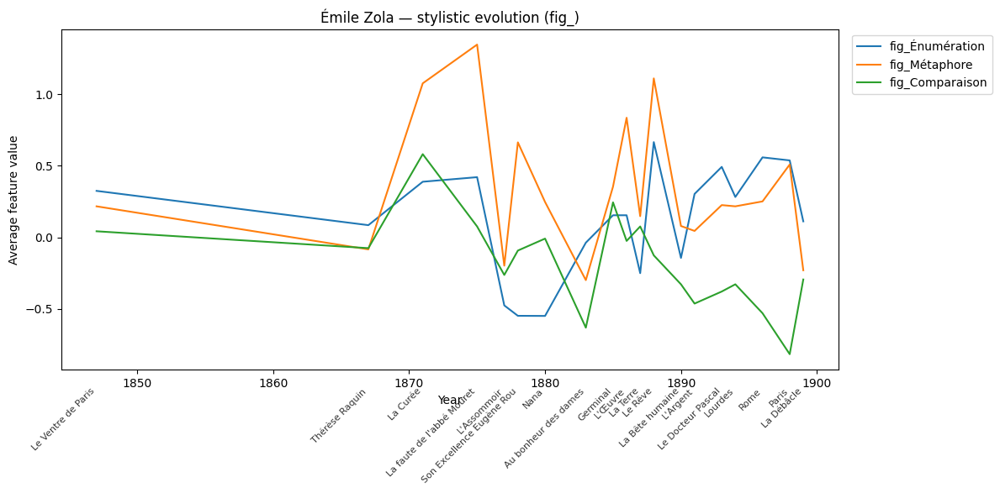


=== Marcel Proust ===
→ Plotting prefix: fw_


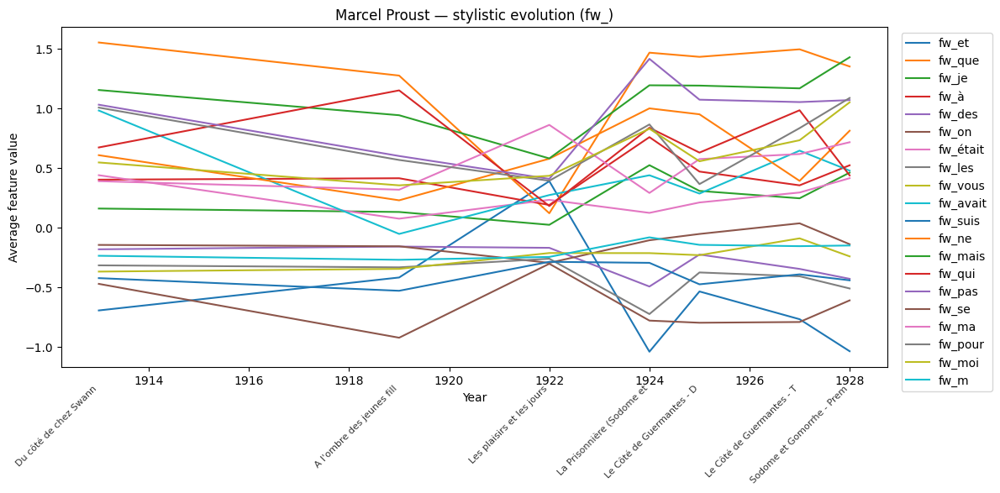

→ Plotting prefix: pun_


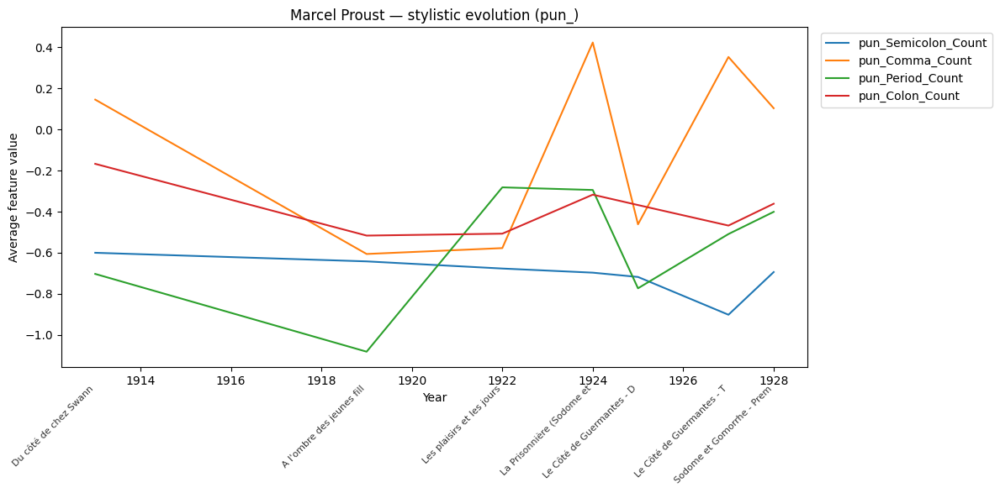

→ Plotting prefix: lex_


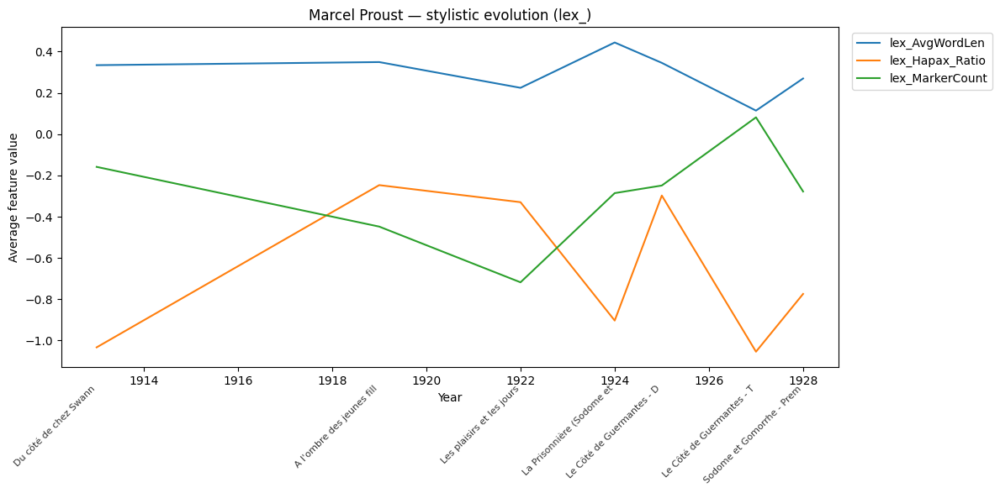

→ Plotting prefix: POS_


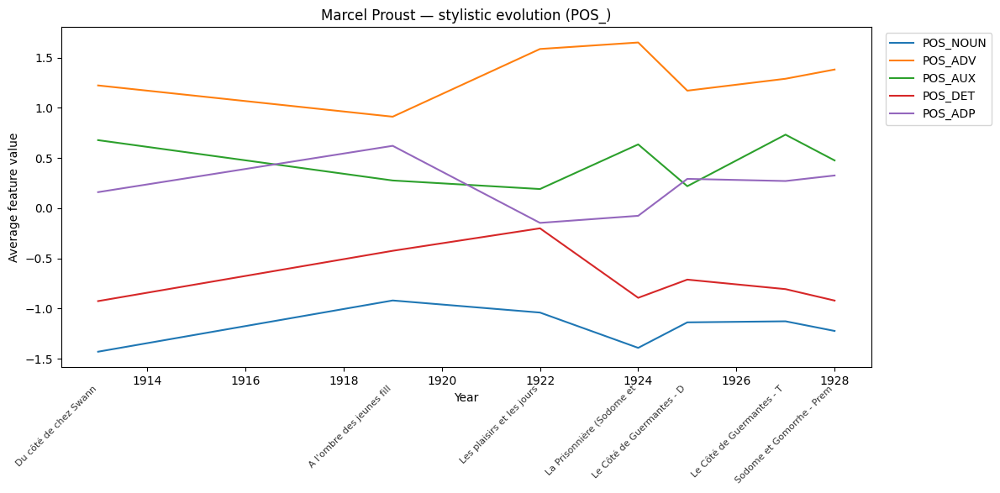

→ Plotting prefix: syn_


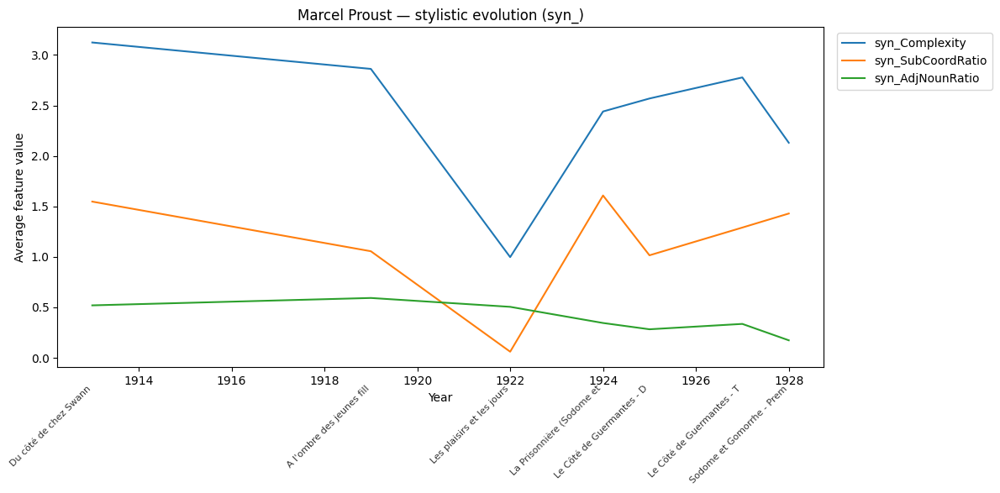

→ Plotting prefix: tense_


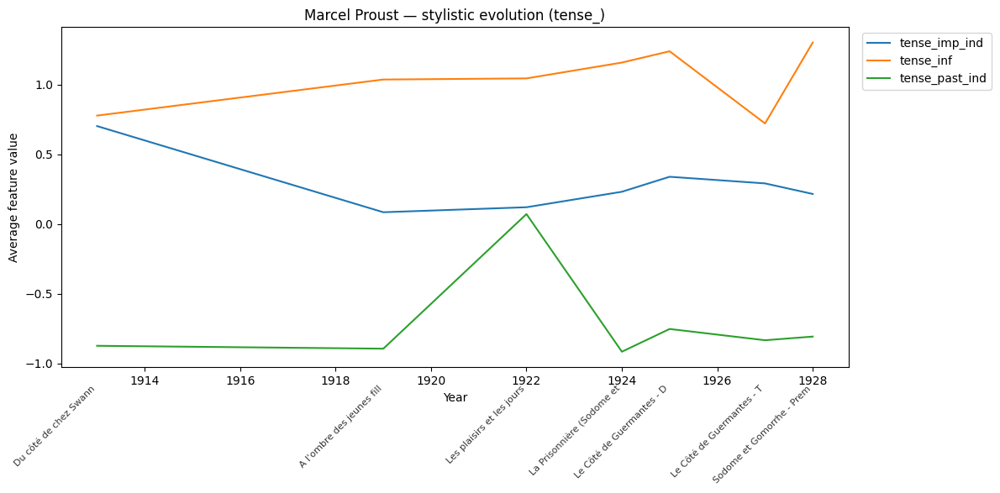

→ Plotting prefix: sent_


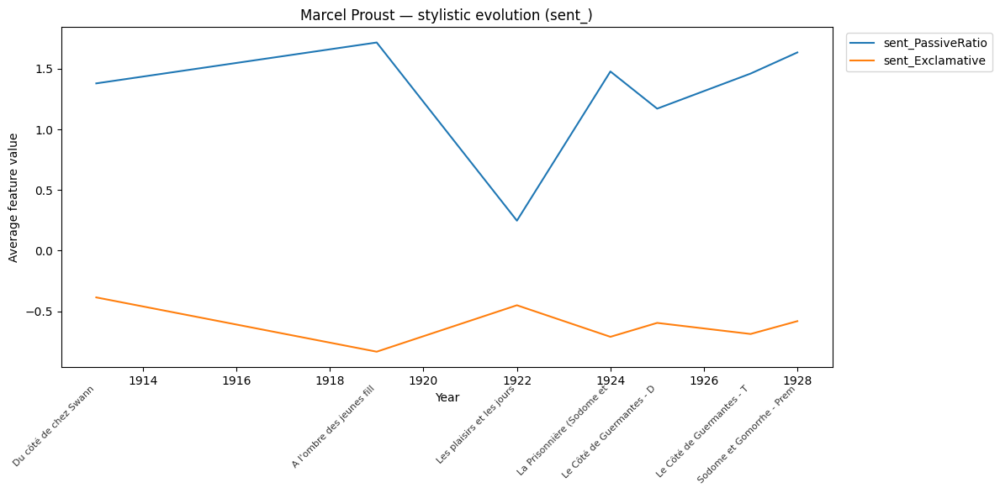

→ Plotting prefix: dep_


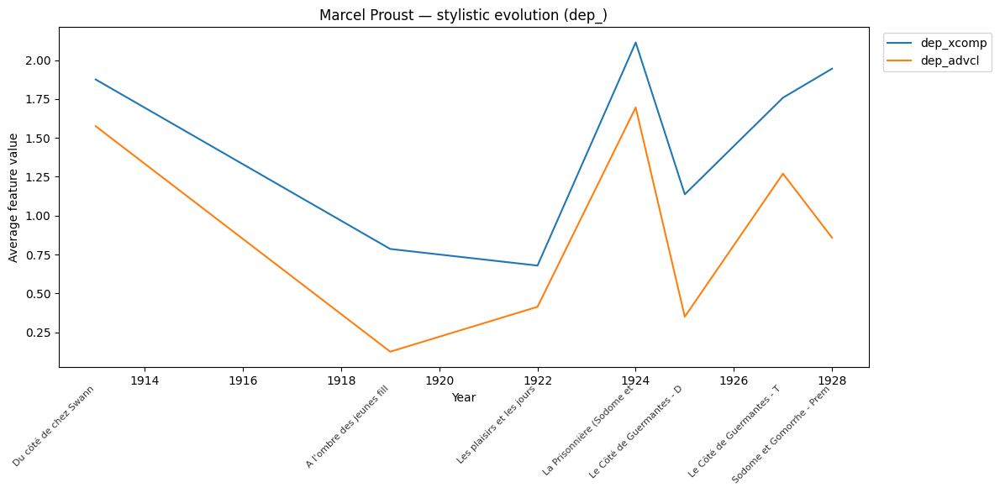

→ Plotting prefix: fig_


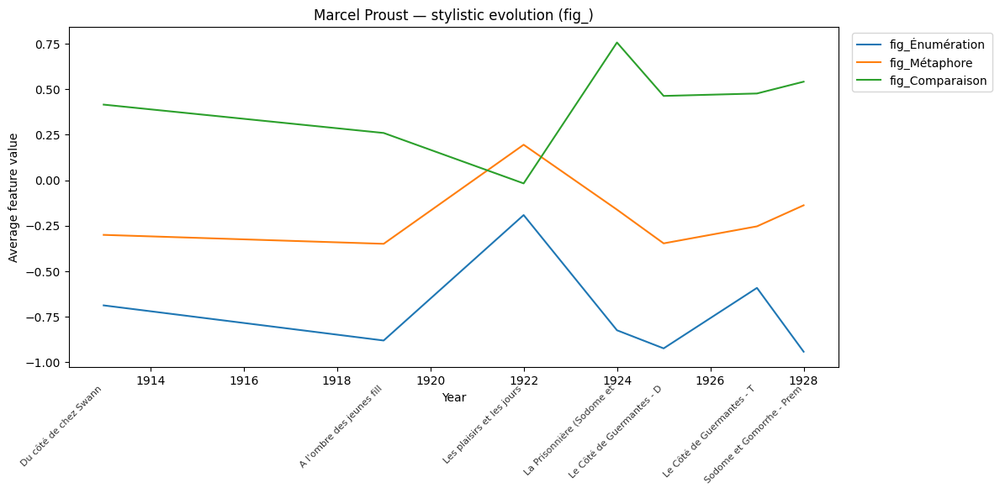

In [250]:
# Define the prefixes you want to visualize
prefixes_to_plot = ["fw_", "pun_", "lex_", "POS_", "syn_", "tense_", "sent_", "dep_", "fig_"]

# Get authors with more than 15 books
authors_with_many_books = authors_df[authors_df['n_books'] > 15].index.tolist()

# Loop over authors and prefixes
for author in authors_with_many_books:
    print(f"\n=== {author} ===")
    for prefix in prefixes_to_plot:
        print(f"→ Plotting prefix: {prefix}")
        plot_evolution_with_titles(author, prefix=prefix)


In [251]:
def plot_top_coefficient_features_evolution(author, top_n=10, min_year=1800, max_year=1950):
    """
    Plot evolution of top-n most important features for an author, based on logistic regression coefficients.
    """

    # Retrieve top N most discriminative features (by absolute value)
    if author not in coefs.index:
        print(f"No coefficients found for author {author}")
        return

    top_features = coefs.loc[author].abs().sort_values(ascending=False).head(top_n).index.tolist()

    # Build the base DataFrame as in previous plot
    stylo_with_id = stylo_df.copy()
    stylo_with_id['Excerpt_ID'] = texts['Excerpt_ID'].values
    stylo_with_id['Author'] = texts['Author'].values
    stylo_with_id['Title'] = texts['Title'].values

    author_df = stylo_with_id[stylo_with_id['Author'] == author].copy()
    if author_df.empty:
        return

    author_df['EBook-No'] = author_df['Excerpt_ID'].apply(lambda x: int(str(x).split('_')[0]))
    author_df = author_df.merge(books_df[['EBook-No', 'Date', 'Title']], on='EBook-No', how='left', suffixes=('', '_Book'))
    author_df = author_df.dropna(subset=['Date'])
    author_df['Year'] = author_df['Date'].astype(int)

    grouped = author_df.groupby('Year')[top_features].mean()
    titles_by_year = author_df.groupby('Year')['Title_Book'].first()
    grouped = grouped[(grouped.index >= min_year) & (grouped.index <= max_year)]

    if grouped.empty:
        return

    # Plot
    plt.figure(figsize=(12, 6))
    for col in grouped.columns:
        plt.plot(grouped.index, grouped[col], label=col)

    # Title annotation (below)
    y_bottom = plt.ylim()[0] - (plt.ylim()[1] - plt.ylim()[0]) * 0.05
    for year, title in titles_by_year.items():
        if isinstance(title, str):
            short_title = title.split(":")[0].split(".")[0].strip()[:25]
            plt.text(year, y_bottom, short_title, rotation=45, ha='right', va='top', fontsize=8, alpha=0.8)

    plt.title(f"{author} — Evolution of top {top_n} discriminative features")
    plt.xlabel("Year")
    plt.ylabel("Average feature value")
    plt.legend(loc="upper left", bbox_to_anchor=(1.01, 1.0))
    plt.figure(figsize=(max(12, 1.2 * top_n), 6))
    plt.tight_layout()
    plt.show()



=== Honoré de Balzac ===


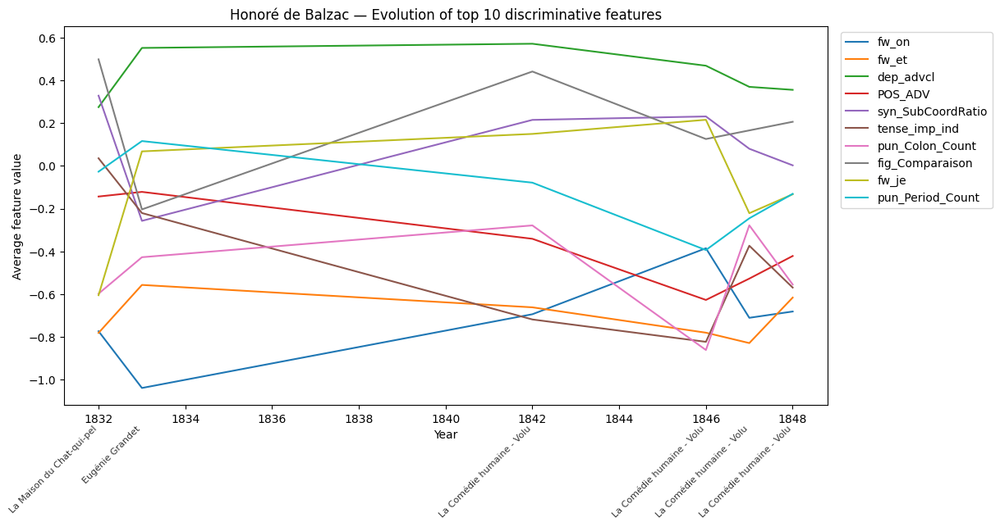

<Figure size 1200x600 with 0 Axes>


=== Alexandre Dumas ===


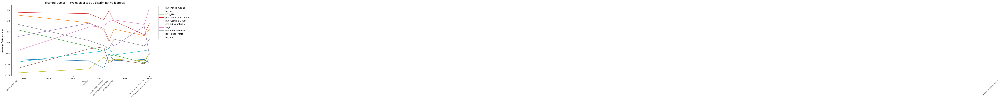

<Figure size 1200x600 with 0 Axes>


=== George Sand ===


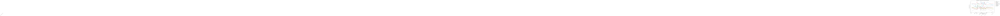

<Figure size 1200x600 with 0 Axes>


=== Paul Féval ===


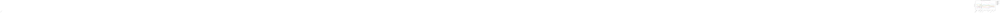

<Figure size 1200x600 with 0 Axes>


=== Jules Verne ===


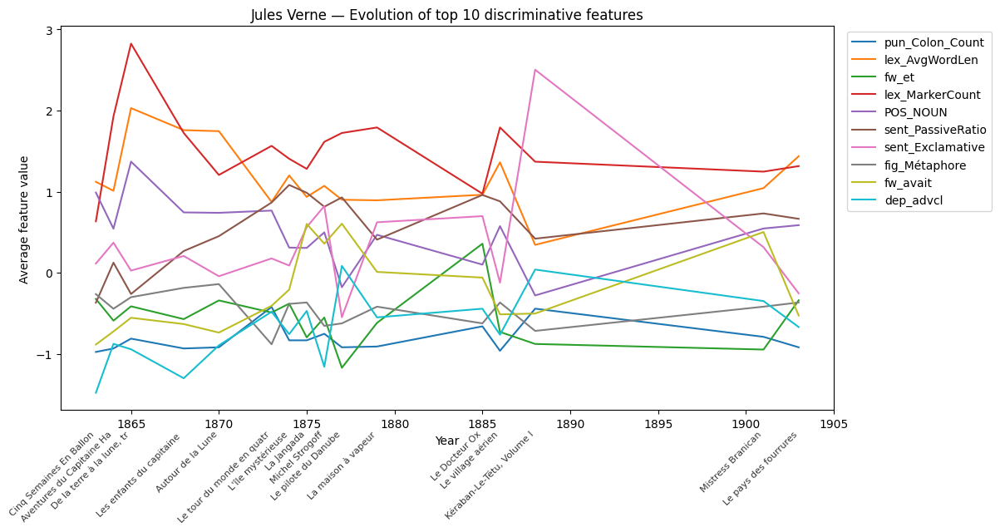

<Figure size 1200x600 with 0 Axes>


=== Émile Zola ===


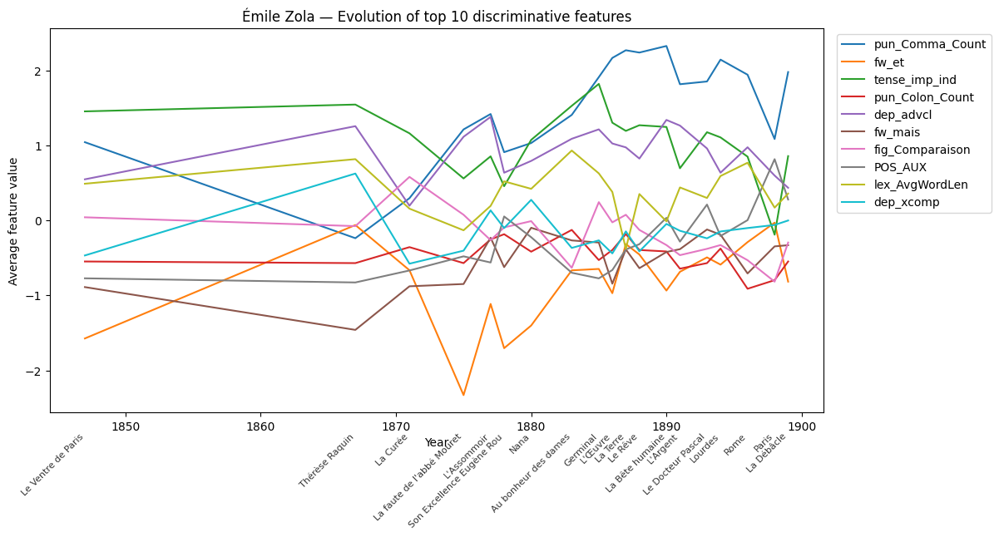

<Figure size 1200x600 with 0 Axes>


=== Marcel Proust ===


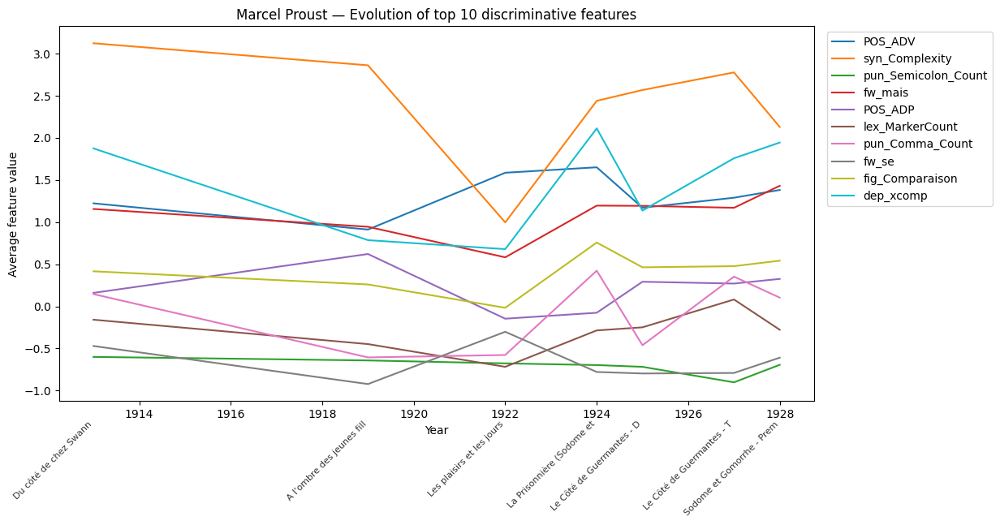

<Figure size 1200x600 with 0 Axes>

In [252]:
# Loop over authors and prefixes
for author in authors_with_many_books:
    print(f"\n=== {author} ===")
    plot_top_coefficient_features_evolution(author)

### Evolution of style by movement

In [185]:
authors_df['Mouvement'].unique()

array(['Romantisme', 'Réalisme', 'Proto SF', 'Naturalisme',
       'Roman Moderne', 'Décadentisme', 'Symbolisme', 'Prolétarien',
       'Catholicisme littéraire'], dtype=object)

In [307]:
authors_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28 entries, Charles Nodier to Georges Bernanos
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   birth_date     28 non-null     object 
 1   death_date     28 non-null     object 
 2   n_books        28 non-null     int64  
 3   Mouvement      28 non-null     object 
 4   Genres         28 non-null     object 
 5   n_excerpts     28 non-null     int64  
 6   WikiLangCount  28 non-null     float64
 7   Genre_List     28 non-null     object 
 8   Unicity        28 non-null     float64
 9   Centrality     28 non-null     float64
dtypes: float64(3), int64(2), object(5)
memory usage: 3.5+ KB


In [304]:
# Fonction pour uniformiser les dates
def uniformize_date(date_str):
    if isinstance(date_str, str) and re.match(r'\d{2}/\d{2}/\d{4}', date_str):
        # Si format DD/MM/YYYY → convertir en YYYY-MM-DD
        day, month, year = date_str.split('/')
        return f'{year}-{month}-{day}'
    return date_str  # Déjà au bon format


In [308]:
# Uniformisation déjà faite
authors_df['death_date'] = authors_df['death_date'].apply(uniformize_date)
authors_df['birth_date'] = authors_df['birth_date'].apply(uniformize_date)

# Convertir en datetime
authors_df['birth_date'] = pd.to_datetime(authors_df['birth_date'], errors='coerce')
authors_df['death_date'] = pd.to_datetime(authors_df['death_date'], errors='coerce')

# Extraire les années
authors_df['birth_year'] = authors_df['birth_date'].dt.year
authors_df['death_year'] = authors_df['death_date'].dt.year

# Calcul de la moyenne arrondie
authors_df['MidYear'] = ((authors_df['birth_year'] + authors_df['death_year']) // 2).astype('Int64')


In [309]:
authors_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 28 entries, Charles Nodier to Georges Bernanos
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   birth_date     28 non-null     datetime64[ns]
 1   death_date     28 non-null     datetime64[ns]
 2   n_books        28 non-null     int64         
 3   Mouvement      28 non-null     object        
 4   Genres         28 non-null     object        
 5   n_excerpts     28 non-null     int64         
 6   WikiLangCount  28 non-null     float64       
 7   Genre_List     28 non-null     object        
 8   Unicity        28 non-null     float64       
 9   Centrality     28 non-null     float64       
 10  birth_year     28 non-null     int32         
 11  death_year     28 non-null     int32         
 12  MidYear        28 non-null     Int64         
dtypes: Int64(1), datetime64[ns](2), float64(3), int32(2), int64(2), object(3)
memory usage: 3.9+ KB


In [313]:
def plot_global_feature_scatter_by_movement(feature_name):
    """
    Plot a global 2D scatter of authors: X = mid life year, Y = average feature value,
    colored by literary movement. Adds movement-level mean points with labels.
    """
    # Compute mean feature value per author
    feature_means = stylo_df.groupby('author')[feature_name].mean()

    # Merge with author metadata
    df = authors_df.copy()
    df['FeatureMean'] = df.index.map(feature_means)

    # Drop rows with missing values
    df = df.dropna(subset=['FeatureMean', 'MidYear', 'Mouvement'])

    # Create plot
    plt.figure(figsize=(10, 6))
    
    # Plot individual authors, grouped by movement
    for mouvement in df['Mouvement'].unique():
        subset = df[df['Mouvement'] == mouvement]
        plt.scatter(subset['MidYear'], subset['FeatureMean'], label=mouvement, alpha=0.6)

    # Add movement means as labeled points
    grouped = df.groupby('Mouvement').agg({'MidYear': 'mean', 'FeatureMean': 'mean'})
    for mouvement, row in grouped.iterrows():
        plt.scatter(row['MidYear'], row['FeatureMean'], color='black', marker='x', s=100)
        plt.text(row['MidYear'] + 0.5, row['FeatureMean'], mouvement, fontsize=8, ha='left', va='center')

    # Final decorations
    plt.title(f"Global stylistic feature: {feature_name}")
    plt.xlabel("Author mid-life year")
    plt.ylabel(f"Average value of '{feature_name}'")
    plt.legend(loc='lower left', bbox_to_anchor=(1.05, 0.5))
    plt.tight_layout()
    plt.show()



=== Plotting for top feature: pun_Semicolon_Count ===


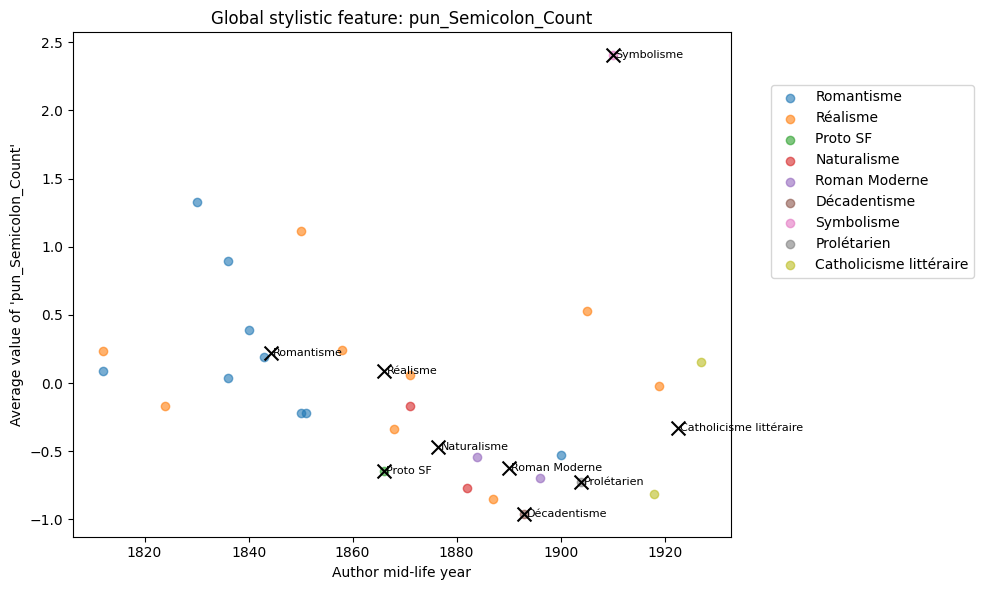


=== Plotting for top feature: fw_et ===


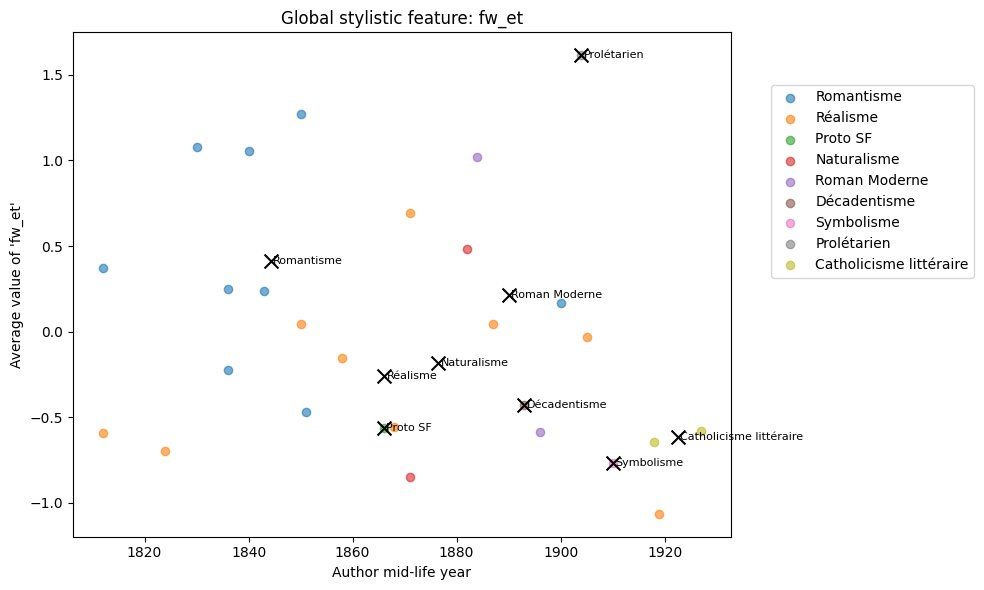


=== Plotting for top feature: pun_Comma_Count ===


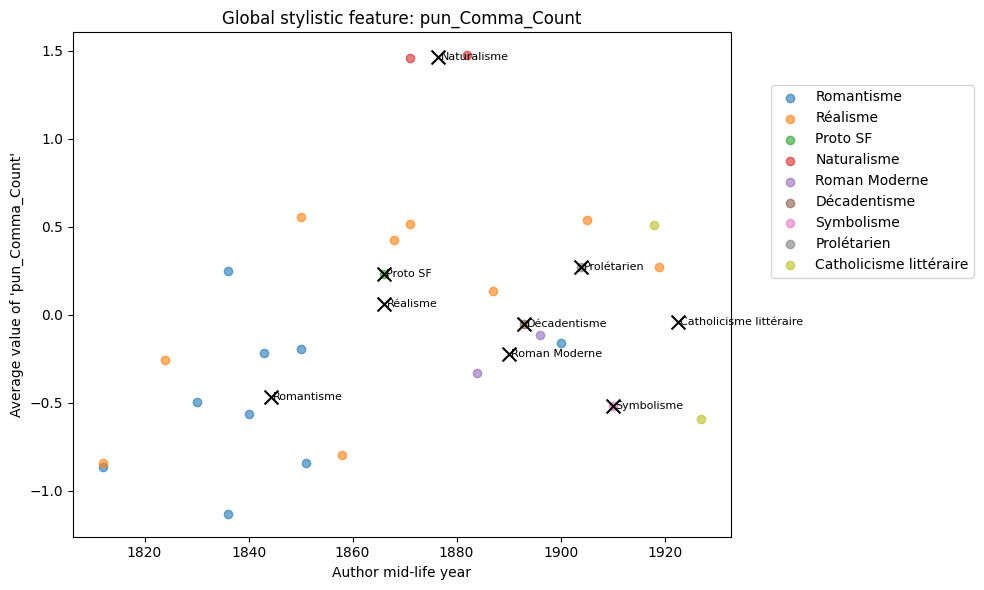


=== Plotting for top feature: pun_Period_Count ===


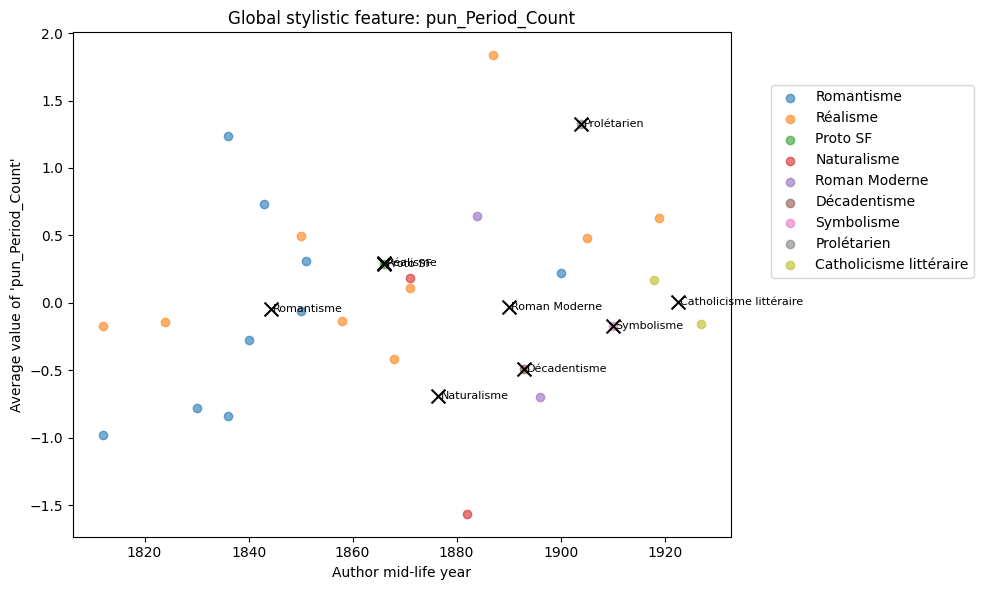


=== Plotting for top feature: syn_Complexity ===


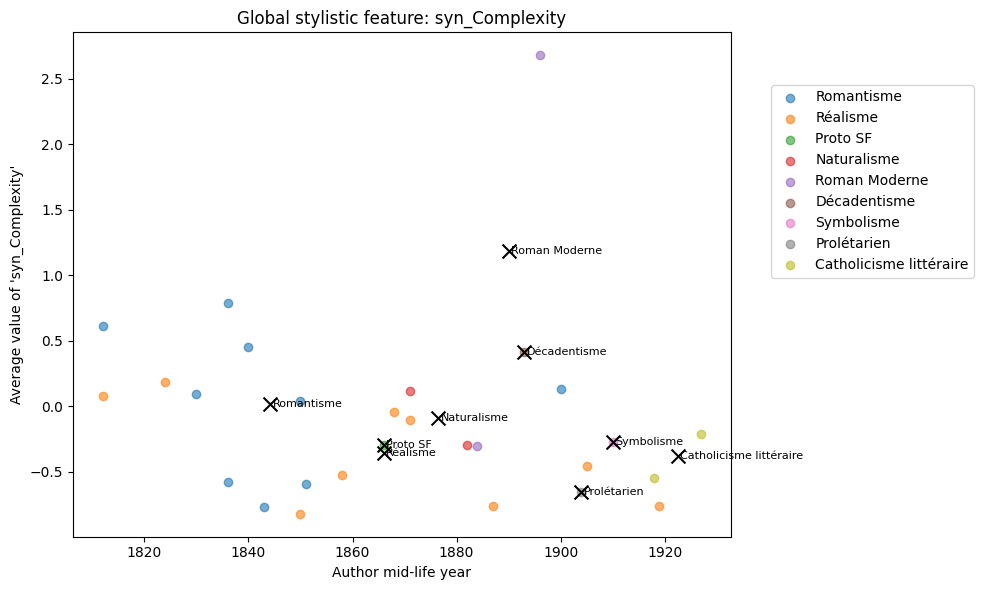


=== Plotting for top feature: POS_NOUN ===


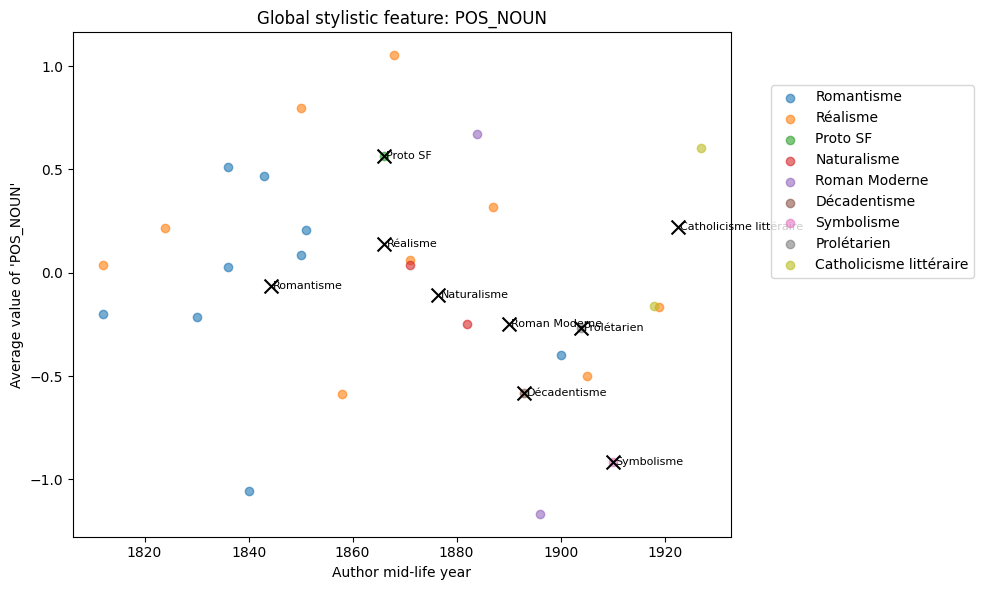


=== Plotting for top feature: lex_AvgWordLen ===


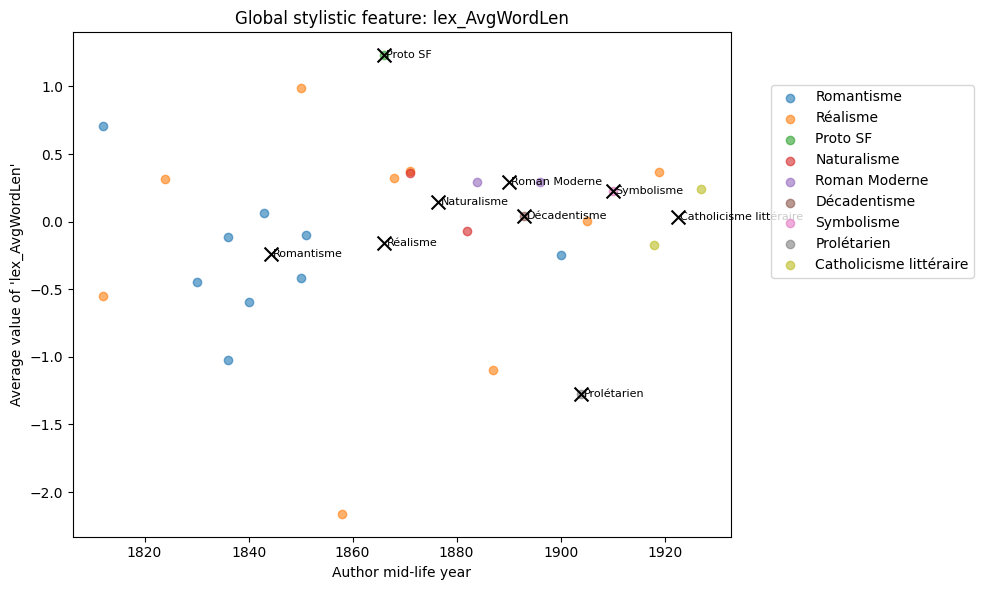


=== Plotting for top feature: POS_ADV ===


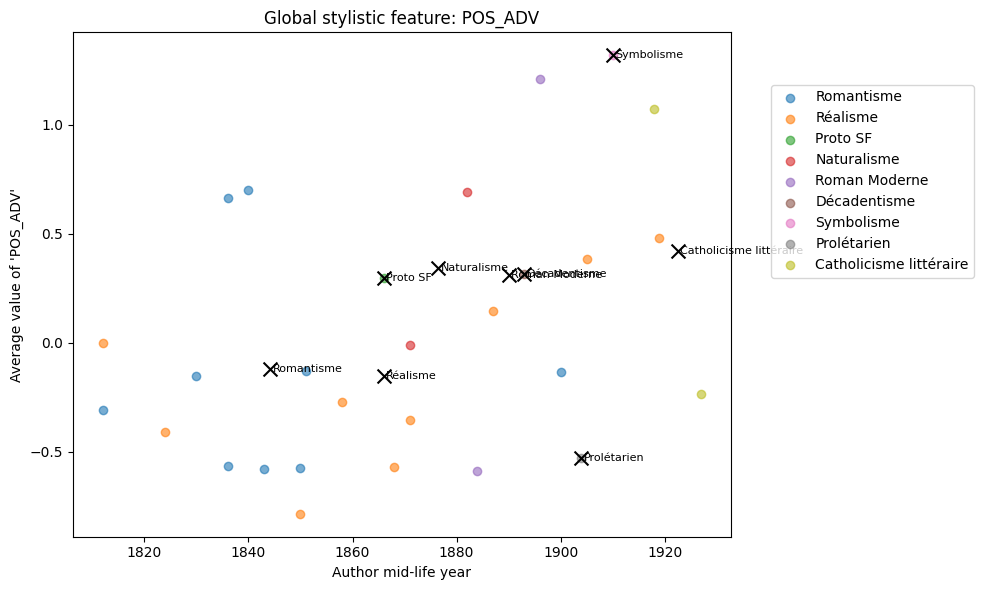


=== Plotting for top feature: POS_ADP ===


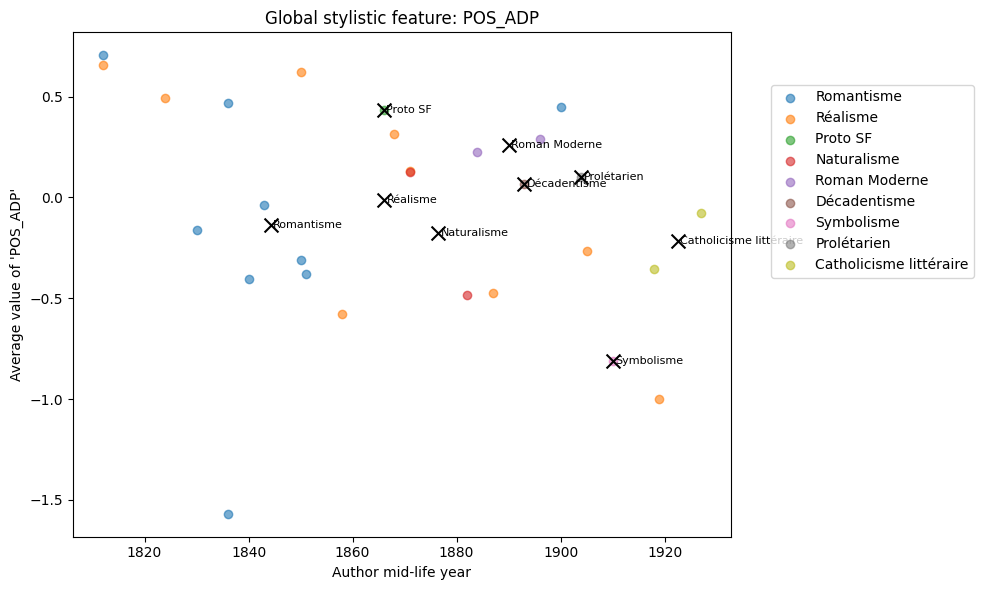


=== Plotting for top feature: pun_Colon_Count ===


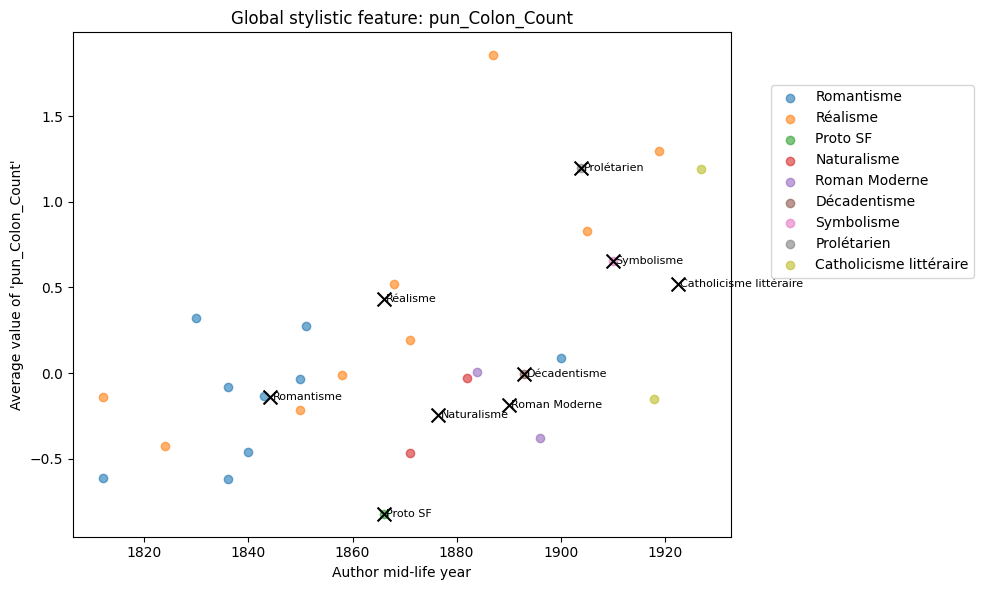

In [314]:
# Step 1: Get average absolute coefficient across all authors
avg_abs_coefs = coefs.abs().mean(axis=0)

# Step 2: Get top 10 most "important" features
top_features = avg_abs_coefs.sort_values(ascending=False).head(10).index.tolist()

# Step 3: Loop and plot
for feature in top_features:
    print(f"\n=== Plotting for top feature: {feature} ===")
    plot_global_feature_scatter_by_movement(feature)


### Boxplots of catgeories of features

In [315]:
def plot_coefficient_boxplot_by_prefix(coef_df):
    """
    Plot a boxplot of logistic regression coefficients grouped by feature prefix.
    `coef_df` is expected to be a DataFrame: rows = authors, cols = features.
    """
    # Step 1: Melt the DataFrame to long format
    melted = coef_df.reset_index().melt(id_vars='index', var_name='feature', value_name='coefficient')
    
    # Step 2: Extract the prefix (before underscore)
    melted['prefix'] = melted['feature'].str.extract(r'(^[^_]+_)')
    
    # Optional: Clean trailing underscore for display
    melted['prefix'] = melted['prefix'].str.replace('_$', '', regex=True)

    # Step 3: Plot
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=melted, x='prefix', y='coefficient', palette='Set2')
    plt.title("Distribution of Logistic Regression Coefficients by Feature Category")
    plt.xlabel("Feature Category (Prefix)")
    plt.ylabel("Coefficient Value")
    plt.axhline(0, color='gray', linestyle='--')
    plt.tight_layout()
    plt.show()

/var/folders/xn/v7b7dbbn6xg3hzr5h4395gbc0000gn/T/ipykernel_31191/2734682879.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=melted, x='prefix', y='coefficient', palette='Set2')


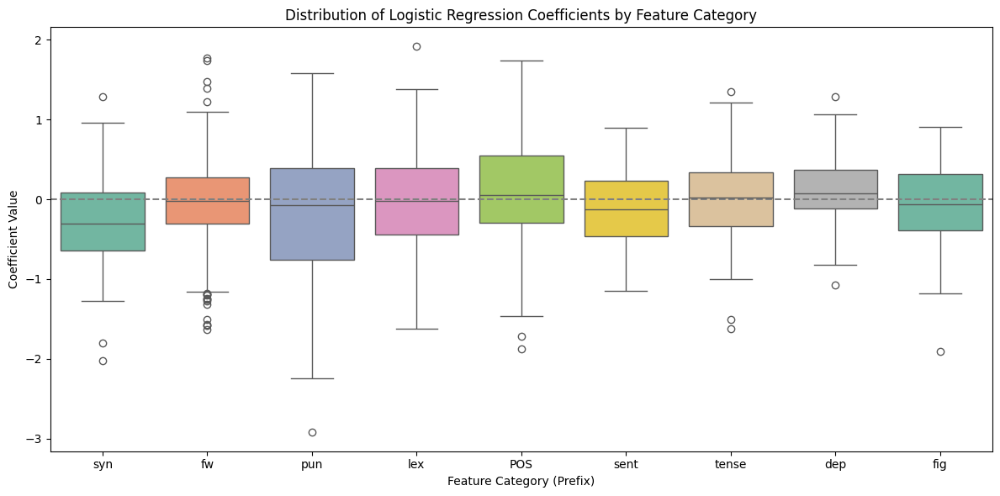

In [316]:
plot_coefficient_boxplot_by_prefix(coefs)

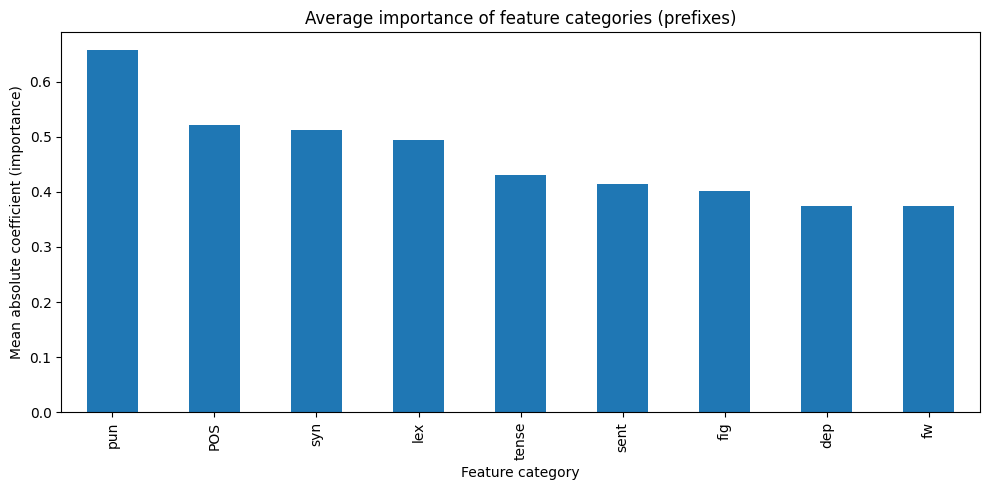

In [320]:
# Extract prefix from feature names
feature_prefixes = coefs.columns.to_series().str.extract(r'(^[^_]+_)')[0]
feature_prefixes = feature_prefixes.str.replace('_$', '', regex=True)

# Compute importance per feature
feature_importance_df = pd.DataFrame({
    'feature': coefs.columns,
    'prefix': feature_prefixes,
    'importance': coefs.abs().mean(axis=0).values
})

# Aggregate by prefix
category_importance = feature_importance_df.groupby('prefix')['importance'].mean().sort_values(ascending=False)

# Plot
category_importance.plot(kind='bar', figsize=(10, 5))
plt.title("Average importance of feature categories (prefixes)")
plt.ylabel("Mean absolute coefficient (importance)")
plt.xlabel("Feature category")
plt.tight_layout()
plt.show()


In [321]:
def plot_feature_importance_by_movement(movement, top_n=10):
    """
    Plot top N most important features (mean abs coeff) for a specific movement.
    """
    # Get authors in this movement
    authors = authors_df[authors_df['Mouvement'] == movement].index
    if len(authors) == 0:
        print(f"No authors found for movement: {movement}")
        return

    # Subset coefficients
    subset = coefs.loc[coefs.index.intersection(authors)]

    # Compute mean absolute coefficient per feature
    feature_importance = subset.abs().mean().sort_values(ascending=False)

    # Plot top N
    plt.figure(figsize=(8, 5))
    feature_importance.head(top_n).plot(kind='barh')
    plt.title(f"Top {top_n} features for movement: {movement}")
    plt.xlabel("Mean absolute coefficient")
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.show()


In [322]:
def plot_category_importance_by_movement(movement):
    """
    Plot mean feature importance grouped by category (prefix) for a movement.
    """
    # Get authors in this movement
    authors = authors_df[authors_df['Mouvement'] == movement].index
    if len(authors) == 0:
        print(f"No authors found for movement: {movement}")
        return

    # Subset coefficients
    subset = coefs.loc[coefs.index.intersection(authors)]

    # Extract prefixes
    feature_prefixes = pd.Series(subset.columns).str.extract(r'(^[^_]+_)')[0]
    feature_prefixes = feature_prefixes.str.replace('_$', '', regex=True)

    # Build DataFrame
    feature_importance_df = pd.DataFrame({
        'feature': subset.columns,
        'prefix': feature_prefixes,
        'importance': subset.abs().mean().values
    })

    # Group by category
    category_importance = feature_importance_df.groupby('prefix')['importance'].mean().sort_values(ascending=False)

    # Plot
    plt.figure(figsize=(10, 5))
    category_importance.plot(kind='bar')
    plt.title(f"Category-level importance for movement: {movement}")
    plt.ylabel("Mean absolute coefficient")
    plt.xlabel("Feature category (prefix)")
    plt.tight_layout()
    plt.show()



=== Romantisme ===


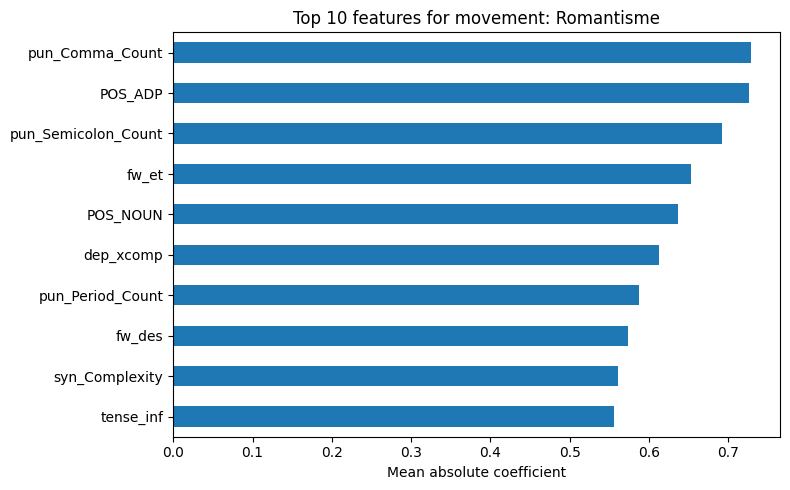

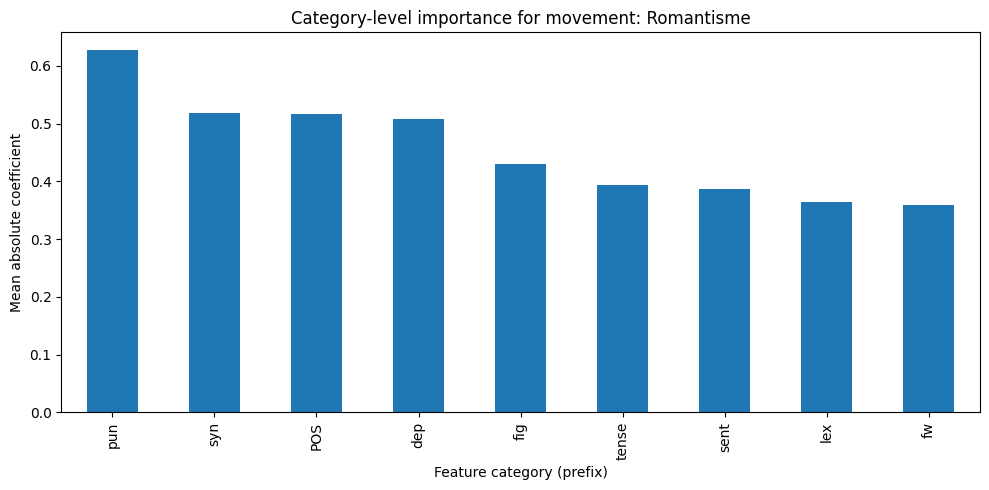


=== Réalisme ===


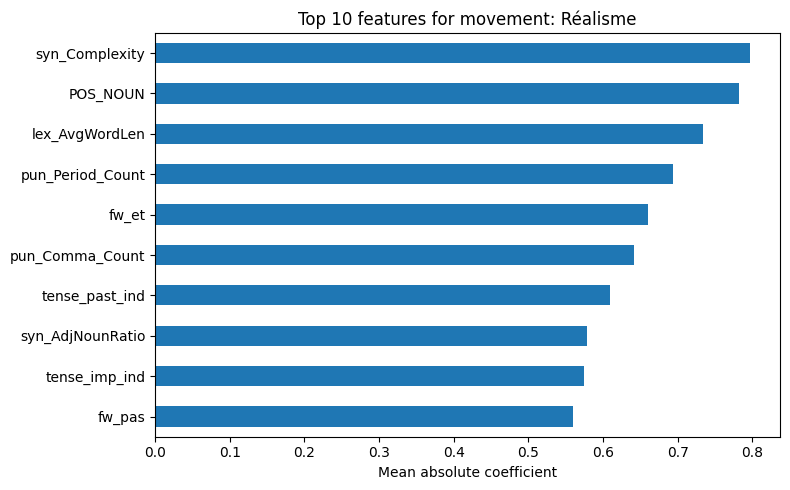

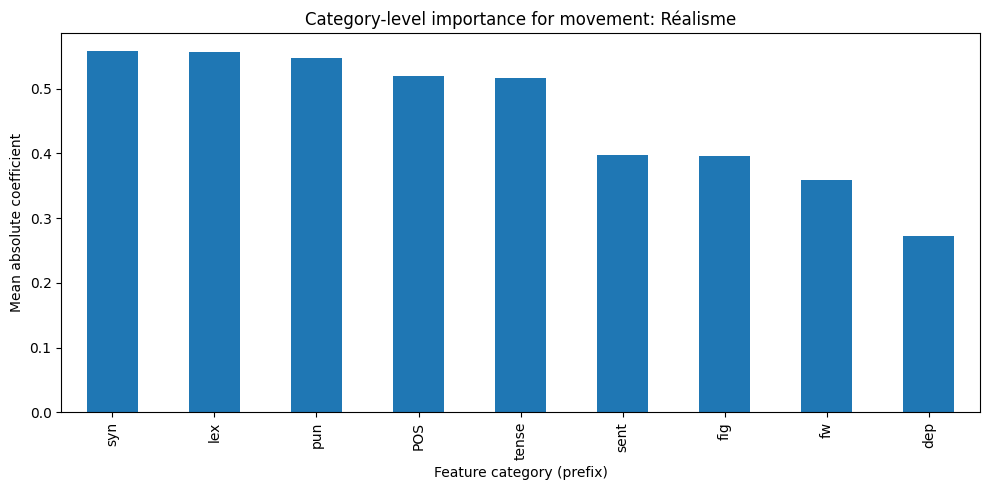


=== Proto SF ===


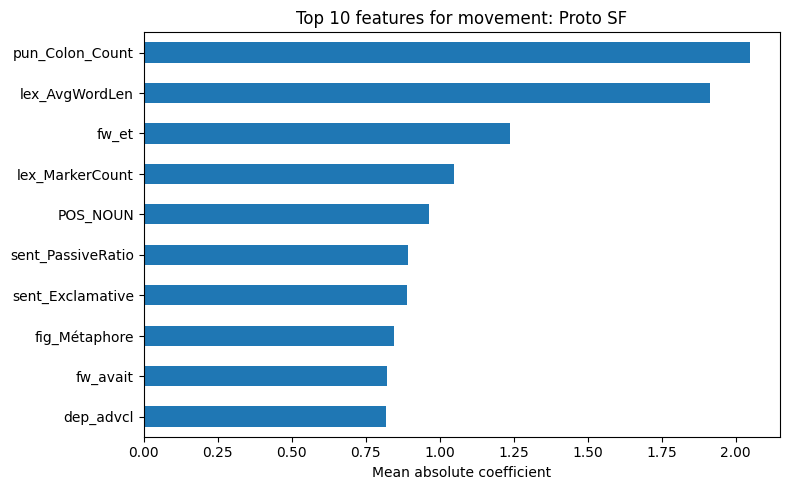

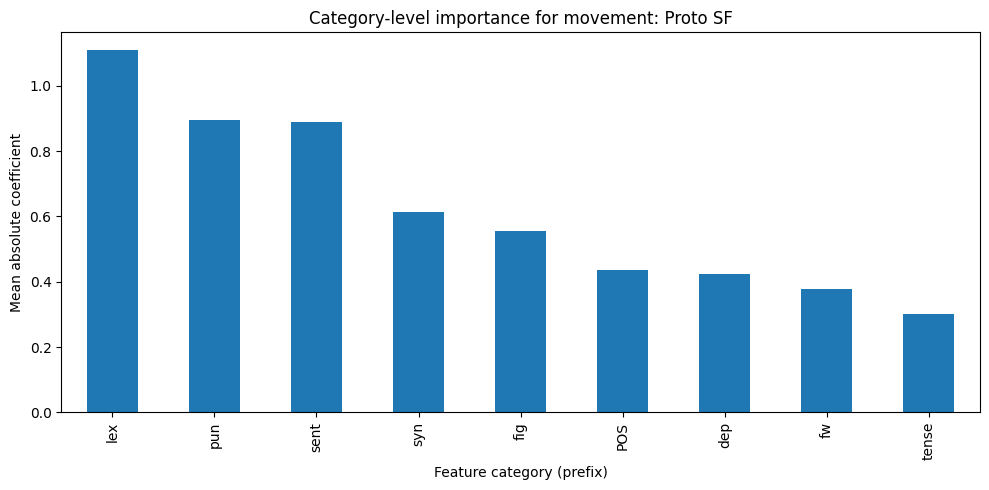


=== Naturalisme ===


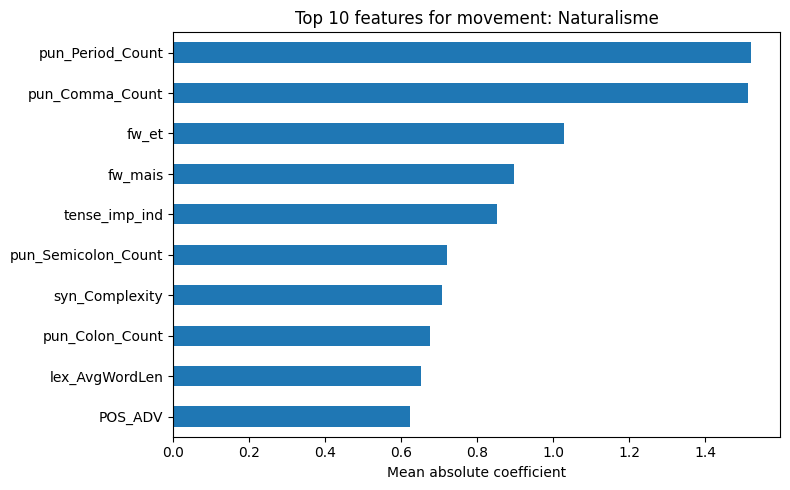

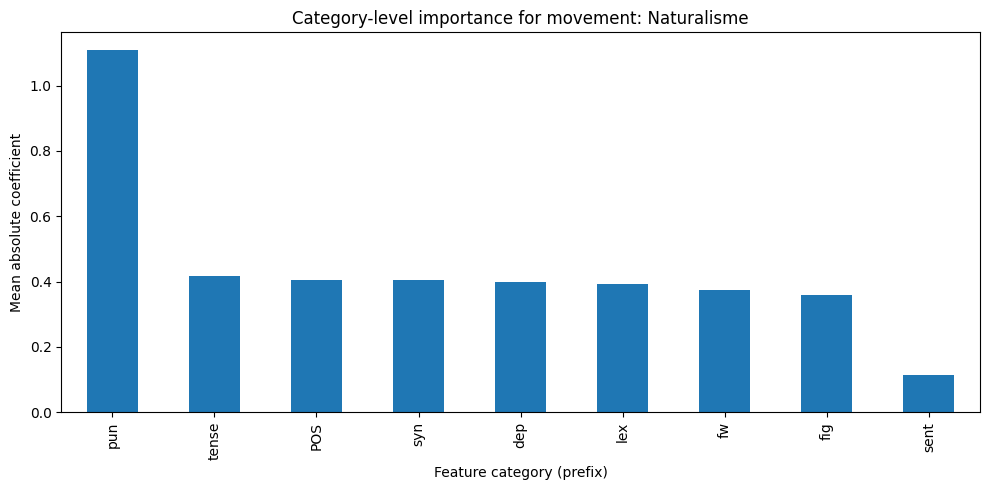


=== Roman Moderne ===


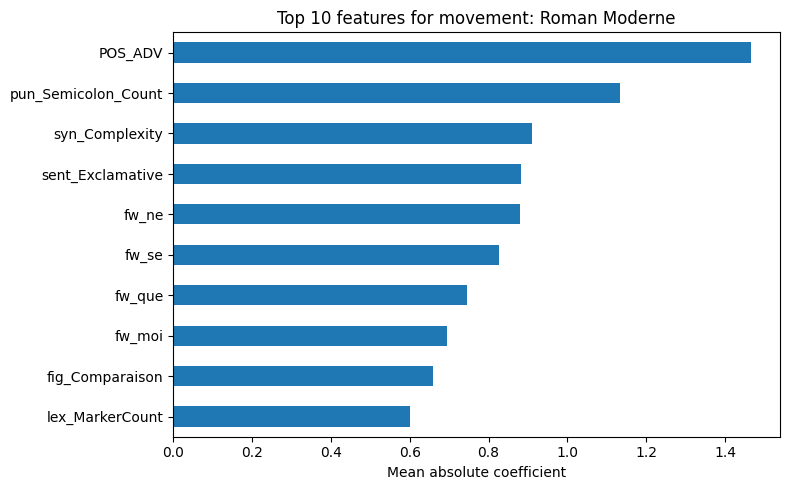

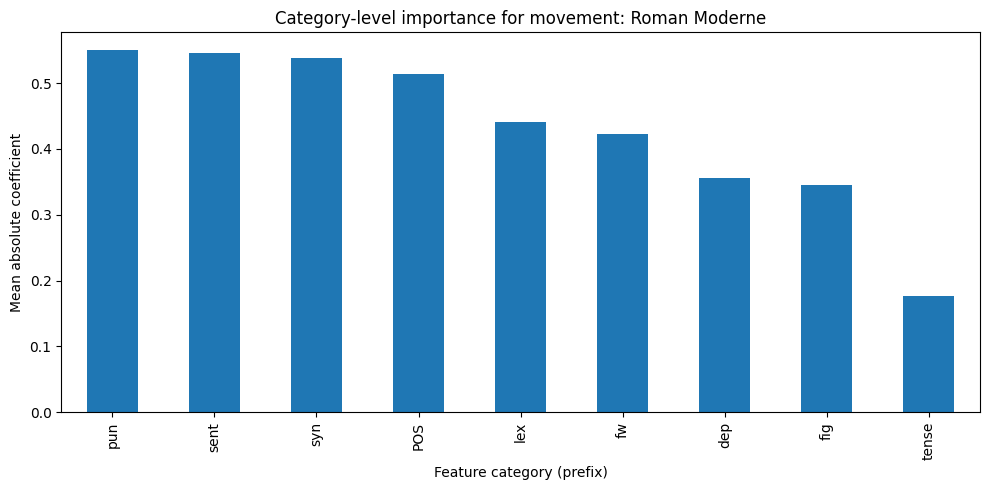


=== Décadentisme ===


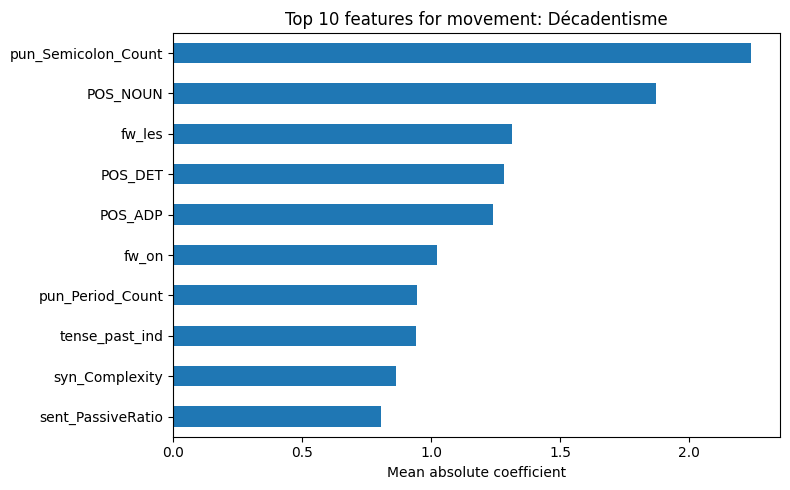

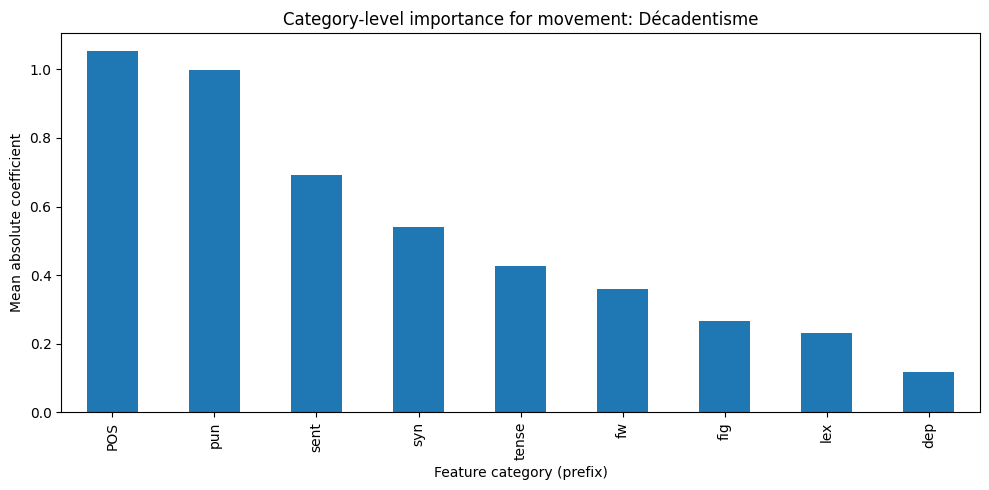


=== Symbolisme ===


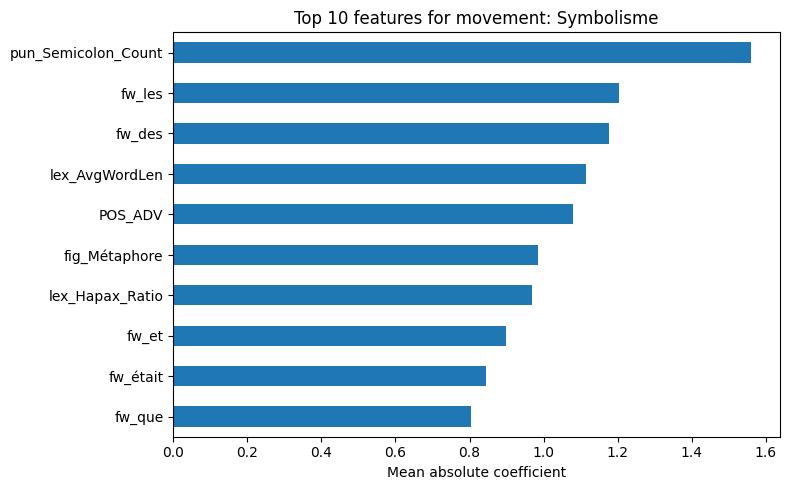

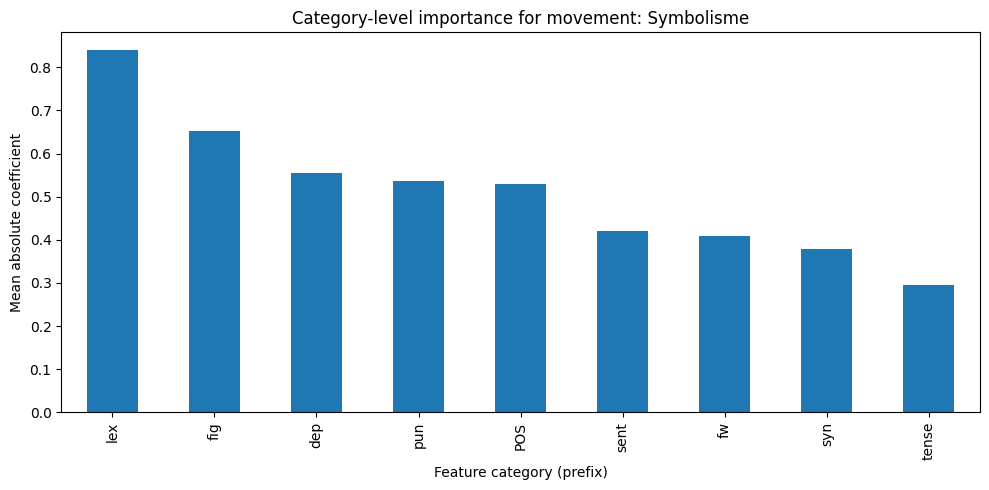


=== Prolétarien ===


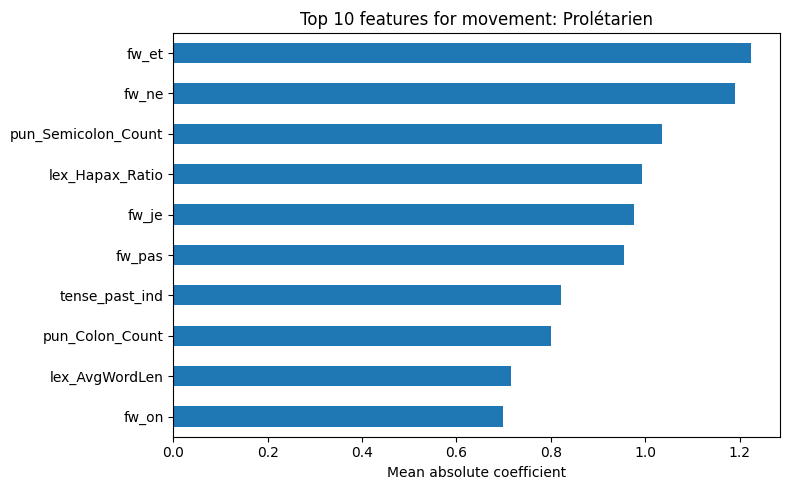

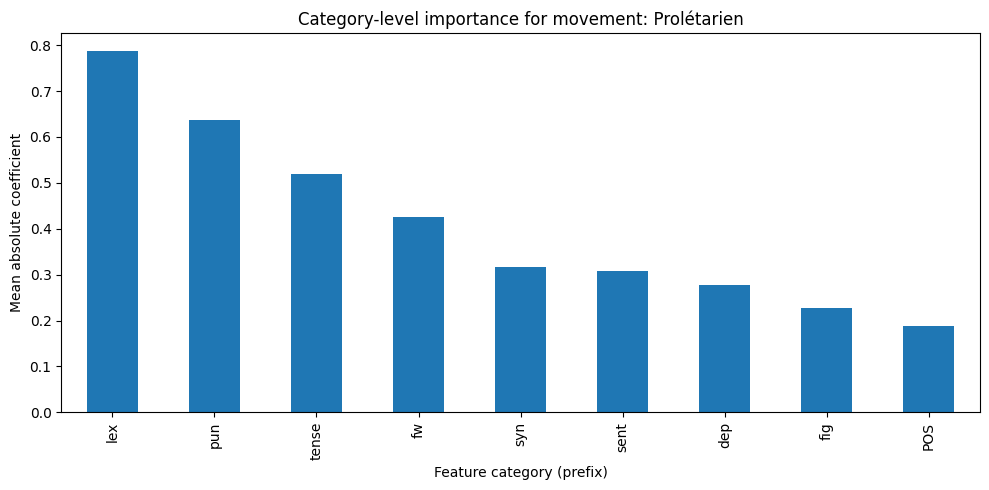


=== Catholicisme littéraire ===


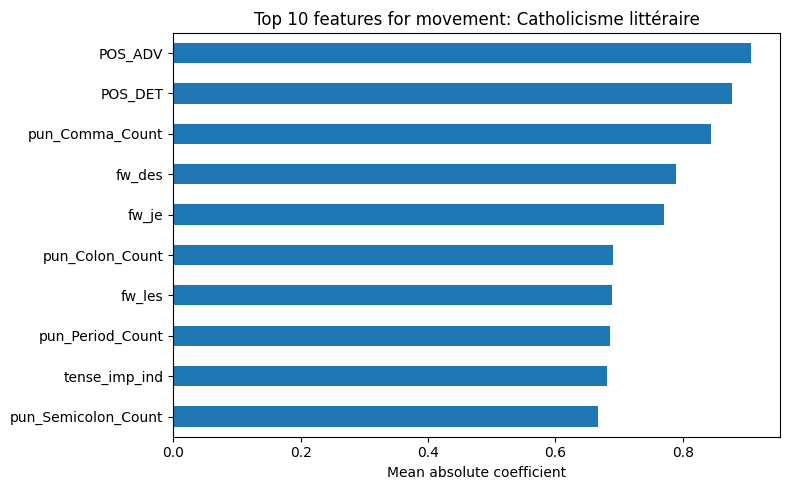

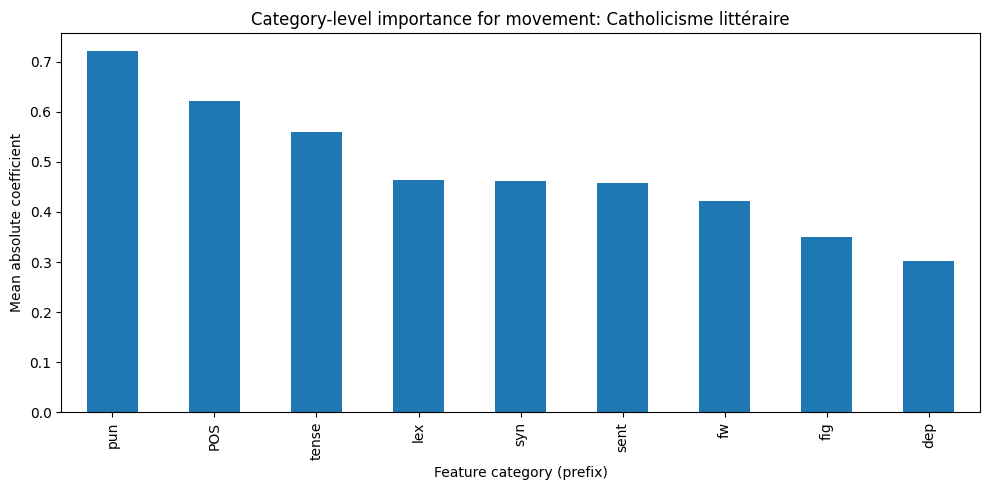

In [323]:
for mvmt in authors_df['Mouvement'].dropna().unique():
    print(f"\n=== {mvmt} ===")
    plot_feature_importance_by_movement(mvmt)
    plot_category_importance_by_movement(mvmt)

In [324]:
def plot_category_importance_comparison(min_authors=2):
    """
    Plot a grouped bar chart: feature category (prefix) vs mean abs coefficient,
    comparing across literary movements + overall.
    """
    # Prepare base structure
    movements = authors_df['Mouvement'].value_counts()
    valid_movements = movements[movements >= min_authors].index.tolist()

    # Get all prefixes
    feature_prefixes = pd.Series(coefs.columns).str.extract(r'(^[^_]+_)')[0]
    feature_prefixes = feature_prefixes.str.replace('_$', '', regex=True)
    
    prefix_map = dict(zip(coefs.columns, feature_prefixes))

    # Store results: rows = prefixes, columns = movements + "Global"
    data = {}

    # Global (all authors)
    global_importance = coefs.abs().mean().rename('Global')
    global_prefix_means = global_importance.groupby(prefix_map).mean()
    data['Global'] = global_prefix_means

    # For each movement
    for mvmt in valid_movements:
        authors = authors_df[authors_df['Mouvement'] == mvmt].index
        subset = coefs.loc[coefs.index.intersection(authors)]
        mean_abs = subset.abs().mean()
        prefix_mean = mean_abs.groupby(prefix_map).mean()
        data[mvmt] = prefix_mean

    # Combine into one DataFrame
    df = pd.DataFrame(data).fillna(0)  # if some prefixes are missing in some groups

    # Plot
    df.T.plot(kind='bar', figsize=(12, 6))
    plt.title("Mean absolute coefficients by feature category and movement")
    plt.xlabel("Movement")
    plt.ylabel("Mean absolute coefficient")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.legend(title="Feature Category", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()


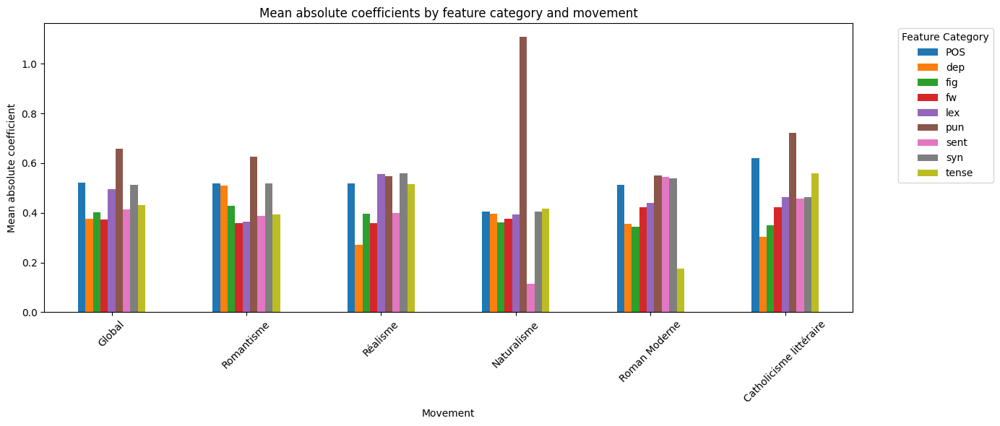

In [325]:
plot_category_importance_comparison()


In [326]:
def plot_category_importance_by_prefix_grouped(min_authors=2):
    """
    Plot a grouped bar chart: feature category (X) vs. mean abs coefficient (Y),
    with bars colored by movement (including 'Global'), grouped by feature category.
    """
    # Step 1: Extract feature prefixes
    feature_prefixes = pd.Series(coefs.columns).str.extract(r'(^[^_]+_)')[0]
    feature_prefixes = feature_prefixes.str.replace('_$', '', regex=True)
    prefix_map = dict(zip(coefs.columns, feature_prefixes))

    # Step 2: Select movements with enough authors
    movements = authors_df['Mouvement'].value_counts()
    valid_movements = movements[movements >= min_authors].index.tolist()

    # Step 3: Prepare container for results
    data = {}

    # Global
    global_importance = coefs.abs().mean().rename('Global')
    global_prefix_means = global_importance.groupby(prefix_map).mean()
    data['Global'] = global_prefix_means

    # Per movement
    for mvmt in valid_movements:
        authors = authors_df[authors_df['Mouvement'] == mvmt].index
        subset = coefs.loc[coefs.index.intersection(authors)]
        mean_abs = subset.abs().mean()
        prefix_mean = mean_abs.groupby(prefix_map).mean()
        data[mvmt] = prefix_mean

    # Step 4: Combine into DataFrame
    df = pd.DataFrame(data).T.fillna(0)  # shape = (movement, prefix)

    # Step 5: Plot transposed version
    df.T.plot(kind='bar', figsize=(12, 6), width=0.8)
    plt.title("Mean absolute coefficients by feature category (grouped by prefix)")
    plt.xlabel("Feature Category")
    plt.ylabel("Mean absolute coefficient")
    plt.xticks(rotation=45)
    plt.legend(title="Movement", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


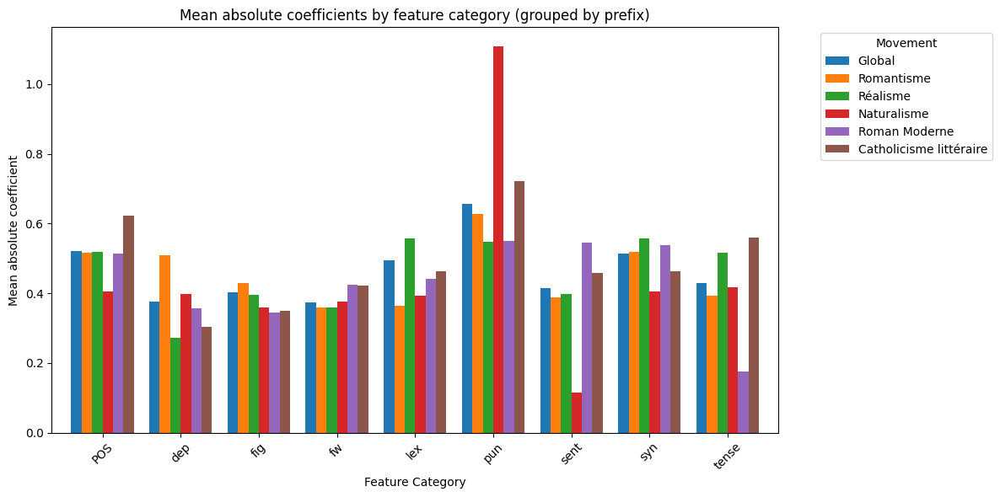

In [327]:
plot_category_importance_by_prefix_grouped()


               InterAuthor  IntraMovement  DiffToDiag
InterAuthor       1.000000       0.725916    0.595179
IntraMovement     0.725916       1.000000    0.804652
DiffToDiag        0.595179       0.804652    1.000000


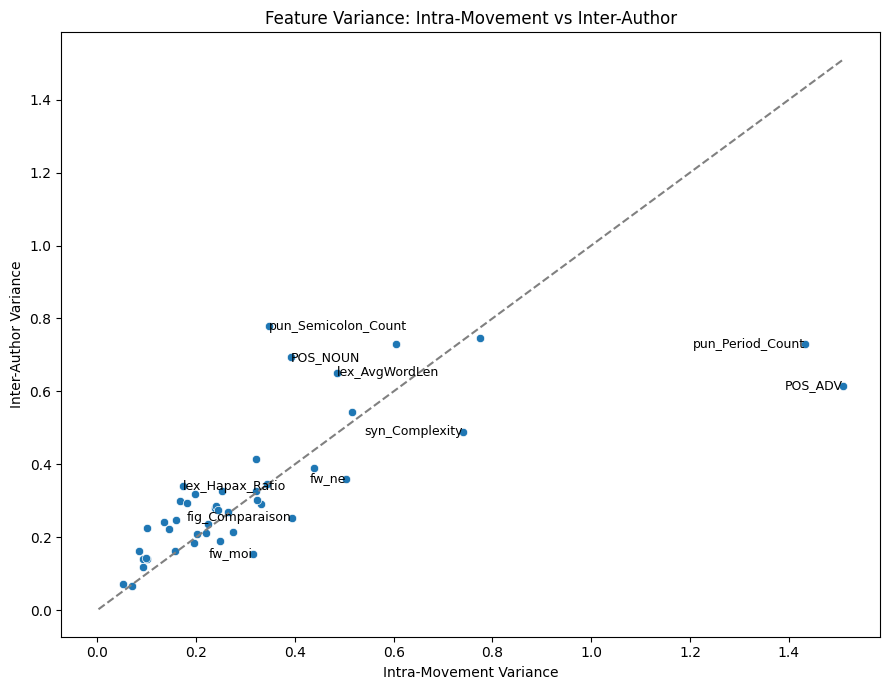

In [353]:
def plot_variance_intra_vs_inter(label_top_n=10):
    coef_variance = coefs.copy()
    coef_variance['Mouvement'] = authors_df.loc[coef_variance.index, 'Mouvement']

    # Inter-auteur = variance globale
    inter_var = coefs.var()

    # Intra-mouvement = moyenne des variances intra-groupes
    intra_var = coef_variance.groupby('Mouvement').var().mean()

    # Fusion et calcul des écarts
    df_var = pd.DataFrame({'InterAuthor': inter_var, 'IntraMovement': intra_var}).dropna()
    df_var["DiffToDiag"] = (df_var["InterAuthor"] - df_var["IntraMovement"]).abs()

    plt.figure(figsize=(9, 7))
    sns.scatterplot(x='IntraMovement', y='InterAuthor', data=df_var)

    # Diagonale de référence
    lims = [
        min(df_var.min().min(), df_var.max().max()),
        max(df_var.min().min(), df_var.max().max())
    ]
    plt.plot(lims, lims, ls="--", color="grey")

    # Ajout des labels pour les features les plus éloignées de la diagonale
    for name in df_var.sort_values("DiffToDiag", ascending=False).head(label_top_n).index:
        x, y = df_var.loc[name, 'IntraMovement'], df_var.loc[name, 'InterAuthor']
        plt.text(x, y, name, fontsize=9, ha='right' if x > y else 'left', va='center')
        
    print(df_var.corr(method='pearson'))

    plt.xlabel("Intra-Movement Variance")
    plt.ylabel("Inter-Author Variance")
    plt.title("Feature Variance: Intra-Movement vs Inter-Author")
    plt.tight_layout()
    plt.show()

    
    
plot_variance_intra_vs_inter()


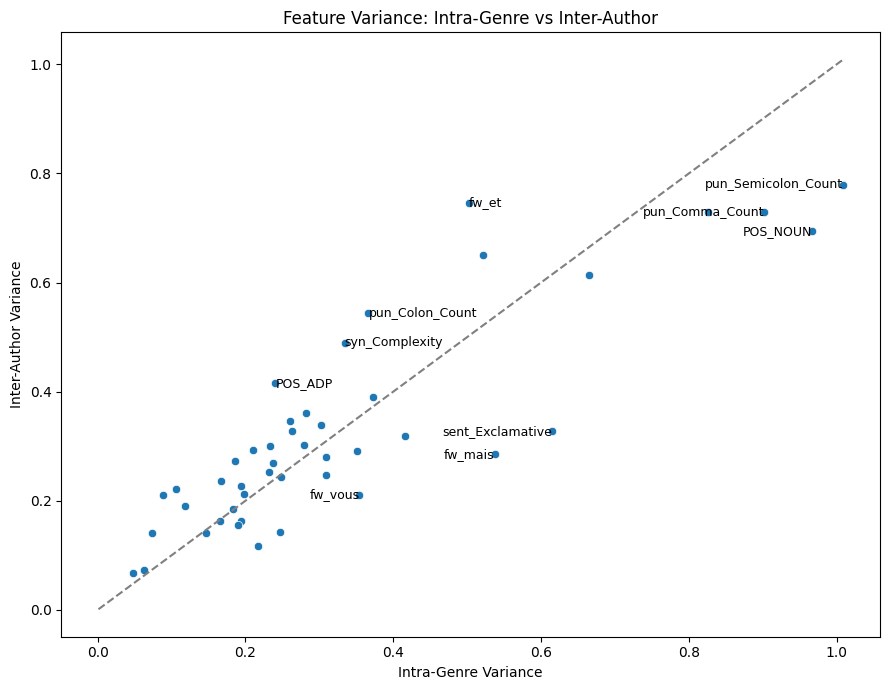

In [342]:
def plot_variance_intra_vs_inter_genre(label_top_n=10):
    coef_variance = coefs.copy()
    coef_variance['Genres'] = authors_df.loc[coef_variance.index, 'Genres']

    # Extraire le premier genre de la liste (séparée par virgule)
    coef_variance['GenreMain'] = coef_variance['Genres'].str.split(',').str[0].str.strip()

    # Filtrer les colonnes numériques uniquement (celles sans 'Genres')
    feature_cols = coefs.select_dtypes(include='number').columns

    # Calcul des variances
    inter_var = coefs[feature_cols].var()
    intra_var = coef_variance.groupby('GenreMain')[feature_cols].var().mean()

    df_var = pd.DataFrame({'InterAuthor': inter_var, 'IntraGenre': intra_var}).dropna()
    df_var["DiffToDiag"] = (df_var["InterAuthor"] - df_var["IntraGenre"]).abs()

    # Plot
    plt.figure(figsize=(9, 7))
    sns.scatterplot(x='IntraGenre', y='InterAuthor', data=df_var)

    lims = [
        min(df_var.min().min(), df_var.max().max()),
        max(df_var.min().min(), df_var.max().max())
    ]
    plt.plot(lims, lims, ls="--", color="grey")

    # Ajouter les labels aux points les plus éloignés
    for name in df_var.sort_values("DiffToDiag", ascending=False).head(label_top_n).index:
        x, y = df_var.loc[name, 'IntraGenre'], df_var.loc[name, 'InterAuthor']
        plt.text(x, y, name, fontsize=9, ha='right' if x > y else 'left', va='center')

    plt.xlabel("Intra-Genre Variance")
    plt.ylabel("Inter-Author Variance")
    plt.title("Feature Variance: Intra-Genre vs Inter-Author")
    plt.tight_layout()
    plt.show()

    
plot_variance_intra_vs_inter_genre(label_top_n=10)



--- Victor Hugo ---


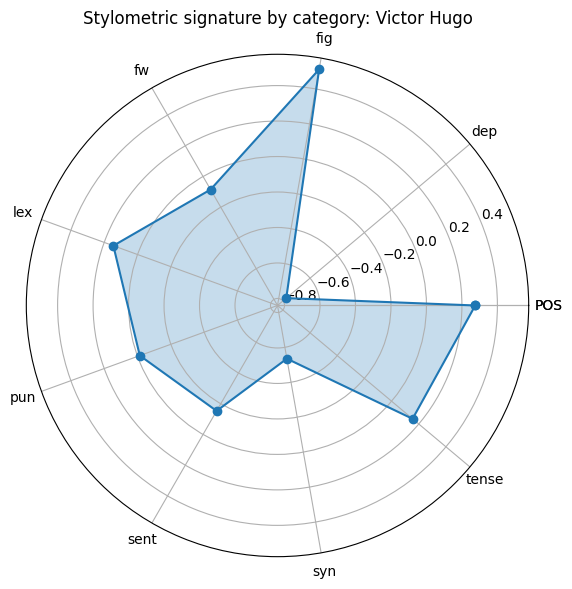


--- Jules Verne ---


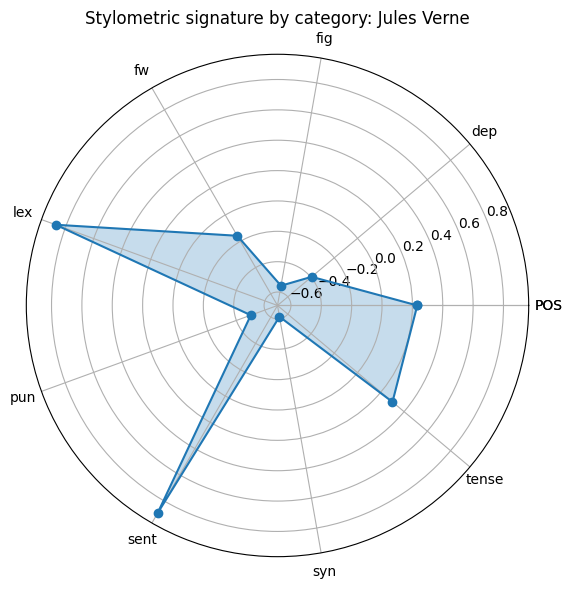


--- Marcel Proust ---


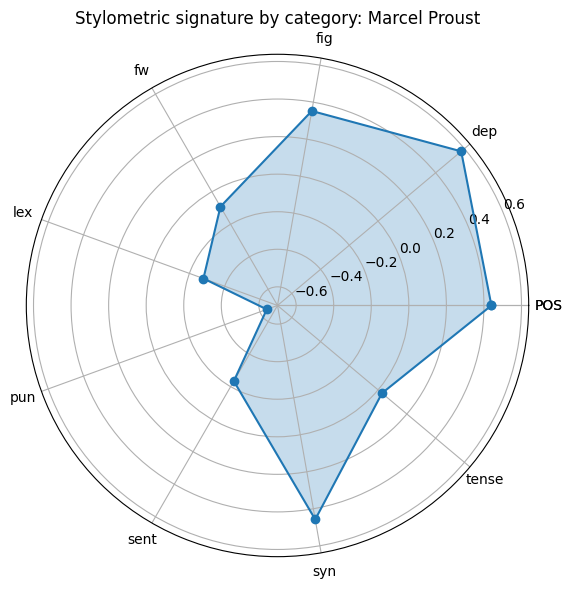


--- Alexandre Dumas ---


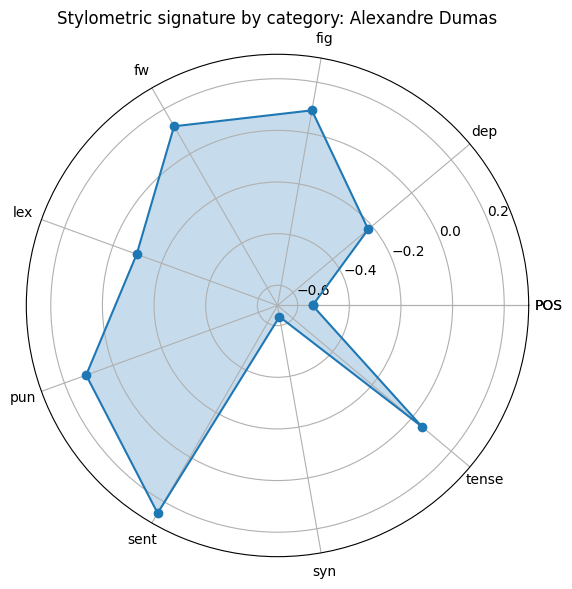


--- Honoré de Balzac ---


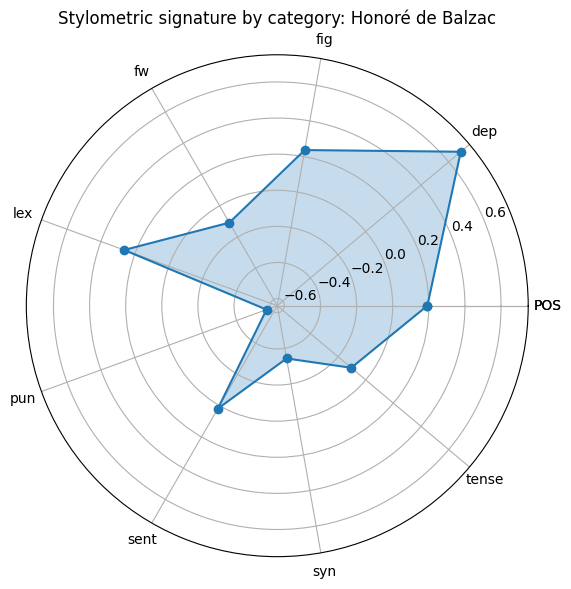


--- Émile Zola ---


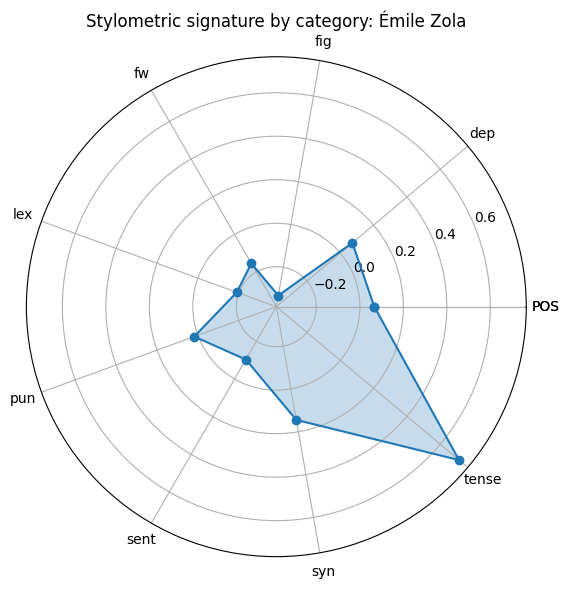


--- Octave Mirbeau ---


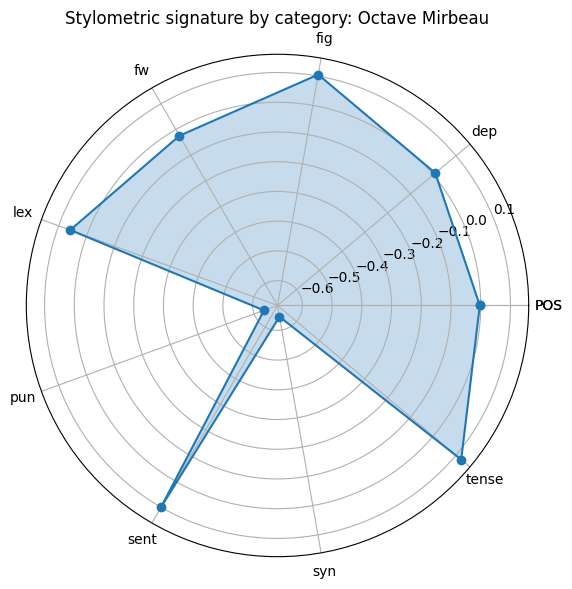


--- Anatole France ---


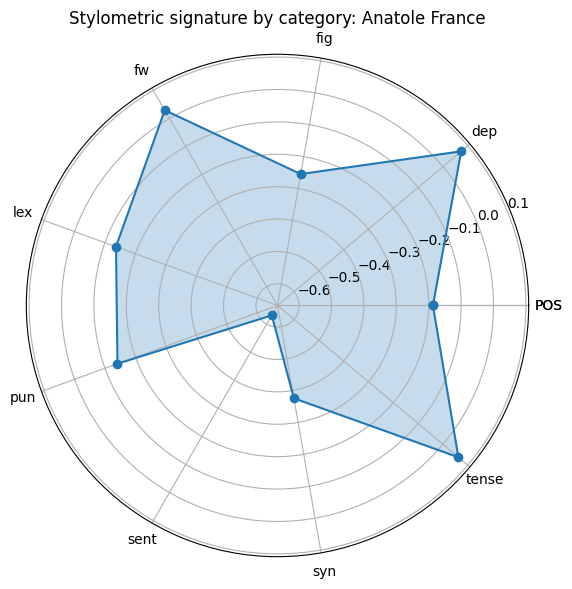


--- Gustave Flaubert ---


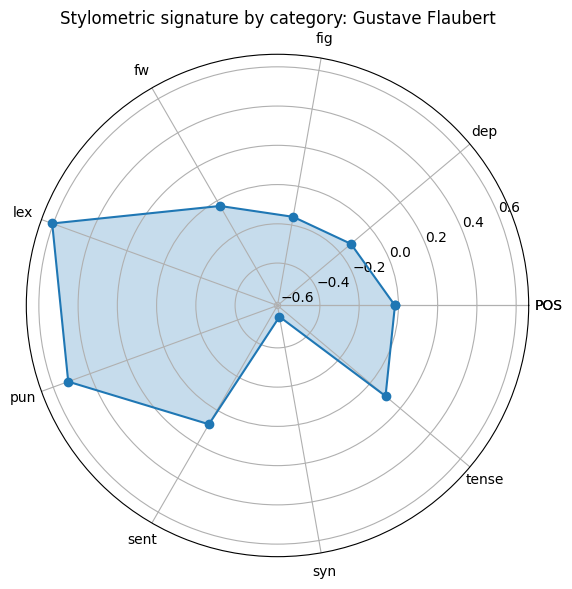


--- Guy de Maupassant ---


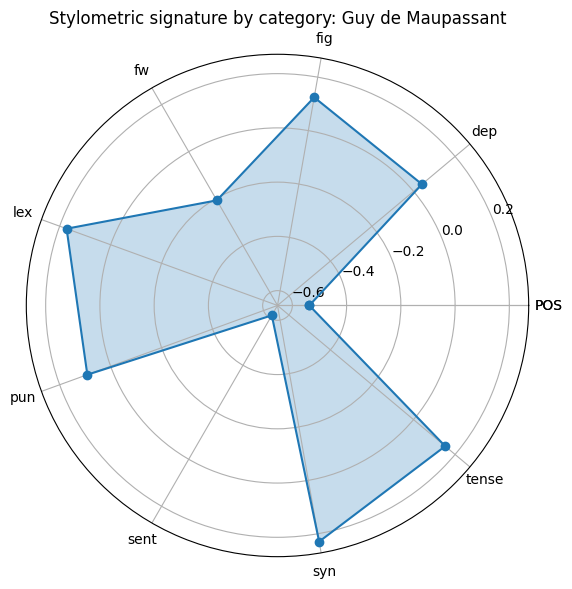

In [337]:
def plot_radar_author_signature(author):
    """
    Radar plot des coefficients moyens de l'auteur regroupés par catégorie.
    """
    # Obtenir les préfixes
    feature_prefixes = pd.Series(coefs.columns).str.extract(r'(^[^_]+_)')[0].str.replace('_$', '', regex=True)
    prefix_map = dict(zip(coefs.columns, feature_prefixes))

    # Moyenne des coefficients de l'auteur
    author_vector = coefs.loc[author]
    prefix_means = author_vector.groupby(prefix_map).mean().sort_index()

    # Préparer les données pour radar
    labels = prefix_means.index.tolist()
    values = prefix_means.values.tolist()

    # Boucler les données pour fermer le radar
    labels += [labels[0]]
    values += [values[0]]
    angles = np.linspace(0, 2 * np.pi, len(labels))

    # Tracer
    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.plot(angles, values, marker='o')
    ax.fill(angles, values, alpha=0.25)
    ax.set_xticks(angles)
    ax.set_xticklabels(labels)
    ax.set_title(f"Stylometric signature by category: {author}")
    plt.tight_layout()
    plt.show()


# Boucle sur les 10 auteurs les plus renommés
top_authors = authors_df.sort_values(by="WikiLangCount", ascending=False).head(10).index

for author in top_authors:
    print(f"\n--- {author} ---")
    plot_radar_author_signature(author)


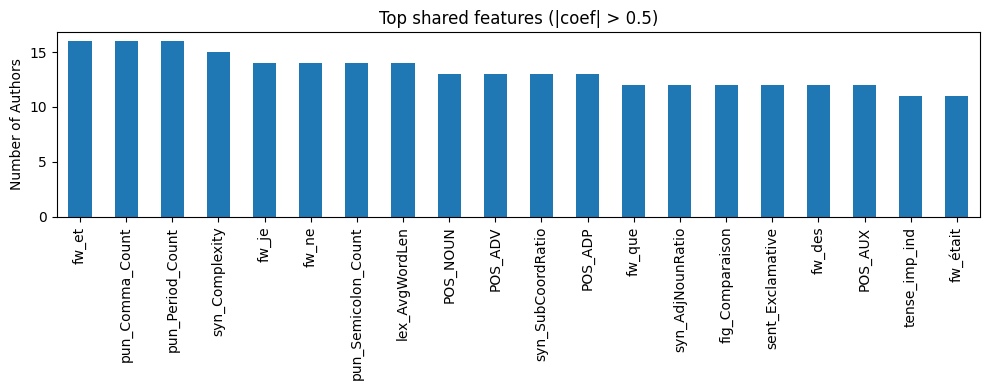

In [330]:
def plot_feature_sharing(threshold=0.5):
    shared_counts = (coefs.abs() > threshold).sum().sort_values(ascending=False)
    plt.figure(figsize=(10, 4))
    shared_counts.head(20).plot(kind='bar')
    plt.title(f"Top shared features (|coef| > {threshold})")
    plt.ylabel("Number of Authors")
    plt.tight_layout()
    plt.show()

plot_feature_sharing(threshold=0.5)


--- Romantisme ---


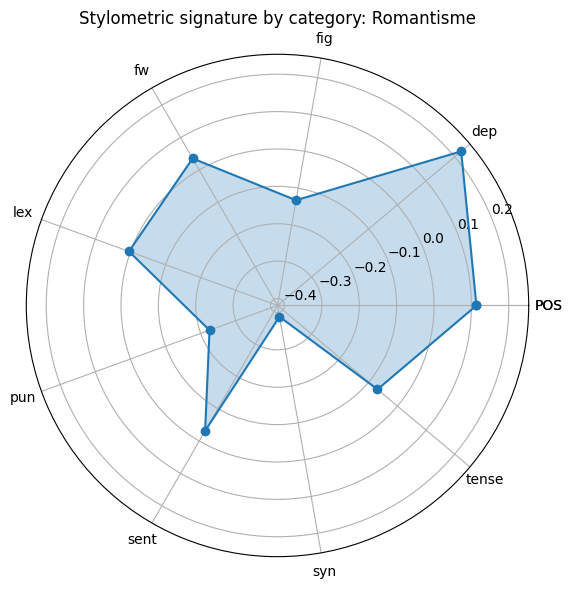


--- Réalisme ---


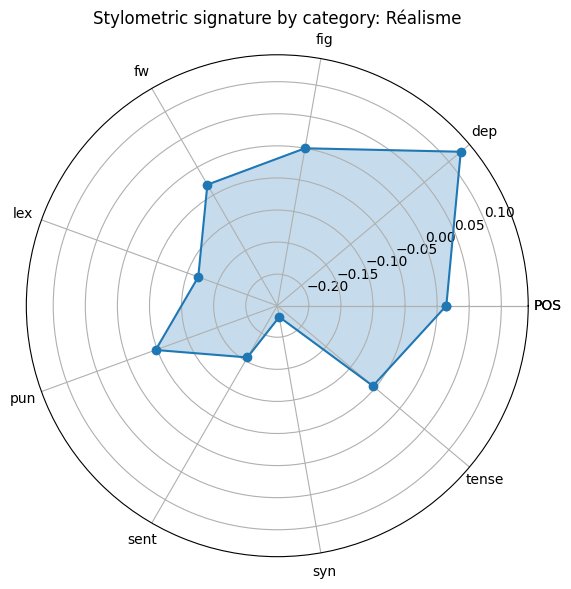


--- Naturalisme ---


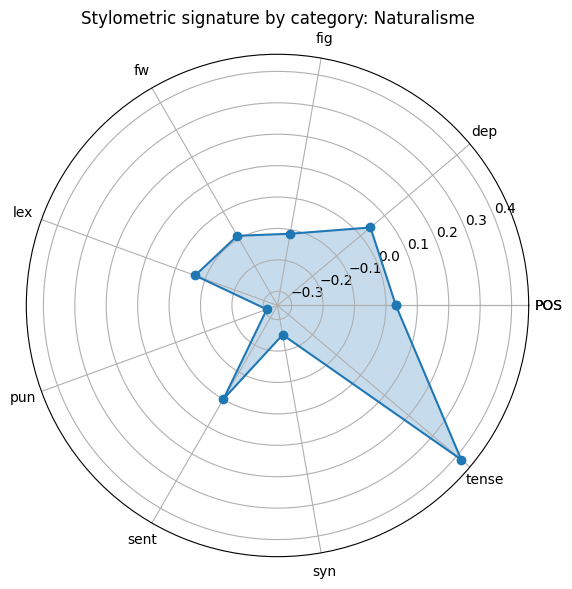


--- Roman Moderne ---


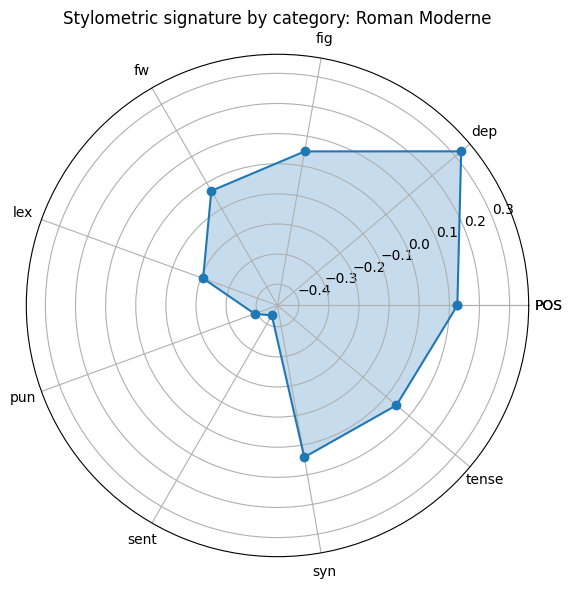


--- Catholicisme littéraire ---


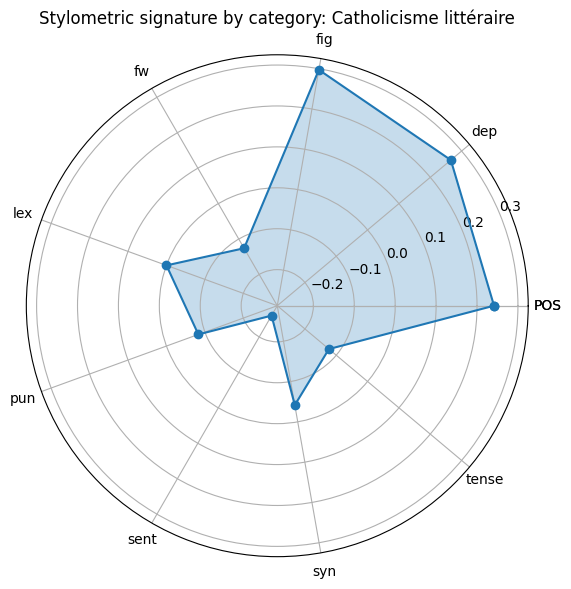

In [336]:
def plot_radar_movement_signature(movement):
    """
    Plot a radar chart of mean stylometric feature category contributions for a given movement.
    """
    # Get prefix map
    feature_prefixes = pd.Series(coefs.columns).str.extract(r'(^[^_]+_)')[0].str.replace('_$', '', regex=True)
    prefix_map = dict(zip(coefs.columns, feature_prefixes))

    # Get authors for the movement
    authors = authors_df[authors_df['Mouvement'] == movement].index
    if len(authors) < 2:
        print(f"Not enough authors for {movement}")
        return

    # Compute average coefficients and group by feature prefix
    avg_vector = coefs.loc[coefs.index.intersection(authors)].mean()
    prefix_means = avg_vector.groupby(prefix_map).mean().sort_index()

    # Prepare data
    labels = prefix_means.index.tolist()
    values = prefix_means.values.tolist()

    # Close the loop
    labels += [labels[0]]
    values += [values[0]]
    angles = np.linspace(0, 2 * np.pi, len(labels))

    # Plot
    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.plot(angles, values, marker='o')
    ax.fill(angles, values, alpha=0.25)
    ax.set_xticks(angles)
    ax.set_xticklabels(labels)
    ax.set_title(f"Stylometric signature by category: {movement}")
    plt.tight_layout()
    plt.show()



for mvmt in valid_movements:
    print(f"\n--- {mvmt} ---")
    plot_radar_movement_signature(mvmt)



--- pun_Semicolon_Count ---


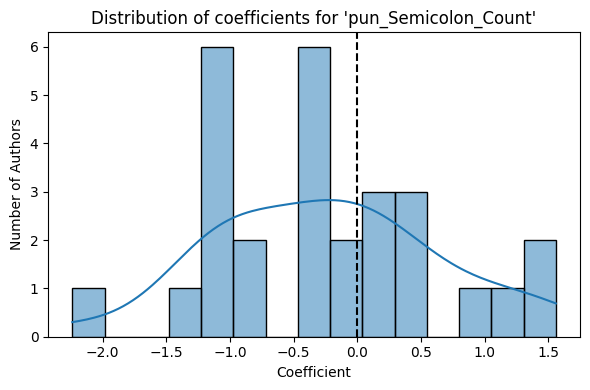


--- fw_et ---


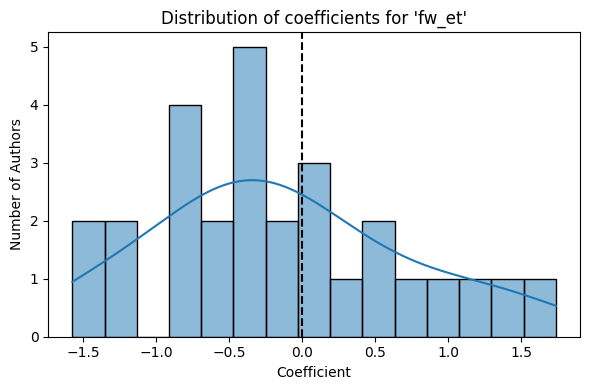


--- pun_Comma_Count ---


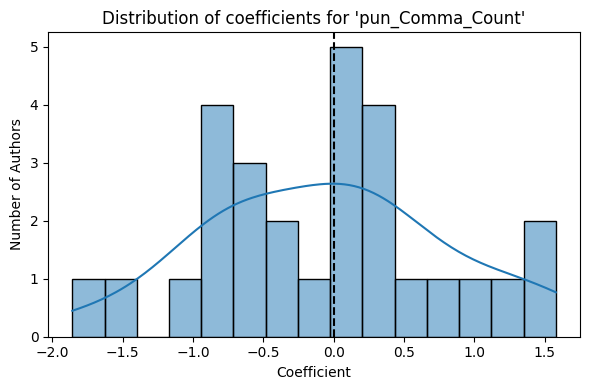


--- pun_Period_Count ---


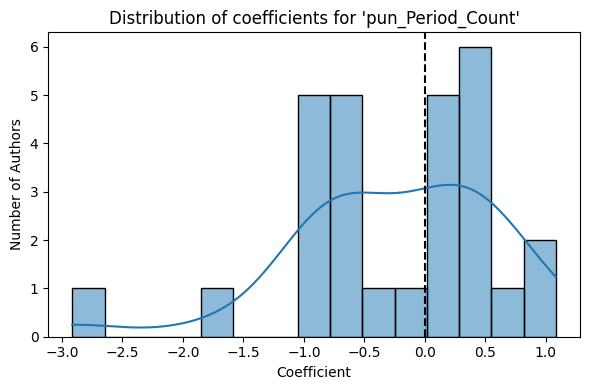


--- syn_Complexity ---


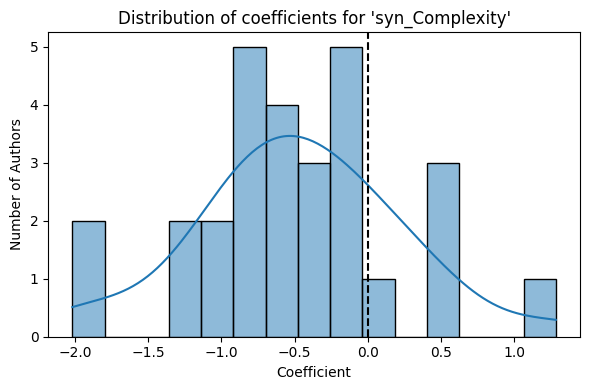


--- POS_NOUN ---


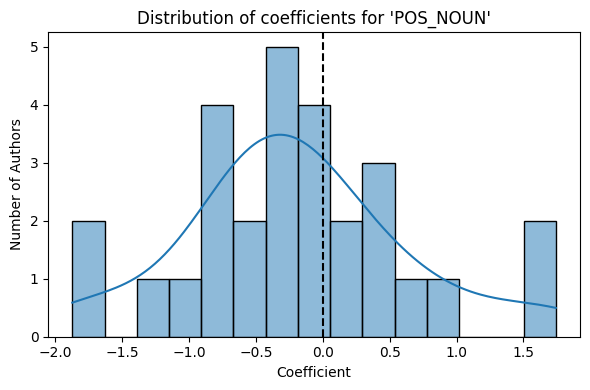


--- lex_AvgWordLen ---


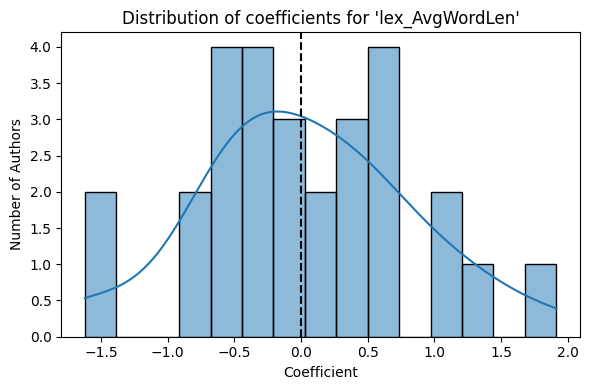


--- POS_ADV ---


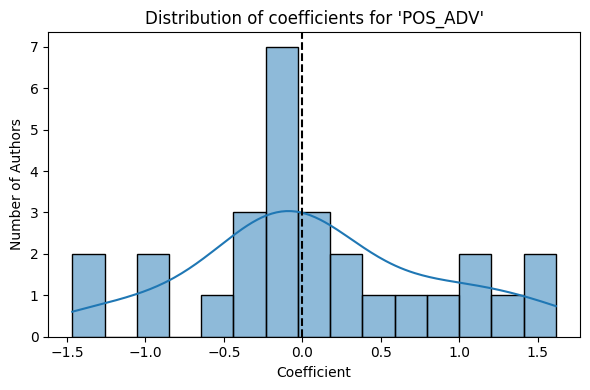


--- POS_ADP ---


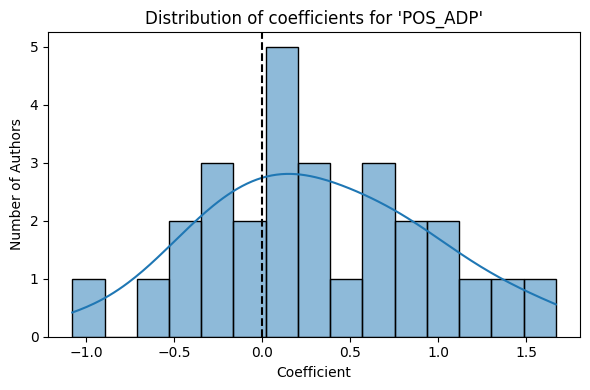


--- pun_Colon_Count ---


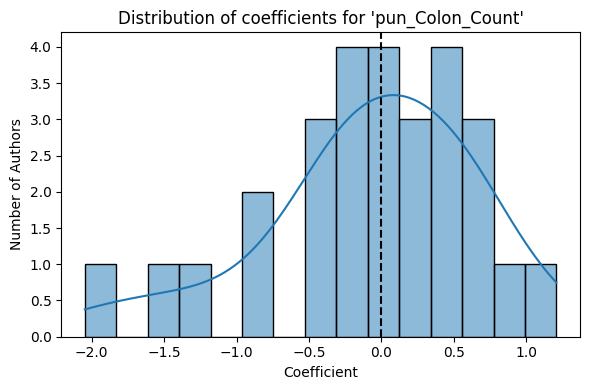

In [332]:
def plot_signed_feature_distribution(feature):
    values = coefs[feature]
    plt.figure(figsize=(6, 4))
    sns.histplot(values, bins=15, kde=True)
    plt.title(f"Distribution of coefficients for '{feature}'")
    plt.axvline(0, color='black', linestyle='--')
    plt.xlabel("Coefficient")
    plt.ylabel("Number of Authors")
    plt.tight_layout()
    plt.show()

# Sélectionner les 10 features les plus importantes globalement
top_features = coefs.abs().mean().sort_values(ascending=False).head(10).index

# Boucle pour tracer leur distribution
for feat in top_features:
    print(f"\n--- {feat} ---")
    plot_signed_feature_distribution(feat)


In [349]:
def plot_full_feature_radar_by_category(author_name):
    """
    Radar chart for all 45 features of a given author, grouped and color-coded by feature category.
    """
    # Vérification de l'auteur
    if author_name not in coefs.index:
        print(f"Auteur inconnu : {author_name}")
        return

    # Extraire les features et leur valeur pour l’auteur
    author_values = coefs.loc[author_name]
    features = author_values.index.tolist()
    values = author_values.values

    # Extraire les préfixes
    prefix_map = pd.Series(features).str.extract(r"(^[^_]+_)", expand=False).fillna("misc")
    feature_categories = prefix_map.values

    # Regrouper les features par catégorie
    category_order = sorted(np.unique(feature_categories), key=lambda x: features.index(next(f for f in features if f.startswith(x))))
    grouped_features = []
    grouped_values = []
    grouped_colors = []
    
    cmap = cm.get_cmap('tab10')
    category_color_map = {cat: cmap(i % 10) for i, cat in enumerate(category_order)}
    
    for cat in category_order:
        for i, (f, p) in enumerate(zip(features, feature_categories)):
            if p == cat:
                grouped_features.append(f"{cat}{f[len(cat):]}")
                grouped_values.append(values[i])
                grouped_colors.append(category_color_map[cat])

    # Boucler pour fermer le radar
    grouped_features.append(grouped_features[0])
    grouped_values.append(grouped_values[0])
    grouped_colors.append(grouped_colors[0])

    # Angles du radar
    angles = np.linspace(0, 2 * np.pi, len(grouped_features), endpoint=False).tolist()
    angles += [angles[0]]

    # Plot radar
    fig, ax = plt.subplots(figsize=(10, 8), subplot_kw=dict(polar=True))
    for i in range(len(grouped_features) - 1):
        ax.plot(angles[i:i+2], grouped_values[i:i+2], color=grouped_colors[i])
        ax.fill(angles[i:i+2], grouped_values[i:i+2], color=grouped_colors[i], alpha=0.25)

    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(grouped_features, fontsize=8, rotation=90)

    ax.set_title(f"Profil stylistique de {author_name}", size=14, pad=20)
    ax.grid(True)

    # Légende par catégorie
    handles = [plt.Line2D([0], [0], color=c, lw=4) for c in category_color_map.values()]
    labels = list(category_color_map.keys())
    ax.legend(handles, labels, bbox_to_anchor=(1.1, 1.05), loc='upper left', title="Catégories")

    plt.tight_layout()
    plt.show()

/var/folders/xn/v7b7dbbn6xg3hzr5h4395gbc0000gn/T/ipykernel_31191/2569117485.py:25: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10')


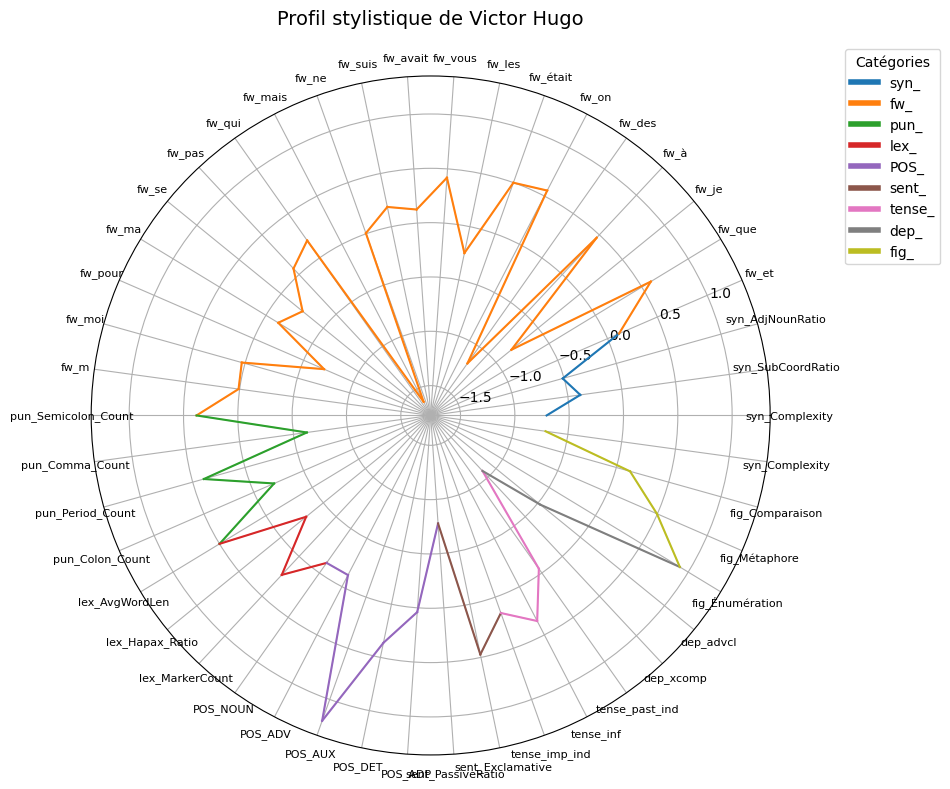

In [350]:
plot_full_feature_radar_by_category("Victor Hugo")